# Download and Install CLIP Dependencies (esta celda provoca reinicio de entorno)

In [ ]:
#installing some dependencies, CLIP was release in PyTorch
import os
import torch
import subprocess

CUDA_version = [s for s in subprocess.check_output(["nvcc", "--version"]).decode("UTF-8").split(", ") if s.startswith("release")][0].split(" ")[-1]
print("CUDA version:", CUDA_version)

if CUDA_version == "10.0":
    torch_version_suffix = "+cu100"
elif CUDA_version == "10.1":
    torch_version_suffix = "+cu101"
elif CUDA_version == "10.2":
    torch_version_suffix = ""
else:
    torch_version_suffix = "+cu110"

!pip install torch==1.7.1{torch_version_suffix} torchvision==0.8.2{torch_version_suffix} -f https://download.pytorch.org/whl/torch_stable.html ftfy regex

print("Torch version:", torch.__version__)
os.kill(os.getpid(), 9)

# CLIP repository

In [ ]:
#clone the CLIP repository
!git clone https://github.com/openai/CLIP.git
%cd CLIP

Cloning into 'CLIP'...
remote: Enumerating objects: 164, done.
remote: Counting objects: 100% (73/73), done.
remote: Compressing objects: 100% (49/49), done.
remote: Total 164 (delta 31), reused 49 (delta 19), pack-reused 91
Receiving objects: 100% (164/164), 8.87 MiB | 19.82 MiB/s, done.
Resolving deltas: 100% (71/71), done.
/content/CLIP


# Imports

In [ ]:
## Imports necesarios para la ejecucion de los scripts
import os
import tarfile
import pickle
import math
import random
import glob
import torch
import torchvision
import cv2
import shutil
import os.path
import numpy as np
import tensorflow as tf
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import torch.nn.functional as F
import torchvision.datasets as dataset
import torchvision.transforms as transforms

# import urllib, cStringIO    # imatges
from io import BytesIO
from matplotlib import pyplot
from PIL import Image
from zipfile import ZipFile 
from torchvision import models
from torch.utils.data import Dataset, DataLoader
from torch import optim
from torch import nn
from torch.utils.data.sampler import SubsetRandomSampler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report,plot_confusion_matrix,precision_score,accuracy_score,roc_auc_score,f1_score,recall_score
from tensorflow.keras import layers,regularizers
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Conv2D, Conv3D, Activation, Flatten, Dense, Dropout, BatchNormalization, MaxPooling2D
from tensorflow.keras.models import Model,Sequential
from tensorflow.keras.optimizers import SGD, Adam
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import Xception, VGG19, ResNet50
from urllib.request import urlopen
from google.colab import drive
from numpy.random import seed
from scipy.special import softmax

%matplotlib inline

used_seed=seed(42)

# Directorio para cargar y guardar los datos ("Base_Folder")

In [ ]:
## Directorio para cargar y guradar los datos - CONNECT TO COLAB DIRECTORY
BASE_FOLDER = '/content/drive/My Drive/Colab Notebooks/'

## Importar 
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


# Descargar descripciones

In [ ]:
## Read descriptions
Path_Descriptions = BASE_FOLDER+ "Datasets/img_celeba_list_attr.txt"

Description_labels = np.array(open(Path_Descriptions).readlines()[1:2][0].split())
N_Labels = len(Description_labels)
File_Descriptions = open(Path_Descriptions).readlines()[2:]
Description_data = []
N_Data = len(File_Descriptions) 
for i in range(N_Data):
    Description_data.append([])
    if (str(i+1).zfill(6)+'.jpg')==File_Descriptions[i].split()[0]:
        for j in File_Descriptions[i].split()[1:]:
            Description_data[i].append(j=='1')
    else:
        print('Error inidice:',i)
Description_data=np.array(Description_data)
print(N_Data)

Descripciones=np.array(['Tiene la sombra de las 5 en punto ', 'Tinene las cejas arqueadas ', 'Es atractivo', 'Tiene bolsas debajo de los ojos ', 'Es calvo ', 'Tiene flequillo ', 'Tiene los labios grandes',
              'Tiene la nariz grande ', 'Tiene el pelo negro ', 'Tiene el pelo rubio ', 'Imagen Borrosa', 'Tiene el pelo castaño ', 'Tiene las cejas espesas ', 'Está regordete ', 'Tiene papada', 'Lleva anteojos',
              'Tiene perilla ', 'Tiene el pelo canoso ', 'Lleva maquillaje pesado ', 'Tiene los pómulos altos ', 'Es un hombre', 'Tiene la boca ligeramente abierta', 'Tiene bigote ', 'Tiene los ojos estrechos',
              'No tiene barba ', 'Cara ovalada ', 'Piel pálida ', 'Nariz puntiaguda ', 'Cada vez más calvo ', 'Mejillas sonrosadas ', 'patillas ', 'Está sonriendo', 
              'Tiene el pelo lacio ', 'Tiene el pelo ondulado ', 'Lleva aretes ', 'Lleva sombrero ', 'Usa lápiz labial ', 'Lleva collar de uso ', 'Lleva corbata ', 'Es joven'])

# - Sombra de las 5 en punto  - Cejas arqueadas  - atractivo  - Bolsas debajo de los ojos  - Calvo  - Flequillo  - Labios grandes  
# - Nariz grande  - Cabello negro  - Pelo rubio  - Borroso  - Pelo castaño  - Cejas espesas  - Regordete  - Papada  - Los anteojos  
# - Perilla  - Pelo canoso  - Maquillaje pesado  - Pómulos altos  - Masculino  - Boca ligeramente abierta  - Bigote  - Ojos estrechos  
# - Sin barba  - Cara ovalada  - Piel pálida  - Nariz puntiaguda  - Cada vez más calvo  - Mejillas sonrosadas  - patillas  - sonriendo  
# - Pelo lacio  - Pelo ondulado  - Usar aretes  - Usar sombrero  - Usar lápiz labial  - Collar de uso  - Usar corbata  - Joven  

202599


In [ ]:
for i in range(N_Labels):
    print(i,'-',Description_labels[i],'-',Descripciones[i],'-', 'Número de casos (Verdadero):', np.sum(Description_data[:,i]))

0 - 5_o_Clock_Shadow - Tiene la sombra de las 5 en punto  - Número de casos (Verdadero): 22516
1 - Arched_Eyebrows - Tinene las cejas arqueadas  - Número de casos (Verdadero): 54090
2 - Attractive - Es atractivo - Número de casos (Verdadero): 103833
3 - Bags_Under_Eyes - Tiene bolsas debajo de los ojos  - Número de casos (Verdadero): 41446
4 - Bald - Es calvo  - Número de casos (Verdadero): 4547
5 - Bangs - Tiene flequillo  - Número de casos (Verdadero): 30709
6 - Big_Lips - Tiene los labios grandes - Número de casos (Verdadero): 48785
7 - Big_Nose - Tiene la nariz grande  - Número de casos (Verdadero): 47516
8 - Black_Hair - Tiene el pelo negro  - Número de casos (Verdadero): 48472
9 - Blond_Hair - Tiene el pelo rubio  - Número de casos (Verdadero): 29983
10 - Blurry - Imagen Borrosa - Número de casos (Verdadero): 10312
11 - Brown_Hair - Tiene el pelo castaño  - Número de casos (Verdadero): 41572
12 - Bushy_Eyebrows - Tiene las cejas espesas  - Número de casos (Verdadero): 28803
13 - 

# Analizar descripciones (ejectuar solo si no se ha ejectutado aun)

##### Estudio características excluyentes

In [ ]:
## Find excluding features
features_relation=[]

for i in range(Description_data.shape[1]-1):
    for j in range(i,Description_data.shape[1]):
        if i!=j:
            if sum(Description_data[:,i]==Description_data[:,j])==len(Description_data[:,i]):
                features_relation.append('Simepre iguales: '+Descripciones[i]+'/'+Descripciones[j])

            if sum(Description_data[:,i]!=Description_data[:,j])==len(Description_data[:,i]):
                features_relation.append('Nunca iguales:'+Descripciones[i]+' / '+Descripciones[j])        
                
            if sum(np.logical_and(Description_data[:,i],Description_data[:,j])==1)==0:
                features_relation.append('Nunca los dos True: '+Descripciones[i]+' / '+Descripciones[j])

            if sum(np.logical_or(Description_data[:,i],Description_data[:,j])==0)==0:
                features_relation.append('Nunca los dos True: '+Descripciones[i]+' / '+Descripciones[j])                                      

for current_text in features_relation:
    print(current_text)

Nunca los dos True: Es calvo  / Tiene flequillo 


##### 2 características iguales

In [ ]:
# find images with specific features
feature_1=[4]
feature_2=[5]
features_relation=[]
same_1=True
same_2=True
different_1=True
different_2=True

for i in range(Description_data.shape[0]):
    if same_1:
        if Description_data[i,feature_1]==1:
            if Description_data[i,feature_1]==Description_data[i,feature_2]:
                
                print('Dos verdaderos - Imagen:', i+1,'Descripciones:', Descripciones[feature_1],'/',Descripciones[feature_2])
                same_1=False
    if same_2:
        if Description_data[i,feature_1]==0:
            if Description_data[i,feature_1]==Description_data[i,feature_2]:
                print('Dos falsos - Imagen:', i+1,'Descripciones:', Descripciones[feature_1],'/',Descripciones[feature_2])
                same_2=False
    if different_1:
        if Description_data[i,feature_1]==1:
            if Description_data[i,feature_1]!=Description_data[i,feature_2]:
                print('Dos diferentes (primero verdadero) - Imagen:', i+1,'Descripciones:', Descripciones[feature_1],'/',Descripciones[feature_2])
                different_1=False
    if different_2:
        if Description_data[i,feature_1]==0:
            if Description_data[i,feature_1]!=Description_data[i,feature_2]:
                print('Dos diferentes (primero falso) - Imagen:', i+1,'Descripciones:', Descripciones[feature_1],'/',Descripciones[feature_2])
                different_2=False
    if (not same_1) and (not same_2) and (not different_1) and (not different_2):
        break

for current_text in features_relation:
    print(current_text)

Dos falsos - Imagen: 1 Descripciones: ['Es calvo '] / ['Tiene flequillo ']
Dos diferentes (primero falso) - Imagen: 9 Descripciones: ['Es calvo '] / ['Tiene flequillo ']
Dos diferentes (primero verdadero) - Imagen: 51 Descripciones: ['Es calvo '] / ['Tiene flequillo ']


##### Multiples, 2 caracteristicas iguales

- [     0 167343   4547  30709] Es calvo  / Tiene flequillo   - img: 0
- [    59 149639   4488  48413] Es calvo  / Tiene el pelo negro   - img: 1490


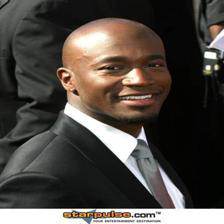

- [     1 168070   4546  29982] Es calvo  / Tiene el pelo rubio   - img: 29126


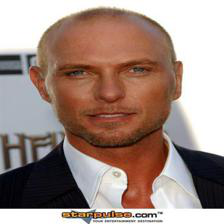

- [     3 156483   4544  41569] Es calvo  / Tiene el pelo castaño   - img: 16882


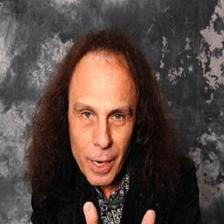

- [  1101 190654   3446   7398] Es calvo  / Tiene el pelo canoso   - img: 51


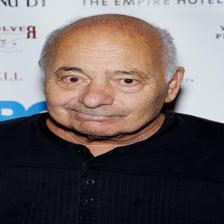

- [  6307 129725  24402  42165] Tiene flequillo  / Tiene el pelo negro   - img: 46


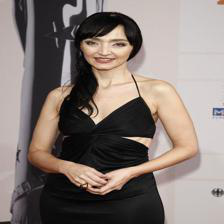

- [  7095 149002  23614  22888] Tiene flequillo  / Tiene el pelo rubio   - img: 29


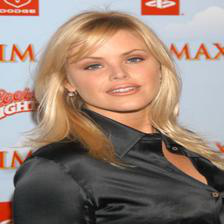

- [  8339 138657  22370  33233] Tiene flequillo  / Tiene el pelo castaño   - img: 110


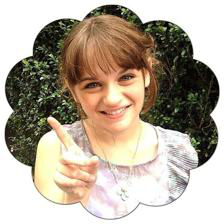

- [   391 163782  30318   8108] Tiene flequillo  / Tiene el pelo canoso   - img: 94


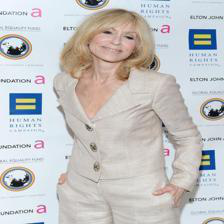

- [     3 124147  48469  29980] Tiene el pelo negro  / Tiene el pelo rubio   - img: 681


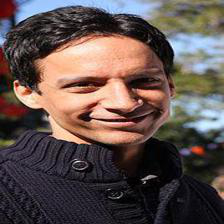

- [  1136 113691  47336  40436] Tiene el pelo negro  / Tiene el pelo castaño   - img: 33


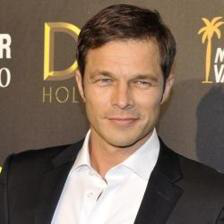

- [    10 145638  48462   8489] Tiene el pelo negro  / Tiene el pelo canoso   - img: 9581


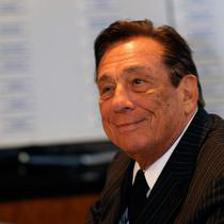

- [  1220 132264  28763  40352] Tiene el pelo rubio  / Tiene el pelo castaño   - img: 178


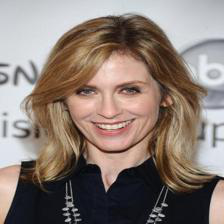

- [   512 164629  29471   7987] Tiene el pelo rubio  / Tiene el pelo canoso   - img: 94


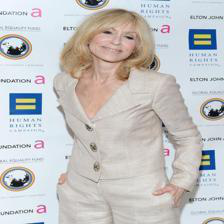

- [    53 152581  41519   8446] Tiene el pelo castaño  / Tiene el pelo canoso   - img: 575


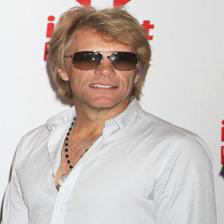

In [ ]:
# find images with specific features
feature_1=[4,5,8,9,11,17]
feature_2=[4,5,8,9,11,17]

feature_totals=np.zeros((len(feature_1),len(feature_2),4)).astype(np.int32)
feature_first_case=np.zeros((len(feature_1),len(feature_2),4)).astype(np.int32)

for i in range(Description_data.shape[0]):
    # print(i)
    for f1_i in range(len(feature_1)-1):
        f1=feature_1[f1_i]
        for f2_i in range(f1_i+1,len(feature_2)):
            f2=feature_2[f2_i]
            if f1<f2:
                if Description_data[i,f1]:
                    if Description_data[i,f1]==Description_data[i,f2]:
                        feature_totals[f1_i,f2_i,0]+=1
                        if feature_first_case[f1_i,f2_i,0]==0:
                            feature_first_case[f1_i,f2_i,0]=i+1
                            # print(i+1)

                    if Description_data[i,f1]!=Description_data[i,f2]:
                        feature_totals[f1_i,f2_i,2]+=1
                        if feature_first_case[f1_i,f2_i,2]==0:
                            feature_first_case[f1_i,f2_i,2]=i+1
                            # print(i+1)

                if not Description_data[i,f1]:
                    if Description_data[i,f1]==Description_data[i,f2]:
                        feature_totals[f1_i,f2_i,1]+=1
                        if feature_first_case[f1_i,f2_i,1]==0:
                            feature_first_case[f1_i,f2_i,1]=i+1
                            # print(i+1)

                    if Description_data[i,f1]!=Description_data[i,f2]:
                        feature_totals[f1_i,f2_i,3]+=1
                        if feature_first_case[f1_i,f2_i,3]==0:
                            feature_first_case[f1_i,f2_i,3]=i+1
                            # print(i+1)

for f1_i in range(len(feature_1)-1):
    f1=feature_1[f1_i]
    for f2_i in range(f1_i+1,len(feature_1)):
        f2=feature_2[f2_i]
        if f1<f2:
            print('-',feature_totals[f1_i,f2_i,:],Descripciones[f1],'/',Descripciones[f2],' - img:' ,feature_first_case[f1_i,f2_i,0])
            if feature_totals[f1_i,f2_i,0]>0:
                test_image_path=Path_images+str(feature_first_case[f1_i,f2_i,0]).zfill(6)+'.jpg'
                cv2_imshow(cv2.cvtColor(np.array(Image.open(test_image_path)), cv2.COLOR_BGR2RGB))

##### Ver ejemplos segun carcateristicas:


img_to_show: 162616
img_to_show_2: 44600



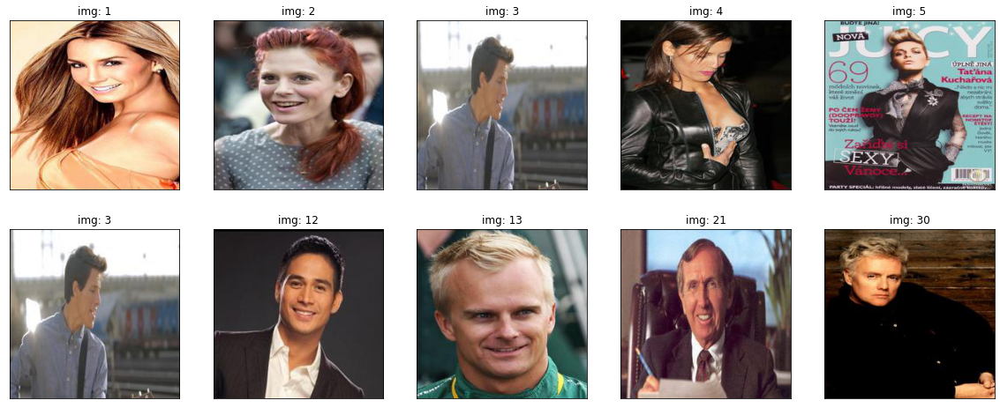

In [ ]:
# 0 - 5_o_Clock_Shadow - Tiene la sombra de las 5 en punto  - Número de casos (Verdadero): 22516
# 1 - Arched_Eyebrows - Tinene las cejas arqueadas  - Número de casos (Verdadero): 54090
# 2 - Attractive - Es atractivo - Número de casos (Verdadero): 103833
# 3 - Bags_Under_Eyes - Tiene bolsas debajo de los ojos  - Número de casos (Verdadero): 41446
# 4 - Bald - Es calvo  - Número de casos (Verdadero): 4547
# 5 - Bangs - Tiene flequillo  - Número de casos (Verdadero): 30709
# 6 - Big_Lips - Tiene los labios grandes - Número de casos (Verdadero): 48785
# 7 - Big_Nose - Tiene la nariz grande  - Número de casos (Verdadero): 47516
# 8 - Black_Hair - Tiene el pelo negro  - Número de casos (Verdadero): 48472
# 9 - Blond_Hair - Tiene el pelo rubio  - Número de casos (Verdadero): 29983
# 10 - Blurry - Imagen Borrosa - Número de casos (Verdadero): 10312
# 11 - Brown_Hair - Tiene el pelo castaño  - Número de casos (Verdadero): 41572
# 12 - Bushy_Eyebrows - Tiene las cejas espesas  - Número de casos (Verdadero): 28803
# 13 - Chubby - Está regordete  - Número de casos (Verdadero): 11663
# 14 - Double_Chin - Tiene papada - Número de casos (Verdadero): 9459
# 15 - Eyeglasses - Lleva anteojos - Número de casos (Verdadero): 13193
# 16 - Goatee - Tiene perilla  - Número de casos (Verdadero): 12716
# 17 - Gray_Hair - Tiene el pelo canoso  - Número de casos (Verdadero): 8499
# 18 - Heavy_Makeup - Lleva maquillaje pesado  - Número de casos (Verdadero): 78390
# 19 - High_Cheekbones - Tiene los pómulos altos  - Número de casos (Verdadero): 92189
# 20 - Male - Es un hombre - Número de casos (Verdadero): 84434
# 21 - Mouth_Slightly_Open - Tiene la boca ligeramente abierta - Número de casos (Verdadero): 97942
# 22 - Mustache - Tiene bigote  - Número de casos (Verdadero): 8417
# 23 - Narrow_Eyes - Tiene los ojos estrechos - Número de casos (Verdadero): 23329
# 24 - No_Beard - No tiene barba  - Número de casos (Verdadero): 169158
# 25 - Oval_Face - Cara ovalada  - Número de casos (Verdadero): 57567
# 26 - Pale_Skin - Piel pálida  - Número de casos (Verdadero): 8701
# 27 - Pointy_Nose - Nariz puntiaguda  - Número de casos (Verdadero): 56210
# 28 - Receding_Hairline - Cada vez más calvo  - Número de casos (Verdadero): 16163
# 29 - Rosy_Cheeks - Mejillas sonrosadas  - Número de casos (Verdadero): 13315
# 30 - Sideburns - patillas  - Número de casos (Verdadero): 11449
# 31 - Smiling - Está sonriendo - Número de casos (Verdadero): 97669
# 32 - Straight_Hair - Tiene el pelo lacio  - Número de casos (Verdadero): 42222
# 33 - Wavy_Hair - Tiene el pelo ondulado  - Número de casos (Verdadero): 64744
# 34 - Wearing_Earrings - Lleva aretes  - Número de casos (Verdadero): 38276
# 35 - Wearing_Hat - Lleva sombrero  - Número de casos (Verdadero): 9818
# 36 - Wearing_Lipstick - Usa lápiz labial  - Número de casos (Verdadero): 95715
# 37 - Wearing_Necklace - Lleva collar de uso  - Número de casos (Verdadero): 24913
# 38 - Wearing_Necktie - Lleva corbata  - Número de casos (Verdadero): 14732
# 39 - Young - Es joven - Número de casos (Verdadero): 156734

# - Sombra de las 5 en punto, Perilla, Sin barba
# - Cejas arqueadas  
# - atractivo  
# - Bolsas debajo de los ojos  
# - Calvo, Flequillo  
# - Labios grandes
# - Nariz grande
# - Cabello negro, Pelo rubio, Pelo castaño, Pelo gris
# - Borroso  -   
# - Cejas espesas  
# - Regordete  
# - Papada  
# - Los anteojos  
# - Maquillaje pesado  
# - Pómulos altos  
# - Masculino  
# - Boca ligeramente abierta  
# - Bigote  
# - Ojos estrechos  
# - Cara ovalada
# - Piel pálida
# - Nariz puntiaguda
# - Cada vez más calvo  
# - Mejillas sonrosadas  
# - Patillas  
# - Sonriendo  
# - Pelo lacio, Pelo ondulado
# - Usar aretes
# - Usar sombrero
# - Usar lápiz labial
# - Collar de uso
# - Usar corbata
# - Joven  

# - Sombra de las 5 en punto, Perilla, Sin barba

num_cols=5
num_rows=2
img_to_show=[]
img_to_show_2=[]
for i in range(Description_data.shape[0]):
    if not Description_data[i][0] and not Description_data[i][16] and Description_data[i][24]: 
        img_to_show.append(i+1)

    if not Description_data[i][0] and not Description_data[i][16] and Description_data[i][24] and Description_data[i][20]: 
        img_to_show_2.append(i+1)

    # if len(img_to_show)>num_cols and len(img_to_show_2)>num_cols:
    #     break
print('img_to_show:',len(img_to_show))
print('img_to_show_2:',len(img_to_show_2))


fig, axs = plt.subplots(num_rows,num_cols,figsize=(4*num_cols,4*num_rows))

# for i in range(num_rows):

for j in range(num_cols):
    if len(img_to_show)>j:
        img_file = Image.open(Path_images+str(img_to_show[j]).zfill(6)+'.jpg')
        axs[0,j].imshow(img_file)
        axs[0,j].axes.xaxis.set_visible(False)
        axs[0,j].axes.yaxis.set_visible(False)
        axs[0,j].set_title('img: '+str(img_to_show[j]))

for j in range(num_cols):
    if len(img_to_show_2)>j:
        img_file = Image.open(Path_images+str(img_to_show_2[j]).zfill(6)+'.jpg')
        axs[1,j].imshow(img_file)
        axs[1,j].axes.xaxis.set_visible(False)
        axs[1,j].axes.yaxis.set_visible(False)
        axs[1,j].set_title('img: '+str(img_to_show_2[j]))
print()



# Descargar imagenes zip

In [ ]:
Path_Images_zip = BASE_FOLDER+ 'celeba_resized.zip'
Path_Images_unzip = '/content/CLIP/Images unzip'

In [ ]:
## Read zip file
os.makedirs(Path_Images_unzip, exist_ok=True)
os.makedirs(Path_Images_unzip+'/img_celeba', exist_ok=True)

zf = ZipFile(Path_Images_zip)
zf.extractall(Path_Images_unzip)
zf.close()

In [ ]:
Path_images_=Path_Images_unzip
Path_images=Path_images_+'/'
num_files=sum([len(files) for r, d, files in os.walk(Path_images_)])
print(num_files)

202599


# Funciones

In [ ]:
def CLIP_get_probs(img_path,img_txt, img_model, img_transf, img_device, img_candidate_captions, img_print):
    ## obtener las probabilidades de clip segun la imagen y los prompts entrados, visualizar resultados y recibir toda la información
    img_proeprocessed = img_transf(Image.open(img_path)).unsqueeze(0).to(img_device)

    img_features = img_model.encode_image(img_proeprocessed)
    txt_features = img_model.encode_text(img_txt)
    
    img_logits, img_logits_txt = img_model(img_proeprocessed, img_txt)

    N_p=len(img_logits[0])

    image_p=softmax(img_logits.detach().numpy()[0])
    image_p_index=list(range(N_p))

    image_p_order=np.zeros((N_p,2))

    image_p_order[:,0]=np.sort(image_p)[::-1]

    for i in range(N_p):
        data_saved=False
        j=0
        while not data_saved:
            # print(i,j,image_p_index[j],image_p_order[i,0],image_p[image_p_index[j]])
            if image_p_order[i,0]==image_p[image_p_index[j]]:
                image_p_order[i,1]=np.int(image_p_index[j])
                image_p_index.remove(image_p_index[j])
                data_saved=True
            else:
                j+=1

    # print('\nFeatures:',image_features)
    # print('\nText Features:',image_features)
    # print('\nLogits:',image_logits)
    # print('\nLogits per text:',image_logits_text)

    print('\nPrediccion:',img_candidate_captions[np.argmax(image_p)])
    # print('\nPredicciones:',image_p)
    # print('\nPredicciones ordenadas:',image_p_order)
    # print(tokens)

    for i in range(N_p):
        print('-',img_candidate_captions[np.int(image_p_order[i,1])], '('+str(image_p_order[i,0])+')')

    if img_print:
        img_file = Image.open(img_path)
        fig, axs = plt.subplots(figsize=(5,5))
        axs.imshow(img_file)
        axs.axes.xaxis.set_visible(False)
        axs.axes.yaxis.set_visible(False)
        axs.set_title(img_path)

    print() # mejor visualizacion
    return image_p,image_p_order , img_logits, img_logits_txt, img_features, txt_features, img_proeprocessed

def CLIP_get_probs_index(img_path,img_index,img_txt, img_model, img_transf, img_device, img_candidate_captions, img_print):
    ## obtener las probabilidades ordenadas (mayor a menor) de clip segun la imagen y los prompts entrados, visualizar resultados y recibir toda la información
    img_path2= img_path + str(img_index).zfill(6)+'.jpg'

    img_proeprocessed = img_transf(Image.open(img_path2)).unsqueeze(0).to(img_device)

    img_features = img_model.encode_image(img_proeprocessed)
    txt_features = img_model.encode_text(img_txt)
    
    img_logits, img_logits_txt = img_model(img_proeprocessed, img_txt)

    N_p=len(img_logits[0])

    image_p=img_logits.detach().numpy()[0]

    # ordenar de mayor a menor
    image_p_index=list(range(N_p))
    image_p_order=np.zeros((N_p,2))
    image_p_order[:,0]=np.sort(softmax(image_p))[::-1]
    for i in range(N_p):
        data_saved=False
        j=0
        while not data_saved:
            # print(i,j,image_p_index[j],image_p_order[i,0],image_p[image_p_index[j]])
            if image_p_order[i,0]==image_p[image_p_index[j]]:
                image_p_order[i,1]=np.int(image_p_index[j])
                image_p_index.remove(image_p_index[j])
                data_saved=True
            else:
                j+=1

    # print('\nFeatures:',image_features)
    # print('\nText Features:',image_features)
    # print('\nLogits:',image_logits)
    # print('\nLogits per text:',image_logits_text)

    print('\nPrediccion:',img_candidate_captions[np.argmax(image_p)])
    # print('\nPredicciones:',image_p)
    # print('\nPredicciones ordenadas:',image_p_order)

    Real_Tokens(img_index, N_Labels,Description_labels)
    # print tokens
    for i in range(N_p):
        print('-',img_candidate_captions[np.int(image_p_order[i,1])], '('+str(image_p_order[i,0])+', '+str(image_p[np.int(image_p_order[i,1])])+')')

    # print image
    if img_print:
        img_file = Image.open(img_path2)
        fig, axs = plt.subplots(figsize=(5,5))
        axs.imshow(img_file)
        axs.axes.xaxis.set_visible(False)
        axs.axes.yaxis.set_visible(False)
        axs.set_title(img_path2)

    print() # mejor visualizacion
    return image_p,image_p_order , img_logits, img_logits_txt, img_features, txt_features, img_proeprocessed

def CLIP_get_probs_only(img_path,img_txt, img_model, img_transf, img_device):
    ## obtener solo las probabilidades de clip sin información extra
    img_proeprocessed = img_transf(Image.open(img_path)).unsqueeze(0).to(img_device)

    img_features = img_model.encode_image(img_proeprocessed)
    txt_features = img_model.encode_text(img_txt)
    
    img_logits, img_logits_txt = img_model(img_proeprocessed, img_txt)
    # image_p=softmax(img_logits.detach().numpy()[0])
    image_p=img_logits.detach().numpy()[0]

    return image_p

def Real_Tokens(show_index, N_labels,Descriptions):
    ## visualizar las caracteristicas de una imagen celeba
    current_description_Yes=''
    current_description_No=''
    for i in range(N_labels):
        if Description_data[show_index-1][i]==1:
            if current_description_Yes=='':
                current_description_Yes+=Descriptions[i]
            else:
                current_description_Yes+=','+ Descriptions[i]
        else:
            if current_description_No=='':
                current_description_No+=Descriptions[i]
            else:
                current_description_No+=','+ Descriptions[i]

    print('This person fulfills that:')
    print(' ->',current_description_Yes)
    print('This person no fulfills that:')
    print(' ->',current_description_No)

def Real_Tokens2(data, labels):
    ## visualizar las caracteristicas de una imagen celeba (en español)
    current_description_Yes=''
    current_description_No=''
    for i in range(len(data)):
        if data[i]:
            if current_description_Yes=='':
                current_description_Yes+=labels[i]
            else:
                current_description_Yes+=','+ labels[i]
        else:
            if current_description_No=='':
                current_description_No+=labels[i]
            else:
                current_description_No+=','+ labels[i]

    print('Esta persona cumple:')
    print(' ->',current_description_Yes)
    print('Esta persona no cumple:')
    print(' ->',current_description_No)

def Print_Tokens(data, labels):
    ## visualizar prompts
    for i in range(0,len(data)):
        print(labels[i]+': '+str(round(data[i],8)))

def Compare_Results(data1, data2,labels):
    ## visualizar aciertos/fallos
    current_description_Yes=''
    current_description_No=''
    for i in range(len(data1)):
        if data1[i]==data2[i]:
            if current_description_Yes=='':
                current_description_Yes+=labels[i]
            else:
                current_description_Yes+=','+ labels[i]
        else:
            if current_description_No=='':
                current_description_No+=labels[i]
            else:
                current_description_No+=','+ labels[i]

    print('Acertado:')
    print(' ->',current_description_Yes)
    print('Fallado:')
    print(' ->',current_description_No)
    

def save_df_to_file(df_save,path_file_to_save):
    ## guardar un dataframe
    file_to_save = open(path_file_to_save, "wb")
    pickle. dump(df_save, file_to_save)
    file_to_save. close()

def Predicciones_CLIP_vs_one(Prob,index_token_change):
    ## obtener predicciones en funcion del prompt de referencia
    ## (a partir del indice indicado los prompts son cosiderados falsos o inversos)
    Prediction_tokens=[]
    for i in range(1,index_token_change):
        Prediction_tokens.append(Prob[i]>Prob[0])

    for i in range(index_token_change,len(Prob)):
        Prediction_tokens.append(Prob[i]<Prob[0])

    return np.array(Prediction_tokens)

def Img_List_reshape(img_list):
    ## redimensionar lista de imagenes (para acelerar los entrenamientos con redes neuronales)
    New_Img_List=[]
    for element in img_list:
        img_current=cv2.resize(element, dsize=(112,112), interpolation=cv2.INTER_CUBIC)
        New_Img_List.append(np.array(img_current))
    return New_Img_List


    

# Experimentos 1 y 2 (prompt descriptivo vs referencia)

## Tokens

In [ ]:
clip_tokens=[ 'A picture of a person',"A picture of a person with 5 o'clock shadow",'A picture of a person with arched eyebrows',
              'A picture of an attractive person','A picture of a person with bags under eyes',
              'A picture of a bald person','A picture of a person with bangs','A picture of a person with big lips',
              'A picture of a person with big nose','A picture of a person with black hair',
              'A picture of a person with blond hair','A blurry picture of a person',
              'A picture of a person with brown hair','A picture of a person with bushy eyebrows',
              'A picture of a chubby person','A picture of a person with double chin','A picture of a person with eyeglasses',
              'A picture of a person with goatee','A picture of a person with gray hair','A picture of a person with heavy makeup',
              'A picture of a person with high cheekbones','A picture of a male person',
              'A picture of a person with mouth slightly open','A picture of a person with mustache',
              'A picture of a person with narrow eyes','A picture of a person with no beard',
              'A picture of a person with oval face','A picture of a person with pale skin','A picture of a person with pointy nose',
              'A picture of a person with receding hairline','A picture of a person with rosy cheeks','A picture of a person with sideburns',
              'A picture of a person who is smiling','A picture of a person with straight hair','A picture of a person with wavy hair',
              'A picture of a person with earrings','A picture of a person with hat','A picture of a person with lipstick',
              'A picture of a person with necklace','A picture of a person with necktie','A picture of a young person',
              "A picture of a shaved person",'A picture of a person with straigh eyebrows',
              'A picture of an unattractive person','A picture of a person without bags under eyes',
              'A picture of a haired person','A picture of a person without bangs','A picture of a person with small lips',
              'A picture of a person with small nose','A clear picture of a person',
              'A picture of a person with black hair', 'A picture of a person with brown hair', 'A picture of a person with blond hair',
              'A picture of a person with red hair', 'A picture of a person with gray hair','A picture of a person who is tawny-haired',
              'A picture of a person who is black-haired','A picture of a person who is blond-haired','A picture of a person who is gray-haired',
              'A picture of a person who is red-haired','A picture of a person who is totally bald', 'A picture of a bald man', 'A picture of a bald woman',
              'A picture of a person with wispy eyebrows', 'A picture of a slender person','A picture of a person without double chin',
              'A picture of a person without eyeglasses','A picture of a person without goatee','A picture of a person without heavy makeup',
              'A picture of a person without high cheekbones',
              'A picture of a male','A picture of a male person','A picture of a person who is a male','A picture of a person who is not a male',
              'A picture of a male or a man','A picture of female or a woman','A picture of a man','A picture of a woman','A picture of a female',
              'A picture of a person with closed mouth','A picture of a person with open mouth','A picture of a person without mustache',
              'A picture of a person with separated eyes','A picture of a person with beard','A picture of a person with round face',
              'A picture of a person with square face','A picture of a person with tanned skin','A picture of a person with rounded nose','A picture of a person with nose',
              'A picture of a person without receding hairline','A picture of a person with pale cheeks','A picture of a person without sideburns',
              'A picture of a person who is serious','A picture of a person without earrings','A picture of a person without hat','A picture of a person without lipstick',
              'A picture of a person without necklace','A picture of a person without necktie','A picture of an old person','A picture of an aged person'
             ]

Save_Data_Name=BASE_FOLDER+"Data_v5.00c.pkl"
N_Tokens=len(clip_tokens)
print(N_Tokens)
print(clip_tokens)
for current_token in clip_tokens:
    print(current_token)

100
['A picture of a person', "A picture of a person with 5 o'clock shadow", 'A picture of a person with arched eyebrows', 'A picture of an attractive person', 'A picture of a person with bags under eyes', 'A picture of a bald person', 'A picture of a person with bangs', 'A picture of a person with big lips', 'A picture of a person with big nose', 'A picture of a person with black hair', 'A picture of a person with blond hair', 'A blurry picture of a person', 'A picture of a person with brown hair', 'A picture of a person with bushy eyebrows', 'A picture of a chubby person', 'A picture of a person with double chin', 'A picture of a person with eyeglasses', 'A picture of a person with goatee', 'A picture of a person with gray hair', 'A picture of a person with heavy makeup', 'A picture of a person with high cheekbones', 'A picture of a male person', 'A picture of a person with mouth slightly open', 'A picture of a person with mustache', 'A picture of a person with narrow eyes', 'A pictu

In [ ]:



# ## Resulrts
# Show_Results = pd.DataFrame([ ["5 o'clock shadow ",'arched eyebrows','attractive','bags under eyes'
#                             'bald','bangs','big lips','big nose','black hair','blond hair','blurry'
#                             'brown hair','bushy eyebrows','chubby','double chin','eyeglasses'
#                             'goatee','gray hair','heavy makeup','high cheekbones','male'
#                             'mouth slightly open','mustache','narrow eyes','no beard','oval face'
#                             'pale skin','pointy nose','receding hairline','rosy cheeks','sideburns'
#                              'smiling','straight hair','wavy hair','wearing earrings','wearing hat'
#                              'wearing lipstick','wearing necklace','wearing necktie','young'],
#                               ["A picture of a person with 5 o'clock shadow",'A picture of a person with arched eyebrows',
#                               'A picture of an attractive person','A picture of a person with bags under eyes'
#                               'bald','A picture of a person with bangs','A picture of a person with big lips',
#                               'A picture of a person with big nose','A picture of a person with black hair'
#                               'A picture of a person with blond hair','A blurry picture of a person'
#                               'A picture of a person with brown hair','A picture of a person with bushy eyebrows',
#                               'A picture of a chubby person','A picture of a person with double chin','A picture of a person with eyeglasses'
#                               'A picture of a person with goatee','A picture of a person with gray hair','A picture of a person with heavy makeup',
#                               'A picture of a person with high cheekbones','A picture of a male person'
#                               'A picture of a person with mouth slightly open','A picture of a person with mustache',
#                               'A picture of a person with narrow eyes','A picture of a person with no beard',
#                                'A picture of a person with oval face','A picture of a person with pale skin','A picture of a person with pointy nose',
#                                'A picture of a person with receding hairline','A picture of a person with rosy cheeks','A picture of a person with sideburns'
#                               'A picture of a person who is smiling','A picture of a person with straight hair','A picture of a person with wavy hair',
#                                'A picture of a person wearing earrings','A picture of a person wearing hat','A picture of a person wearing lipstick',
#                                'A picture of a person wearing necklace','A picture of a person wearing necktie','A picture of a young person'],
                             

#                             ],
#                             index=dates, 
#                             columns=['Celeba dataset feature', 'CLIP textual input', 'Precision'])



## Run CLIP inference on your classification dataset

In [ ]:
import torch
import clip
from PIL import Image
import glob

def argmax(iterable):
    return max(enumerate(iterable), key=lambda x: x[1])[0]

clip_device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, clip_transform = clip.load("ViT-B/32", device=clip_device)

clip_text = clip.tokenize(clip_tokens).to(clip_device)


## Contar datos disponibles

In [ ]:
print(type(Description_labels))
print(Description_labels)

<class 'numpy.ndarray'>
['5_o_Clock_Shadow' 'Arched_Eyebrows' 'Attractive' 'Bags_Under_Eyes'
 'Bald' 'Bangs' 'Big_Lips' 'Big_Nose' 'Black_Hair' 'Blond_Hair' 'Blurry'
 'Brown_Hair' 'Bushy_Eyebrows' 'Chubby' 'Double_Chin' 'Eyeglasses'
 'Goatee' 'Gray_Hair' 'Heavy_Makeup' 'High_Cheekbones' 'Male'
 'Mouth_Slightly_Open' 'Mustache' 'Narrow_Eyes' 'No_Beard' 'Oval_Face'
 'Pale_Skin' 'Pointy_Nose' 'Receding_Hairline' 'Rosy_Cheeks' 'Sideburns'
 'Smiling' 'Straight_Hair' 'Wavy_Hair' 'Wearing_Earrings' 'Wearing_Hat'
 'Wearing_Lipstick' 'Wearing_Necklace' 'Wearing_Necktie' 'Young']


In [ ]:
# encontrar 4000 de cada

N_images=10000
Index_Features_True=[]
Index_Features_False=[]

for i in range(N_Labels):
  Index_Features_True.append([])
  Index_Features_False.append([])

i=0
for descripton in Description_data:
    i=i+1
    for j in range(N_Labels):
        if descripton[j]:
            Index_Features_True[j].append(i)
        else:
            Index_Features_False[j].append(i)

## Mostrar Results       
min_value=9999999
print('Examples number for each feature:')
for i in range(N_Labels):
    print(Description_labels[i]+' -  True:',len(Index_Features_True[i]))
    print(Description_labels[i]+' - False:',len(Index_Features_False[i]))  

    if min_value>min([len(Index_Features_True[i]),len(Index_Features_False[i])]):
        min_value=min([len(Index_Features_True[i]),len(Index_Features_False[i])])

print('Minimo:', min_value)

Examples number for each feature:
5_o_Clock_Shadow -  True: 22516
5_o_Clock_Shadow - False: 180083
Arched_Eyebrows -  True: 54090
Arched_Eyebrows - False: 148509
Attractive -  True: 103833
Attractive - False: 98766
Bags_Under_Eyes -  True: 41446
Bags_Under_Eyes - False: 161153
Bald -  True: 4547
Bald - False: 198052
Bangs -  True: 30709
Bangs - False: 171890
Big_Lips -  True: 48785
Big_Lips - False: 153814
Big_Nose -  True: 47516
Big_Nose - False: 155083
Black_Hair -  True: 48472
Black_Hair - False: 154127
Blond_Hair -  True: 29983
Blond_Hair - False: 172616
Blurry -  True: 10312
Blurry - False: 192287
Brown_Hair -  True: 41572
Brown_Hair - False: 161027
Bushy_Eyebrows -  True: 28803
Bushy_Eyebrows - False: 173796
Chubby -  True: 11663
Chubby - False: 190936
Double_Chin -  True: 9459
Double_Chin - False: 193140
Eyeglasses -  True: 13193
Eyeglasses - False: 189406
Goatee -  True: 12716
Goatee - False: 189883
Gray_Hair -  True: 8499
Gray_Hair - False: 194100
Heavy_Makeup -  True: 78390
H

In [ ]:
Index_To_Test=[]
for i in range(4000):
    for j in range(N_Labels):
        Index_To_Test.append(Index_Features_True[j][i])
        Index_To_Test.append(Index_Features_False[j][i])

Index_To_Test=np.sort(np.unique(Index_To_Test))
print('Number to testing images:',len(Index_To_Test))
print(Index_To_Test)

Number to testing images: 49726
[     1      2      3 ... 176196 176259 176326]


## Cargar datos (solo si se dispone del archivo de datos)

In [ ]:
## LOAD DATA
file_to_load = open(BASE_FOLDER+"Data_v5.00_4000.pkl", "rb")
df_loaded = pickle.load(file_to_load)
file_to_load.close()

# print(df_loaded)

clip_tokens=df_loaded['clip_tokens']
Prediccion_Probs=df_loaded['Prediccion_Probs']
N_images_test=df_loaded['N_images_test']
Index_To_Test=df_loaded['Index_To_Test']

## Calcular (solo si se dispone del archivo de datos)

In [ ]:
# N_images_test=len(Index_To_Test)
# Prediccion_Probs=np.zeros((N_images_test,N_Tokens))
# n=0

# for selected_index in Index_To_Test:
#     test_image_path=Path_images+str(selected_index).zfill(6)+'.jpg'
#     Prediccion_Probs[n,:]=CLIP_get_probs_only(test_image_path, clip_text, clip_model, clip_transform, clip_device)

#     n=n+1

#     if n!=0 and np.mod(n,1000)==0:
#         print('\nImagenes chequeadas:',n) 
#         df_to_save= {'clip_tokens': clip_tokens,
#                      'Prediccion_Probs':Prediccion_Probs,
#                      'N_images_test':N_images_test,
#                      'Index_To_Test':Index_To_Test,
#                      'n':n
#         }
#         save_df_to_file(df_to_save,Save_Data_Name)

# print('\nImagenes chequeadas:',n) 
# df_to_save= {'clip_tokens': clip_tokens,
#               'Prediccion_Probs':Prediccion_Probs,
#               'N_images_test':N_images_test,
#               'Index_To_Test':Index_To_Test,
#               'n':n
# }
# save_df_to_file(df_to_save,Save_Data_Name)

## Continuar  (solo si se dispone de un archivo de datos incompleto)

In [ ]:
# ## LOAD DATA
# file_to_load = open(BASE_FOLDER+"Data_v5.00c.pkl", "rb")
# df_loaded = pickle. load(file_to_load)
# file_to_load.close()

# # print(df_loaded)

# clip_tokens=df_loaded['clip_tokens']
# Prediccion_Probs=df_loaded['Prediccion_Probs']
# N_images_test=df_loaded['N_images_test']
# Index_To_Test=df_loaded['Index_To_Test']
# n=df_loaded['n']

# print(n)

22000


In [ ]:
# ## CONTINUAR DESDE: n

# ## FALTA CARREGAR L'ARRAY 'Index_To_Test' PER AL PROXIM COP QUE ES REPETEIXI EXPERIMENT
# # n=n+1
# while n < N_images_test:
#     test_image_path=Path_images+str(Index_To_Test[n]).zfill(6)+'.jpg'
#     Prediccion_Probs[n,:]=CLIP_get_probs_only(test_image_path, clip_text, clip_model, clip_transform, clip_device)

#     n=n+1

#     if n!=0 and np.mod(n,500)==0:
#         print('\nImagenes chequeadas:',n) 
#         df_to_save= {'clip_tokens': clip_tokens,
#                      'Prediccion_Probs':Prediccion_Probs,
#                      'N_images_test':N_images_test,
#                      'Index_To_Test':Index_To_Test,
#                      'n':n
#         }
#         save_df_to_file(df_to_save,Save_Data_Name)

# print('\nImagenes chequeadas:',n) 
# df_to_save= {'clip_tokens': clip_tokens,
#               'Prediccion_Probs':Prediccion_Probs,
#               'N_images_test':N_images_test,
#               'Index_To_Test':Index_To_Test,
#               'n':n
# }
# save_df_to_file(df_to_save,Save_Data_Name)


Imagenes chequeadas: 23429


## Unir Datos (solo si se dispone de un archivo de datos incompleto)

In [ ]:
# ## LOAD DATA
# file_to_load = open(BASE_FOLDER+"Data_v5.00c.pkl", "rb")
# df_loaded = pickle.load(file_to_load)
# file_to_load.close()

# # print(df_loaded)

# clip_tokens=df_loaded['clip_tokens']
# Prediccion_Probs=df_loaded['Prediccion_Probs']
# N_images_test=df_loaded['N_images_test']
# Index_To_Test=df_loaded['Index_To_Test']

# ## LOAD DATA 2
# file_to_load2 = open(BASE_FOLDER+"Data_v5.00d.pkl", "rb")
# df_loaded2 = pickle.load(file_to_load2)
# file_to_load2.close()

# Prediccion_Probs2=df_loaded2['Prediccion_Probs']


In [ ]:
# print(Prediccion_Probs[23000,0])
# print(Prediccion_Probs2[23000,0])
# print(Prediccion_Probs[3,0])
# print(Prediccion_Probs2[3,0])
# print(Prediccion_Probs[45000,0])
# print(Prediccion_Probs2[45000,0])

21.96582794189453
21.96582794189453
21.956069946289062
0.0
0.0
25.052082061767578


In [ ]:
# Save_Data_Name3=BASE_FOLDER+"Data_v5.00_4000.pkl"

# Prediccion_Probs[23000:]=Prediccion_Probs2[23000:]

# df_to_save3= {'clip_tokens': clip_tokens,
#               'Prediccion_Probs':Prediccion_Probs,
#               'N_images_test':N_images_test,
#               'Index_To_Test':Index_To_Test,
# }
# save_df_to_file(df_to_save3,Save_Data_Name3)

In [ ]:
print(Prediccion_Probs[0,0])
print(Prediccion_Probs2[0,0])
print(Prediccion_Probs[-1,0])
print(Prediccion_Probs2[-1,0])


22.788461685180664
0.0
20.832637786865234
20.832637786865234


## Calcular resultados

##### Calcular tokens celeba

In [ ]:
Precision_True=np.zeros(N_Labels)
Precision_False=np.zeros(N_Labels)
Precision_All=np.zeros(N_Labels)
for i in range(N_Labels):
    for j in range(4000):
        current_index=np.where(Index_Features_True[i][j]==Index_To_Test)[0]
        if Prediccion_Probs[current_index,i+1]>Prediccion_Probs[current_index,0]:
            Precision_True[i]+=1
            Precision_All[i]+=1

    for j in range(4000):
        current_index=np.where(Index_To_Test == Index_Features_False[i][j])[0]
        if Prediccion_Probs[current_index,0]>=Prediccion_Probs[current_index,i+1]:
            Precision_False[i]+=1
            Precision_All[i]+=1
  
Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

In [ ]:
print('\nResultasdos de 8000 imagenes probadas:')
for i in range(N_Labels):
    print('\n',Description_labels[i])
    print(' True:',Precision_percent_True[i],Precision_True[i])
    print('False:',Precision_percent_False[i],Precision_False[i])
    print('  All:',Precision_percent_All[i],Precision_All[i])


Resultasdos de 8000 imagenes probadas:

 5_o_Clock_Shadow
 True: 27.9 1116.0
False: 86.4 3456.0
  All: 57.15 4572.0

 Arched_Eyebrows
 True: 56.75 2270.0
False: 63.9 2556.0
  All: 60.32 4826.0

 Attractive
 True: 18.35 734.0
False: 84.58 3383.0
  All: 51.46 4117.0

 Bags_Under_Eyes
 True: 27.82 1113.0
False: 69.5 2780.0
  All: 48.66 3893.0

 Bald
 True: 65.42 2617.0
False: 97.72 3909.0
  All: 81.58 6526.0

 Bangs
 True: 74.22 2969.0
False: 89.88 3595.0
  All: 82.05 6564.0

 Big_Lips
 True: 13.8 552.0
False: 92.45 3698.0
  All: 53.12 4250.0

 Big_Nose
 True: 14.42 577.0
False: 89.4 3576.0
  All: 51.91 4153.0

 Black_Hair
 True: 86.2 3448.0
False: 62.35 2494.0
  All: 74.28 5942.0

 Blond_Hair
 True: 98.55 3942.0
False: 65.62 2625.0
  All: 82.09 6567.0

 Blurry
 True: 13.18 527.0
False: 97.2 3888.0
  All: 55.19 4415.0

 Brown_Hair
 True: 96.12 3845.0
False: 23.12 925.0
  All: 59.62 4770.0

 Bushy_Eyebrows
 True: 45.08 1803.0
False: 83.32 3333.0
  All: 64.2 5136.0

 Chubby
 True: 22.92 91

##### Mostrar resultados celeba

In [ ]:
## Resulrts
celeba_labels=["5 o'clock shadow ",'arched eyebrows','attractive','bags under eyes',
                  'bald','bangs','big lips','big nose','black hair','blond hair','blurry',
                  'brown hair','bushy eyebrows','chubby','double chin','eyeglasses',
                  'goatee','gray hair','heavy makeup','high cheekbones','male',
                  'mouth slightly open','mustache','narrow eyes','no beard','oval face',
                  'pale skin','pointy nose','receding hairline','rosy cheeks','sideburns',
                    'smiling','straight hair','wavy hair','wearing earrings','wearing hat',
                    'wearing lipstick','wearing necklace','wearing necktie','young']
dataframe_array=[]
for i in range(40):
    dataframe_array.append([celeba_labels[i], clip_tokens[i+1],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])

dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(40)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
display(Show_Results)


,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,5 o'clock shadow,A picture of a person with 5 o'clock shadow,27.9,86.4,57.15
1,arched eyebrows,A picture of a person with arched eyebrows,56.75,63.9,60.32
2,attractive,A picture of an attractive person,18.35,84.58,51.46
3,bags under eyes,A picture of a person with bags under eyes,27.82,69.5,48.66
4,bald,A picture of a bald person,65.42,97.72,81.58
5,bangs,A picture of a person with bangs,74.22,89.88,82.05
6,big lips,A picture of a person with big lips,13.8,92.45,53.12
7,big nose,A picture of a person with big nose,14.42,89.4,51.91
8,black hair,A picture of a person with black hair,86.2,62.35,74.28
9,blond hair,A picture of a person with blond hair,98.55,65.62,82.09


##### Tokens list

In [ ]:
for i in range(len(clip_tokens)):
    print(i,clip_tokens[i])


0 A picture of a person
1 A picture of a person with 5 o'clock shadow
2 A picture of a person with arched eyebrows
3 A picture of an attractive person
4 A picture of a person with bags under eyes
5 A picture of a bald person
6 A picture of a person with bangs
7 A picture of a person with big lips
8 A picture of a person with big nose
9 A picture of a person with black hair
10 A picture of a person with blond hair
11 A blurry picture of a person
12 A picture of a person with brown hair
13 A picture of a person with bushy eyebrows
14 A picture of a chubby person
15 A picture of a person with double chin
16 A picture of a person with eyeglasses
17 A picture of a person with goatee
18 A picture of a person with gray hair
19 A picture of a person with heavy makeup
20 A picture of a person with high cheekbones
21 A picture of a male person
22 A picture of a person with mouth slightly open
23 A picture of a person with mustache
24 A picture of a person with narrow eyes
25 A picture of a perso

##### Calacular tokens extra

In [ ]:
Precision_extra_True=np.zeros(1000).astype(int)
Precision_extra_False=np.zeros(1000).astype(int)
Precision_extra_All=np.zeros(1000).astype(int)
Original_reference=np.zeros(1000).astype(int)
Precision_extra_tokens=[]
for i in range(1000):
    Precision_extra_tokens.append([])

for j in range(4000):
    i=0

#     # 5 o'clock shadow
# 1 A picture of a person with 5 o'clock shadow
# 41 A picture of a shaved person
# 83 A picture of a person with beard
    Original_reference[i]=0  
    Precision_extra_tokens[i]=[1,41,83]
    # print(Index_To_Test)
    # print(Index_Features_True[Original_reference[i]][j])
    # print(type(Index_Features_True[Original_reference[i]][j]==Index_To_Test))
    # print(Index_Features_True[Original_reference[i]][j]==Index_To_Test)

    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,1]>Prediccion_Probs[current_index,41] and Prediccion_Probs[current_index,1]>Prediccion_Probs[current_index,83]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,1]>Prediccion_Probs[current_index,41] and Prediccion_Probs[current_index,1]>Prediccion_Probs[current_index,83]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

#    # 5 o'clock shadow
# 0 A picture of a person
# 1 A picture of a person with 5 o'clock shadow
# 41 A picture of a shaved person
# 83 A picture of a person with beard
    Original_reference[i]=0  
    Precision_extra_tokens[i]=[1,0,41,83]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,1]>Prediccion_Probs[current_index,41] and Prediccion_Probs[current_index,1]>Prediccion_Probs[current_index,83] and Prediccion_Probs[current_index,1]>Prediccion_Probs[current_index,0]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,1]>Prediccion_Probs[current_index,41] and Prediccion_Probs[current_index,1]>Prediccion_Probs[current_index,83] and Prediccion_Probs[current_index,1]>Prediccion_Probs[current_index,0]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

#     # no beard
# 25 A picture of a person with no beard
# 83 A picture of a person with beard
    Original_reference[i]=24  
    Precision_extra_tokens[i]=[25,83]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,25]>Prediccion_Probs[current_index,83]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,25]>Prediccion_Probs[current_index,83]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

#     # no beard
# 83 A picture of a person with beard
# 0 A picture of a person
    Original_reference[i]=24  
    Precision_extra_tokens[i]=[83,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,0]>Prediccion_Probs[current_index,83]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,0]>Prediccion_Probs[current_index,83]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1
#     # no beard
# 25 A picture of a person with no beard
#  0 A picture of a person 
    Original_reference[i]=24  
    Precision_extra_tokens[i]=[25,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,0]>Prediccion_Probs[current_index,25]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,0]>Prediccion_Probs[current_index,25]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1
    
#     # no beard
# 41 A picture of a shaved person
#  0 A picture of a person
    Original_reference[i]=24  
    Precision_extra_tokens[i]=[41,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,41]>Prediccion_Probs[current_index,0]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,41]>Prediccion_Probs[current_index,0]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1
    
#     # no beard
# 41 A picture of a shaved person
# 83 A picture of a person with beard
    Original_reference[i]=24  
    Precision_extra_tokens[i]=[41,83]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,41]>Prediccion_Probs[current_index,83]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,41]>Prediccion_Probs[current_index,83]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1
    

#     # 5 arched eyebrows
# 2 A picture of a person with arched eyebrows
# 42 A picture of a person with straigh eyebrows
    Original_reference[i]=1  
    Precision_extra_tokens[i]=[2,42]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,2]>Prediccion_Probs[current_index,42]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,2]>Prediccion_Probs[current_index,42]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

#     # 5 arched eyebrows
# 2 A picture of a person with arched eyebrows
# 0 A picture of a person 
    Original_reference[i]=1  
    Precision_extra_tokens[i]=[2,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,2]>Prediccion_Probs[current_index,0]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,2]>Prediccion_Probs[current_index,0]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 3 A picture of an attractive person
# 43 A picture of an unattractive person
    Original_reference[i]=2 
    Precision_extra_tokens[i]=[3,43]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 43 A picture of an unattractive person
# 3 A picture of person
    Original_reference[i]=2 
    Precision_extra_tokens[i]=[43,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 4 A picture of a person with bags under eyes
# 44 A picture of a person without bags under eyes
    Original_reference[i]=3 
    Precision_extra_tokens[i]=[4,44]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 44 A picture of a person without bags under eyes
# 0 A picture of a person 
    Original_reference[i]=3 
    Precision_extra_tokens[i]=[44,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 5 A picture of a bald person
# 45 A picture of a haired person
    Original_reference[i]=4
    Precision_extra_tokens[i]=[5,45]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 61 A picture of a bald man
# 62 A picture of a bald woman
# 76 A picture of a man
# 77 A picture of a woman
    Original_reference[i]=4
    Precision_extra_tokens[i]=[61,62,76,77]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    if Prediccion_Probs[current_index,61]>Prediccion_Probs[current_index,62]:
        current_result=Prediccion_Probs[current_index,61]>Prediccion_Probs[current_index,76]
    else:
        current_result=Prediccion_Probs[current_index,62]>Prediccion_Probs[current_index,77]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    if Prediccion_Probs[current_index,61]>Prediccion_Probs[current_index,62]:
        current_result=Prediccion_Probs[current_index,61]>Prediccion_Probs[current_index,76]
    else:
        current_result=Prediccion_Probs[current_index,62]>Prediccion_Probs[current_index,77]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1
        
# 60 A picture of a person who is totally bald
# 9 A picture of a person with black hair
# 10 A picture of a person with blond hair
# 12 A picture of a person with brown hair
# 18 A picture of a person with gray hair
# 53 A picture of a person with red hair
    Original_reference[i]=4 
    Precision_extra_tokens[i]=[60,9,10,12,18,53]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,60]>Prediccion_Probs[current_index,9] and Prediccion_Probs[current_index,60]>Prediccion_Probs[current_index,10] and Prediccion_Probs[current_index,60]>Prediccion_Probs[current_index,12] and Prediccion_Probs[current_index,60]>Prediccion_Probs[current_index,18] and Prediccion_Probs[current_index,60]>Prediccion_Probs[current_index,53]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,60]>Prediccion_Probs[current_index,9] and Prediccion_Probs[current_index,60]>Prediccion_Probs[current_index,10] and Prediccion_Probs[current_index,60]>Prediccion_Probs[current_index,12] and Prediccion_Probs[current_index,60]>Prediccion_Probs[current_index,18] and Prediccion_Probs[current_index,60]>Prediccion_Probs[current_index,53]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 45 A picture of a haired person
# 0 A picture of  person
    Original_reference[i]=4
    Precision_extra_tokens[i]=[45,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 6 A picture of a person with bangs
# 46 A picture of a person without bangs
    Original_reference[i]=5
    Precision_extra_tokens[i]=[6,46]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 46 A picture of a person without bangs
# 0 A picture of a person 
    Original_reference[i]=5
    Precision_extra_tokens[i]=[46,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 7 A picture of a person with big lips
# 47 A picture of a person with small lips
    Original_reference[i]=6
    Precision_extra_tokens[i]=[7,47]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 47 A picture of a person with small lips
# 0 A picture of a person 
    Original_reference[i]=6
    Precision_extra_tokens[i]=[47,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 8 A picture of a person with big nose
# 48 A picture of a person with small nose
    Original_reference[i]=7 
    Precision_extra_tokens[i]=[8,48]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 48 A picture of a person with small nose
# 0 A picture of a person 
    Original_reference[i]=7 
    Precision_extra_tokens[i]=[48,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 9 A picture of a person with black hair
# 10 A picture of a person with blond hair
# 12 A picture of a person with brown hair
# 18 A picture of a person with gray hair
# 53 A picture of a person with red hair
# 60 A picture of a person who is totally bald
    Original_reference[i]=8 
    Precision_extra_tokens[i]=[9,10,12,18,53,60]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,9]>Prediccion_Probs[current_index,10] and Prediccion_Probs[current_index,9]>Prediccion_Probs[current_index,12] and Prediccion_Probs[current_index,9]>Prediccion_Probs[current_index,18] and Prediccion_Probs[current_index,9]>Prediccion_Probs[current_index,53] and Prediccion_Probs[current_index,9]>Prediccion_Probs[current_index,60]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,9]>Prediccion_Probs[current_index,10] and Prediccion_Probs[current_index,9]>Prediccion_Probs[current_index,12] and Prediccion_Probs[current_index,9]>Prediccion_Probs[current_index,18] and Prediccion_Probs[current_index,9]>Prediccion_Probs[current_index,53] and Prediccion_Probs[current_index,9]>Prediccion_Probs[current_index,60]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 55 A picture of a person who is tawny-haired
# 56 A picture of a person who is black-haired
# 57 A picture of a person who is blond-haired
# 58 A picture of a person who is gray-haired
# 59 A picture of a person who is red-haired
# 60 A picture of a person who is totally bald
    Original_reference[i]=8 
    Precision_extra_tokens[i]=[56,55,57,58,59,60]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,56]>Prediccion_Probs[current_index,55] and Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,83] and Prediccion_Probs[current_index,56]>Prediccion_Probs[current_index,58] and Prediccion_Probs[current_index,56]>Prediccion_Probs[current_index,59] and Prediccion_Probs[current_index,56]>Prediccion_Probs[current_index,60]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,56]>Prediccion_Probs[current_index,55] and Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,83] and Prediccion_Probs[current_index,56]>Prediccion_Probs[current_index,58] and Prediccion_Probs[current_index,56]>Prediccion_Probs[current_index,59] and Prediccion_Probs[current_index,56]>Prediccion_Probs[current_index,60]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 56 A picture of a person who is black-haired
# 0 A picture of a person 
    Original_reference[i]=8  
    Precision_extra_tokens[i]=[56,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,56]>Prediccion_Probs[current_index,0]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,56]>Prediccion_Probs[current_index,0]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 10 A picture of a person with blond hair
# 9 A picture of a person with black hair
# 12 A picture of a person with brown hair
# 18 A picture of a person with gray hair
# 53 A picture of a person with red hair
# 60 A picture of a person who is totally bald
    Original_reference[i]=9
    Precision_extra_tokens[i]=[10,9,12,18,53,60]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,10]>Prediccion_Probs[current_index,9] and Prediccion_Probs[current_index,10]>Prediccion_Probs[current_index,12] and Prediccion_Probs[current_index,10]>Prediccion_Probs[current_index,18] and Prediccion_Probs[current_index,10]>Prediccion_Probs[current_index,53] and Prediccion_Probs[current_index,10]>Prediccion_Probs[current_index,60]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,10]>Prediccion_Probs[current_index,9] and Prediccion_Probs[current_index,10]>Prediccion_Probs[current_index,12] and Prediccion_Probs[current_index,10]>Prediccion_Probs[current_index,18] and Prediccion_Probs[current_index,10]>Prediccion_Probs[current_index,53] and Prediccion_Probs[current_index,10]>Prediccion_Probs[current_index,60]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 57 A picture of a person who is blond-haired
# 55 A picture of a person who is tawny-haired
# 56 A picture of a person who is black-haired
# 58 A picture of a person who is gray-haired
# 59 A picture of a person who is red-haired
# 60 A picture of a person who is totally bald
    Original_reference[i]=9
    Precision_extra_tokens[i]=[57,55,56,58,59,60]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,55] and Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,56] and Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,58] and Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,59] and Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,60]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,55] and Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,56] and Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,58] and Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,59] and Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,60]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 57 A picture of a person who is blond-haired
# 0 A picture of a person 
    Original_reference[i]=9
    Precision_extra_tokens[i]=[57,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,0]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,57]>Prediccion_Probs[current_index,0]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 11 A blurry picture of a person
# 49 A clear picture of a person
    Original_reference[i]=10 
    Precision_extra_tokens[i]=[11,49]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 49 A clear picture of a person
# 0 A picture of a person
    Original_reference[i]=10 
    Precision_extra_tokens[i]=[49,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 12 A picture of a person with brown hair
# 10 A picture of a person with blond hair
# 9 A picture of a person with black hair
# 18 A picture of a person with gray hair
# 53 A picture of a person with red hair
# 60 A picture of a person who is totally bald
    Original_reference[i]=11
    Precision_extra_tokens[i]=[12,9,10,18,53,60]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,12]>Prediccion_Probs[current_index,9] and Prediccion_Probs[current_index,12]>Prediccion_Probs[current_index,10] and Prediccion_Probs[current_index,12]>Prediccion_Probs[current_index,18] and Prediccion_Probs[current_index,12]>Prediccion_Probs[current_index,53] and Prediccion_Probs[current_index,12]>Prediccion_Probs[current_index,60]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,12]>Prediccion_Probs[current_index,9] and Prediccion_Probs[current_index,12]>Prediccion_Probs[current_index,10] and Prediccion_Probs[current_index,12]>Prediccion_Probs[current_index,18] and Prediccion_Probs[current_index,12]>Prediccion_Probs[current_index,53] and Prediccion_Probs[current_index,12]>Prediccion_Probs[current_index,60]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 55 A picture of a person who is tawny-haired
# 56 A picture of a person who is black-haired
# 57 A picture of a person who is blond-haired
# 58 A picture of a person who is gray-haired
# 59 A picture of a person who is red-haired
# 60 A picture of a person who is totally bald
    Original_reference[i]=11
    Precision_extra_tokens[i]=[55,56,57,58,59,60]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,55]>Prediccion_Probs[current_index,56] and Prediccion_Probs[current_index,55]>Prediccion_Probs[current_index,57] and Prediccion_Probs[current_index,55]>Prediccion_Probs[current_index,58] and Prediccion_Probs[current_index,55]>Prediccion_Probs[current_index,59] and Prediccion_Probs[current_index,55]>Prediccion_Probs[current_index,60]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,55]>Prediccion_Probs[current_index,56] and Prediccion_Probs[current_index,55]>Prediccion_Probs[current_index,57] and Prediccion_Probs[current_index,55]>Prediccion_Probs[current_index,58] and Prediccion_Probs[current_index,55]>Prediccion_Probs[current_index,59] and Prediccion_Probs[current_index,55]>Prediccion_Probs[current_index,60]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 56 A picture of a person who is black-haired
# 0 A picture of a person 
    Original_reference[i]=11
    Precision_extra_tokens[i]=[55,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,55]>Prediccion_Probs[current_index,0]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,55]>Prediccion_Probs[current_index,0]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 13 A picture of a person with bushy eyebrows
# 63 A picture of a person with wispy eyebrows
    Original_reference[i]=12
    Precision_extra_tokens[i]=[13,63]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 63 A picture of a person with wispy eyebrows
# 0 A picture of a person 
    Original_reference[i]=12
    Precision_extra_tokens[i]=[63,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 14 A picture of a chubby person
# 64 A picture of a slender person
    Original_reference[i]=13
    Precision_extra_tokens[i]=[14,64]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 64 A picture of a slender person
# 0 A picture of a person
    Original_reference[i]=13
    Precision_extra_tokens[i]=[64,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 15 A picture of a person with double chin
# 65 A picture of a person without double chin
    Original_reference[i]=14
    Precision_extra_tokens[i]=[15,65]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 65 A picture of a person without double chin
# 0 A picture of a person 
    Original_reference[i]=14
    Precision_extra_tokens[i]=[65,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 16 A picture of a person with eyeglasses
# 66 A picture of a person without eyeglasses
    Original_reference[i]=15 
    Precision_extra_tokens[i]=[16,66]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 66 A picture of a person without eyeglasses
# 0 A picture of a person 
    Original_reference[i]=15 
    Precision_extra_tokens[i]=[66,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 17 A picture of a person with goatee
# 67 A picture of a person without goatee
    Original_reference[i]=16 
    Precision_extra_tokens[i]=[17,67]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 67 A picture of a person without goatee
# 0 A picture of a person 
    Original_reference[i]=16 
    Precision_extra_tokens[i]=[67,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 18 A picture of a person with gray hair
# 9 A picture of a person with black hair
# 10 A picture of a person with blond hair
# 12 A picture of a person with brown hair
# 53 A picture of a person with red hair
# 60 A picture of a person who is totally bald
    Original_reference[i]=17
    Precision_extra_tokens[i]=[18,9,10,12,53,60]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,18]>Prediccion_Probs[current_index,9] and Prediccion_Probs[current_index,18]>Prediccion_Probs[current_index,10] and Prediccion_Probs[current_index,18]>Prediccion_Probs[current_index,12] and Prediccion_Probs[current_index,18]>Prediccion_Probs[current_index,53] and Prediccion_Probs[current_index,18]>Prediccion_Probs[current_index,60]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,18]>Prediccion_Probs[current_index,9] and Prediccion_Probs[current_index,18]>Prediccion_Probs[current_index,10] and Prediccion_Probs[current_index,18]>Prediccion_Probs[current_index,12] and Prediccion_Probs[current_index,18]>Prediccion_Probs[current_index,53] and Prediccion_Probs[current_index,18]>Prediccion_Probs[current_index,60]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 58 A picture of a person who is gray-haired
# 55 A picture of a person who is tawny-haired
# 56 A picture of a person who is black-haired
# 57 A picture of a person who is blond-haired
# 59 A picture of a person who is red-haired
# 60 A picture of a person who is totally bald
    Original_reference[i]=17
    Precision_extra_tokens[i]=[58,55,56,57,59,60]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,58]>Prediccion_Probs[current_index,55] and Prediccion_Probs[current_index,58]>Prediccion_Probs[current_index,56] and Prediccion_Probs[current_index,58]>Prediccion_Probs[current_index,57] and Prediccion_Probs[current_index,58]>Prediccion_Probs[current_index,59] and Prediccion_Probs[current_index,58]>Prediccion_Probs[current_index,60]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,58]>Prediccion_Probs[current_index,55] and Prediccion_Probs[current_index,58]>Prediccion_Probs[current_index,56] and Prediccion_Probs[current_index,58]>Prediccion_Probs[current_index,57] and Prediccion_Probs[current_index,58]>Prediccion_Probs[current_index,59] and Prediccion_Probs[current_index,58]>Prediccion_Probs[current_index,60]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 56 A picture of a person who is black-haired
# 0 A picture of a person 
    Original_reference[i]=17
    Precision_extra_tokens[i]=[58,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,58]>Prediccion_Probs[current_index,0]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,58]>Prediccion_Probs[current_index,0]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 19 A picture of a person with heavy makeup
# 68 A picture of a person without heavy makeup
    Original_reference[i]=18
    Precision_extra_tokens[i]=[19,68]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 68 A picture of a person without heavy makeup
# 0 A picture of a person 
    Original_reference[i]=18
    Precision_extra_tokens[i]=[68,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 20 A picture of a person with high cheekbones
# 69 A picture of a person without high cheekbones
    Original_reference[i]=19 
    Precision_extra_tokens[i]=[20,69]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 69 A picture of a person without high cheekbones
# 0 A picture of a person 
    Original_reference[i]=19 
    Precision_extra_tokens[i]=[69,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if  current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 21 A picture of a male person
# 61 A picture of a bald man
# 62 A picture of a bald woman
# 70 A picture of a male
# 71 A picture of a male person
# 72 A picture of a person who is a male
# 73 A picture of a person who is not a male
# 74 A picture of a male or a man
# 75 A picture of female or a woman
# 76 A picture of a man
# 77 A picture of a woman
# 78 A picture of a female

# 72 A picture of a person who is a male
# 73 A picture of a person who is not a male
    Original_reference[i]=20
    Precision_extra_tokens[i]=[72,73]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 74 A picture of a male or a man
# 75 A picture of female or a woman
    Original_reference[i]=20
    Precision_extra_tokens[i]=[74,75]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 70 A picture of a male
# 78 A picture of a female
    Original_reference[i]=20
    Precision_extra_tokens[i]=[70,78]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 76 A picture of a man
# 77 A picture of a woman
    Original_reference[i]=20
    Precision_extra_tokens[i]=[76,77]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 70 A picture of a male
# 0 A picture of a person
    Original_reference[i]=20
    Precision_extra_tokens[i]=[70,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 72 A picture of a person who is a male
# 0 A picture of a person
    Original_reference[i]=20
    Precision_extra_tokens[i]=[72,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 74 A picture of a male or a man
# 0 A picture of a person
    Original_reference[i]=20
    Precision_extra_tokens[i]=[74,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 76 A picture of a man
# 0 A picture of a person
    Original_reference[i]=20
    Precision_extra_tokens[i]=[76,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1
    
# 73 A picture of a person who is not a male
# 0 A picture of a person
    Original_reference[i]=20
    Precision_extra_tokens[i]=[73,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 75 A picture of female or a woman
# 0 A picture of a person
    Original_reference[i]=20
    Precision_extra_tokens[i]=[75,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 77 A picture of a woman
# 0 A picture of a person
    Original_reference[i]=20
    Precision_extra_tokens[i]=[77,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 78 A picture of a female
# 0 A picture of a person
    Original_reference[i]=20
    Precision_extra_tokens[i]=[78,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 79 A picture of a person with closed mouth
# 22 A picture of a person with mouth slightly open
# 80 A picture of a person with open mouth
    Original_reference[i]=21
    Precision_extra_tokens[i]=[79,22,80]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,79]>Prediccion_Probs[current_index,22] and Prediccion_Probs[current_index,79]>Prediccion_Probs[current_index,80]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,79]>Prediccion_Probs[current_index,22] and Prediccion_Probs[current_index,79]>Prediccion_Probs[current_index,80]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 80 A picture of a person with open mouth
# 79 A picture of a person with closed mouth
    Original_reference[i]=21
    Precision_extra_tokens[i]=[80,79]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,80]>Prediccion_Probs[current_index,79]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,80]>Prediccion_Probs[current_index,79]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 23 A picture of a person with mustache
# 81 A picture of a person without mustache
    Original_reference[i]=22 
    Precision_extra_tokens[i]=[23,81]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 81 A picture of a person without mustache
# 0 A picture of a person 
    Original_reference[i]=22 
    Precision_extra_tokens[i]=[81,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 24 A picture of a person with narrow eyes
# 82 A picture of a person with separated eyes
    Original_reference[i]=23
    Precision_extra_tokens[i]=[24,82]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 82 A picture of a person with separated eyes
# 0 A picture of a person 
    Original_reference[i]=23
    Precision_extra_tokens[i]=[82,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 26 A picture of a person with oval face
# 84 A picture of a person with round face
# 85 A picture of a person with square face
    Original_reference[i]=25
    Precision_extra_tokens[i]=[26,84,85]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,26]>Prediccion_Probs[current_index,84] and Prediccion_Probs[current_index,26]>Prediccion_Probs[current_index,85]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,26]>Prediccion_Probs[current_index,84] and Prediccion_Probs[current_index,26]>Prediccion_Probs[current_index,85]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 27 A picture of a person with pale skin
# 86 A picture of a person with tanned skin
    Original_reference[i]=26
    Precision_extra_tokens[i]=[27,86]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 86 A picture of a person with tanned skin
# 0 A picture of a person
    Original_reference[i]=26
    Precision_extra_tokens[i]=[86,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 28 A picture of a person with pointy nose
# 87 A picture of a person with rounded nose
    Original_reference[i]=27
    Precision_extra_tokens[i]=[28,87]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,27]>Prediccion_Probs[current_index,87]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,27]>Prediccion_Probs[current_index,87]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 28 A picture of a person with pointy nose
# 87 A picture of a person with rounded nose
# 88 A picture of a person with nose
    Original_reference[i]=27
    Precision_extra_tokens[i]=[28,87,88]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,27]>Prediccion_Probs[current_index,87] and Prediccion_Probs[current_index,27]>Prediccion_Probs[current_index,88]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,27]>Prediccion_Probs[current_index,87] and Prediccion_Probs[current_index,27]>Prediccion_Probs[current_index,88]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 28 A picture of a person with pointy nose
# 0 A picture of a person 
    Original_reference[i]=27
    Precision_extra_tokens[i]=[28,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,28]>Prediccion_Probs[current_index,0]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,28]>Prediccion_Probs[current_index,0]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 28 A picture of a person with pointy nose
# 88 A picture of a person with nose
    Original_reference[i]=27
    Precision_extra_tokens[i]=[28,88]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,28]>Prediccion_Probs[current_index,88]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,28]>Prediccion_Probs[current_index,88]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 87 A picture of a person with rounded nose
# 0 A picture of a person 
    Original_reference[i]=27
    Precision_extra_tokens[i]=[87,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,87]>Prediccion_Probs[current_index,0]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,87]>Prediccion_Probs[current_index,0]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 87 A picture of a person with rounded nose
# 88 A picture of a person with nose
    Original_reference[i]=27
    Precision_extra_tokens[i]=[87,88]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,87]>Prediccion_Probs[current_index,88]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,87]>Prediccion_Probs[current_index,88]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 29 A picture of a person with receding hairline
# 89 A picture of a person without receding hairline
    Original_reference[i]=28
    Precision_extra_tokens[i]=[29,89]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 89 A picture of a person without receding hairline
# 0 A picture of a person
    Original_reference[i]=28
    Precision_extra_tokens[i]=[89,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 30 A picture of a person with rosy cheeks
# 90 A picture of a person with pale cheeks
    Original_reference[i]=29
    Precision_extra_tokens[i]=[30,90]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 90 A picture of a person with rosy cheeks
# 0 A picture of a person with pale cheeks
    Original_reference[i]=29
    Precision_extra_tokens[i]=[90,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 31 A picture of a person with sideburns
# 91 A picture of a person without sideburns
    Original_reference[i]=30
    Precision_extra_tokens[i]=[31,91]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 91 A picture of a person without sideburns
# 0 A picture of a person
    Original_reference[i]=30
    Precision_extra_tokens[i]=[91,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 32 A picture of a person who is smiling
# 92 A picture of a person who is serious
    Original_reference[i]=31 
    Precision_extra_tokens[i]=[32,92]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1

    i+=1

# 92 A picture of a person who is serious
# 0 A picture of a person
    Original_reference[i]=31 
    Precision_extra_tokens[i]=[92,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1

    i+=1


# 33 A picture of a person with straight hair
# 34 A picture of a person with wavy hair
    Original_reference[i]=32 
    Precision_extra_tokens[i]=[33,34]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 33 A picture of a person with straight hair
# 34 A picture of a person with wavy hair
    Original_reference[i]=33 
    Precision_extra_tokens[i]=[34,33]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 35 A picture of a person with earrings
# 93 A picture of a person without earrings
    Original_reference[i]=34 
    Precision_extra_tokens[i]=[35,93]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 93 A picture of a person without earrings
# 0 A picture of a person 
    Original_reference[i]=34 
    Precision_extra_tokens[i]=[93,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 36 A picture of a person with hat
# 94 A picture of a person without hat
    Original_reference[i]=35 
    Precision_extra_tokens[i]=[36,94]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 94 A picture of a person without hat
# 0 A picture of a person 
    Original_reference[i]=35 
    Precision_extra_tokens[i]=[94,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 37 A picture of a person with lipstick
# 95 A picture of a person without lipstick
    Original_reference[i]=36  
    Precision_extra_tokens[i]=[37,95]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 95 A picture of a person with lipstick
# 0 A picture of a person without lipstick
    Original_reference[i]=36  
    Precision_extra_tokens[i]=[95,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 38 A picture of a person with necklace
# 96 A picture of a person without necklace
    Original_reference[i]=37  
    Precision_extra_tokens[i]=[38,96]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 96 A picture of a person without necklace
# 0 A picture of a person 
    Original_reference[i]=37  
    Precision_extra_tokens[i]=[96,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 39 A picture of a person with necktie
# 97 A picture of a person without necktie
    Original_reference[i]=38  
    Precision_extra_tokens[i]=[39,97]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 97 A picture of a person without necktie
# 0 A picture of a person 
    Original_reference[i]=38  
    Precision_extra_tokens[i]=[97,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,Precision_extra_tokens[i][0]]>Prediccion_Probs[current_index,Precision_extra_tokens[i][1]]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1


# 40 A picture of a young person
# 98 A picture of an old person
# 99 A picture of an aged person
    Original_reference[i]=39
    Precision_extra_tokens[i]=[40,98,99]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,40]>Prediccion_Probs[current_index,98] and Prediccion_Probs[current_index,40]>Prediccion_Probs[current_index,99]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,40]>Prediccion_Probs[current_index,98] and Prediccion_Probs[current_index,40]>Prediccion_Probs[current_index,99]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 40 A picture of a young person
# 98 A picture of an old person
    Original_reference[i]=39
    Precision_extra_tokens[i]=[40,98]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,40]>Prediccion_Probs[current_index,98]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,40]>Prediccion_Probs[current_index,98]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 40 A picture of a young person
# 99 A picture of an aged person
    Original_reference[i]=39
    Precision_extra_tokens[i]=[40,99]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,40]>Prediccion_Probs[current_index,99]
    if current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,40]>Prediccion_Probs[current_index,99]
    if not current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 98 A picture of an old person
# 0 A picture of a person
    Original_reference[i]=39
    Precision_extra_tokens[i]=[98,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,98]>Prediccion_Probs[current_index,0]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,98]>Prediccion_Probs[current_index,0]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

# 99 A picture of an aged person
# 0 A picture of a person
    Original_reference[i]=39
    Precision_extra_tokens[i]=[99,0]
    current_index=np.where(Index_Features_True[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,99]>Prediccion_Probs[current_index,0]
    if not current_result:
        Precision_extra_True[i]+=1
        Precision_extra_All[i]+=1

    current_index=np.where(Index_Features_False[Original_reference[i]][j]==Index_To_Test)
    current_result=Prediccion_Probs[current_index,99]>Prediccion_Probs[current_index,0]
    if current_result:
        Precision_extra_False[i]+=1
        Precision_extra_All[i]+=1
    i+=1

Precision_extra_True=Precision_extra_True[:i]
Precision_extra_False=Precision_extra_False[:i]
Precision_extra_All=Precision_extra_All[:i]
Original_reference=Original_reference[:i]
for j in range(1000-i):
    Precision_extra_tokens.pop(-1)

# Calcular %
Precision_extra_percent_True=np.round(100*Precision_extra_True/4000,2)
Precision_extra_percent_False=np.round(100*Precision_extra_False/4000,2)
Precision_extra_percent_All=np.round(100*Precision_extra_All/8000,2)

In [ ]:
print(len(Precision_extra_True))
print(len(Precision_extra_False))
print(len(Precision_extra_All))
print(len(Original_reference))
print(len(Precision_extra_tokens))

103
103
103
103
103


##### Mostrar resultados tokens extra

In [ ]:
Precision_extra_tokens_ref=[]
Precision_extra_tokens_vs=[]
for current_element in Precision_extra_tokens:
    first_element=True
    for current_index in current_element:
        if first_element:
            Precision_extra_tokens_ref.append(clip_tokens[current_index])
            text_to_save=''
            first_element=False
        else:
            text_to_save=text_to_save+clip_tokens[current_index]+', '
    Precision_extra_tokens_vs.append(text_to_save[:-2])


## Resulrts
# celeba_labels=["5 o'clock shadow ",'arched eyebrows','attractive','bags under eyes',
#                   'bald','bangs','big lips','big nose','black hair','blond hair','blurry',
#                   'brown hair','bushy eyebrows','chubby','double chin','eyeglasses',
#                   'goatee','gray hair','heavy makeup','high cheekbones','male',
#                   'mouth slightly open','mustache','narrow eyes','no beard','oval face',
#                   'pale skin','pointy nose','receding hairline','rosy cheeks','sideburns',
#                     'smiling','straight hair','wavy hair','wearing earrings','wearing hat',
#                     'wearing lipstick','wearing necklace','wearing necktie','young']

dataframe_array=[]
for i in range(len(Precision_extra_tokens)):
    dataframe_array.append([Description_labels[Original_reference[i]], 
                          Precision_extra_tokens_ref[i],
                          Precision_extra_tokens_vs[i],
                          Precision_extra_percent_True[i],
                          Precision_extra_percent_False[i],
                          Precision_extra_percent_All[i],
                          Precision_percent_True[Original_reference[i]],
                          Precision_percent_False[Original_reference[i]],
                          Precision_percent_All[Original_reference[i]]
                          ])

dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(len(dataframe_array[:,0]))), 
                            columns=['Celeba dataset feature', 'CLIP textual reference', 'CLIP textual vs' ,'Precision-True', 'Precision-False', 'Precision','Celeba Reference Precision Precision-True', 'Celeba Reference Precision-False', 'Celeba Reference Precision Precision']
                            )
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_Celeba_Model_v5c.csv",';')

,Celeba dataset feature,CLIP textual reference,CLIP textual vs,Precision-True,Precision-False,Precision,Celeba Reference Precision Precision-True,Celeba Reference Precision-False,Celeba Reference Precision Precision
0,5_o_Clock_Shadow,A picture of a person with 5 o'clock shadow,"A picture of a shaved person, A picture of a p...",52.95,40.65,46.8,27.9,86.4,57.15
1,5_o_Clock_Shadow,A picture of a person with 5 o'clock shadow,"A picture of a person, A picture of a shaved p...",22.95,88.48,55.71,27.9,86.4,57.15
2,No_Beard,A picture of a person with no beard,A picture of a person with beard,95.52,13.35,54.44,12.75,37.42,25.09
3,No_Beard,A picture of a person with beard,A picture of a person,0.2,80.97,40.59,12.75,37.42,25.09
4,No_Beard,A picture of a person with no beard,A picture of a person,87.25,62.58,74.91,12.75,37.42,25.09
...,...,...,...,...,...,...,...,...,...
98,Young,A picture of a young person,"A picture of an old person, A picture of an ag...",84.75,54.75,69.75,62.08,63.55,62.81
99,Young,A picture of a young person,A picture of an old person,98.72,22.7,60.71,62.08,63.55,62.81
100,Young,A picture of a young person,A picture of an aged person,84.75,54.7,69.72,62.08,63.55,62.81
101,Young,A picture of an old person,A picture of a person,99.7,12.38,56.04,62.08,63.55,62.81


## Testeo: calcular resultados segun Tokens

##### Calcular

In [ ]:
Prediction_bold_description=['Segun media de tokens', 'Segun maximo token', 'Segun mejores tokens ('+str(Best_index_bald)+'.'+clip_tokens[Best_index_bald]+'/'+str(Best_index_not_bald)+'.'+clip_tokens[Best_index_not_bald]+')']

Results_bold=np.zeros((2*N_images_test,3))
Prediction_current=[False, False, False]
n=0

for selected_index in fig_index_bald:
    
    if np.mean(Prediccion_Probs[n,1:Index_Token_Change])>np.mean(Prediccion_Probs[n,Index_Token_Change:]):   # Max Mean
        Results_bold[n,0]+=1

    if np.argmax(Prediccion_Probs[n,1:])+1<Index_Token_Change:     # Max Individual Token
        Results_bold[n,1]+=1

    if Prediccion_Probs[n,Best_index_bald]>Prediccion_Probs[n,Best_index_not_bald]:    # Best tokens
        Results_bold[n,2]+=1

    n=n+1

    if n==N_images_test-1:
        break

for selected_index in fig_index_not_bald:

    if not np.mean(Prediccion_Probs[n,1:Index_Token_Change])>np.mean(Prediccion_Probs[n,Index_Token_Change:]):   # Max Mean
        Results_bold[n,0]+=1

    if not np.argmax(Prediccion_Probs[n,1:])+1<Index_Token_Change:     # Max Individual Token
        Results_bold[n,1]+=1

    if not Prediccion_Probs[n,Best_index_bald]>Prediccion_Probs[n,Best_index_not_bald]:    # Best tokens
        Results_bold[n,2]+=1

    n=n+1

    if n==2*N_images_test:
        break
print('\nCombinar tokens:')
print('Porcentaje aciertos - Media de todos los tokens: ',np.round(100*np.mean(Results_bold[:,0]),2), '- Calvo:', np.round(100*np.mean(Results_bold[:N_images_test,0]),2),'- No calvo:', np.round(100*np.mean(Results_bold[N_images_test:,0]),2))
print('Porcentaje aciertos - Token con máximo resultado:',np.round(100*np.mean(Results_bold[:,1]),2), '- Calvo:', np.round(100*np.mean(Results_bold[:N_images_test,1]),2),'- No calvo:', np.round(100*np.mean(Results_bold[N_images_test:,1]),2))
print('Porcentaje aciertos - Comparar los dos mejores:  ',np.round(100*np.mean(Results_bold[:,2]),2), '- Calvo:', np.round(100*np.mean(Results_bold[:N_images_test,2]),2),'- No calvo:', np.round(100*np.mean(Results_bold[N_images_test:,2]),2))



Combinar tokens:
Porcentaje aciertos - Media de todos los tokens:  85.65 - Calvo: 97.1 - No calvo: 74.2
Porcentaje aciertos - Token con máximo resultado: 71.85 - Calvo: 98.9 - No calvo: 44.8
Porcentaje aciertos - Comparar los dos mejores:   85.89 - Calvo: 93.0 - No calvo: 78.77


##### Prediccion Calvo

In [ ]:
def Predicciones_bald(prediccion_probs,results_vs_one,mult_coef):
      if False:
          pass
      # elif results_vs_one[3]:
      #     current_result=1
      # elif not results_vs_one[2]:
      #     current_result=0
      else:
          if mult_coef*prediccion_probs[1]>prediccion_probs[4]:
              current_result=1
          else:
              current_result=0

      return current_result


coef=0.9
results=[]
coef_results=[]
for i in range(200):
    n=0
    Results_bold2=np.zeros((2*N_images_test))
    Prediction_current=[]
    for selected_index in fig_index_bald:
        
        if Predicciones_bald(Prediccion_Probs[n,:],Results_vs_one[n,:],coef):   # Max Mean
            Results_bold2[n]+=1
        n=n+1

        if n==N_images_test-1:
            break

    for selected_index in fig_index_not_bald:

        if not Predicciones_bald(Prediccion_Probs[n,:],Results_vs_one[n,:],coef):   # Max Mean
            Results_bold2[n]+=1

        n=n+1

        if n==2*N_images_test:
            break
    coef_results.append(coef)
    results.append(100*np.mean(Results_bold2))
    print('Coef:',np.round(coef,3),' - Porcentaje aciertos - Media de todos los tokens: ',np.round(100*np.mean(Results_bold2),2), '- Calvo:', np.round(100*np.mean(Results_bold2[:N_images_test]),2),'- No calvo:', np.round(100*np.mean(Results_bold2[N_images_test:]),2))
    coef=np.round(coef+0.001,3)
print('MAX',coef_results[np.argmax(results)])


coef=coef_results[np.argmax(results)]
n=0
Results_bold2=np.zeros((2*N_images_test))
Prediction_current=[]
for selected_index in fig_index_bald:
    
    if Predicciones_bald(Prediccion_Probs[n,:],Results_vs_one[n,:],coef):   # Max Mean
        Results_bold2[n]+=1
    n=n+1

    if n==N_images_test-1:
        break

for selected_index in fig_index_not_bald:

    if not Predicciones_bald(Prediccion_Probs[n,:],Results_vs_one[n,:],coef):   # Max Mean
        Results_bold2[n]+=1

    n=n+1

    if n==2*N_images_test:
        break
coef_results.append(coef)
results.append(100*np.mean(Results_bold2))
print('Coef:',np.round(coef,3),' - Porcentaje aciertos - Media de todos los tokens: ',np.round(100*np.mean(Results_bold2),2), '- Calvo:', np.round(100*np.mean(Results_bold2[:N_images_test]),2),'- No calvo:', np.round(100*np.mean(Results_bold2[N_images_test:]),2))
coef=np.round(coef+0.001,3)


Coef: 0.9  - Porcentaje aciertos - Media de todos los tokens:  37.21 - Calvo: 3.42 - No calvo: 71.0
Coef: 0.901  - Porcentaje aciertos - Media de todos los tokens:  36.96 - Calvo: 3.48 - No calvo: 70.45
Coef: 0.902  - Porcentaje aciertos - Media de todos los tokens:  36.79 - Calvo: 3.68 - No calvo: 69.9
Coef: 0.903  - Porcentaje aciertos - Media de todos los tokens:  36.49 - Calvo: 3.72 - No calvo: 69.25
Coef: 0.904  - Porcentaje aciertos - Media de todos los tokens:  36.16 - Calvo: 3.8 - No calvo: 68.53
Coef: 0.905  - Porcentaje aciertos - Media de todos los tokens:  35.91 - Calvo: 3.88 - No calvo: 67.95
Coef: 0.906  - Porcentaje aciertos - Media de todos los tokens:  35.64 - Calvo: 4.05 - No calvo: 67.22
Coef: 0.907  - Porcentaje aciertos - Media de todos los tokens:  35.44 - Calvo: 4.25 - No calvo: 66.62
Coef: 0.908  - Porcentaje aciertos - Media de todos los tokens:  35.24 - Calvo: 4.35 - No calvo: 66.12
Coef: 0.909  - Porcentaje aciertos - Media de todos los tokens:  35.02 - Calvo

##### Mostrar resultados

In [ ]:
print('\nCombinar tokens:')
print('Porcentaje aciertos - Media de todos los tokens: ',np.round(100*np.mean(Results_bold[:,0]),2), '- Calvo:', np.round(100*np.mean(Results_bold[:N_images_test,0]),2),'- No calvo:', np.round(100*np.mean(Results_bold[N_images_test:,0]),2))
print('Porcentaje aciertos - Token con máximo resultado:',np.round(100*np.mean(Results_bold[:,1]),2), '- Calvo:', np.round(100*np.mean(Results_bold[:N_images_test,1]),2),'- No calvo:', np.round(100*np.mean(Results_bold[N_images_test:,1]),2))
print('Porcentaje aciertos - Comparar los dos mejores:  ',np.round(100*np.mean(Results_bold[:,2]),2), '- Calvo:', np.round(100*np.mean(Results_bold[:N_images_test,2]),2),'- No calvo:', np.round(100*np.mean(Results_bold[N_images_test:,2]),2))
print('\nPrediccion:')
print('Porcentaje aciertos (coef:',str(coef)+') - Media de todos los tokens: ',np.round(100*np.mean(Results_bold2),2), '- Calvo:', np.round(100*np.mean(Results_bold2[:N_images_test]),2),'- No calvo:', np.round(100*np.mean(Results_bold2[N_images_test:]),2))


Combinar tokens:
Porcentaje aciertos - Media de todos los tokens:  85.65 - Calvo: 97.1 - No calvo: 74.2
Porcentaje aciertos - Token con máximo resultado: 71.85 - Calvo: 98.9 - No calvo: 44.8
Porcentaje aciertos - Comparar los dos mejores:   85.89 - Calvo: 93.0 - No calvo: 78.77

Prediccion:
Porcentaje aciertos (coef: 1.1) - Media de todos los tokens:  40.72 - Calvo: 80.55 - No calvo: 0.9


##### Testeo

In [ ]:
def Predicciones_bald(prediccion_probs,results_vs_one,mult_coef):
      if False:
          pass
      # elif results_vs_one[3]:
      #     current_result=1
      # elif not results_vs_one[2]:
      #     current_result=0
      else:
          if mult_coef*prediccion_probs[1]>prediccion_probs[4]:
              current_result=1
          else:
              current_result=0

      return current_result


coef=0.7
results=[]
coef_results=[]
for i in range(200):
    n=0
    Results_bold2=np.zeros((2*N_images_test))
    Prediction_current=[]
    for selected_index in fig_index_bald:
        
        if Predicciones_bald(Prediccion_Probs[n,:],Results_vs_one[n,:],coef):   # Max Mean
            Results_bold2[n]+=1
        n=n+1

        if n==N_images_test-1:
            break

    for selected_index in fig_index_not_bald:

        if not Predicciones_bald(Prediccion_Probs[n,:],Results_vs_one[n,:],coef):   # Max Mean
            Results_bold2[n]+=1

        n=n+1

        if n==2*N_images_test:
            break
    coef_results.append(coef)
    results.append(100*np.mean(Results_bold2))
    print('Coef:',np.round(coef,3),' - Porcentaje aciertos - Media de todos los tokens: ',np.round(100*np.mean(Results_bold2),2), '- Calvo:', np.round(100*np.mean(Results_bold2[:N_images_test]),2),'- No calvo:', np.round(100*np.mean(Results_bold2[N_images_test:]),2))
    coef=np.round(coef+0.001,3)
print('MAX',coef_results[np.argmax(results)])


coef=coef_results[np.argmax(results)]
n=0
Results_bold2=np.zeros((2*N_images_test))
Prediction_current=[]
for selected_index in fig_index_bald:
    
    if Predicciones_bald(Prediccion_Probs[n,:],Results_vs_one[n,:],coef):   # Max Mean
        Results_bold2[n]+=1
    n=n+1

    if n==N_images_test-1:
        break

for selected_index in fig_index_not_bald:

    if not Predicciones_bald(Prediccion_Probs[n,:],Results_vs_one[n,:],coef):   # Max Mean
        Results_bold2[n]+=1

    n=n+1

    if n==2*N_images_test:
        break
coef_results.append(coef)
results.append(100*np.mean(Results_bold2))
print('Coef:',np.round(coef,3),' - Porcentaje aciertos - Media de todos los tokens: ',np.round(100*np.mean(Results_bold2),2), '- Calvo:', np.round(100*np.mean(Results_bold2[:N_images_test]),2),'- No calvo:', np.round(100*np.mean(Results_bold2[N_images_test:]),2))
coef=np.round(coef+0.001,3)


Coef: 0.7  - Porcentaje aciertos - Media de todos los tokens:  49.96 - Calvo: 0.02 - No calvo: 99.9
Coef: 0.701  - Porcentaje aciertos - Media de todos los tokens:  49.96 - Calvo: 0.02 - No calvo: 99.9
Coef: 0.702  - Porcentaje aciertos - Media de todos los tokens:  49.96 - Calvo: 0.02 - No calvo: 99.9
Coef: 0.703  - Porcentaje aciertos - Media de todos los tokens:  49.96 - Calvo: 0.02 - No calvo: 99.9
Coef: 0.704  - Porcentaje aciertos - Media de todos los tokens:  49.96 - Calvo: 0.02 - No calvo: 99.9
Coef: 0.705  - Porcentaje aciertos - Media de todos los tokens:  49.96 - Calvo: 0.02 - No calvo: 99.9
Coef: 0.706  - Porcentaje aciertos - Media de todos los tokens:  49.96 - Calvo: 0.02 - No calvo: 99.9
Coef: 0.707  - Porcentaje aciertos - Media de todos los tokens:  49.96 - Calvo: 0.02 - No calvo: 99.9
Coef: 0.708  - Porcentaje aciertos - Media de todos los tokens:  49.96 - Calvo: 0.02 - No calvo: 99.9
Coef: 0.709  - Porcentaje aciertos - Media de todos los tokens:  49.96 - Calvo: 0.02

# Experimentos 5 y 6 ("Fine Tnuing" con CLIP, VGG19 y Xception)

# Etiqueta Celeba: "male"

## Proceso

### CLIP crear "prompt" y preparar parámetros

In [ ]:
import torch
import clip
from PIL import Image
import glob

Name_feature='_man_woman'
id_feature=20
Save_Data_Path=BASE_FOLDER_2+'Retrain_v0'+Name_feature+'.pkl'

Index_To_Test=[]
Label_To_Test=[]
Data_To_Train=[]
Label_To_Train=[]
Data = {'Training':{}, 'Model Name':{}, 'H':{}, 'Classes':{}}
Data['Training']={'Images':{},'Images array':{}, 'Classes':{}, 'Classes array':{}, 'Index':{}, 'H':{}}
Data['Training']['Images']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Images array']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes array']={'Train':{}, 'Validate':{}}

clip_tokens=[ 'A picture of a woman', 'A picture of a man']
N_Tokens=len(clip_tokens)
print(N_Tokens)
print(clip_tokens)
for current_token in clip_tokens:
    print(current_token)

# [ 'A picture of a person',"A picture of a person with 5 o'clock shadow",'A picture of a person with arched eyebrows',
# 'A picture of an attractive person','A picture of a person with bags under eyes',
# 'A picture of a bald person','A picture of a person with bangs','A picture of a person with big lips',
# 'A picture of a person with big nose','A picture of a person with black hair',
# 'A picture of a person with blond hair','A blurry picture of a person',
# 'A picture of a person with brown hair','A picture of a person with bushy eyebrows',
# 'A picture of a chubby person','A picture of a person with double chin','A picture of a person with eyeglasses',
# 'A picture of a person with goatee','A picture of a person with gray hair','A picture of a person with heavy makeup',
# 'A picture of a person with high cheekbones','A picture of a male person',
# 'A picture of a person with mouth slightly open','A picture of a person with mustache',
# 'A picture of a person with narrow eyes','A picture of a person with no beard',
# 'A picture of a person with oval face','A picture of a person with pale skin','A picture of a person with pointy nose',
# 'A picture of a person with receding hairline','A picture of a person with rosy cheeks','A picture of a person with sideburns',
# 'A picture of a person who is smiling','A picture of a person with straight hair','A picture of a person with wavy hair',
# 'A picture of a person with earrings','A picture of a person with hat','A picture of a person with lipstick',
# 'A picture of a person with necklace','A picture of a person with necktie','A picture of a young person']

2
['A picture of a woman', 'A picture of a man']
A picture of a woman
A picture of a man


### Cargar CLIP

In [ ]:
clip_device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, clip_transform = clip.load("ViT-B/32", device=clip_device)
clip_text = clip.tokenize(clip_tokens).to(clip_device)

# CLIP features
text_features = clip_model.encode_text(clip_text)

test_index=1
test_image_path=Path_images+str(test_index).zfill(6)+'.jpg'
img_proeprocessed = clip_transform(Image.open(test_image_path)).unsqueeze(0).to(clip_device)
img_features = clip_model.encode_image(img_proeprocessed)
img_features_shape= img_features.shape

print('\n- Image Features:')
print('     Type:',type(img_features))
print('     Shape:',img_features_shape)
print('\n- Text Features:')
print('     Type:',type(text_features))
print('     Shape:',text_features.shape)
print('\n- Image Features Tensor:')
print(img_features)
print('\n- Text Features Tesor:')
print(text_features)


- Image Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([1, 512])

- Text Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([2, 512])

- Image Features Tensor:
tensor([[-6.0150e-02,  1.7044e-02, -9.9854e-02,  2.3523e-01, -6.8359e-02,
         -8.4814e-01, -3.7036e-01, -4.8169e-01, -3.1921e-02, -3.8666e-02,
         -5.1666e-02, -1.9775e-01,  6.2061e-01, -5.4565e-02,  7.4365e-01,
          4.4678e-02,  1.5791e+00, -4.6045e-01,  1.3513e-01, -1.4685e-01,
         -3.7012e-01, -3.7183e-01, -4.6509e-01, -2.8833e-01, -1.7578e-01,
         -1.3904e-01,  2.9028e-01, -9.5642e-02,  3.9746e-01,  1.3770e-01,
          5.1855e-01,  1.5613e-01,  8.7524e-02, -1.0674e-02, -9.4531e-01,
          2.2595e-01, -3.6133e-02,  4.6924e-01,  9.4604e-02,  1.5908e+00,
          2.1533e-01,  1.9360e-01, -5.3284e-02, -7.5500e-02, -6.1111e-03,
          1.4443e+00,  1.2891e-01,  5.3613e-01,  4.5630e-01,  3.9478e-01,
          1.7310e-01,  1.6138e-01, -2.8870e-02, -2.5464e-01, -1

### Seleccionar indices a usar del Dataset Celeba

In [ ]:
# encontrar indices man_woman true/false
Index_Features_True=[]
Index_Features_False=[]

i=0
for descripton in Description_data:
    i=i+1
    if descripton[id_feature]:
        Index_Features_True.append(i)
    else:
        Index_Features_False.append(i)

## Mostrar Results       
min_value=9999999
print('Examples of celeba:')
print(Description_labels[id_feature]+' -  True:',len(Index_Features_True))
print(Description_labels[id_feature]+' - False:',len(Index_Features_False))  

# Smiling -  True: 97669
# Smiling - False: 104930

Examples of celeba:
Male -  True: 84434
Male - False: 118165


### Cargar Datos (ejectuar si se dispone del archivo de datos creado)

In [ ]:
## LOAD DATA
file_to_load = open(Save_Data_Path, "rb")
df_loaded = pickle.load(file_to_load)
file_to_load.close()

Data=df_loaded['Data']
Index_To_Test=df_loaded['Index_To_Test']
Label_To_Test=df_loaded['Label_To_Test']
Data_To_Train=df_loaded['Data_To_Train']
Label_To_Train=df_loaded['Label_To_Train']

### Preparar datos (ejectuar solo si no se dispone del archivo de datos creado)

In [ ]:
def Preprocess_img(images_id,clip_device,clip_model,clip_preprocess):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    return clip_model.encode_image(clip_img).detach().numpy(), np.array(img_current)
    # img_proeprocessed=[]
    # for img_i in images_id:
    #     test_image_path=Path_images+str(img_i).zfill(6)+'.jpg'
    #     img_current=Image.open(test_image_path)
    #     clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    #     img_proeprocessed.append(clip_model.encode_image(clip_img))
    # return img_proeprocessed

Data['Training']['Images']['Test']=[]
Data['Training']['Images']['Not Test']=[]
Data['Training']['Classes']['Test']=[]
Data['Training']['Classes']['Not Test']=[]
Data['Training']['Images array']['Test']=[]
Data['Training']['Images array']['Not Test']=[]

for i in range(4000):
    Index_To_Test.append(Index_Features_True[i])
    Label_To_Test.append(clip_tokens[1])
    img, img_arr=Preprocess_img(Index_Features_True[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Test'].append(img)
    Data['Training']['Images array']['Test'].append(img_arr)
    Data['Training']['Classes']['Test'].append(1)

    Index_To_Test.append(Index_Features_False[i])
    Label_To_Test.append(clip_tokens[0])
    img, img_arr=Preprocess_img(Index_Features_False[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Test'].append(img)
    Data['Training']['Images array']['Test'].append(img_arr)
    Data['Training']['Classes']['Test'].append(0)

    if i % 400 == 0 and i>0:
        print('Test images load (%):',i/40)
        
        df_to_save= {'Data': Data,
                      'Index_To_Test':Index_To_Test,
                      'Label_To_Test':Label_To_Test,
                      'Data_To_Train':Data_To_Train,
                      'Label_To_Train':Label_To_Train
        }
        save_df_to_file(df_to_save,Save_Data_Path)

    # gc.collect() 

for i in range(4000,8000):
    Data_To_Train.append(Index_Features_True[i])
    Label_To_Train.append(clip_tokens[1])
    img, img_arr=Preprocess_img(Index_Features_True[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Not Test'].append(img)
    Data['Training']['Images array']['Not Test'].append(img_arr)
    Data['Training']['Classes']['Not Test'].append(1)
    
    Data_To_Train.append(Index_Features_False[i])
    Label_To_Train.append(clip_tokens[0])
    img, img_arr=Preprocess_img(Index_Features_False[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Not Test'].append(img)
    Data['Training']['Images array']['Not Test'].append(img_arr)
    Data['Training']['Classes']['Not Test'].append(0)

    if i % 400 == 0 and i>4000:
        print('Train images load (%):',(i-4000)/40)
        df_to_save= {'Data': Data,
                      'Index_To_Test':Index_To_Test,
                      'Label_To_Test':Label_To_Test,
                      'Data_To_Train':Data_To_Train,
                      'Label_To_Train':Label_To_Train
        }
        save_df_to_file(df_to_save,Save_Data_Path)
    # gc.collect()

Data['Classes']=[]
for element in np.unique(Data['Training']['Classes']['Test']):
    Data['Classes'].append(np.int(element))

Data['Training']['Images']['Train'], Data['Training']['Images']['Validate'], Data['Training']['Classes']['Train'], Data['Training']['Classes']['Validate'] = train_test_split(Data['Training']['Images']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)
Data['Training']['Images array']['Train'], Data['Training']['Images array']['Validate'], Data['Training']['Classes array']['Train'], Data['Training']['Classes array']['Validate'] = train_test_split(Data['Training']['Images array']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)

df_to_save= {'Data': Data,
              'Index_To_Test':Index_To_Test,
              'Label_To_Test':Label_To_Test,
              'Data_To_Train':Data_To_Train,
              'Label_To_Train':Label_To_Train
}
save_df_to_file(df_to_save,Save_Data_Path)

## Visualizar número de entrenamiento
print('NÚMERO DE DATOS PARA ENTRENAR/TEST')
print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Not Test']),'con',len(np.unique(Data['Training']['Classes']['Test'])),'clases')
print('Número de datos para Test:',  len(Data['Training']['Classes']['Test']),'con',len(np.unique(Data['Training']['Classes']['Not Test'])),'clases')

## Visualizar número de entrenamiento
print('\nNÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN')
print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Train']),'con',len(np.unique(Data['Training']['Classes']['Train'])),'clases')
print('Número de datos para Validación:',  len(Data['Training']['Classes']['Validate']),'con',len(np.unique(Data['Training']['Classes']['Validate'])),'clases')


Test images load (%): 10.0
Test images load (%): 20.0
Test images load (%): 30.0
Test images load (%): 40.0
Test images load (%): 50.0
Test images load (%): 60.0
Test images load (%): 70.0
Test images load (%): 80.0
Test images load (%): 90.0
Train images load (%): 10.0
Train images load (%): 20.0
Train images load (%): 30.0
Train images load (%): 40.0
Train images load (%): 50.0
Train images load (%): 60.0
Train images load (%): 70.0
Train images load (%): 80.0
Train images load (%): 90.0
NÚMERO DE DATOS PARA ENTRENAR/TEST
Número de datos para Entrenamiento: 8000 con 2 clases
Número de datos para Test: 8000 con 2 clases

NÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN
Número de datos para Entrenamiento: 6000 con 2 clases
Número de datos para Validación: 2000 con 2 clases


## Modelos

### CLIP 
All: 0.9865 
True: 0.988 
False: 0.985

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten (Flatten)            (None, 512)               0         
_________________________________________________________________
dense (Dense)                (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.1,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 1s 5ms/step - loss: 0.2626 - accuracy: 0.9460 - val_loss: 0.1119 - val_accuracy: 0.9870
Epoch 2/20
47/47 [==============================] - 0s 3ms/step - loss: 0.0758 - accuracy: 0.9893 - val_loss: 0.0970 - val_accuracy: 0.9855
Epoch 3/20
47/47 [==============================] - 0s 2ms/step - loss: 0.0638 - accuracy: 0.9902 - val_loss: 0.0921 - val_accuracy: 0.9850
Epoch 4/20
47/47 [==============================] - 0s 3ms/step - loss: 0.0560 - accuracy: 0.9903 - val_loss: 0.0847 - val_accuracy: 0.9845
Epoch 5/20
47/47 [==============================] - 0s 3ms/step - loss: 0.0499 - accuracy: 0.9903 - val_loss: 0.0809 - val_accuracy: 0.9840
Epoch 6/20
47/47 [==============================] - 0s 2ms/step - loss: 0.0457 - accuracy: 0.9907 - val_loss: 0.0774 - val_accuracy: 0.9840
Epoch 7/20
47/47 [==============================] - 0s 3ms/step - loss: 0.0414 - accuracy: 0.9912 - val_loss: 0.0747 - val_accuracy: 0.9840
Epoch 8/20
47/47 [==

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.9865
True: 0.988
False: 0.985
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      4000
           1       0.99      0.98      0.99      4000

    accuracy                           0.99      8000
   macro avg       0.99      0.99      0.99      8000
weighted avg       0.99      0.99      0.99      8000



#### Gráfico de entrenamiento

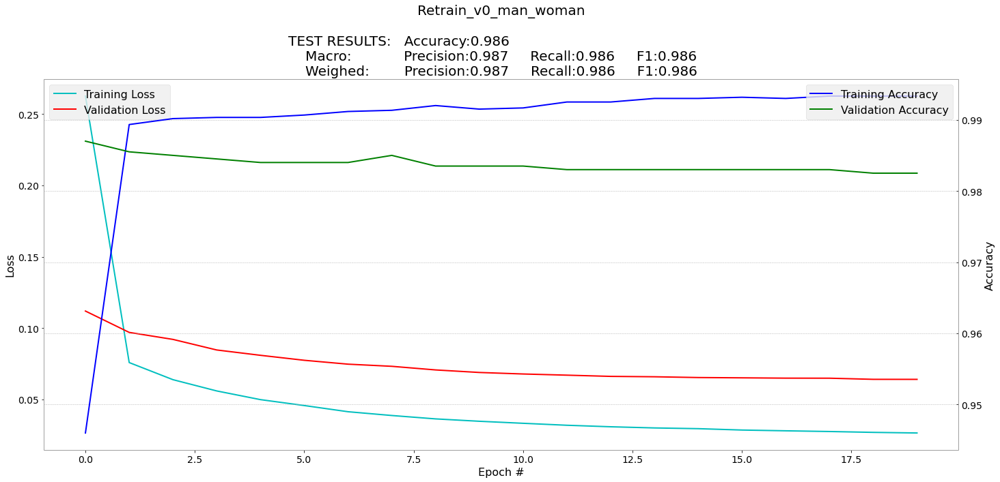

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.98375
True: 0.98425
False: 0.98325

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
# xfc = Dense(16, activation="relu")(xfc)
# xfc = Dropout(0.9)(xfc)
# xfc = Dense(128, activation="relu")(xfc)
predictions = Dense(2, activation="softmax")(xfc)

# Unimos las entradas y el modelo mediante la función Model con parámetros inputs y ouputs (Consultar la documentación)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

# Unimos las entradas y el modelo mediante la función Model con parámetros inputs y ouputs (Consultar la documentación)
Data['Trained Model'].summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten (Flatten)            (None, 512)               0         
_________________________________________________________________
dense (Dense)                (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.1,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=100, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))



Epoch 1/100
47/47 [==============================] - 3s 9ms/step - loss: 0.0916 - accuracy: 0.9775 - val_loss: 0.1134 - val_accuracy: 0.9855
Epoch 2/100
47/47 [==============================] - 0s 4ms/step - loss: 0.0557 - accuracy: 0.9907 - val_loss: 0.0977 - val_accuracy: 0.9850
Epoch 3/100
47/47 [==============================] - 0s 4ms/step - loss: 0.0434 - accuracy: 0.9918 - val_loss: 0.0922 - val_accuracy: 0.9850
Epoch 4/100
47/47 [==============================] - 0s 4ms/step - loss: 0.0381 - accuracy: 0.9920 - val_loss: 0.0884 - val_accuracy: 0.9850
Epoch 5/100
47/47 [==============================] - 0s 4ms/step - loss: 0.0338 - accuracy: 0.9923 - val_loss: 0.0841 - val_accuracy: 0.9840
Epoch 6/100
47/47 [==============================] - 0s 5ms/step - loss: 0.0327 - accuracy: 0.9920 - val_loss: 0.0836 - val_accuracy: 0.9850
Epoch 7/100
47/47 [==============================] - 0s 5ms/step - loss: 0.0303 - accuracy: 0.9930 - val_loss: 0.0820 - val_accuracy: 0.9840
Epoch 8/100
4

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.98375
True: 0.98425
False: 0.98325
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      4000
           1       0.98      0.98      0.98      4000

    accuracy                           0.98      8000
   macro avg       0.98      0.98      0.98      8000
weighted avg       0.98      0.98      0.98      8000



#### Gráfico de entrenamiento

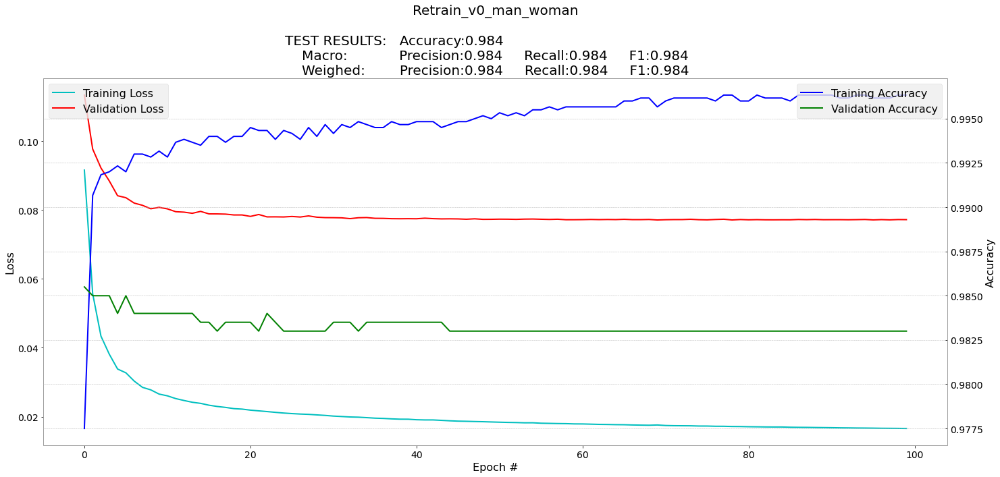

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.987375
True: 0.98975
False: 0.985

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
# xfc = Dense(16, activation="relu")(xfc)
# xfc = Dropout(0.9)(xfc)
# xfc = Dense(128, activation="relu")(xfc)
predictions = Dense(2, activation="softmax")(xfc)

# Unimos las entradas y el modelo mediante la función Model con parámetros inputs y ouputs (Consultar la documentación)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

# Unimos las entradas y el modelo mediante la función Model con parámetros inputs y ouputs (Consultar la documentación)
Data['Trained Model'].summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.01,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))



Epoch 1/1000
47/47 [==============================] - 1s 13ms/step - loss: 0.1479 - accuracy: 0.9673 - val_loss: 0.0803 - val_accuracy: 0.9860
Epoch 2/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.0648 - accuracy: 0.9895 - val_loss: 0.0687 - val_accuracy: 0.9865
Epoch 3/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.0567 - accuracy: 0.9898 - val_loss: 0.0636 - val_accuracy: 0.9870
Epoch 4/1000
47/47 [==============================] - 0s 6ms/step - loss: 0.0523 - accuracy: 0.9900 - val_loss: 0.0607 - val_accuracy: 0.9870
Epoch 5/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.0493 - accuracy: 0.9903 - val_loss: 0.0590 - val_accuracy: 0.9870
Epoch 6/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.0472 - accuracy: 0.9908 - val_loss: 0.0576 - val_accuracy: 0.9865
Epoch 7/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.0457 - accuracy: 0.9910 - val_loss: 0.0566 - val_accuracy: 0.9870
Epoch

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.987375
True: 0.98975
False: 0.985
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      4000
           1       0.99      0.98      0.99      4000

    accuracy                           0.99      8000
   macro avg       0.99      0.99      0.99      8000
weighted avg       0.99      0.99      0.99      8000



#### Gráfico de entrenamiento

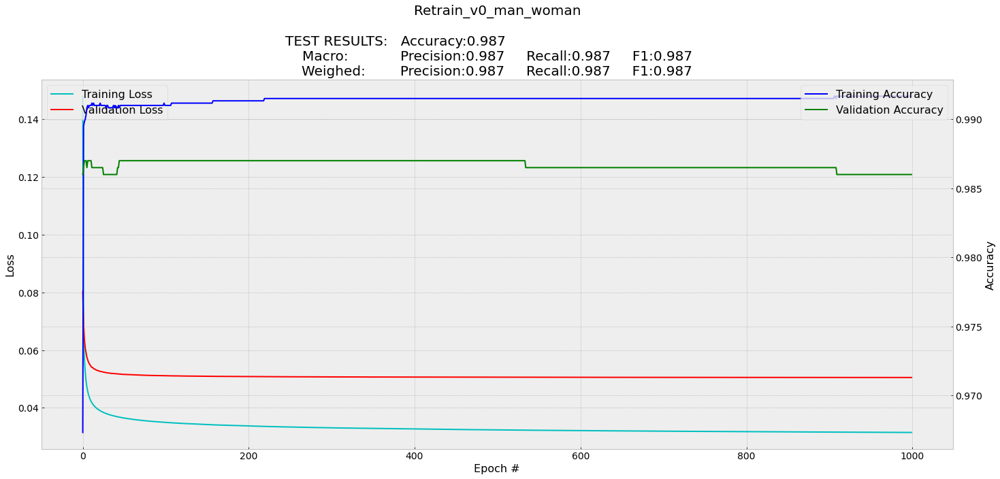

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.988
True: 0.99125
False: 0.98475

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
# xfc = Dense(16, activation="relu")(xfc)
# xfc = Dropout(0.9)(xfc)
# xfc = Dense(128, activation="relu")(xfc)
predictions = Dense(2, activation="softmax")(xfc)

# Unimos las entradas y el modelo mediante la función Model con parámetros inputs y ouputs (Consultar la documentación)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

# Unimos las entradas y el modelo mediante la función Model con parámetros inputs y ouputs (Consultar la documentación)
Data['Trained Model'].summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=100, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))



Epoch 1/100
47/47 [==============================] - 1s 8ms/step - loss: 0.6940 - accuracy: 0.5550 - val_loss: 0.6739 - val_accuracy: 0.5710
Epoch 2/100
47/47 [==============================] - 0s 5ms/step - loss: 0.6455 - accuracy: 0.6212 - val_loss: 0.6281 - val_accuracy: 0.6245
Epoch 3/100
47/47 [==============================] - 0s 4ms/step - loss: 0.6021 - accuracy: 0.6852 - val_loss: 0.5864 - val_accuracy: 0.6940
Epoch 4/100
47/47 [==============================] - 0s 5ms/step - loss: 0.5624 - accuracy: 0.7433 - val_loss: 0.5485 - val_accuracy: 0.7510
Epoch 5/100
47/47 [==============================] - 0s 5ms/step - loss: 0.5261 - accuracy: 0.7947 - val_loss: 0.5138 - val_accuracy: 0.7950
Epoch 6/100
47/47 [==============================] - 0s 5ms/step - loss: 0.4928 - accuracy: 0.8332 - val_loss: 0.4820 - val_accuracy: 0.8375
Epoch 7/100
47/47 [==============================] - 0s 5ms/step - loss: 0.4623 - accuracy: 0.8667 - val_loss: 0.4529 - val_accuracy: 0.8680
Epoch 8/100
4

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.988
True: 0.99125
False: 0.98475
              precision    recall  f1-score   support

           0       0.98      0.99      0.99      4000
           1       0.99      0.98      0.99      4000

    accuracy                           0.99      8000
   macro avg       0.99      0.99      0.99      8000
weighted avg       0.99      0.99      0.99      8000



#### Gráfico de entrenamiento

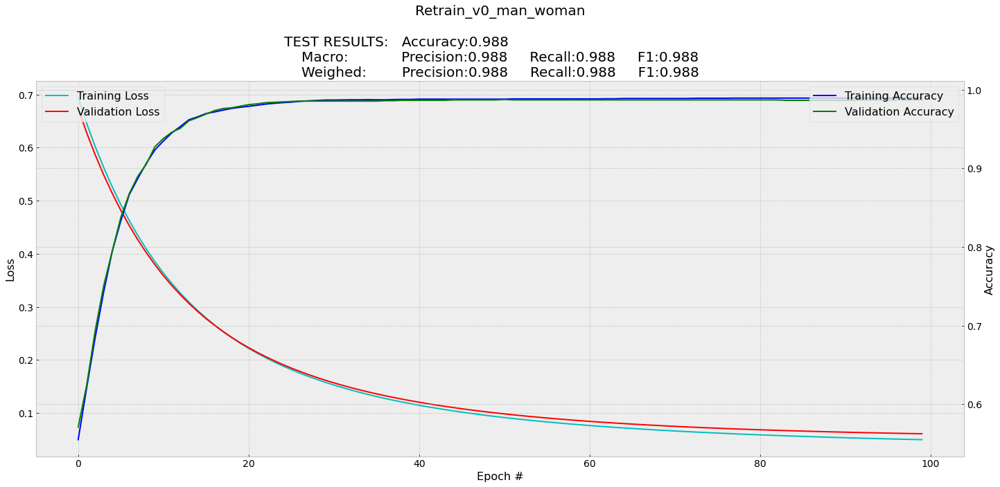

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.987
True: 0.98925
False: 0.98475

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
# xfc = Dense(16, activation="relu")(xfc)
# xfc = Dropout(0.9)(xfc)
# xfc = Dense(128, activation="relu")(xfc)
predictions = Dense(2, activation="softmax")(xfc)

# Unimos las entradas y el modelo mediante la función Model con parámetros inputs y ouputs (Consultar la documentación)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

# Unimos las entradas y el modelo mediante la función Model con parámetros inputs y ouputs (Consultar la documentación)
Data['Trained Model'].summary()

Model: "model_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_10 (InputLayer)        [(None, 1, 512)]          0         
_________________________________________________________________
flatten_9 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=500, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))



Epoch 1/500
47/47 [==============================] - 1s 7ms/step - loss: 0.7914 - accuracy: 0.4993 - val_loss: 0.7677 - val_accuracy: 0.4875
Epoch 2/500
47/47 [==============================] - 0s 4ms/step - loss: 0.7226 - accuracy: 0.5218 - val_loss: 0.7049 - val_accuracy: 0.5275
Epoch 3/500
47/47 [==============================] - 0s 4ms/step - loss: 0.6684 - accuracy: 0.5710 - val_loss: 0.6541 - val_accuracy: 0.5860
Epoch 4/500
47/47 [==============================] - 0s 4ms/step - loss: 0.6227 - accuracy: 0.6312 - val_loss: 0.6104 - val_accuracy: 0.6555
Epoch 5/500
47/47 [==============================] - 0s 4ms/step - loss: 0.5826 - accuracy: 0.6913 - val_loss: 0.5719 - val_accuracy: 0.7060
Epoch 6/500
47/47 [==============================] - 0s 4ms/step - loss: 0.5466 - accuracy: 0.7432 - val_loss: 0.5372 - val_accuracy: 0.7590
Epoch 7/500
47/47 [==============================] - 0s 4ms/step - loss: 0.5139 - accuracy: 0.7878 - val_loss: 0.5056 - val_accuracy: 0.8035
Epoch 8/500
4

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.987
True: 0.98925
False: 0.98475
              precision    recall  f1-score   support

           0       0.98      0.99      0.99      4000
           1       0.99      0.98      0.99      4000

    accuracy                           0.99      8000
   macro avg       0.99      0.99      0.99      8000
weighted avg       0.99      0.99      0.99      8000



#### Gráfico de entrenamiento

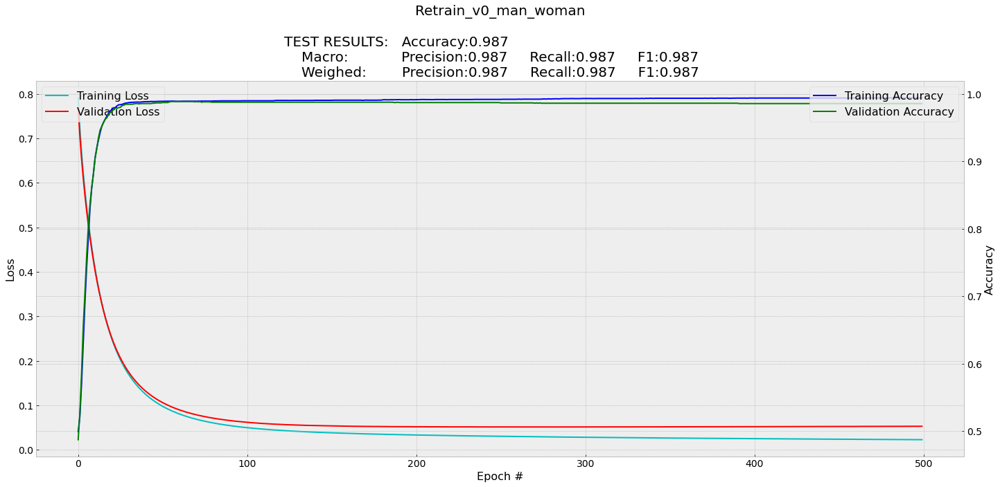

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19
All: 0.927 
True: 0.9145 
False: 0.9395

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=15, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/15
47/47 [==============================] - 57s 1s/step - loss: 0.7831 - accuracy: 0.7637 - val_loss: 0.3337 - val_accuracy: 0.8470
Epoch 2/15
47/47 [==============================] - 49s 1s/step - loss: 0.2787 - accuracy: 0.8818 - val_loss: 0.2789 - val_accuracy: 0.8840
Epoch 3/15
47/47 [==============================] - 49s 1s/step - loss: 0.1961 - accuracy: 0.9223 - val_loss: 0.2905 - val_accuracy: 0.8840
Epoch 4/15
47/47 [==============================] - 49s 1s/step - loss: 0.1337 - accuracy: 0.9470 - val_loss: 0.2288 - val_accuracy: 0.9125
Epoch 5/15
47/47 [==============================] - 49s 1s/step - loss: 0.0899 - accuracy: 0.9660 - val_loss: 0.2368 - val_accuracy: 0.9125
Epoch 6/15
47/47 [==============================] - 49s 1s/step - loss: 0.0498 - accuracy: 0.9845 - val_loss: 0.3046 - val_accuracy: 0.9080
Epoch 7/15
47/47 [==============================] - 49s 1s/step - loss: 0.0300 - accuracy: 0.9905 - val_loss: 0.2831 - val_accuracy: 0.9130
Epoch 8/15
47/47 [==

2873

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.927
True: 0.9145
False: 0.9395
              precision    recall  f1-score   support

           0       0.94      0.91      0.93      4000
           1       0.92      0.94      0.93      4000

    accuracy                           0.93      8000
   macro avg       0.93      0.93      0.93      8000
weighted avg       0.93      0.93      0.93      8000



#### Gráfico de entrenamiento

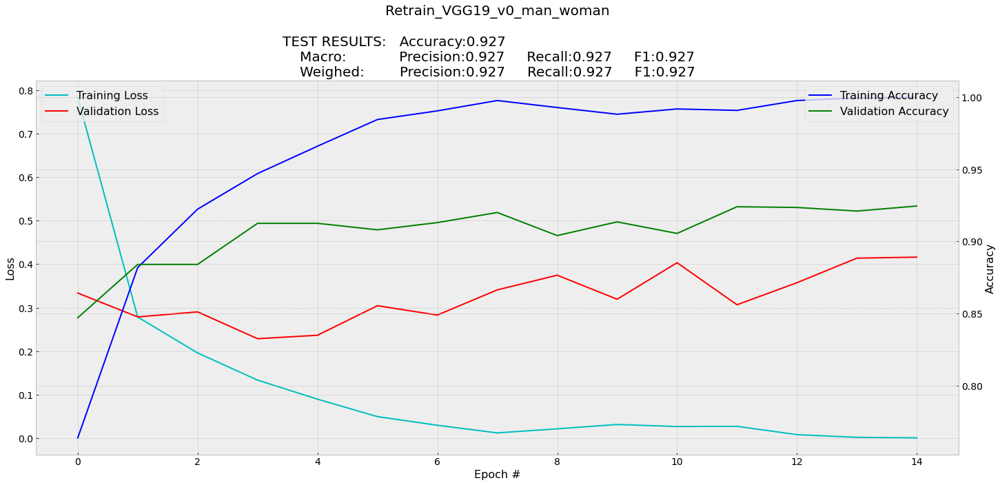

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19
All: 0.916125
True: 0.913
False: 0.91925

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=25, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/25
47/47 [==============================] - 52s 1s/step - loss: 0.6783 - accuracy: 0.7672 - val_loss: 0.3372 - val_accuracy: 0.8630
Epoch 2/25
47/47 [==============================] - 51s 1s/step - loss: 0.2490 - accuracy: 0.8962 - val_loss: 0.3152 - val_accuracy: 0.8730
Epoch 3/25
47/47 [==============================] - 51s 1s/step - loss: 0.1506 - accuracy: 0.9428 - val_loss: 0.2379 - val_accuracy: 0.9020
Epoch 4/25
47/47 [==============================] - 51s 1s/step - loss: 0.1081 - accuracy: 0.9595 - val_loss: 0.2698 - val_accuracy: 0.9090
Epoch 5/25
47/47 [==============================] - 51s 1s/step - loss: 0.0504 - accuracy: 0.9843 - val_loss: 0.3051 - val_accuracy: 0.9080
Epoch 6/25
47/47 [==============================] - 51s 1s/step - loss: 0.0299 - accuracy: 0.9907 - val_loss: 0.3131 - val_accuracy: 0.9090
Epoch 7/25
47/47 [==============================] - 51s 1s/step - loss: 0.0084 - accuracy: 0.9992 - val_loss: 0.3914 - val_accuracy: 0.9125
Epoch 8/25
47/47 [==

11058

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.916125
True: 0.913
False: 0.91925
              precision    recall  f1-score   support

           0       0.92      0.91      0.92      4000
           1       0.91      0.92      0.92      4000

    accuracy                           0.92      8000
   macro avg       0.92      0.92      0.92      8000
weighted avg       0.92      0.92      0.92      8000



#### Gráfico de entrenamiento

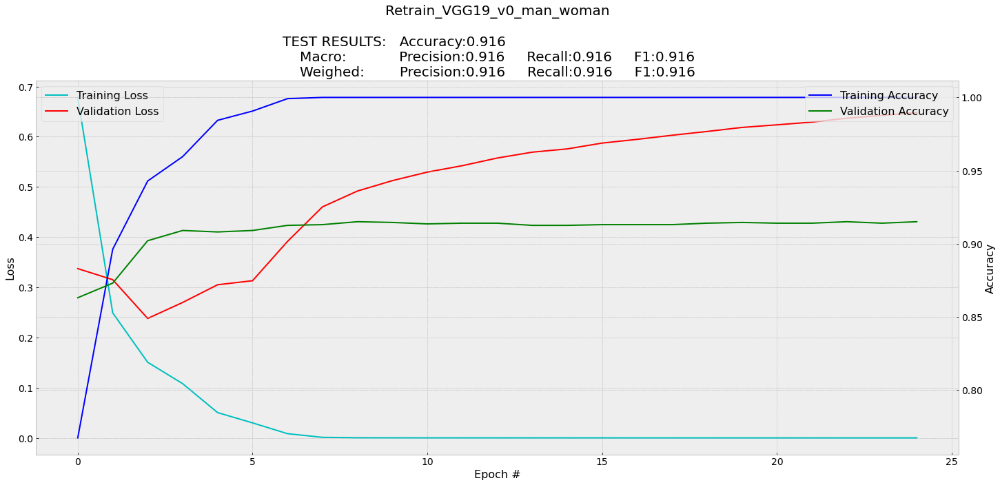

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

#### Guardar modelo

In [ ]:
# Data['Trained Model'].save(BASE_FOLDER+'VGG19_retraining_smile_vX00'+".h5")
# print(BASE_FOLDER+'Xception_retraining_smile_vX00'+".h5")
gc.collect()

5634

### VGG19
All: 0.90125
True: 0.9215
False: 0.881

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 

x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))
gc.collect()

Epoch 1/20
47/47 [==============================] - 52s 1s/step - loss: 0.8818 - accuracy: 0.6998 - val_loss: 0.4111 - val_accuracy: 0.8115
Epoch 2/20
47/47 [==============================] - 50s 1s/step - loss: 0.3429 - accuracy: 0.8462 - val_loss: 0.3199 - val_accuracy: 0.8620
Epoch 3/20
47/47 [==============================] - 50s 1s/step - loss: 0.2724 - accuracy: 0.8845 - val_loss: 0.2957 - val_accuracy: 0.8765
Epoch 4/20
47/47 [==============================] - 50s 1s/step - loss: 0.1917 - accuracy: 0.9197 - val_loss: 0.2794 - val_accuracy: 0.8815
Epoch 5/20
47/47 [==============================] - 50s 1s/step - loss: 0.1202 - accuracy: 0.9560 - val_loss: 0.2602 - val_accuracy: 0.8960
Epoch 6/20
47/47 [==============================] - 50s 1s/step - loss: 0.0864 - accuracy: 0.9653 - val_loss: 0.2883 - val_accuracy: 0.8815
Epoch 7/20
47/47 [==============================] - 50s 1s/step - loss: 0.0760 - accuracy: 0.9685 - val_loss: 0.3296 - val_accuracy: 0.9030
Epoch 8/20
47/47 [==

10933

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.90125
True: 0.9215
False: 0.881
              precision    recall  f1-score   support

           0       0.89      0.92      0.90      4000
           1       0.92      0.88      0.90      4000

    accuracy                           0.90      8000
   macro avg       0.90      0.90      0.90      8000
weighted avg       0.90      0.90      0.90      8000



#### Gráfico de entrenamiento

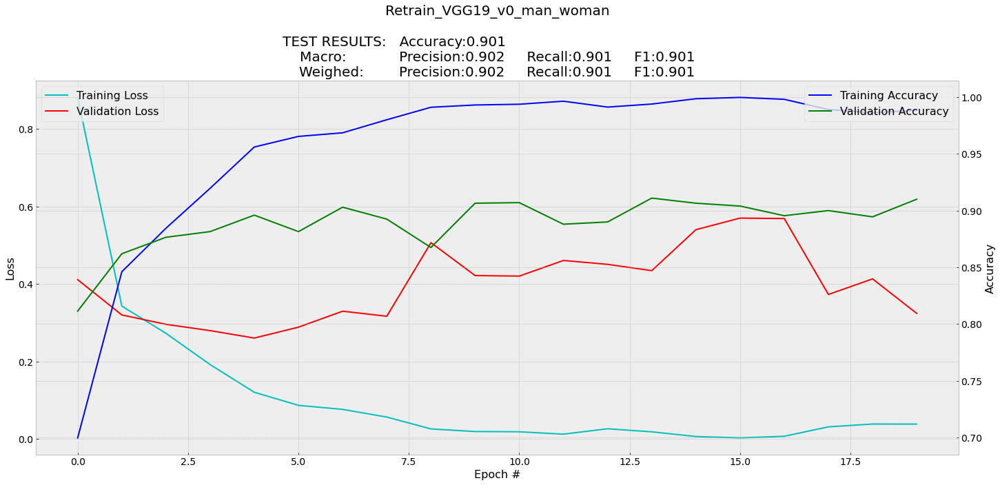

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19
All: 0.8825
True: 0.8825
False: 0.8825

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 

x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

80150528/80134624 [==============================] - 1s 0us/step
Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
____________________________________________________________

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=25, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))
gc.collect()

Epoch 1/25
47/47 [==============================] - 113s 2s/step - loss: 1.3492 - accuracy: 0.7283 - val_loss: 0.5393 - val_accuracy: 0.7875
Epoch 2/25
47/47 [==============================] - 51s 1s/step - loss: 0.3412 - accuracy: 0.8603 - val_loss: 0.4495 - val_accuracy: 0.8205
Epoch 3/25
47/47 [==============================] - 51s 1s/step - loss: 0.2328 - accuracy: 0.9068 - val_loss: 0.4174 - val_accuracy: 0.8450
Epoch 4/25
47/47 [==============================] - 51s 1s/step - loss: 0.1622 - accuracy: 0.9435 - val_loss: 0.4143 - val_accuracy: 0.8455
Epoch 5/25
47/47 [==============================] - 51s 1s/step - loss: 0.1097 - accuracy: 0.9658 - val_loss: 0.4238 - val_accuracy: 0.8565
Epoch 6/25
47/47 [==============================] - 51s 1s/step - loss: 0.0738 - accuracy: 0.9815 - val_loss: 0.4368 - val_accuracy: 0.8635
Epoch 7/25
47/47 [==============================] - 51s 1s/step - loss: 0.0478 - accuracy: 0.9905 - val_loss: 0.4536 - val_accuracy: 0.8665
Epoch 8/25
47/47 [=

19259

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.8825
True: 0.8825
False: 0.8825
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      4000
           1       0.88      0.88      0.88      4000

    accuracy                           0.88      8000
   macro avg       0.88      0.88      0.88      8000
weighted avg       0.88      0.88      0.88      8000



#### Gráfico de entrenamiento

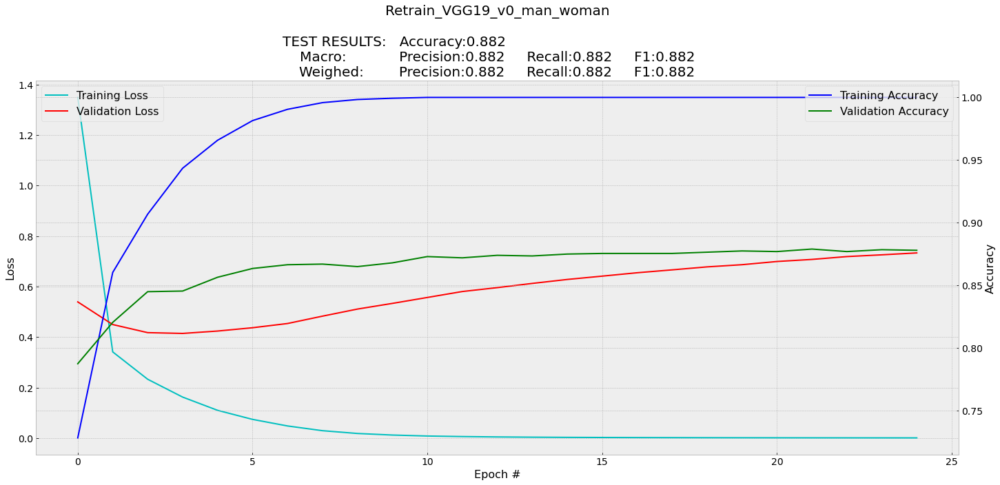

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All:0.8915 
True: 0.87775 
False: 0.90525

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_5[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=30, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/30
47/47 [==============================] - 70s 1s/step - loss: 0.4560 - accuracy: 0.7758 - val_loss: 0.3420 - val_accuracy: 0.8725
Epoch 2/30
47/47 [==============================] - 60s 1s/step - loss: 0.1673 - accuracy: 0.9397 - val_loss: 0.3074 - val_accuracy: 0.8820
Epoch 3/30
47/47 [==============================] - 60s 1s/step - loss: 0.0694 - accuracy: 0.9820 - val_loss: 0.3195 - val_accuracy: 0.8840
Epoch 4/30
47/47 [==============================] - 60s 1s/step - loss: 0.0267 - accuracy: 0.9963 - val_loss: 0.3233 - val_accuracy: 0.8875
Epoch 5/30
47/47 [==============================] - 60s 1s/step - loss: 0.0100 - accuracy: 0.9995 - val_loss: 0.3280 - val_accuracy: 0.8930
Epoch 6/30
47/47 [==============================] - 60s 1s/step - loss: 0.0052 - accuracy: 0.9998 - val_loss: 0.3399 - val_accuracy: 0.8930
Epoch 7/30
47/47 [==============================] - 60s 1s/step - loss: 0.0035 - accuracy: 1.0000 - val_loss: 0.3549 - val_accuracy: 0.8915
Epoch 8/30
47/47 [==

17325

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.8915
True: 0.87775
False: 0.90525
              precision    recall  f1-score   support

           0       0.90      0.88      0.89      4000
           1       0.88      0.91      0.89      4000

    accuracy                           0.89      8000
   macro avg       0.89      0.89      0.89      8000
weighted avg       0.89      0.89      0.89      8000



#### Gráfico de entrenamiento

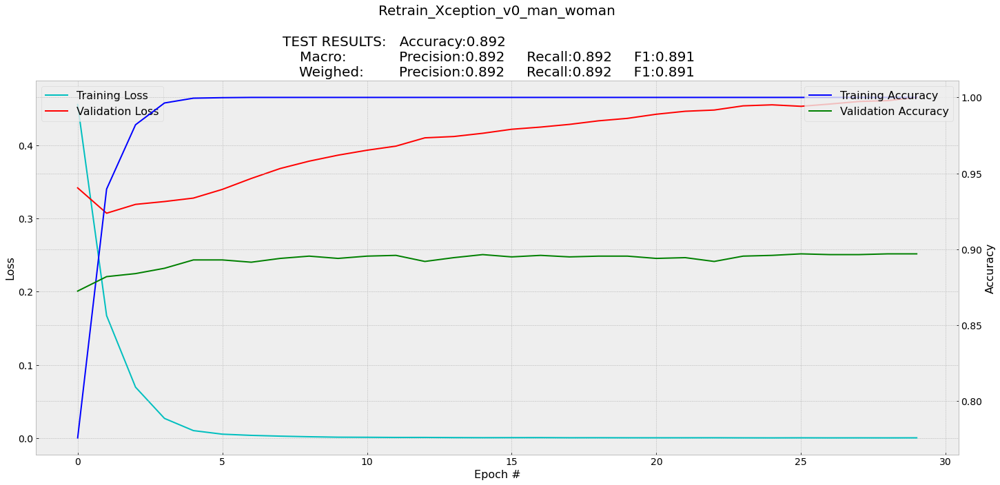

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception
All: 0.8865
True: 0.878
False: 0.895

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_9[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=40, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))
gc.collect()

Epoch 1/40
47/47 [==============================] - 68s 1s/step - loss: 0.4618 - accuracy: 0.7748 - val_loss: 0.3150 - val_accuracy: 0.8785
Epoch 2/40
47/47 [==============================] - 62s 1s/step - loss: 0.1697 - accuracy: 0.9393 - val_loss: 0.3134 - val_accuracy: 0.8835
Epoch 3/40
47/47 [==============================] - 62s 1s/step - loss: 0.0691 - accuracy: 0.9825 - val_loss: 0.3085 - val_accuracy: 0.8910
Epoch 4/40
47/47 [==============================] - 62s 1s/step - loss: 0.0249 - accuracy: 0.9972 - val_loss: 0.3198 - val_accuracy: 0.8875
Epoch 5/40
47/47 [==============================] - 62s 1s/step - loss: 0.0099 - accuracy: 0.9998 - val_loss: 0.3302 - val_accuracy: 0.8925
Epoch 6/40
47/47 [==============================] - 62s 1s/step - loss: 0.0052 - accuracy: 1.0000 - val_loss: 0.3403 - val_accuracy: 0.8940
Epoch 7/40
47/47 [==============================] - 62s 1s/step - loss: 0.0035 - accuracy: 1.0000 - val_loss: 0.3656 - val_accuracy: 0.8930
Epoch 8/40
47/47 [==

26936

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.8865
True: 0.878
False: 0.895
              precision    recall  f1-score   support

           0       0.89      0.88      0.89      4000
           1       0.88      0.90      0.89      4000

    accuracy                           0.89      8000
   macro avg       0.89      0.89      0.89      8000
weighted avg       0.89      0.89      0.89      8000



#### Gráfico de entrenamiento

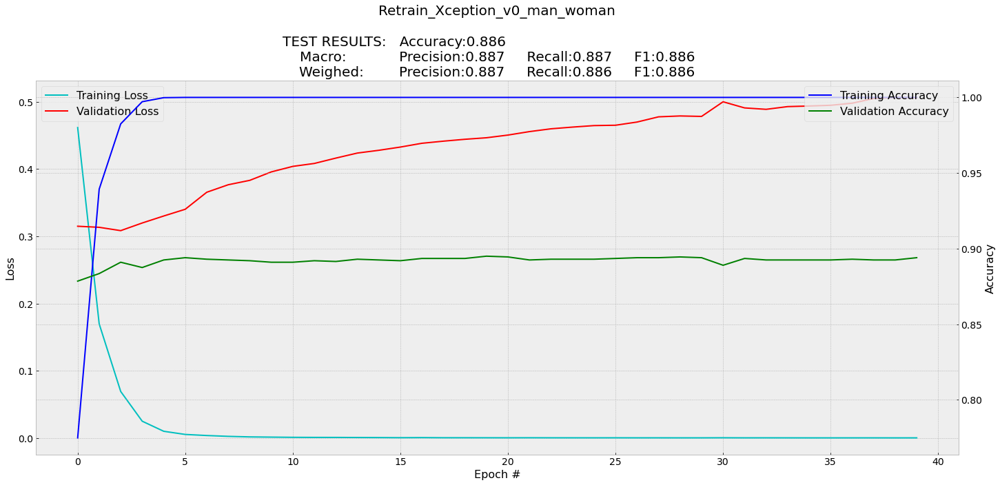

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception
All: 0.89775
True: 0.8805
False: 0.915

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_8[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))
gc.collect()

Epoch 1/20
47/47 [==============================] - 68s 1s/step - loss: 0.3942 - accuracy: 0.8142 - val_loss: 0.3560 - val_accuracy: 0.8790
Epoch 2/20
47/47 [==============================] - 62s 1s/step - loss: 0.0923 - accuracy: 0.9677 - val_loss: 0.3268 - val_accuracy: 0.8915
Epoch 3/20
47/47 [==============================] - 62s 1s/step - loss: 0.0174 - accuracy: 0.9990 - val_loss: 0.3566 - val_accuracy: 0.8945
Epoch 4/20
47/47 [==============================] - 62s 1s/step - loss: 0.0042 - accuracy: 1.0000 - val_loss: 0.3442 - val_accuracy: 0.8995
Epoch 5/20
47/47 [==============================] - 62s 1s/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 0.3493 - val_accuracy: 0.8965
Epoch 6/20
47/47 [==============================] - 62s 1s/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 0.3616 - val_accuracy: 0.8975
Epoch 7/20
47/47 [==============================] - 62s 1s/step - loss: 8.4548e-04 - accuracy: 1.0000 - val_loss: 0.3680 - val_accuracy: 0.8970
Epoch 8/20
47/47

26749

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.89775
True: 0.8805
False: 0.915
              precision    recall  f1-score   support

           0       0.91      0.88      0.90      4000
           1       0.88      0.92      0.90      4000

    accuracy                           0.90      8000
   macro avg       0.90      0.90      0.90      8000
weighted avg       0.90      0.90      0.90      8000



#### Gráfico de entrenamiento

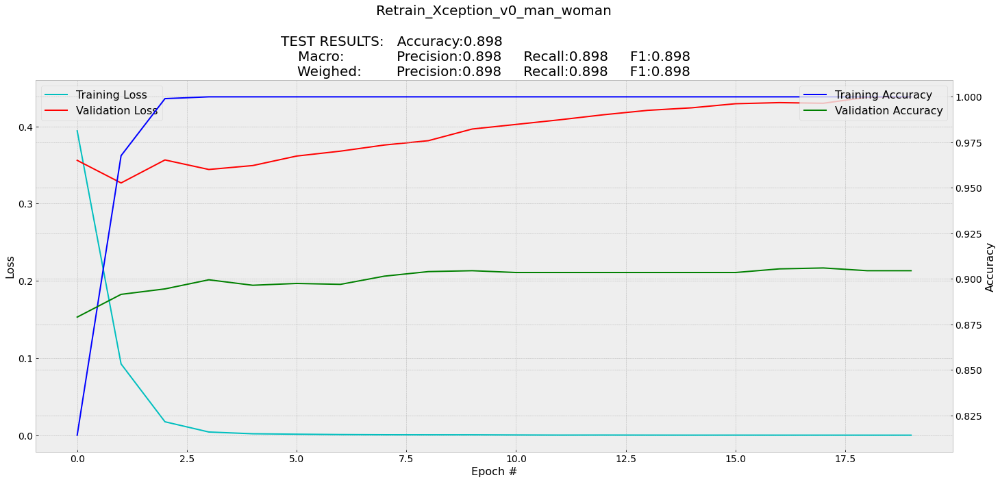

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception
All: 0.87225
True: 0.85225
False: 0.89225

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

83697664/83683744 [==============================] - 2s 0us/step
Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_7[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
___________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=30, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))
gc.collect()

Epoch 1/30
47/47 [==============================] - 76s 1s/step - loss: 0.5887 - accuracy: 0.6898 - val_loss: 0.3822 - val_accuracy: 0.8385
Epoch 2/30
47/47 [==============================] - 62s 1s/step - loss: 0.4103 - accuracy: 0.8355 - val_loss: 0.3539 - val_accuracy: 0.8520
Epoch 3/30
47/47 [==============================] - 62s 1s/step - loss: 0.3177 - accuracy: 0.8848 - val_loss: 0.3414 - val_accuracy: 0.8545
Epoch 4/30
47/47 [==============================] - 62s 1s/step - loss: 0.2537 - accuracy: 0.9113 - val_loss: 0.3321 - val_accuracy: 0.8650
Epoch 5/30
47/47 [==============================] - 62s 1s/step - loss: 0.2023 - accuracy: 0.9338 - val_loss: 0.3259 - val_accuracy: 0.8715
Epoch 6/30
47/47 [==============================] - 62s 1s/step - loss: 0.1594 - accuracy: 0.9520 - val_loss: 0.3232 - val_accuracy: 0.8690
Epoch 7/30
47/47 [==============================] - 62s 1s/step - loss: 0.1264 - accuracy: 0.9653 - val_loss: 0.3212 - val_accuracy: 0.8705
Epoch 8/30
47/47 [==

1974

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.87225
True: 0.85225
False: 0.89225
              precision    recall  f1-score   support

           0       0.89      0.85      0.87      4000
           1       0.86      0.89      0.87      4000

    accuracy                           0.87      8000
   macro avg       0.87      0.87      0.87      8000
weighted avg       0.87      0.87      0.87      8000



#### Gráfico de entrenamiento

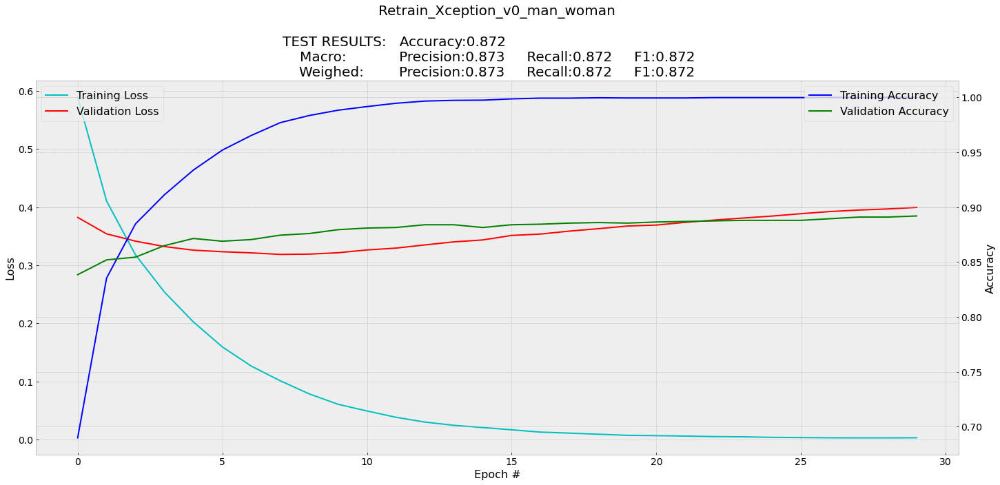

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

# Etiqueta Celeba: "smiling"

## Proceso

### CLIP crear "prompt" y preparar parámetros

In [ ]:
import torch
import clip
from PIL import Image
import glob

Name_feature='_smile'
id_feature=31
Save_Data_Path=BASE_FOLDER_2+'Retrain_v0'+Name_feature+'.pkl'

Index_To_Test=[]
Label_To_Test=[]
Data_To_Train=[]
Label_To_Train=[]
Data = {'Training':{}, 'Model Name':{}, 'H':{}, 'Classes':{}}
Data['Training']={'Images':{},'Images array':{}, 'Classes':{}, 'Classes array':{}, 'Index':{}, 'H':{}}
Data['Training']['Images']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Images array']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes array']={'Train':{}, 'Validate':{}}

clip_tokens=[ 'A picture of a person', 'A picture of a person who is smiling']
N_Tokens=len(clip_tokens)
print(N_Tokens)
print(clip_tokens)
for current_token in clip_tokens:
    print(current_token)

# [ 'A picture of a person',"A picture of a person with 5 o'clock shadow",'A picture of a person with arched eyebrows',
# 'A picture of an attractive person','A picture of a person with bags under eyes',
# 'A picture of a bald person','A picture of a person with bangs','A picture of a person with big lips',
# 'A picture of a person with big nose','A picture of a person with black hair',
# 'A picture of a person with blond hair','A blurry picture of a person',
# 'A picture of a person with brown hair','A picture of a person with bushy eyebrows',
# 'A picture of a chubby person','A picture of a person with double chin','A picture of a person with eyeglasses',
# 'A picture of a person with goatee','A picture of a person with gray hair','A picture of a person with heavy makeup',
# 'A picture of a person with high cheekbones','A picture of a male person',
# 'A picture of a person with mouth slightly open','A picture of a person with mustache',
# 'A picture of a person with narrow eyes','A picture of a person with no beard',
# 'A picture of a person with oval face','A picture of a person with pale skin','A picture of a person with pointy nose',
# 'A picture of a person with receding hairline','A picture of a person with rosy cheeks','A picture of a person with sideburns',
# 'A picture of a person who is smiling','A picture of a person with straight hair','A picture of a person with wavy hair',
# 'A picture of a person with earrings','A picture of a person with hat','A picture of a person with lipstick',
# 'A picture of a person with necklace','A picture of a person with necktie','A picture of a young person']

2
['A picture of a person', 'A picture of a person who is smiling']
A picture of a person
A picture of a person who is smiling


### Cargar CLIP

In [ ]:
clip_device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, clip_transform = clip.load("ViT-B/32", device=clip_device)
clip_text = clip.tokenize(clip_tokens).to(clip_device)

# CLIP features
text_features = clip_model.encode_text(clip_text)

test_index=1
test_image_path=Path_images+str(test_index).zfill(6)+'.jpg'
img_proeprocessed = clip_transform(Image.open(test_image_path)).unsqueeze(0).to(clip_device)
img_features = clip_model.encode_image(img_proeprocessed)
img_features_shape= img_features.shape

print('\n- Image Features:')
print('     Type:',type(img_features))
print('     Shape:',img_features_shape)
print('\n- Text Features:')
print('     Type:',type(text_features))
print('     Shape:',text_features.shape)
print('\n- Image Features Tensor:')
print(img_features)
print('\n- Text Features Tesor:')
print(text_features)

100%|████████████████████████████████████████| 338M/338M [00:02<00:00, 121MiB/s]



- Image Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([1, 512])

- Text Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([2, 512])

- Image Features Tensor:
tensor([[-6.0150e-02,  1.7044e-02, -9.9854e-02,  2.3523e-01, -6.8359e-02,
         -8.4814e-01, -3.7036e-01, -4.8169e-01, -3.1921e-02, -3.8666e-02,
         -5.1666e-02, -1.9775e-01,  6.2061e-01, -5.4565e-02,  7.4365e-01,
          4.4678e-02,  1.5791e+00, -4.6045e-01,  1.3513e-01, -1.4685e-01,
         -3.7012e-01, -3.7183e-01, -4.6509e-01, -2.8833e-01, -1.7578e-01,
         -1.3904e-01,  2.9028e-01, -9.5642e-02,  3.9746e-01,  1.3770e-01,
          5.1855e-01,  1.5613e-01,  8.7524e-02, -1.0674e-02, -9.4531e-01,
          2.2595e-01, -3.6133e-02,  4.6924e-01,  9.4604e-02,  1.5908e+00,
          2.1533e-01,  1.9360e-01, -5.3284e-02, -7.5500e-02, -6.1111e-03,
          1.4443e+00,  1.2891e-01,  5.3613e-01,  4.5630e-01,  3.9478e-01,
          1.7310e-01,  1.6138e-01, -2.8870e-02, -2.5464e-01, -1

### Seleccionar indices a usar del Dataset Celeba

In [ ]:
# encontrar indices smile true/false
Index_Features_True=[]
Index_Features_False=[]

i=0
for descripton in Description_data:
    i=i+1
    if descripton[id_feature]:
        Index_Features_True.append(i)
    else:
        Index_Features_False.append(i)

## Mostrar Results       
min_value=9999999
print('Examples of celeba:')
print(Description_labels[id_feature]+' -  True:',len(Index_Features_True))
print(Description_labels[id_feature]+' - False:',len(Index_Features_False))  

# Smiling -  True: 97669
# Smiling - False: 104930

Examples of celeba:
Smiling -  True: 97669
Smiling - False: 104930


### Cargar Datos (ejectuar si se dispone del archivo de datos creado)

In [ ]:
## LOAD DATA
file_to_load = open(Save_Data_Path, "rb")
df_loaded = pickle.load(file_to_load)
file_to_load.close()

Data=df_loaded['Data']
Index_To_Test=df_loaded['Index_To_Test']
Label_To_Test=df_loaded['Label_To_Test']
Data_To_Train=df_loaded['Data_To_Train']
Label_To_Train=df_loaded['Label_To_Train']

In [ ]:
print(len(Data['Training']['Images array']['Train']))
print(len(Data['Training']['Classes']['Train']))
print(len(Data['Training']['Images array']['Validate']))
print(len(Data['Training']['Classes']['Validate']))

6000
6000
2000
2000


### Preparar datos (ejectuar solo si no se dispone del archivo de datos creado)

In [ ]:
def Preprocess_img(images_id,clip_device,clip_model,clip_preprocess):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    return clip_model.encode_image(clip_img).detach().numpy(), np.array(img_current)
    # img_proeprocessed=[]
    # for img_i in images_id:
    #     test_image_path=Path_images+str(img_i).zfill(6)+'.jpg'
    #     img_current=Image.open(test_image_path)
    #     clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    #     img_proeprocessed.append(clip_model.encode_image(clip_img))
    # return img_proeprocessed

# Data['Training']['Images']['Test']=[]
# Data['Training']['Images']['Not Test']=[]
# Data['Training']['Classes']['Test']=[]
# Data['Training']['Classes']['Not Test']=[]
# Data['Training']['Images array']['Test']=[]
# Data['Training']['Images array']['Not Test']=[]

# for i in range(4000):
#     Index_To_Test.append(Index_Features_True[i])
#     Label_To_Test.append(clip_tokens[1])
#     img, img_arr=Preprocess_img(Index_Features_True[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Test'].append(img)
#     Data['Training']['Images array']['Test'].append(img_arr)
#     Data['Training']['Classes']['Test'].append(1)

#     Index_To_Test.append(Index_Features_False[i])
#     Label_To_Test.append(clip_tokens[0])
#     img, img_arr=Preprocess_img(Index_Features_False[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Test'].append(img)
#     Data['Training']['Images array']['Test'].append(img_arr)
#     Data['Training']['Classes']['Test'].append(0)

#     if i % 400 == 0 and i>0:
#         print('Test images load (%):',i/40)
#         df_to_save= {'Data': Data,
#                       'Index_To_Test':Index_To_Test,
#                       'Label_To_Test':Label_To_Test,
#                       'Data_To_Train':Data_To_Train,
#                       'Label_To_Train':Label_To_Train
#         }
#         save_df_to_file(df_to_save,Save_Data_Path)

#     # gc.collect() 

# for i in range(4000,8000):
#     Data_To_Train.append(Index_Features_True[i])
#     Label_To_Train.append(clip_tokens[1])
#     img, img_arr=Preprocess_img(Index_Features_True[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Not Test'].append(img)
#     Data['Training']['Images array']['Not Test'].append(img_arr)
#     Data['Training']['Classes']['Not Test'].append(1)
    
#     Data_To_Train.append(Index_Features_False[i])
#     Label_To_Train.append(clip_tokens[0])
#     img, img_arr=Preprocess_img(Index_Features_False[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Not Test'].append(img)
#     Data['Training']['Images array']['Not Test'].append(img_arr)
#     Data['Training']['Classes']['Not Test'].append(0)

#     if i % 400 == 0 and i>4000:
#         print('Train images load (%):',(i-4000)/40)
#         df_to_save= {'Data': Data,
#                       'Index_To_Test':Index_To_Test,
#                       'Label_To_Test':Label_To_Test,
#                       'Data_To_Train':Data_To_Train,
#                       'Label_To_Train':Label_To_Train
#         }
#         save_df_to_file(df_to_save,Save_Data_Path)
#     # gc.collect()

# Data['Classes']=[]
# for element in np.unique(Data['Training']['Classes']['Test']):
#     Data['Classes'].append(np.int(element))

# Data['Training']['Images']['Train'], Data['Training']['Images']['Validate'], Data['Training']['Classes']['Train'], Data['Training']['Classes']['Validate'] = train_test_split(Data['Training']['Images']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)
# Data['Training']['Images array']['Train'], Data['Training']['Images array']['Validate'], Data['Training']['Classes array']['Train'], Data['Training']['Classes array']['Validate'] = train_test_split(Data['Training']['Images array']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)

# df_to_save= {'Data': Data,
#               'Index_To_Test':Index_To_Test,
#               'Label_To_Test':Label_To_Test,
#               'Data_To_Train':Data_To_Train,
#               'Label_To_Train':Label_To_Train
# }
# save_df_to_file(df_to_save,Save_Data_Path)

# ## Visualizar número de entrenamiento
# print('NÚMERO DE DATOS PARA ENTRENAR/TEST')
# print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Not Test']),'con',len(np.unique(Data['Training']['Classes']['Test'])),'clases')
# print('Número de datos para Test:',  len(Data['Training']['Classes']['Test']),'con',len(np.unique(Data['Training']['Classes']['Not Test'])),'clases')

# ## Visualizar número de entrenamiento
# print('\nNÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN')
# print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Train']),'con',len(np.unique(Data['Training']['Classes']['Train'])),'clases')
# print('Número de datos para Validación:',  len(Data['Training']['Classes']['Validate']),'con',len(np.unique(Data['Training']['Classes']['Validate'])),'clases')


Test images load (%): 10.0
Test images load (%): 20.0
Test images load (%): 30.0
Test images load (%): 40.0
Test images load (%): 50.0
Test images load (%): 60.0
Test images load (%): 70.0
Test images load (%): 80.0
Test images load (%): 90.0
Train images load (%): 10.0
Train images load (%): 20.0
Train images load (%): 30.0
Train images load (%): 40.0
Train images load (%): 50.0
Train images load (%): 60.0
Train images load (%): 70.0
Train images load (%): 80.0
Train images load (%): 90.0
NÚMERO DE DATOS PARA ENTRENAR/TEST
Número de datos para Entrenamiento: 8000 con 2 clases
Número de datos para Test: 8000 con 2 clases

NÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN
Número de datos para Entrenamiento: 6000 con 2 clases
Número de datos para Validación: 2000 con 2 clases


## Modelos

### CLIP 
All: 0.88725 
True: 0.88425 
False: 0.89025

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)

# Unimos las entradas y el modelo mediante la función Model con parámetros inputs y ouputs (Consultar la documentación)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

# Unimos las entradas y el modelo mediante la función Model con parámetros inputs y ouputs (Consultar la documentación)
Data['Trained Model'].summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense (Dense)                (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.1,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 1s 5ms/step - loss: 0.8537 - accuracy: 0.7747 - val_loss: 0.3377 - val_accuracy: 0.8670
Epoch 2/20
47/47 [==============================] - 0s 2ms/step - loss: 0.3025 - accuracy: 0.8755 - val_loss: 0.2763 - val_accuracy: 0.8820
Epoch 3/20
47/47 [==============================] - 0s 2ms/step - loss: 0.2694 - accuracy: 0.8903 - val_loss: 0.2699 - val_accuracy: 0.8840
Epoch 4/20
47/47 [==============================] - 0s 2ms/step - loss: 0.2647 - accuracy: 0.8878 - val_loss: 0.2573 - val_accuracy: 0.8895
Epoch 5/20
47/47 [==============================] - 0s 2ms/step - loss: 0.2494 - accuracy: 0.8998 - val_loss: 0.2538 - val_accuracy: 0.8930
Epoch 6/20
47/47 [==============================] - 0s 2ms/step - loss: 0.2464 - accuracy: 0.8997 - val_loss: 0.2484 - val_accuracy: 0.8920
Epoch 7/20
47/47 [==============================] - 0s 2ms/step - loss: 0.2423 - accuracy: 0.9015 - val_loss: 0.2463 - val_accuracy: 0.8950
Epoch 8/20
47/47 [==

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.88725
True: 0.88425
False: 0.89025
              precision    recall  f1-score   support

           0       0.89      0.88      0.89      4000
           1       0.88      0.89      0.89      4000

    accuracy                           0.89      8000
   macro avg       0.89      0.89      0.89      8000
weighted avg       0.89      0.89      0.89      8000



#### Gráfico de entrenamiento

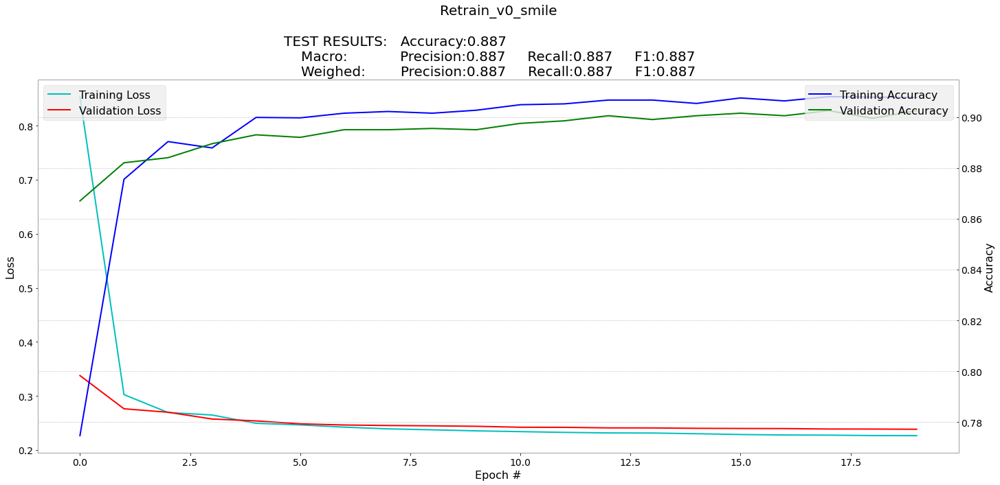

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP
All: 0.879 
True: 0.87425 
False: 0.88375

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)

Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

# Unimos las entradas y el modelo mediante la función Model con parámetros inputs y ouputs (Consultar la documentación)
Data['Trained Model'].summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.01,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=100, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))


Epoch 1/100
47/47 [==============================] - 1s 8ms/step - loss: 0.4813 - accuracy: 0.7728 - val_loss: 0.3975 - val_accuracy: 0.8450
Epoch 2/100
47/47 [==============================] - 0s 5ms/step - loss: 0.3803 - accuracy: 0.8447 - val_loss: 0.3636 - val_accuracy: 0.8595
Epoch 3/100
47/47 [==============================] - 0s 4ms/step - loss: 0.3574 - accuracy: 0.8542 - val_loss: 0.3483 - val_accuracy: 0.8685
Epoch 4/100
47/47 [==============================] - 0s 4ms/step - loss: 0.3446 - accuracy: 0.8623 - val_loss: 0.3391 - val_accuracy: 0.8710
Epoch 5/100
47/47 [==============================] - 0s 4ms/step - loss: 0.3364 - accuracy: 0.8667 - val_loss: 0.3319 - val_accuracy: 0.8750
Epoch 6/100
47/47 [==============================] - 0s 5ms/step - loss: 0.3303 - accuracy: 0.8708 - val_loss: 0.3264 - val_accuracy: 0.8775
Epoch 7/100
47/47 [==============================] - 0s 4ms/step - loss: 0.3253 - accuracy: 0.8715 - val_loss: 0.3225 - val_accuracy: 0.8795
Epoch 8/100
4

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.879
True: 0.87425
False: 0.88375
              precision    recall  f1-score   support

           0       0.88      0.87      0.88      4000
           1       0.88      0.88      0.88      4000

    accuracy                           0.88      8000
   macro avg       0.88      0.88      0.88      8000
weighted avg       0.88      0.88      0.88      8000



#### Gráfico de entrenamiento

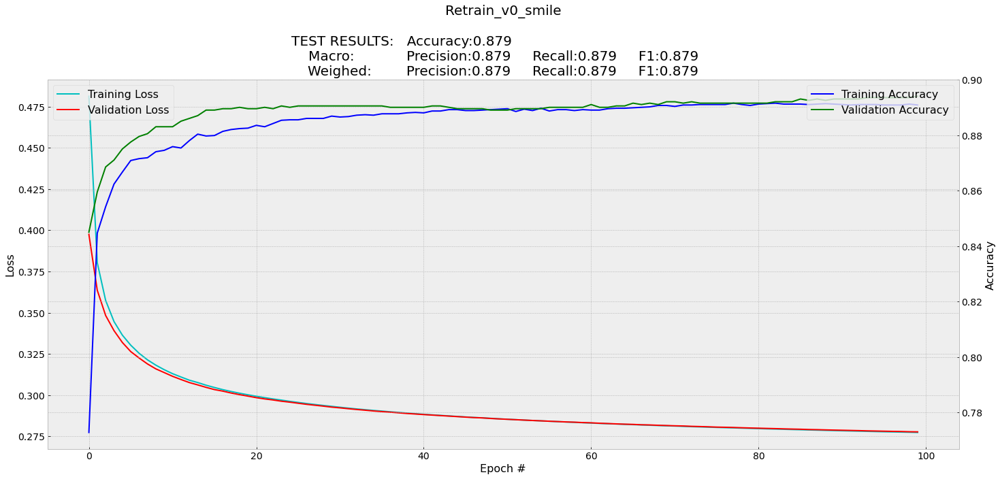

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19
All: 0.78425 
True: 0.806 
False: 0.7625

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# Data['VGG19 Model'].summary()
for layer in Data['VGG19 Model'].layers: 
  if layer.name == 'block4_conv1':  #  block5_conv1, block5_conv4 , block4_conv1
    break 
  layer.trainable = False 
  print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Capa input_6 congelada...
Capa block1_conv1 congelada...
Capa block1_conv2 congelada...
Capa block1_pool congelada...
Capa block2_conv1 congelada...
Capa block2_conv2 congelada...
Capa block2_pool congelada...
Capa block3_conv1 congelada...
Capa block3_conv2 congelada...
Capa block3_conv3 congelada...
Capa block3_conv4 congelada...
Capa block3_pool congelada...
Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________

#### Entrenar modelo

In [ ]:
# Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

# Se debe realizar un preprocesado de los datos de entrada proporcionado por  tensorflow.keras.applications.Xception
# Se multiplican los datos de entrada por 255, puesto que el preprocesado de Xception requiere datos de entrada entre 0 y 255
Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=30, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

# optimizer=Adam(lr=0.00075,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08) previous values
# lr=5e-5,  betas=(0.9,0.98),  eps=1e-6,  weight_decay=0.2       #Params used from paper, the lr is smaller, more safe for fine tuning to new dataset
gc.collect()

Epoch 1/30
47/47 [==============================] - 33s 634ms/step - loss: 1.0102 - accuracy: 0.5968 - val_loss: 0.6312 - val_accuracy: 0.6460
Epoch 2/30
47/47 [==============================] - 28s 594ms/step - loss: 0.5678 - accuracy: 0.7005 - val_loss: 0.5542 - val_accuracy: 0.7290
Epoch 3/30
47/47 [==============================] - 28s 598ms/step - loss: 0.4717 - accuracy: 0.7718 - val_loss: 0.5096 - val_accuracy: 0.7485
Epoch 4/30
47/47 [==============================] - 28s 597ms/step - loss: 0.4075 - accuracy: 0.8120 - val_loss: 0.5055 - val_accuracy: 0.7420
Epoch 5/30
47/47 [==============================] - 28s 595ms/step - loss: 0.3309 - accuracy: 0.8520 - val_loss: 0.5205 - val_accuracy: 0.7540
Epoch 6/30
47/47 [==============================] - 28s 599ms/step - loss: 0.2441 - accuracy: 0.8997 - val_loss: 0.5538 - val_accuracy: 0.7635
Epoch 7/30
47/47 [==============================] - 28s 599ms/step - loss: 0.1784 - accuracy: 0.9318 - val_loss: 0.6003 - val_accuracy: 0.7515

4899

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.78425
True: 0.806
False: 0.7625
              precision    recall  f1-score   support

           0       0.77      0.81      0.79      4000
           1       0.80      0.76      0.78      4000

    accuracy                           0.78      8000
   macro avg       0.78      0.78      0.78      8000
weighted avg       0.78      0.78      0.78      8000



#### Gráfico de entrenamiento

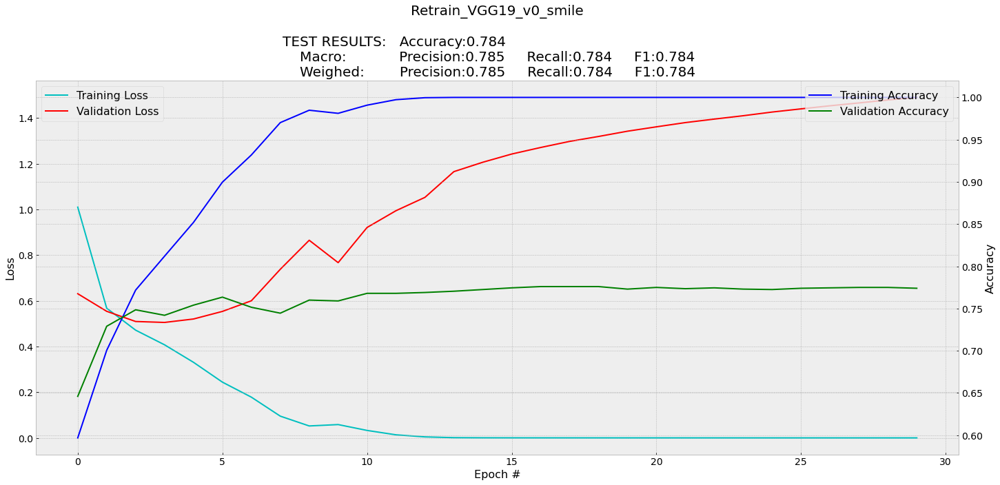

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

#### Guardar modelo

In [ ]:
# Data['Trained Model'].save(BASE_FOLDER+'VGG19_retraining_smile_vX00'+".h5")
# print(BASE_FOLDER+'Xception_retraining_smile_vX00'+".h5")
gc.collect()

5464

### VGG19 
All: 0.829125 
True: 0.846 
False: 0.81225

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block4_conv1':  #  block5_conv1, block5_conv4 , block4_conv1
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_9 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=30, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))
gc.collect()

Epoch 1/30
47/47 [==============================] - 57s 1s/step - loss: 0.9310 - accuracy: 0.5622 - val_loss: 0.6554 - val_accuracy: 0.6195
Epoch 2/30
47/47 [==============================] - 49s 1s/step - loss: 0.6187 - accuracy: 0.6602 - val_loss: 0.6094 - val_accuracy: 0.6605
Epoch 3/30
47/47 [==============================] - 50s 1s/step - loss: 0.5589 - accuracy: 0.7140 - val_loss: 0.5740 - val_accuracy: 0.7195
Epoch 4/30
47/47 [==============================] - 50s 1s/step - loss: 0.4619 - accuracy: 0.7827 - val_loss: 0.5067 - val_accuracy: 0.7485
Epoch 5/30
47/47 [==============================] - 50s 1s/step - loss: 0.3921 - accuracy: 0.8213 - val_loss: 0.5515 - val_accuracy: 0.7505
Epoch 6/30
47/47 [==============================] - 50s 1s/step - loss: 0.3581 - accuracy: 0.8347 - val_loss: 0.4201 - val_accuracy: 0.8040
Epoch 7/30
47/47 [==============================] - 50s 1s/step - loss: 0.2806 - accuracy: 0.8812 - val_loss: 0.4294 - val_accuracy: 0.8075
Epoch 8/30
47/47 [==

11420

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.829125
True: 0.846
False: 0.81225
              precision    recall  f1-score   support

           0       0.82      0.85      0.83      4000
           1       0.84      0.81      0.83      4000

    accuracy                           0.83      8000
   macro avg       0.83      0.83      0.83      8000
weighted avg       0.83      0.83      0.83      8000



#### Gráfico de entrenamiento

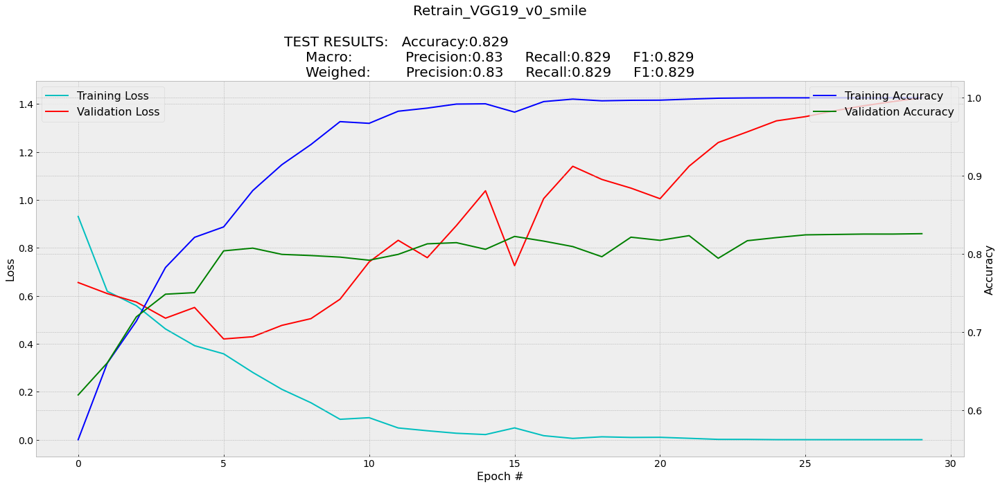

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.70075 
True: 0.682 
False: 0.7195

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block8_sepconv1_act  ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
# x = Dense(64, activation='relu', name='Dense2')(x)   ## ,kernel_regularizer=regularizers.l2(0.0001)
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_8[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=30, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/30
47/47 [==============================] - 71s 1s/step - loss: 0.6817 - accuracy: 0.5908 - val_loss: 0.7198 - val_accuracy: 0.5785
Epoch 2/30
47/47 [==============================] - 61s 1s/step - loss: 0.4079 - accuracy: 0.8350 - val_loss: 0.6717 - val_accuracy: 0.6355
Epoch 3/30
47/47 [==============================] - 61s 1s/step - loss: 0.2298 - accuracy: 0.9343 - val_loss: 0.6650 - val_accuracy: 0.6640
Epoch 4/30
47/47 [==============================] - 61s 1s/step - loss: 0.1069 - accuracy: 0.9833 - val_loss: 0.6903 - val_accuracy: 0.6750
Epoch 5/30
47/47 [==============================] - 61s 1s/step - loss: 0.0480 - accuracy: 0.9953 - val_loss: 0.7314 - val_accuracy: 0.6785
Epoch 6/30
47/47 [==============================] - 61s 1s/step - loss: 0.0199 - accuracy: 0.9995 - val_loss: 0.8502 - val_accuracy: 0.6730
Epoch 7/30
47/47 [==============================] - 61s 1s/step - loss: 0.0104 - accuracy: 0.9997 - val_loss: 0.8951 - val_accuracy: 0.6775
Epoch 8/30
47/47 [==

10787

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.70075
True: 0.682
False: 0.7195
              precision    recall  f1-score   support

           0       0.77      0.81      0.79      4000
           1       0.80      0.76      0.78      4000

    accuracy                           0.78      8000
   macro avg       0.78      0.78      0.78      8000
weighted avg       0.78      0.78      0.78      8000



#### Gráfico de entrenamiento

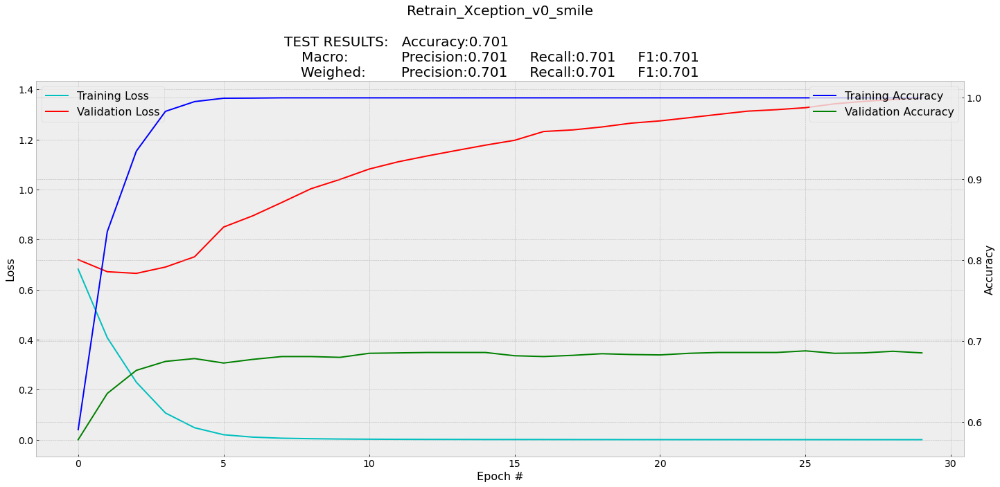

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

#### Guardar modelo

In [ ]:
# Data['Trained Model'].save(BASE_FOLDER+'VGG19_retraining_smile_vX00'+".h5")
# print(BASE_FOLDER+'Xception_retraining_smile_vX00'+".h5")

### Xception
All: 0.67575 
True: 0.6495 
False: 0.702

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block8_sepconv1_act  ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
# x = Dense(64, activation='relu', name='Dense2')(x)   ## ,kernel_regularizer=regularizers.l2(0.0001)
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

83697664/83683744 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
_____________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))
gc.collect()

Epoch 1/20
47/47 [==============================] - 107s 1s/step - loss: 0.7127 - accuracy: 0.5343 - val_loss: 0.7401 - val_accuracy: 0.5365
Epoch 2/20
47/47 [==============================] - 64s 1s/step - loss: 0.6166 - accuracy: 0.6682 - val_loss: 0.6903 - val_accuracy: 0.5755
Epoch 3/20
47/47 [==============================] - 64s 1s/step - loss: 0.5504 - accuracy: 0.7387 - val_loss: 0.6726 - val_accuracy: 0.5955
Epoch 4/20
47/47 [==============================] - 64s 1s/step - loss: 0.4918 - accuracy: 0.7945 - val_loss: 0.6623 - val_accuracy: 0.6120
Epoch 5/20
47/47 [==============================] - 64s 1s/step - loss: 0.4344 - accuracy: 0.8333 - val_loss: 0.6581 - val_accuracy: 0.6055
Epoch 6/20
47/47 [==============================] - 64s 1s/step - loss: 0.3788 - accuracy: 0.8670 - val_loss: 0.6594 - val_accuracy: 0.6115
Epoch 7/20
47/47 [==============================] - 64s 1s/step - loss: 0.3285 - accuracy: 0.9002 - val_loss: 0.6666 - val_accuracy: 0.6230
Epoch 8/20
47/47 [=

2050

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.67575
True: 0.6495
False: 0.702
              precision    recall  f1-score   support

           0       0.69      0.65      0.67      4000
           1       0.67      0.70      0.68      4000

    accuracy                           0.68      8000
   macro avg       0.68      0.68      0.68      8000
weighted avg       0.68      0.68      0.68      8000



#### Gráfico de entrenamiento

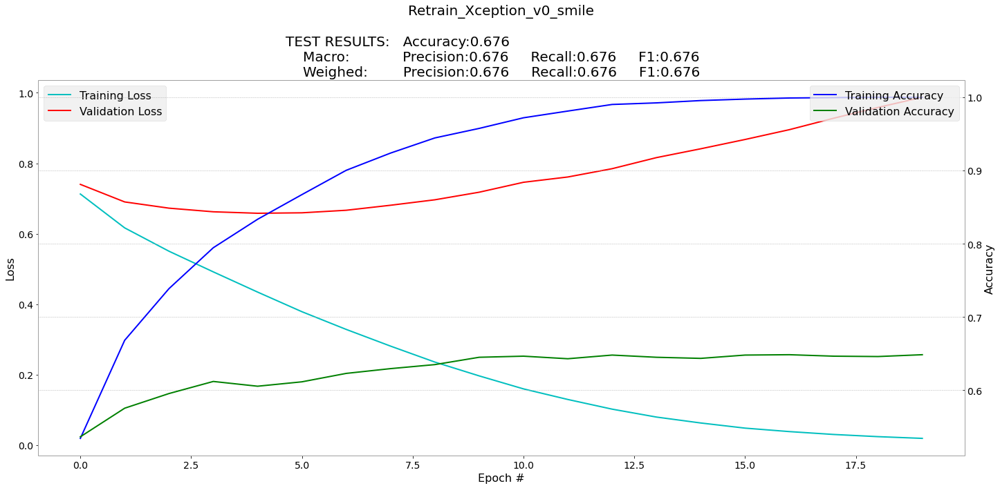

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

#### Guardar modelo

In [ ]:
# Data['Trained Model'].save(BASE_FOLDER+'VGG19_retraining_smile_vX00'+".h5")
# print(BASE_FOLDER+'Xception_retraining_smile_vX00'+".h5")

### Xception 
All: 0.708625 
True: 0.69925 
False: 0.718

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block8_sepconv1_act  ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_4[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=30, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/30
47/47 [==============================] - 71s 1s/step - loss: 0.6715 - accuracy: 0.5960 - val_loss: 0.7494 - val_accuracy: 0.5800
Epoch 2/30
47/47 [==============================] - 64s 1s/step - loss: 0.3952 - accuracy: 0.8407 - val_loss: 0.6347 - val_accuracy: 0.6680
Epoch 3/30
47/47 [==============================] - 64s 1s/step - loss: 0.2185 - accuracy: 0.9365 - val_loss: 0.6444 - val_accuracy: 0.6860
Epoch 4/30
47/47 [==============================] - 64s 1s/step - loss: 0.0968 - accuracy: 0.9810 - val_loss: 0.6959 - val_accuracy: 0.6945
Epoch 5/30
47/47 [==============================] - 64s 1s/step - loss: 0.0383 - accuracy: 0.9960 - val_loss: 0.7530 - val_accuracy: 0.6945
Epoch 6/30
47/47 [==============================] - 64s 1s/step - loss: 0.0162 - accuracy: 0.9995 - val_loss: 0.8246 - val_accuracy: 0.6870
Epoch 7/30
47/47 [==============================] - 64s 1s/step - loss: 0.0085 - accuracy: 1.0000 - val_loss: 0.8975 - val_accuracy: 0.6850
Epoch 8/30
47/47 [==

36777

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.708625
True: 0.69925
False: 0.718
              precision    recall  f1-score   support

           0       0.71      0.70      0.71      4000
           1       0.70      0.72      0.71      4000

    accuracy                           0.71      8000
   macro avg       0.71      0.71      0.71      8000
weighted avg       0.71      0.71      0.71      8000



#### Gráfico de entrenamiento

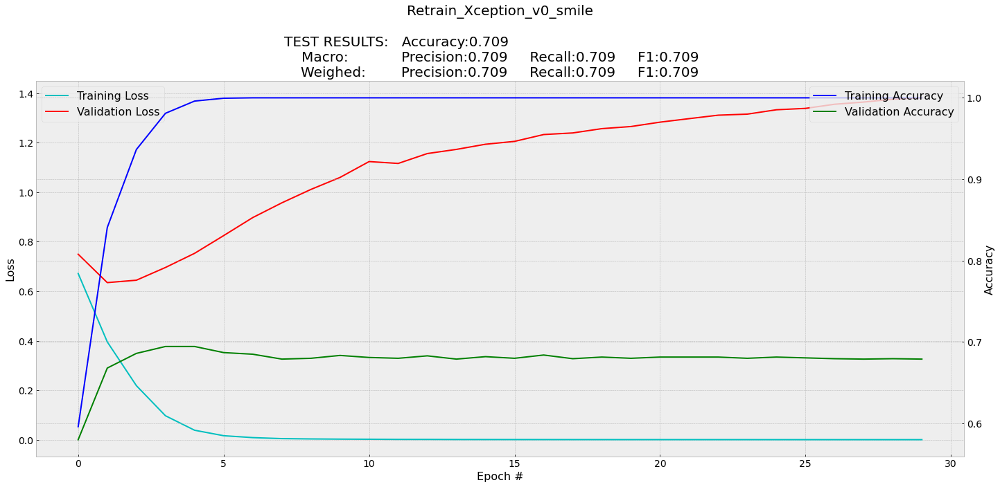

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All:0.703625 
True: 0.71875 
False: 0.6885

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block8_sepconv1_act  ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_6[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 70s 1s/step - loss: 0.6802 - accuracy: 0.5915 - val_loss: 0.6860 - val_accuracy: 0.5960
Epoch 2/10
47/47 [==============================] - 64s 1s/step - loss: 0.4139 - accuracy: 0.8347 - val_loss: 0.6715 - val_accuracy: 0.6330
Epoch 3/10
47/47 [==============================] - 64s 1s/step - loss: 0.2431 - accuracy: 0.9283 - val_loss: 0.6588 - val_accuracy: 0.6740
Epoch 4/10
47/47 [==============================] - 64s 1s/step - loss: 0.1143 - accuracy: 0.9817 - val_loss: 0.6825 - val_accuracy: 0.6890
Epoch 5/10
47/47 [==============================] - 64s 1s/step - loss: 0.0481 - accuracy: 0.9948 - val_loss: 0.7372 - val_accuracy: 0.6930
Epoch 6/10
47/47 [==============================] - 64s 1s/step - loss: 0.0209 - accuracy: 0.9998 - val_loss: 0.8075 - val_accuracy: 0.6870
Epoch 7/10
47/47 [==============================] - 64s 1s/step - loss: 0.0098 - accuracy: 0.9998 - val_loss: 0.8870 - val_accuracy: 0.6830
Epoch 8/10
47/47 [==

26916

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.703625
True: 0.71875
False: 0.6885
              precision    recall  f1-score   support

           0       0.70      0.72      0.71      4000
           1       0.71      0.69      0.70      4000

    accuracy                           0.70      8000
   macro avg       0.70      0.70      0.70      8000
weighted avg       0.70      0.70      0.70      8000



#### Gráfico de entrenamiento

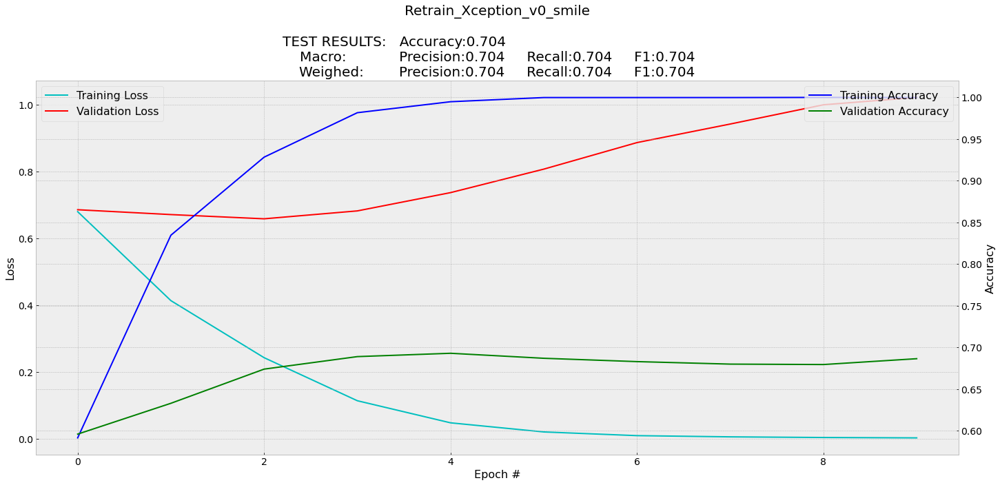

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

# Etiqueta Celeba: "young"

## Proceso

### CLIP crear "prompt" y preparar parámetros

In [ ]:
import torch
import clip
from PIL import Image
import glob

Name_feature='_young'
id_feature=39
Save_Data_Path=BASE_FOLDER_2+'Retrain_v0'+Name_feature+'.pkl'

Index_To_Test=[]
Label_To_Test=[]
Data_To_Train=[]
Label_To_Train=[]
Data = {'Training':{}, 'Model Name':{}, 'H':{}, 'Classes':{}}
Data['Training']={'Images':{},'Images array':{}, 'Classes':{}, 'Classes array':{}, 'Index':{}, 'H':{}}
Data['Training']['Images']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Images array']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes array']={'Train':{}, 'Validate':{}}

clip_tokens=['A picture of a person', 'A picture of a young person']
N_Tokens=len(clip_tokens)
print(N_Tokens)
print(clip_tokens)
for current_token in clip_tokens:
    print(current_token)

# [ 'A picture of a person',"A picture of a person with 5 o'clock shadow",'A picture of a person with arched eyebrows',
# 'A picture of an attractive person','A picture of a person with bags under eyes',
# 'A picture of a bald person','A picture of a person with bangs','A picture of a person with big lips',
# 'A picture of a person with big nose','A picture of a person with black hair',
# 'A picture of a person with blond hair','A blurry picture of a person',
# 'A picture of a person with brown hair','A picture of a person with bushy eyebrows',
# 'A picture of a chubby person','A picture of a person with double chin','A picture of a person with eyeglasses',
# 'A picture of a person with goatee','A picture of a person with gray hair','A picture of a person with heavy makeup',
# 'A picture of a person with high cheekbones','A picture of a male person',
# 'A picture of a person with mouth slightly open','A picture of a person with mustache',
# 'A picture of a person with narrow eyes','A picture of a person with no beard',
# 'A picture of a person with oval face','A picture of a person with pale skin','A picture of a person with pointy nose',
# 'A picture of a person with receding hairline','A picture of a person with rosy cheeks','A picture of a person with sideburns',
# 'A picture of a person who is smiling','A picture of a person with straight hair','A picture of a person with wavy hair',
# 'A picture of a person with earrings','A picture of a person with hat','A picture of a person with lipstick',
# 'A picture of a person with necklace','A picture of a person with necktie','A picture of a young person']

2
['A picture of a person', 'A picture of a young person']
A picture of a person
A picture of a young person


### Cargar CLIP

In [ ]:
clip_device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, clip_transform = clip.load("ViT-B/32", device=clip_device)
clip_text = clip.tokenize(clip_tokens).to(clip_device)

# CLIP features
text_features = clip_model.encode_text(clip_text)

test_index=1
test_image_path=Path_images+str(test_index).zfill(6)+'.jpg'
img_proeprocessed = clip_transform(Image.open(test_image_path)).unsqueeze(0).to(clip_device)
img_features = clip_model.encode_image(img_proeprocessed)
img_features_shape= img_features.shape

print('\n- Image Features:')
print('     Type:',type(img_features))
print('     Shape:',img_features_shape)
print('\n- Text Features:')
print('     Type:',type(text_features))
print('     Shape:',text_features.shape)
print('\n- Image Features Tensor:')
print(img_features)
print('\n- Text Features Tesor:')
print(text_features)

100%|███████████████████████████████████████| 338M/338M [00:05<00:00, 64.7MiB/s]


### Seleccionar indices a usar del Dataset Celeba

In [ ]:
# encontrar indices man_woman true/false
Index_Features_True=[]
Index_Features_False=[]

i=0
for descripton in Description_data:
    i=i+1
    if descripton[id_feature]:
        Index_Features_True.append(i)
    else:
        Index_Features_False.append(i)

## Mostrar Results       
min_value=9999999
print('Examples of celeba:')
print(Description_labels[id_feature]+' -  True:',len(Index_Features_True))
print(Description_labels[id_feature]+' - False:',len(Index_Features_False))  

# Smiling -  True: 97669
# Smiling - False: 104930

### Cargar Datos (ejectuar si se dispone del archivo de datos creado)

In [ ]:
## LOAD DATA
file_to_load = open(Save_Data_Path, "rb")
df_loaded = pickle.load(file_to_load)
file_to_load.close()

Data=df_loaded['Data']
Index_To_Test=df_loaded['Index_To_Test']
Label_To_Test=df_loaded['Label_To_Test']
Data_To_Train=df_loaded['Data_To_Train']
Label_To_Train=df_loaded['Label_To_Train']

### Preparar datos (ejectuar solo si no se dispone del archivo de datos creado)

In [ ]:
# def Preprocess_img(images_id,clip_device,clip_model,clip_preprocess):
#     test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
#     img_current=Image.open(test_image_path)
#     clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
#     return clip_model.encode_image(clip_img).detach().numpy(), np.array(img_current)
#     # img_proeprocessed=[]
#     # for img_i in images_id:
#     #     test_image_path=Path_images+str(img_i).zfill(6)+'.jpg'
#     #     img_current=Image.open(test_image_path)
#     #     clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
#     #     img_proeprocessed.append(clip_model.encode_image(clip_img))
#     # return img_proeprocessed

# Data['Training']['Images']['Test']=[]
# Data['Training']['Images']['Not Test']=[]
# Data['Training']['Classes']['Test']=[]
# Data['Training']['Classes']['Not Test']=[]
# Data['Training']['Images array']['Test']=[]
# Data['Training']['Images array']['Not Test']=[]

# for i in range(4000):
#     Index_To_Test.append(Index_Features_True[i])
#     Label_To_Test.append(clip_tokens[1])
#     img, img_arr=Preprocess_img(Index_Features_True[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Test'].append(img)
#     Data['Training']['Images array']['Test'].append(img_arr)
#     Data['Training']['Classes']['Test'].append(1)

#     Index_To_Test.append(Index_Features_False[i])
#     Label_To_Test.append(clip_tokens[0])
#     img, img_arr=Preprocess_img(Index_Features_False[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Test'].append(img)
#     Data['Training']['Images array']['Test'].append(img_arr)
#     Data['Training']['Classes']['Test'].append(0)

#     if i % 400 == 0 and i>0:
#         print('Test images load (%):',i/40)
        
#         df_to_save= {'Data': Data,
#                       'Index_To_Test':Index_To_Test,
#                       'Label_To_Test':Label_To_Test,
#                       'Data_To_Train':Data_To_Train,
#                       'Label_To_Train':Label_To_Train
#         }
#         save_df_to_file(df_to_save,Save_Data_Path)

#     # gc.collect() 

# for i in range(4000,8000):
#     Data_To_Train.append(Index_Features_True[i])
#     Label_To_Train.append(clip_tokens[1])
#     img, img_arr=Preprocess_img(Index_Features_True[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Not Test'].append(img)
#     Data['Training']['Images array']['Not Test'].append(img_arr)
#     Data['Training']['Classes']['Not Test'].append(1)
    
#     Data_To_Train.append(Index_Features_False[i])
#     Label_To_Train.append(clip_tokens[0])
#     img, img_arr=Preprocess_img(Index_Features_False[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Not Test'].append(img)
#     Data['Training']['Images array']['Not Test'].append(img_arr)
#     Data['Training']['Classes']['Not Test'].append(0)

#     if i % 400 == 0 and i>4000:
#         print('Train images load (%):',(i-4000)/40)
#         df_to_save= {'Data': Data,
#                       'Index_To_Test':Index_To_Test,
#                       'Label_To_Test':Label_To_Test,
#                       'Data_To_Train':Data_To_Train,
#                       'Label_To_Train':Label_To_Train
#         }
#         save_df_to_file(df_to_save,Save_Data_Path)
#     # gc.collect()

# Data['Classes']=[]
# for element in np.unique(Data['Training']['Classes']['Test']):
#     Data['Classes'].append(np.int(element))

# Data['Training']['Images']['Train'], Data['Training']['Images']['Validate'], Data['Training']['Classes']['Train'], Data['Training']['Classes']['Validate'] = train_test_split(Data['Training']['Images']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)
# Data['Training']['Images array']['Train'], Data['Training']['Images array']['Validate'], Data['Training']['Classes array']['Train'], Data['Training']['Classes array']['Validate'] = train_test_split(Data['Training']['Images array']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)

# df_to_save= {'Data': Data,
#               'Index_To_Test':Index_To_Test,
#               'Label_To_Test':Label_To_Test,
#               'Data_To_Train':Data_To_Train,
#               'Label_To_Train':Label_To_Train
# }
# save_df_to_file(df_to_save,Save_Data_Path)

# ## Visualizar número de entrenamiento
# print('NÚMERO DE DATOS PARA ENTRENAR/TEST')
# print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Not Test']),'con',len(np.unique(Data['Training']['Classes']['Test'])),'clases')
# print('Número de datos para Test:',  len(Data['Training']['Classes']['Test']),'con',len(np.unique(Data['Training']['Classes']['Not Test'])),'clases')

# ## Visualizar número de entrenamiento
# print('\nNÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN')
# print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Train']),'con',len(np.unique(Data['Training']['Classes']['Train'])),'clases')
# print('Número de datos para Validación:',  len(Data['Training']['Classes']['Validate']),'con',len(np.unique(Data['Training']['Classes']['Validate'])),'clases')


Test images load (%): 10.0
Test images load (%): 20.0
Test images load (%): 30.0
Test images load (%): 40.0
Test images load (%): 50.0
Test images load (%): 60.0
Test images load (%): 70.0
Test images load (%): 80.0
Test images load (%): 90.0
Train images load (%): 10.0
Train images load (%): 20.0
Train images load (%): 30.0
Train images load (%): 40.0
Train images load (%): 50.0
Train images load (%): 60.0
Train images load (%): 70.0
Train images load (%): 80.0
Train images load (%): 90.0
NÚMERO DE DATOS PARA ENTRENAR/TEST
Número de datos para Entrenamiento: 8000 con 2 clases
Número de datos para Test: 8000 con 2 clases

NÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN
Número de datos para Entrenamiento: 6000 con 2 clases
Número de datos para Validación: 2000 con 2 clases


## Modelos

### CLIP
All: 0.844625 
True: 0.84275 
False: 0.8465

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten (Flatten)            (None, 512)               0         
_________________________________________________________________
dense (Dense)                (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 1s 7ms/step - loss: 0.8856 - accuracy: 0.8030 - val_loss: 0.5459 - val_accuracy: 0.8430
Epoch 2/20
47/47 [==============================] - 0s 3ms/step - loss: 0.4359 - accuracy: 0.8525 - val_loss: 0.3934 - val_accuracy: 0.8495
Epoch 3/20
47/47 [==============================] - 0s 3ms/step - loss: 0.3513 - accuracy: 0.8517 - val_loss: 0.3640 - val_accuracy: 0.8460
Epoch 4/20
47/47 [==============================] - 0s 3ms/step - loss: 0.3293 - accuracy: 0.8552 - val_loss: 0.3569 - val_accuracy: 0.8455
Epoch 5/20
47/47 [==============================] - 0s 3ms/step - loss: 0.3204 - accuracy: 0.8617 - val_loss: 0.3460 - val_accuracy: 0.8535
Epoch 6/20
47/47 [==============================] - 0s 3ms/step - loss: 0.3143 - accuracy: 0.8605 - val_loss: 0.3474 - val_accuracy: 0.8465
Epoch 7/20
47/47 [==============================] - 0s 3ms/step - loss: 0.3110 - accuracy: 0.8618 - val_loss: 0.3450 - val_accuracy: 0.8470
Epoch 8/20
47/47 [==

1617

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.844625
True: 0.84275
False: 0.8465
              precision    recall  f1-score   support

           0       0.85      0.84      0.84      4000
           1       0.84      0.85      0.84      4000

    accuracy                           0.84      8000
   macro avg       0.84      0.84      0.84      8000
weighted avg       0.84      0.84      0.84      8000



#### Gráfico de entrenamiento

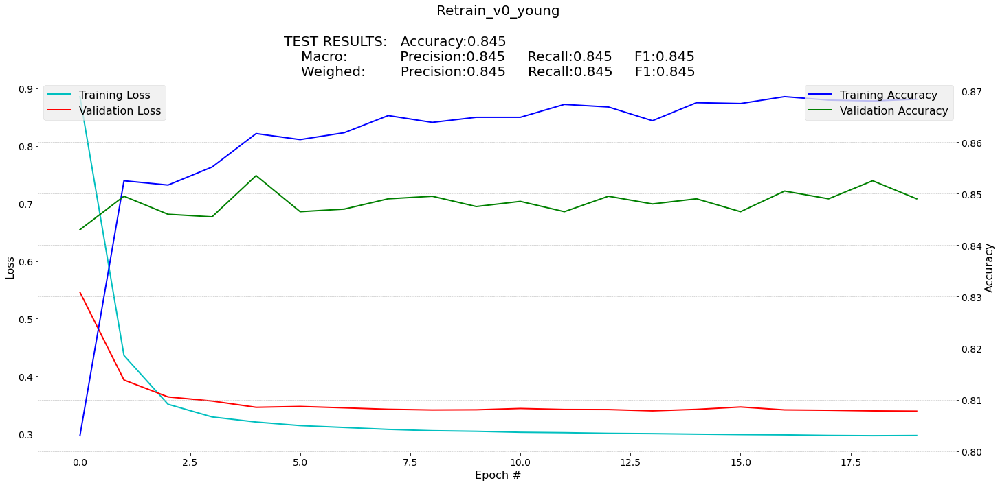

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP
All: 0.808875 True: 0.81 False: 0.80775

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=50, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/50
47/47 [==============================] - 1s 6ms/step - loss: 0.6421 - accuracy: 0.6288 - val_loss: 0.5851 - val_accuracy: 0.7000
Epoch 2/50
47/47 [==============================] - 0s 3ms/step - loss: 0.5810 - accuracy: 0.7142 - val_loss: 0.5564 - val_accuracy: 0.7365
Epoch 3/50
47/47 [==============================] - 0s 3ms/step - loss: 0.5590 - accuracy: 0.7387 - val_loss: 0.5403 - val_accuracy: 0.7580
Epoch 4/50
47/47 [==============================] - 0s 3ms/step - loss: 0.5453 - accuracy: 0.7523 - val_loss: 0.5292 - val_accuracy: 0.7635
Epoch 5/50
47/47 [==============================] - 0s 3ms/step - loss: 0.5354 - accuracy: 0.7608 - val_loss: 0.5209 - val_accuracy: 0.7730
Epoch 6/50
47/47 [==============================] - 0s 3ms/step - loss: 0.5277 - accuracy: 0.7677 - val_loss: 0.5142 - val_accuracy: 0.7780
Epoch 7/50
47/47 [==============================] - 0s 3ms/step - loss: 0.5215 - accuracy: 0.7735 - val_loss: 0.5088 - val_accuracy: 0.7825
Epoch 8/50
47/47 [==

8379

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.808875
True: 0.81
False: 0.80775
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      4000
           1       0.81      0.81      0.81      4000

    accuracy                           0.81      8000
   macro avg       0.81      0.81      0.81      8000
weighted avg       0.81      0.81      0.81      8000



#### Gráfico de entrenamiento

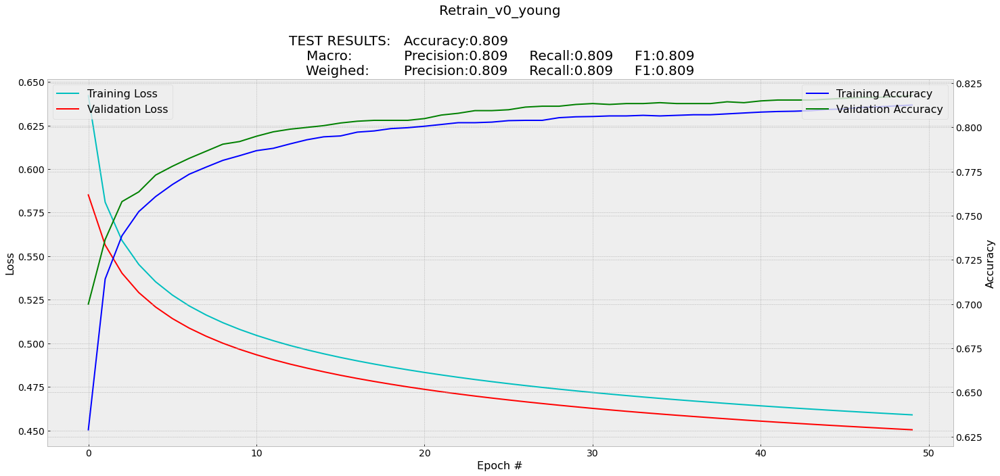

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All:0.84825 
True: 0.8305 
False: 0.866

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.01,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=50, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/50
47/47 [==============================] - 1s 6ms/step - loss: 0.4052 - accuracy: 0.8145 - val_loss: 0.3434 - val_accuracy: 0.8485
Epoch 2/50
47/47 [==============================] - 0s 3ms/step - loss: 0.3452 - accuracy: 0.8450 - val_loss: 0.3385 - val_accuracy: 0.8480
Epoch 3/50
47/47 [==============================] - 0s 3ms/step - loss: 0.3382 - accuracy: 0.8517 - val_loss: 0.3374 - val_accuracy: 0.8490
Epoch 4/50
47/47 [==============================] - 0s 3ms/step - loss: 0.3352 - accuracy: 0.8525 - val_loss: 0.3358 - val_accuracy: 0.8485
Epoch 5/50
47/47 [==============================] - 0s 3ms/step - loss: 0.3334 - accuracy: 0.8528 - val_loss: 0.3349 - val_accuracy: 0.8495
Epoch 6/50
47/47 [==============================] - 0s 3ms/step - loss: 0.3319 - accuracy: 0.8535 - val_loss: 0.3344 - val_accuracy: 0.8490
Epoch 7/50
47/47 [==============================] - 0s 3ms/step - loss: 0.3308 - accuracy: 0.8543 - val_loss: 0.3341 - val_accuracy: 0.8495
Epoch 8/50
47/47 [==

8435

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.84825
True: 0.8305
False: 0.866
              precision    recall  f1-score   support

           0       0.86      0.83      0.85      4000
           1       0.84      0.87      0.85      4000

    accuracy                           0.85      8000
   macro avg       0.85      0.85      0.85      8000
weighted avg       0.85      0.85      0.85      8000



#### Gráfico de entrenamiento

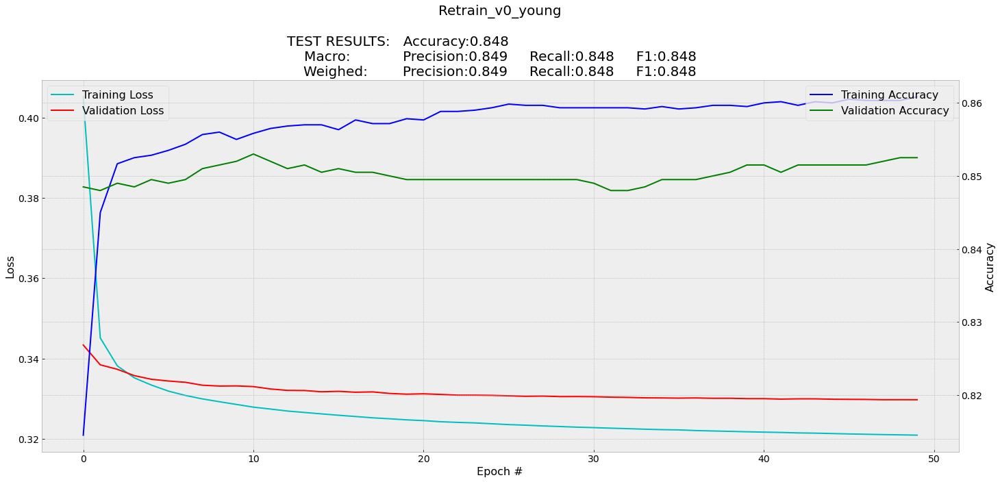

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.833125 
True: 0.809 ) -lr 0.001 ep 1000

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_8 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_7 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_7 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 1s 6ms/step - loss: 0.6076 - accuracy: 0.6808 - val_loss: 0.5630 - val_accuracy: 0.7390
Epoch 2/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.5516 - accuracy: 0.7497 - val_loss: 0.5366 - val_accuracy: 0.7670
Epoch 3/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.5321 - accuracy: 0.7653 - val_loss: 0.5221 - val_accuracy: 0.7820
Epoch 4/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.5203 - accuracy: 0.7758 - val_loss: 0.5124 - val_accuracy: 0.7910
Epoch 5/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.5119 - accuracy: 0.7822 - val_loss: 0.5053 - val_accuracy: 0.7965
Epoch 6/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.5054 - accuracy: 0.7902 - val_loss: 0.4996 - val_accuracy: 0.8000
Epoch 7/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.5002 - accuracy: 0.7957 - val_loss: 0.4949 - val_accuracy: 0.8055
Epoch 

8369

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.833125
True: 0.809
False: 0.85725
              precision    recall  f1-score   support

           0       0.85      0.81      0.83      4000
           1       0.82      0.86      0.84      4000

    accuracy                           0.83      8000
   macro avg       0.83      0.83      0.83      8000
weighted avg       0.83      0.83      0.83      8000



#### Gráfico de entrenamiento

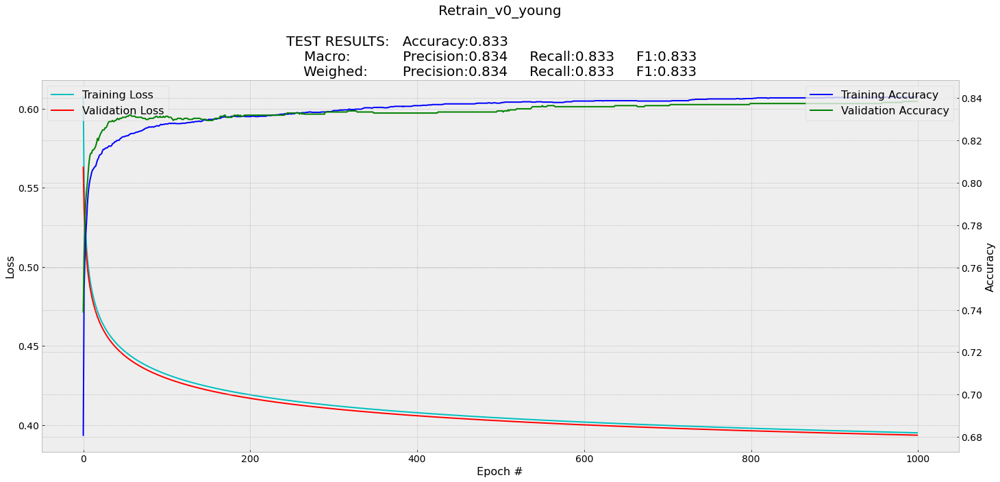

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.847625 
True: 0.83675 
False: 0.8585

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_9 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_8 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_8 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 1s 6ms/step - loss: 0.6788 - accuracy: 0.5768 - val_loss: 0.6665 - val_accuracy: 0.5955
Epoch 2/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.6484 - accuracy: 0.6257 - val_loss: 0.6371 - val_accuracy: 0.6415
Epoch 3/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.6210 - accuracy: 0.6667 - val_loss: 0.6105 - val_accuracy: 0.6820
Epoch 4/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.5964 - accuracy: 0.7060 - val_loss: 0.5866 - val_accuracy: 0.7155
Epoch 5/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.5743 - accuracy: 0.7298 - val_loss: 0.5650 - val_accuracy: 0.7415
Epoch 6/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.5542 - accuracy: 0.7570 - val_loss: 0.5460 - val_accuracy: 0.7650
Epoch 7/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.5363 - accuracy: 0.7717 - val_loss: 0.5285 - val_accuracy: 0.7800
Epoch 

8179

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.847625
True: 0.83675
False: 0.8585
              precision    recall  f1-score   support

           0       0.86      0.84      0.85      4000
           1       0.84      0.86      0.85      4000

    accuracy                           0.85      8000
   macro avg       0.85      0.85      0.85      8000
weighted avg       0.85      0.85      0.85      8000



#### Gráfico de entrenamiento

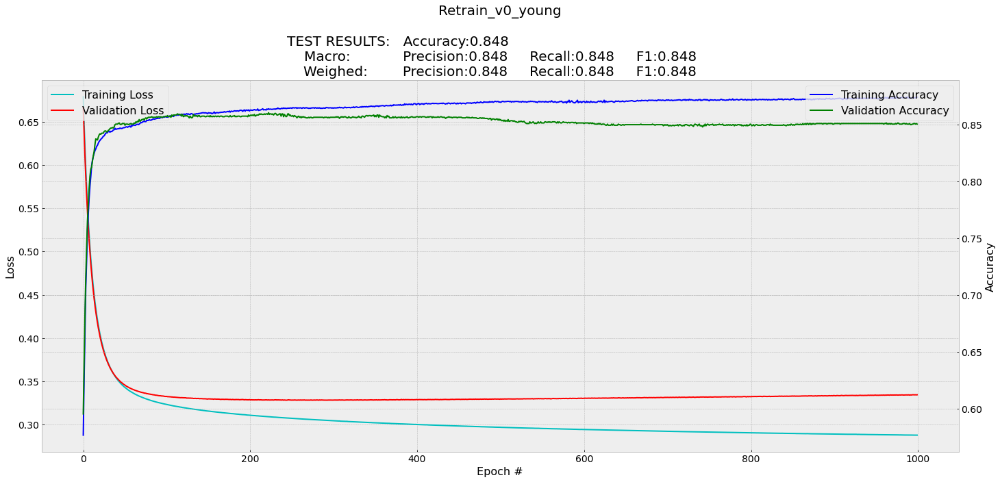

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.851125 
True: 0.835 
False: 0.86725

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_10 (InputLayer)        [(None, 1, 512)]          0         
_________________________________________________________________
flatten_9 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_9 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=170, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/170
47/47 [==============================] - 1s 6ms/step - loss: 0.7234 - accuracy: 0.5442 - val_loss: 0.6986 - val_accuracy: 0.5690
Epoch 2/170
47/47 [==============================] - 0s 3ms/step - loss: 0.6743 - accuracy: 0.5872 - val_loss: 0.6559 - val_accuracy: 0.6290
Epoch 3/170
47/47 [==============================] - 0s 3ms/step - loss: 0.6408 - accuracy: 0.6355 - val_loss: 0.6253 - val_accuracy: 0.6675
Epoch 4/170
47/47 [==============================] - 0s 3ms/step - loss: 0.6142 - accuracy: 0.6703 - val_loss: 0.6005 - val_accuracy: 0.6930
Epoch 5/170
47/47 [==============================] - 0s 3ms/step - loss: 0.5915 - accuracy: 0.7027 - val_loss: 0.5784 - val_accuracy: 0.7180
Epoch 6/170
47/47 [==============================] - 0s 3ms/step - loss: 0.5711 - accuracy: 0.7257 - val_loss: 0.5591 - val_accuracy: 0.7390
Epoch 7/170
47/47 [==============================] - 0s 3ms/step - loss: 0.5528 - accuracy: 0.7440 - val_loss: 0.5415 - val_accuracy: 0.7565
Epoch 8/170
4

8174

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.851125
True: 0.835
False: 0.86725
              precision    recall  f1-score   support

           0       0.86      0.83      0.85      4000
           1       0.84      0.87      0.85      4000

    accuracy                           0.85      8000
   macro avg       0.85      0.85      0.85      8000
weighted avg       0.85      0.85      0.85      8000



#### Gráfico de entrenamiento

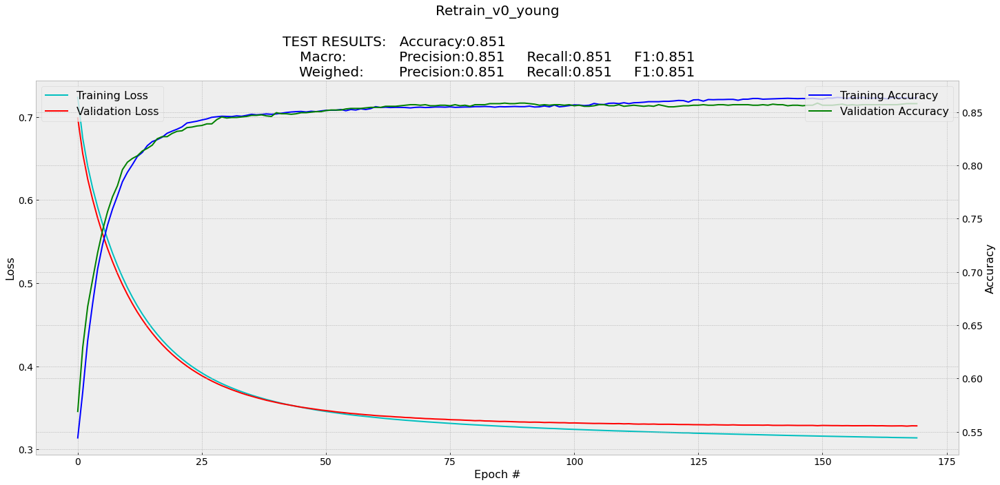

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19
All: 0.745 
True: 0.66925 
False: 0.82075

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

80150528/80134624 [==============================] - 1s 0us/step
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
______________________________________________________________

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=15, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/15
47/47 [==============================] - 111s 1s/step - loss: 1.0153 - accuracy: 0.5727 - val_loss: 0.6165 - val_accuracy: 0.6655
Epoch 2/15
47/47 [==============================] - 49s 1s/step - loss: 0.5977 - accuracy: 0.6767 - val_loss: 0.5496 - val_accuracy: 0.7150
Epoch 3/15
47/47 [==============================] - 49s 1s/step - loss: 0.5345 - accuracy: 0.7290 - val_loss: 0.5739 - val_accuracy: 0.7015
Epoch 4/15
47/47 [==============================] - 49s 1s/step - loss: 0.5195 - accuracy: 0.7380 - val_loss: 0.5975 - val_accuracy: 0.6705
Epoch 5/15
47/47 [==============================] - 49s 1s/step - loss: 0.4512 - accuracy: 0.7922 - val_loss: 0.5197 - val_accuracy: 0.7390
Epoch 6/15
47/47 [==============================] - 49s 1s/step - loss: 0.4091 - accuracy: 0.8125 - val_loss: 0.5246 - val_accuracy: 0.7505
Epoch 7/15
47/47 [==============================] - 49s 1s/step - loss: 0.3769 - accuracy: 0.8305 - val_loss: 0.5230 - val_accuracy: 0.7575
Epoch 8/15
47/47 [=

1705

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.745
True: 0.66925
False: 0.82075
              precision    recall  f1-score   support

           0       0.79      0.67      0.72      4000
           1       0.71      0.82      0.76      4000

    accuracy                           0.74      8000
   macro avg       0.75      0.74      0.74      8000
weighted avg       0.75      0.74      0.74      8000



#### Gráfico de entrenamiento

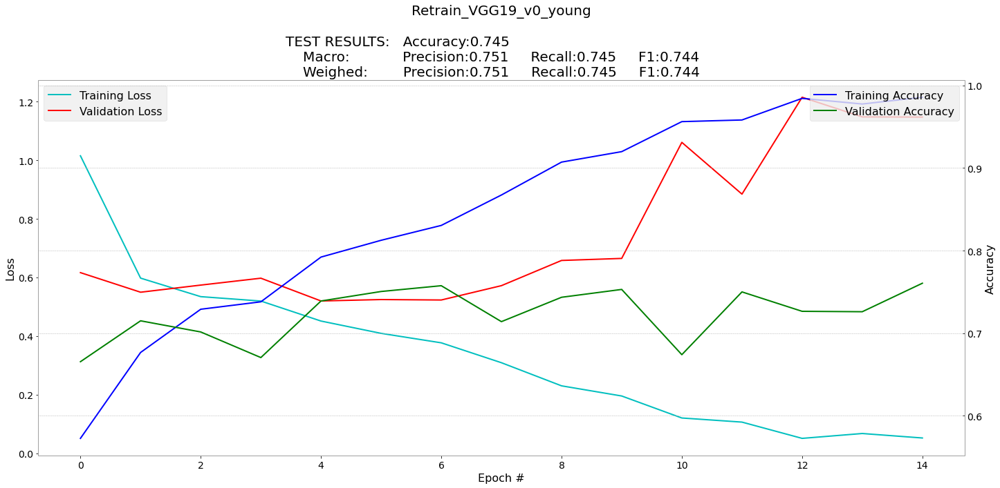

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19
All: 0.755625 
True: 0.76275 
False: 0.7485

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

80150528/80134624 [==============================] - 2s 0us/step
Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
____________________________________________________________

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=25, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/25
47/47 [==============================] - 89s 2s/step - loss: 1.0741 - accuracy: 0.5665 - val_loss: 0.6128 - val_accuracy: 0.6665
Epoch 2/25
47/47 [==============================] - 52s 1s/step - loss: 0.5885 - accuracy: 0.6870 - val_loss: 0.5735 - val_accuracy: 0.7065
Epoch 3/25
47/47 [==============================] - 52s 1s/step - loss: 0.5409 - accuracy: 0.7250 - val_loss: 0.5181 - val_accuracy: 0.7365
Epoch 4/25
47/47 [==============================] - 52s 1s/step - loss: 0.4836 - accuracy: 0.7693 - val_loss: 0.5064 - val_accuracy: 0.7455
Epoch 5/25
47/47 [==============================] - 52s 1s/step - loss: 0.4615 - accuracy: 0.7772 - val_loss: 0.5097 - val_accuracy: 0.7440
Epoch 6/25
47/47 [==============================] - 52s 1s/step - loss: 0.4210 - accuracy: 0.8042 - val_loss: 0.4880 - val_accuracy: 0.7700
Epoch 7/25
47/47 [==============================] - 52s 1s/step - loss: 0.3816 - accuracy: 0.8315 - val_loss: 0.5091 - val_accuracy: 0.7670
Epoch 8/25
47/47 [==

2385

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.755625
True: 0.76275
False: 0.7485
              precision    recall  f1-score   support

           0       0.75      0.76      0.76      4000
           1       0.76      0.75      0.75      4000

    accuracy                           0.76      8000
   macro avg       0.76      0.76      0.76      8000
weighted avg       0.76      0.76      0.76      8000



#### Gráfico de entrenamiento

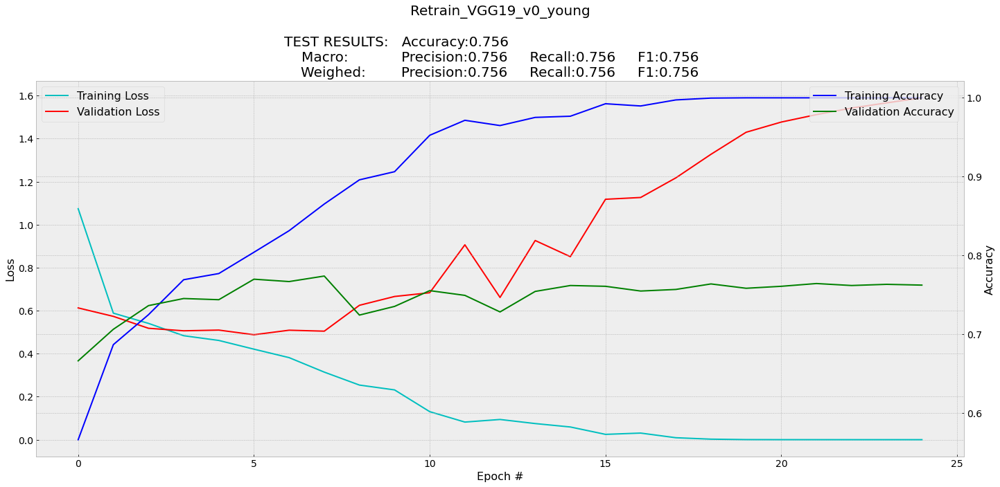

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.7305 
True: 0.72925 
False: 0.73175

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.000025,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=30, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/30
47/47 [==============================] - 54s 1s/step - loss: 1.2561 - accuracy: 0.5752 - val_loss: 0.6195 - val_accuracy: 0.6525
Epoch 2/30
47/47 [==============================] - 52s 1s/step - loss: 0.5785 - accuracy: 0.6940 - val_loss: 0.5640 - val_accuracy: 0.7140
Epoch 3/30
47/47 [==============================] - 52s 1s/step - loss: 0.5007 - accuracy: 0.7470 - val_loss: 0.5546 - val_accuracy: 0.7305
Epoch 4/30
47/47 [==============================] - 52s 1s/step - loss: 0.4508 - accuracy: 0.7877 - val_loss: 0.5730 - val_accuracy: 0.7180
Epoch 5/30
47/47 [==============================] - 52s 1s/step - loss: 0.3917 - accuracy: 0.8290 - val_loss: 0.5926 - val_accuracy: 0.7010
Epoch 6/30
47/47 [==============================] - 52s 1s/step - loss: 0.3372 - accuracy: 0.8598 - val_loss: 0.5928 - val_accuracy: 0.7330
Epoch 7/30
47/47 [==============================] - 52s 1s/step - loss: 0.2736 - accuracy: 0.8848 - val_loss: 0.6221 - val_accuracy: 0.7335
Epoch 8/30
47/47 [==

10960

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.7305
True: 0.72925
False: 0.73175
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      4000
           1       0.73      0.73      0.73      4000

    accuracy                           0.73      8000
   macro avg       0.73      0.73      0.73      8000
weighted avg       0.73      0.73      0.73      8000



#### Gráfico de entrenamiento

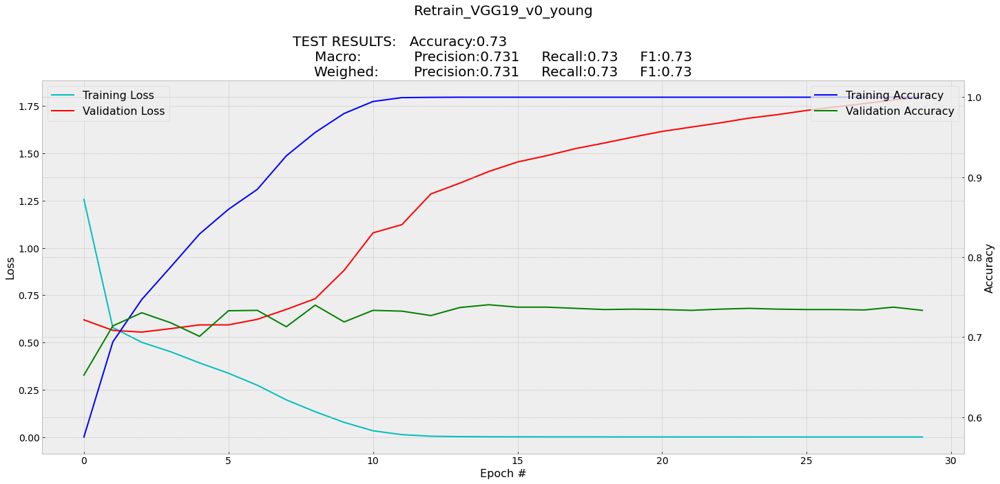

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.748 
True: 0.769 
False: 0.727

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=25, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/25
47/47 [==============================] - 54s 1s/step - loss: 1.1035 - accuracy: 0.5517 - val_loss: 0.6637 - val_accuracy: 0.6065
Epoch 2/25
47/47 [==============================] - 52s 1s/step - loss: 0.6595 - accuracy: 0.6033 - val_loss: 0.6650 - val_accuracy: 0.6010
Epoch 3/25
47/47 [==============================] - 52s 1s/step - loss: 0.6197 - accuracy: 0.6583 - val_loss: 0.5768 - val_accuracy: 0.7000
Epoch 4/25
47/47 [==============================] - 52s 1s/step - loss: 0.5782 - accuracy: 0.6985 - val_loss: 0.5500 - val_accuracy: 0.7195
Epoch 5/25
47/47 [==============================] - 52s 1s/step - loss: 0.5481 - accuracy: 0.7277 - val_loss: 0.5633 - val_accuracy: 0.7150
Epoch 6/25
47/47 [==============================] - 52s 1s/step - loss: 0.5526 - accuracy: 0.7262 - val_loss: 0.5363 - val_accuracy: 0.7275
Epoch 7/25
47/47 [==============================] - 52s 1s/step - loss: 0.5015 - accuracy: 0.7555 - val_loss: 0.5078 - val_accuracy: 0.7520
Epoch 8/25
47/47 [==

11518

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.748
True: 0.769
False: 0.727
              precision    recall  f1-score   support

           0       0.74      0.77      0.75      4000
           1       0.76      0.73      0.74      4000

    accuracy                           0.75      8000
   macro avg       0.75      0.75      0.75      8000
weighted avg       0.75      0.75      0.75      8000



#### Gráfico de entrenamiento

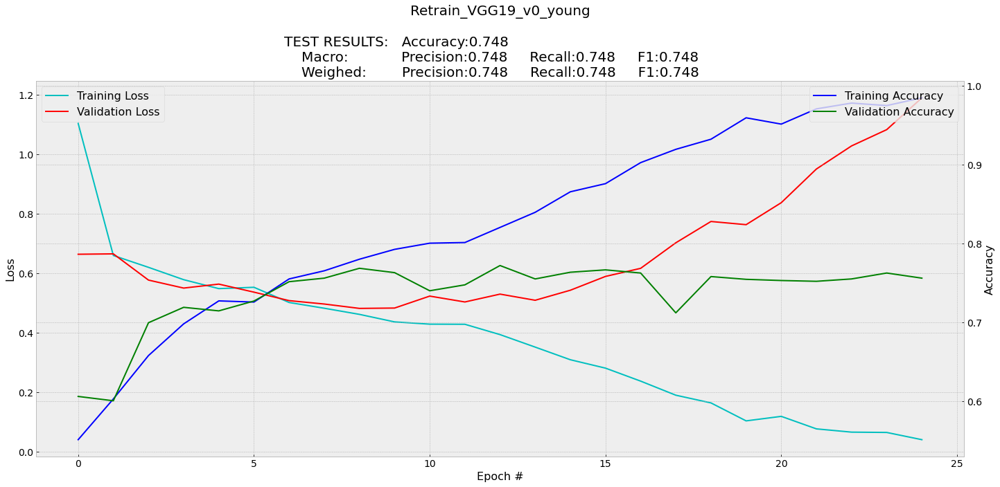

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.75075 
True: 0.7655 
False: 0.736

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_10 (InputLayer)        [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=6, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/6
47/47 [==============================] - 54s 1s/step - loss: 1.0549 - accuracy: 0.5882 - val_loss: 0.6388 - val_accuracy: 0.6535
Epoch 2/6
47/47 [==============================] - 52s 1s/step - loss: 0.5919 - accuracy: 0.6807 - val_loss: 0.5933 - val_accuracy: 0.6890
Epoch 3/6
47/47 [==============================] - 52s 1s/step - loss: 0.5503 - accuracy: 0.7160 - val_loss: 0.5381 - val_accuracy: 0.7270
Epoch 4/6
47/47 [==============================] - 52s 1s/step - loss: 0.4924 - accuracy: 0.7520 - val_loss: 0.5302 - val_accuracy: 0.7215
Epoch 5/6
47/47 [==============================] - 52s 1s/step - loss: 0.4455 - accuracy: 0.7870 - val_loss: 0.5061 - val_accuracy: 0.7515
Epoch 6/6
47/47 [==============================] - 52s 1s/step - loss: 0.3943 - accuracy: 0.8182 - val_loss: 0.5327 - val_accuracy: 0.7600


11891

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.75075
True: 0.7655
False: 0.736
              precision    recall  f1-score   support

           0       0.74      0.77      0.75      4000
           1       0.76      0.74      0.75      4000

    accuracy                           0.75      8000
   macro avg       0.75      0.75      0.75      8000
weighted avg       0.75      0.75      0.75      8000



#### Gráfico de entrenamiento

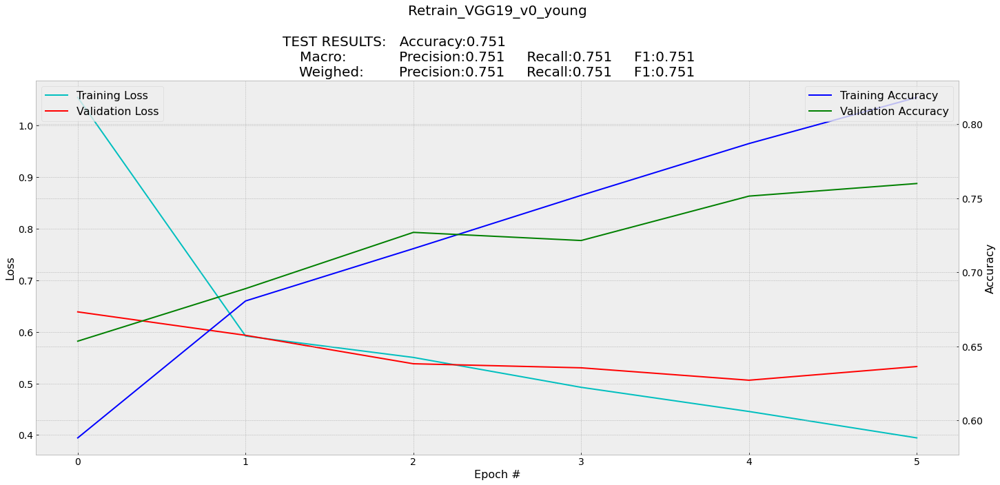

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception
All: 0.730625 
True: 0.72275 
False: 0.7385

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

83697664/83683744 [==============================] - 2s 0us/step
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_2[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
___________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=30, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/30
47/47 [==============================] - 74s 1s/step - loss: 0.6300 - accuracy: 0.6523 - val_loss: 0.6333 - val_accuracy: 0.6875
Epoch 2/30
47/47 [==============================] - 61s 1s/step - loss: 0.3520 - accuracy: 0.8617 - val_loss: 0.6462 - val_accuracy: 0.7045
Epoch 3/30
47/47 [==============================] - 60s 1s/step - loss: 0.1914 - accuracy: 0.9425 - val_loss: 0.5807 - val_accuracy: 0.7335
Epoch 4/30
47/47 [==============================] - 60s 1s/step - loss: 0.0907 - accuracy: 0.9820 - val_loss: 0.6356 - val_accuracy: 0.7350
Epoch 5/30
47/47 [==============================] - 60s 1s/step - loss: 0.0386 - accuracy: 0.9957 - val_loss: 0.6857 - val_accuracy: 0.7405
Epoch 6/30
47/47 [==============================] - 60s 1s/step - loss: 0.0178 - accuracy: 0.9988 - val_loss: 0.7544 - val_accuracy: 0.7315
Epoch 7/30
47/47 [==============================] - 60s 1s/step - loss: 0.0094 - accuracy: 0.9998 - val_loss: 0.8212 - val_accuracy: 0.7285
Epoch 8/30
47/47 [==

2111

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.730625
True: 0.72275
False: 0.7385
              precision    recall  f1-score   support

           0       0.73      0.72      0.73      4000
           1       0.73      0.74      0.73      4000

    accuracy                           0.73      8000
   macro avg       0.73      0.73      0.73      8000
weighted avg       0.73      0.73      0.73      8000



#### Gráfico de entrenamiento

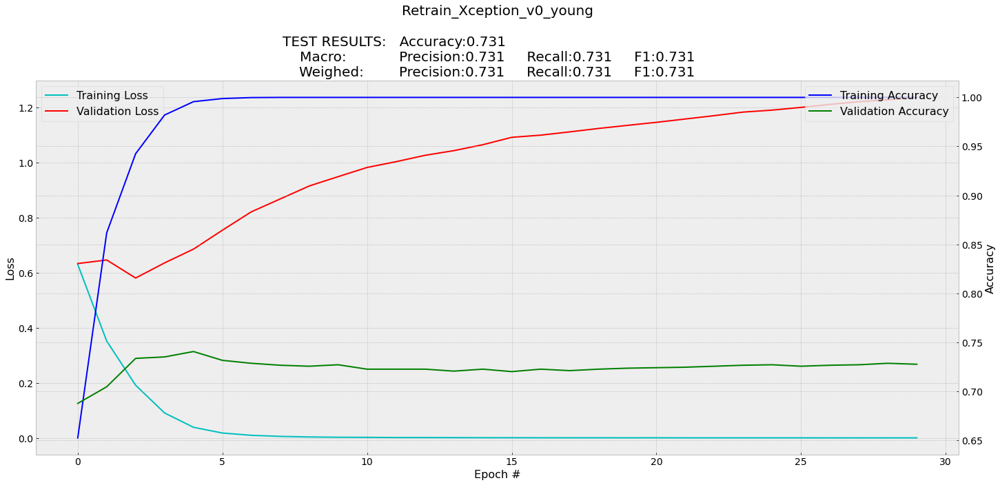

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.715625 
True: 0.71625 
False: 0.715

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

83697664/83683744 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
_____________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.000005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=30, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/30
47/47 [==============================] - 110s 2s/step - loss: 0.7225 - accuracy: 0.5278 - val_loss: 0.6789 - val_accuracy: 0.5880
Epoch 2/30
47/47 [==============================] - 65s 1s/step - loss: 0.6411 - accuracy: 0.6385 - val_loss: 0.6435 - val_accuracy: 0.6415
Epoch 3/30
47/47 [==============================] - 65s 1s/step - loss: 0.5934 - accuracy: 0.6955 - val_loss: 0.6287 - val_accuracy: 0.6545
Epoch 4/30
47/47 [==============================] - 65s 1s/step - loss: 0.5536 - accuracy: 0.7407 - val_loss: 0.6173 - val_accuracy: 0.6785
Epoch 5/30
47/47 [==============================] - 65s 1s/step - loss: 0.5164 - accuracy: 0.7727 - val_loss: 0.6077 - val_accuracy: 0.6805
Epoch 6/30
47/47 [==============================] - 65s 1s/step - loss: 0.4826 - accuracy: 0.7948 - val_loss: 0.5991 - val_accuracy: 0.6815
Epoch 7/30
47/47 [==============================] - 65s 1s/step - loss: 0.4542 - accuracy: 0.8135 - val_loss: 0.5943 - val_accuracy: 0.6800
Epoch 8/30
47/47 [=

1974

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.715625
True: 0.71625
False: 0.715
              precision    recall  f1-score   support

           0       0.72      0.72      0.72      4000
           1       0.72      0.71      0.72      4000

    accuracy                           0.72      8000
   macro avg       0.72      0.72      0.72      8000
weighted avg       0.72      0.72      0.72      8000



#### Gráfico de entrenamiento

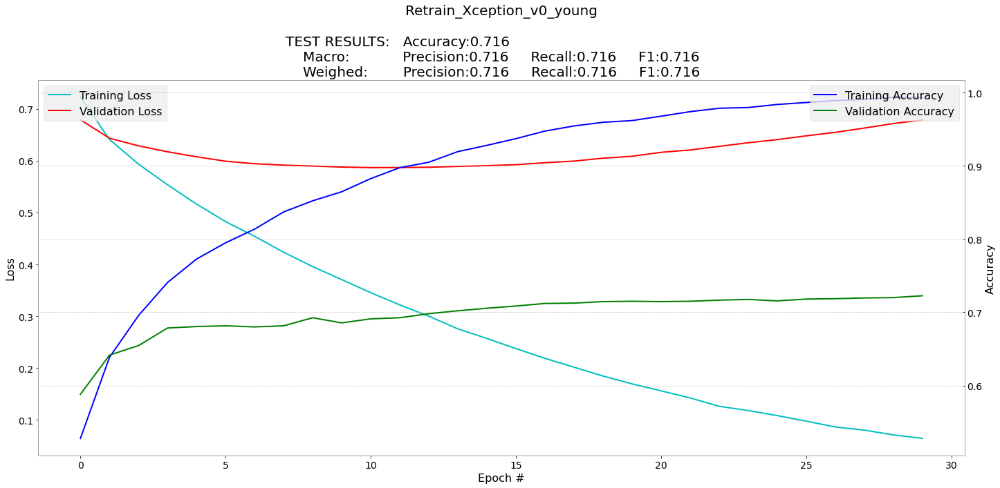

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.7205
True: 0.72225
False: 0.71875

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_4[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.000025,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 71s 1s/step - loss: 0.6602 - accuracy: 0.6138 - val_loss: 0.6775 - val_accuracy: 0.6720
Epoch 2/20
47/47 [==============================] - 65s 1s/step - loss: 0.4664 - accuracy: 0.7918 - val_loss: 0.6009 - val_accuracy: 0.6975
Epoch 3/20
47/47 [==============================] - 65s 1s/step - loss: 0.3478 - accuracy: 0.8688 - val_loss: 0.5896 - val_accuracy: 0.7090
Epoch 4/20
47/47 [==============================] - 65s 1s/step - loss: 0.2497 - accuracy: 0.9177 - val_loss: 0.5940 - val_accuracy: 0.7090
Epoch 5/20
47/47 [==============================] - 65s 1s/step - loss: 0.1726 - accuracy: 0.9558 - val_loss: 0.6084 - val_accuracy: 0.7155
Epoch 6/20
47/47 [==============================] - 65s 1s/step - loss: 0.1139 - accuracy: 0.9763 - val_loss: 0.6458 - val_accuracy: 0.7135
Epoch 7/20
47/47 [==============================] - 65s 1s/step - loss: 0.0723 - accuracy: 0.9877 - val_loss: 0.6911 - val_accuracy: 0.7145
Epoch 8/20
47/47 [==

26088

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.7205
True: 0.72225
False: 0.71875
              precision    recall  f1-score   support

           0       0.72      0.72      0.72      4000
           1       0.72      0.72      0.72      4000

    accuracy                           0.72      8000
   macro avg       0.72      0.72      0.72      8000
weighted avg       0.72      0.72      0.72      8000



#### Gráfico de entrenamiento

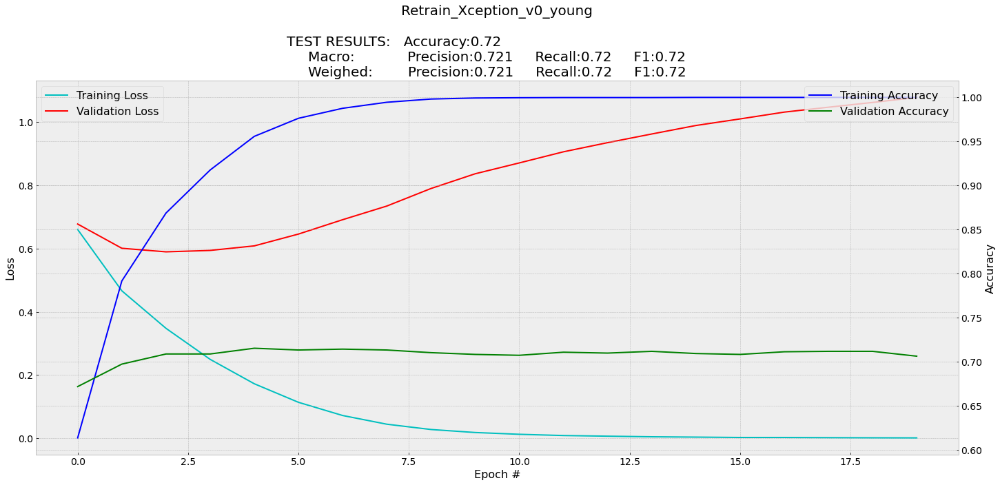

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.726375
True: 0.697
False: 0.75575

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_10"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_11 (InputLayer)           [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_11[0][0]                   
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
___________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.99, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=6, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/6
47/47 [==============================] - 71s 1s/step - loss: 0.6325 - accuracy: 0.6412 - val_loss: 0.6659 - val_accuracy: 0.6760
Epoch 2/6
47/47 [==============================] - 65s 1s/step - loss: 0.3545 - accuracy: 0.8575 - val_loss: 0.5898 - val_accuracy: 0.7235
Epoch 3/6
47/47 [==============================] - 65s 1s/step - loss: 0.1921 - accuracy: 0.9415 - val_loss: 0.6134 - val_accuracy: 0.7250
Epoch 4/6
47/47 [==============================] - 65s 1s/step - loss: 0.0864 - accuracy: 0.9833 - val_loss: 0.6539 - val_accuracy: 0.7225
Epoch 5/6
47/47 [==============================] - 65s 1s/step - loss: 0.0326 - accuracy: 0.9962 - val_loss: 0.7271 - val_accuracy: 0.7265
Epoch 6/6
47/47 [==============================] - 65s 1s/step - loss: 0.0125 - accuracy: 0.9995 - val_loss: 0.8089 - val_accuracy: 0.7275


26339

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.726375
True: 0.697
False: 0.75575
              precision    recall  f1-score   support

           0       0.74      0.70      0.72      4000
           1       0.71      0.76      0.73      4000

    accuracy                           0.73      8000
   macro avg       0.73      0.73      0.73      8000
weighted avg       0.73      0.73      0.73      8000



#### Gráfico de entrenamiento

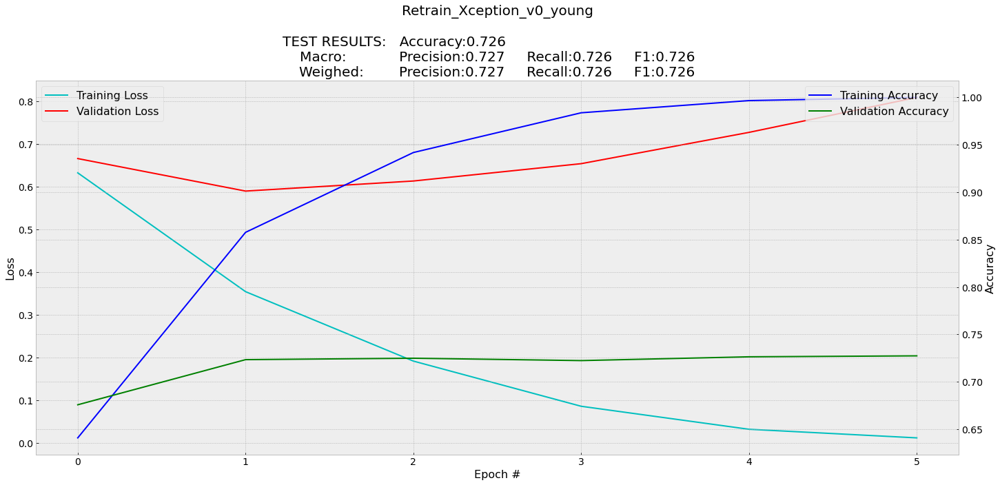

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

# Etiqueta Celeba: "bald"

## Proceso

### CLIP crear "prompt" y preparar parámetros

In [ ]:
import torch
import clip
from PIL import Image
import glob

Name_feature='_bald'
id_feature=4
Save_Data_Path=BASE_FOLDER_2+'Retrain_v0'+Name_feature+'.pkl'

Index_To_Test=[]
Label_To_Test=[]
Data_To_Train=[]
Label_To_Train=[]
Data = {'Training':{}, 'Model Name':{}, 'H':{}, 'Classes':{}}
Data['Training']={'Images':{},'Images array':{}, 'Classes':{}, 'Classes array':{}, 'Index':{}, 'H':{}}
Data['Training']['Images']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Images array']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes array']={'Train':{}, 'Validate':{}}

clip_tokens=['A picture of a person', 'A picture of a bald person']
N_Tokens=len(clip_tokens)
print(N_Tokens)
print(clip_tokens)
for current_token in clip_tokens:
    print(current_token)

# [ 'A picture of a person',"A picture of a person with 5 o'clock shadow",'A picture of a person with arched eyebrows',
# 'A picture of an attractive person','A picture of a person with bags under eyes',
# 'A picture of a bald person','A picture of a person with bangs','A picture of a person with big lips',
# 'A picture of a person with big nose','A picture of a person with black hair',
# 'A picture of a person with blond hair','A blurry picture of a person',
# 'A picture of a person with brown hair','A picture of a person with bushy eyebrows',
# 'A picture of a chubby person','A picture of a person with double chin','A picture of a person with eyeglasses',
# 'A picture of a person with goatee','A picture of a person with gray hair','A picture of a person with heavy makeup',
# 'A picture of a person with high cheekbones','A picture of a male person',
# 'A picture of a person with mouth slightly open','A picture of a person with mustache',
# 'A picture of a person with narrow eyes','A picture of a person with no beard',
# 'A picture of a person with oval face','A picture of a person with pale skin','A picture of a person with pointy nose',
# 'A picture of a person with receding hairline','A picture of a person with rosy cheeks','A picture of a person with sideburns',
# 'A picture of a person who is smiling','A picture of a person with straight hair','A picture of a person with wavy hair',
# 'A picture of a person with earrings','A picture of a person with hat','A picture of a person with lipstick',
# 'A picture of a person with necklace','A picture of a person with necktie','A picture of a young person']

2
['A picture of a person', 'A picture of a bald person']
A picture of a person
A picture of a bald person


### Cargar CLIP

In [ ]:
clip_device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, clip_transform = clip.load("ViT-B/32", device=clip_device)
clip_text = clip.tokenize(clip_tokens).to(clip_device)

# CLIP features
text_features = clip_model.encode_text(clip_text)

test_index=1
test_image_path=Path_images+str(test_index).zfill(6)+'.jpg'
img_proeprocessed = clip_transform(Image.open(test_image_path)).unsqueeze(0).to(clip_device)
img_features = clip_model.encode_image(img_proeprocessed)
img_features_shape= img_features.shape

print('\n- Image Features:')
print('     Type:',type(img_features))
print('     Shape:',img_features_shape)
print('\n- Text Features:')
print('     Type:',type(text_features))
print('     Shape:',text_features.shape)
print('\n- Image Features Tensor:')
print(img_features)
print('\n- Text Features Tesor:')
print(text_features)


- Image Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([1, 512])

- Text Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([2, 512])

- Image Features Tensor:
tensor([[-6.0150e-02,  1.7044e-02, -9.9854e-02,  2.3523e-01, -6.8359e-02,
         -8.4814e-01, -3.7036e-01, -4.8169e-01, -3.1921e-02, -3.8666e-02,
         -5.1666e-02, -1.9775e-01,  6.2061e-01, -5.4565e-02,  7.4365e-01,
          4.4678e-02,  1.5791e+00, -4.6045e-01,  1.3513e-01, -1.4685e-01,
         -3.7012e-01, -3.7183e-01, -4.6509e-01, -2.8833e-01, -1.7578e-01,
         -1.3904e-01,  2.9028e-01, -9.5642e-02,  3.9746e-01,  1.3770e-01,
          5.1855e-01,  1.5613e-01,  8.7524e-02, -1.0674e-02, -9.4531e-01,
          2.2595e-01, -3.6133e-02,  4.6924e-01,  9.4604e-02,  1.5908e+00,
          2.1533e-01,  1.9360e-01, -5.3284e-02, -7.5500e-02, -6.1111e-03,
          1.4443e+00,  1.2891e-01,  5.3613e-01,  4.5630e-01,  3.9478e-01,
          1.7310e-01,  1.6138e-01, -2.8870e-02, -2.5464e-01, -1

### Seleccionar indices a usar del Dataset Celeba

In [ ]:
# encontrar indices man_woman true/false
Index_Features_True=[]
Index_Features_False=[]

i=0
for descripton in Description_data:
    i=i+1
    if descripton[id_feature]:
        Index_Features_True.append(i)
    else:
        Index_Features_False.append(i)

## Mostrar Results       
min_value=9999999
print('Examples of celeba:')
print(Description_labels[id_feature]+' -  True:',len(Index_Features_True))
print(Description_labels[id_feature]+' - False:',len(Index_Features_False))  

# Smiling -  True: 97669
# Smiling - False: 104930

Examples of celeba:
Bald -  True: 4547
Bald - False: 198052


### Cargar Datos (ejectuar si se dispone del archivo de datos creado)

In [ ]:
## LOAD DATA
file_to_load = open(Save_Data_Path, "rb")
df_loaded = pickle.load(file_to_load)
file_to_load.close()

Data=df_loaded['Data']
Index_To_Test=df_loaded['Index_To_Test']
Label_To_Test=df_loaded['Label_To_Test']
Data_To_Train=df_loaded['Data_To_Train']
Label_To_Train=df_loaded['Label_To_Train']

### Preparar datos (ejectuar solo si no se dispone del archivo de datos creado)

In [ ]:
def Preprocess_img(images_id,clip_device,clip_model,clip_preprocess):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    return clip_model.encode_image(clip_img).detach().cpu().numpy(), np.array(img_current)
    # return clip_model.encode_image(clip_img).detach().numpy(), np.array(img_current)

Data['Training']['Images']['Test']=[]
Data['Training']['Images']['Not Test']=[]
Data['Training']['Classes']['Test']=[]
Data['Training']['Classes']['Not Test']=[]
Data['Training']['Images array']['Test']=[]
Data['Training']['Images array']['Not Test']=[]

for i in range(2250):
    Index_To_Test.append(Index_Features_True[i])
    Label_To_Test.append(clip_tokens[1])
    img, img_arr=Preprocess_img(Index_Features_True[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Test'].append(img)
    Data['Training']['Images array']['Test'].append(img_arr)
    Data['Training']['Classes']['Test'].append(1)

    Index_To_Test.append(Index_Features_False[i])
    Label_To_Test.append(clip_tokens[0])
    img, img_arr=Preprocess_img(Index_Features_False[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Test'].append(img)
    Data['Training']['Images array']['Test'].append(img_arr)
    Data['Training']['Classes']['Test'].append(0)

    if i % 225 == 0 and i>0:
        print('Test images load (%):',10*i/225)
        
        df_to_save= {'Data': Data,
                      'Index_To_Test':Index_To_Test,
                      'Label_To_Test':Label_To_Test,
                      'Data_To_Train':Data_To_Train,
                      'Label_To_Train':Label_To_Train
        }
        save_df_to_file(df_to_save,Save_Data_Path)

    # gc.collect() 

for i in range(2250,4500):
    Data_To_Train.append(Index_Features_True[i])
    Label_To_Train.append(clip_tokens[1])
    img, img_arr=Preprocess_img(Index_Features_True[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Not Test'].append(img)
    Data['Training']['Images array']['Not Test'].append(img_arr)
    Data['Training']['Classes']['Not Test'].append(1)
    
    Data_To_Train.append(Index_Features_False[i])
    Label_To_Train.append(clip_tokens[0])
    img, img_arr=Preprocess_img(Index_Features_False[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Not Test'].append(img)
    Data['Training']['Images array']['Not Test'].append(img_arr)
    Data['Training']['Classes']['Not Test'].append(0)

    if i % 225 == 0 and i>2250:
        print('Train images load (%):',10*(i-2250)/225)
        df_to_save= {'Data': Data,
                      'Index_To_Test':Index_To_Test,
                      'Label_To_Test':Label_To_Test,
                      'Data_To_Train':Data_To_Train,
                      'Label_To_Train':Label_To_Train
        }
        save_df_to_file(df_to_save,Save_Data_Path)
    # gc.collect()

Data['Classes']=[]
for element in np.unique(Data['Training']['Classes']['Test']):
    Data['Classes'].append(np.int(element))

Data['Training']['Images']['Train'], Data['Training']['Images']['Validate'], Data['Training']['Classes']['Train'], Data['Training']['Classes']['Validate'] = train_test_split(Data['Training']['Images']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)
Data['Training']['Images array']['Train'], Data['Training']['Images array']['Validate'], Data['Training']['Classes array']['Train'], Data['Training']['Classes array']['Validate'] = train_test_split(Data['Training']['Images array']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)

df_to_save= {'Data': Data,
              'Index_To_Test':Index_To_Test,
              'Label_To_Test':Label_To_Test,
              'Data_To_Train':Data_To_Train,
              'Label_To_Train':Label_To_Train
}
save_df_to_file(df_to_save,Save_Data_Path)

## Visualizar número de entrenamiento
print('NÚMERO DE DATOS PARA ENTRENAR/TEST')
print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Not Test']),'con',len(np.unique(Data['Training']['Classes']['Test'])),'clases')
print('Número de datos para Test:',  len(Data['Training']['Classes']['Test']),'con',len(np.unique(Data['Training']['Classes']['Not Test'])),'clases')

## Visualizar número de entrenamiento
print('\nNÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN')
print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Train']),'con',len(np.unique(Data['Training']['Classes']['Train'])),'clases')
print('Número de datos para Validación:',  len(Data['Training']['Classes']['Validate']),'con',len(np.unique(Data['Training']['Classes']['Validate'])),'clases')


Test images load (%): 10.0
Test images load (%): 20.0
Test images load (%): 30.0
Test images load (%): 40.0
Test images load (%): 50.0
Test images load (%): 60.0
Test images load (%): 70.0
Test images load (%): 80.0
Test images load (%): 90.0
Train images load (%): 10.0
Train images load (%): 20.0
Train images load (%): 30.0
Train images load (%): 40.0
Train images load (%): 50.0
Train images load (%): 60.0
Train images load (%): 70.0
Train images load (%): 80.0
Train images load (%): 90.0
NÚMERO DE DATOS PARA ENTRENAR/TEST
Número de datos para Entrenamiento: 4500 con 2 clases
Número de datos para Test: 4500 con 2 clases

NÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN
Número de datos para Entrenamiento: 3375 con 2 clases
Número de datos para Validación: 1125 con 2 clases


## Modelos

### CLIP 
All: 0.8888888888888888
True: 0.8671111111111112
False: 0.9106666666666666

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 
# Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/20
27/27 [==============================] - 1s 11ms/step - loss: 0.6221 - accuracy: 0.6658 - val_loss: 0.5561 - val_accuracy: 0.7707
Epoch 2/20
27/27 [==============================] - 0s 5ms/step - loss: 0.5294 - accuracy: 0.7979 - val_loss: 0.5111 - val_accuracy: 0.8204
Epoch 3/20
27/27 [==============================] - 0s 5ms/step - loss: 0.4947 - accuracy: 0.8341 - val_loss: 0.4859 - val_accuracy: 0.8436
Epoch 4/20
27/27 [==============================] - 0s 4ms/step - loss: 0.4733 - accuracy: 0.8524 - val_loss: 0.4688 - val_accuracy: 0.8542
Epoch 5/20
27/27 [==============================] - 0s 5ms/step - loss: 0.4580 - accuracy: 0.8631 - val_loss: 0.4557 - val_accuracy: 0.8596
Epoch 6/20
27/27 [==============================] - 0s 4ms/step - loss: 0.4461 - accuracy: 0.8714 - val_loss: 0.4453 - val_accuracy: 0.8622
Epoch 7/20
27/27 [==============================] - 0s 5ms/step - loss: 0.4365 - accuracy: 0.8782 - val_loss: 0.4367 - val_accuracy: 0.8658
Epoch 8/20
27/27 [=

9289

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.8888888888888888
True: 0.8671111111111112
False: 0.9106666666666666
              precision    recall  f1-score   support

           0       0.91      0.87      0.89      2250
           1       0.87      0.91      0.89      2250

    accuracy                           0.89      4500
   macro avg       0.89      0.89      0.89      4500
weighted avg       0.89      0.89      0.89      4500



#### Gráfico de entrenamiento

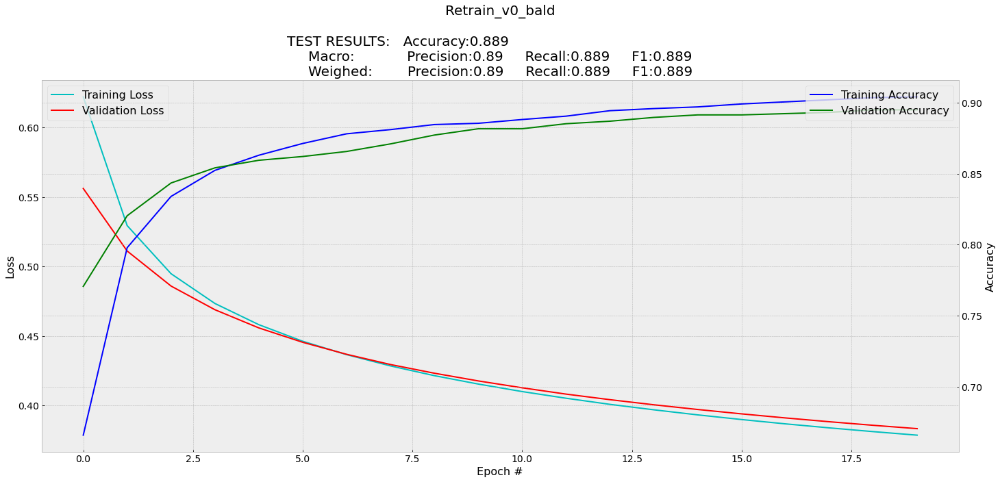

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 

All: 0.9171111111111111 True: 0.8951111111111111 False: 0.9391111111111111

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_19 (InputLayer)        [(None, 1, 512)]          0         
_________________________________________________________________
flatten_18 (Flatten)         (None, 512)               0         
_________________________________________________________________
dense_11 (Dense)             (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 
# Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/200
27/27 [==============================] - 1s 11ms/step - loss: 0.6628 - accuracy: 0.6252 - val_loss: 0.5934 - val_accuracy: 0.7147
Epoch 2/200
27/27 [==============================] - 0s 5ms/step - loss: 0.5653 - accuracy: 0.7446 - val_loss: 0.5459 - val_accuracy: 0.7591
Epoch 3/200
27/27 [==============================] - 0s 4ms/step - loss: 0.5291 - accuracy: 0.7816 - val_loss: 0.5192 - val_accuracy: 0.7929
Epoch 4/200
27/27 [==============================] - 0s 4ms/step - loss: 0.5070 - accuracy: 0.7967 - val_loss: 0.5010 - val_accuracy: 0.8116
Epoch 5/200
27/27 [==============================] - 0s 4ms/step - loss: 0.4909 - accuracy: 0.8104 - val_loss: 0.4873 - val_accuracy: 0.8267
Epoch 6/200
27/27 [==============================] - 0s 5ms/step - loss: 0.4784 - accuracy: 0.8234 - val_loss: 0.4764 - val_accuracy: 0.8373
Epoch 7/200
27/27 [==============================] - 0s 4ms/step - loss: 0.4682 - accuracy: 0.8308 - val_loss: 0.4672 - val_accuracy: 0.8436
Epoch 8/200


8235

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.9171111111111111
True: 0.8951111111111111
False: 0.9391111111111111
              precision    recall  f1-score   support

           0       0.94      0.90      0.92      2250
           1       0.90      0.94      0.92      2250

    accuracy                           0.92      4500
   macro avg       0.92      0.92      0.92      4500
weighted avg       0.92      0.92      0.92      4500



#### Gráfico de entrenamiento

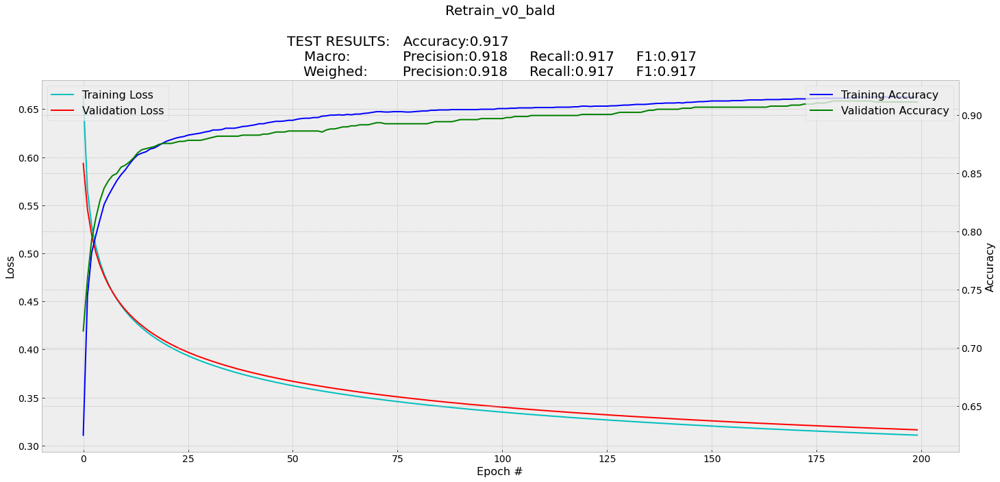

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP
All: 0.9613333333333334
True: 0.9528888888888889
False: 0.9697777777777777

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.01,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 
# Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/20
27/27 [==============================] - 1s 10ms/step - loss: 0.2934 - accuracy: 0.8856 - val_loss: 0.1815 - val_accuracy: 0.9404
Epoch 2/20
27/27 [==============================] - 0s 5ms/step - loss: 0.1568 - accuracy: 0.9517 - val_loss: 0.1574 - val_accuracy: 0.9511
Epoch 3/20
27/27 [==============================] - 0s 5ms/step - loss: 0.1416 - accuracy: 0.9585 - val_loss: 0.1501 - val_accuracy: 0.9564
Epoch 4/20
27/27 [==============================] - 0s 5ms/step - loss: 0.1337 - accuracy: 0.9603 - val_loss: 0.1437 - val_accuracy: 0.9564
Epoch 5/20
27/27 [==============================] - 0s 4ms/step - loss: 0.1289 - accuracy: 0.9618 - val_loss: 0.1401 - val_accuracy: 0.9573
Epoch 6/20
27/27 [==============================] - 0s 4ms/step - loss: 0.1251 - accuracy: 0.9624 - val_loss: 0.1373 - val_accuracy: 0.9582
Epoch 7/20
27/27 [==============================] - 0s 4ms/step - loss: 0.1223 - accuracy: 0.9633 - val_loss: 0.1353 - val_accuracy: 0.9591
Epoch 8/20
27/27 [=

8302

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.9613333333333334
True: 0.9528888888888889
False: 0.9697777777777777
              precision    recall  f1-score   support

           0       0.97      0.95      0.96      2250
           1       0.95      0.97      0.96      2250

    accuracy                           0.96      4500
   macro avg       0.96      0.96      0.96      4500
weighted avg       0.96      0.96      0.96      4500



#### Gráfico de entrenamiento

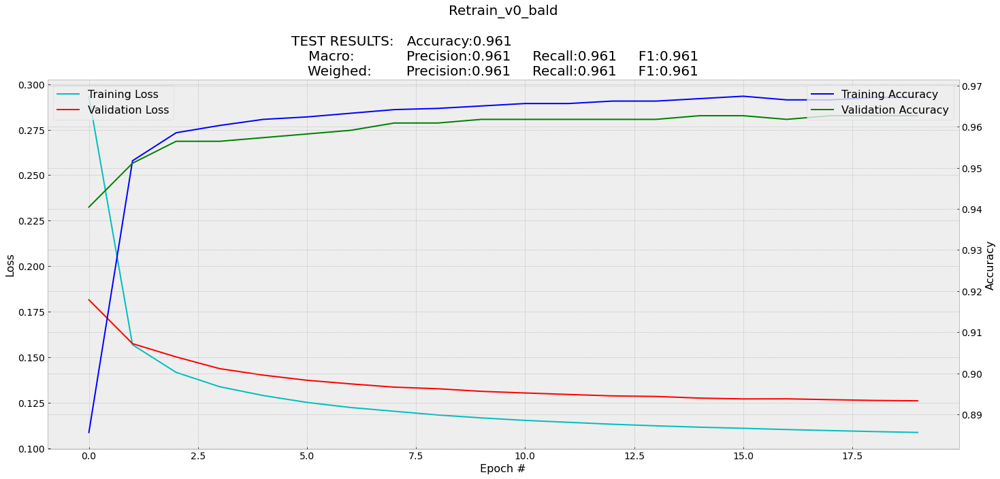

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP
All: 0.9631111111111111
True: 0.9577777777777777
False: 0.9684444444444444

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_13 (InputLayer)        [(None, 1, 512)]          0         
_________________________________________________________________
flatten_12 (Flatten)         (None, 512)               0         
_________________________________________________________________
dense_7 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.01,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 
# Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=40, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/40
27/27 [==============================] - 1s 10ms/step - loss: 0.3000 - accuracy: 0.8812 - val_loss: 0.1821 - val_accuracy: 0.9449
Epoch 2/40
27/27 [==============================] - 0s 4ms/step - loss: 0.1601 - accuracy: 0.9517 - val_loss: 0.1610 - val_accuracy: 0.9502
Epoch 3/40
27/27 [==============================] - 0s 5ms/step - loss: 0.1444 - accuracy: 0.9564 - val_loss: 0.1489 - val_accuracy: 0.9556
Epoch 4/40
27/27 [==============================] - 0s 4ms/step - loss: 0.1362 - accuracy: 0.9579 - val_loss: 0.1433 - val_accuracy: 0.9573
Epoch 5/40
27/27 [==============================] - 0s 4ms/step - loss: 0.1312 - accuracy: 0.9597 - val_loss: 0.1398 - val_accuracy: 0.9573
Epoch 6/40
27/27 [==============================] - 0s 4ms/step - loss: 0.1274 - accuracy: 0.9612 - val_loss: 0.1377 - val_accuracy: 0.9582
Epoch 7/40
27/27 [==============================] - 0s 5ms/step - loss: 0.1245 - accuracy: 0.9618 - val_loss: 0.1355 - val_accuracy: 0.9600
Epoch 8/40
27/27 [=

8409

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.9631111111111111
True: 0.9577777777777777
False: 0.9684444444444444
              precision    recall  f1-score   support

           0       0.97      0.96      0.96      2250
           1       0.96      0.97      0.96      2250

    accuracy                           0.96      4500
   macro avg       0.96      0.96      0.96      4500
weighted avg       0.96      0.96      0.96      4500



#### Gráfico de entrenamiento

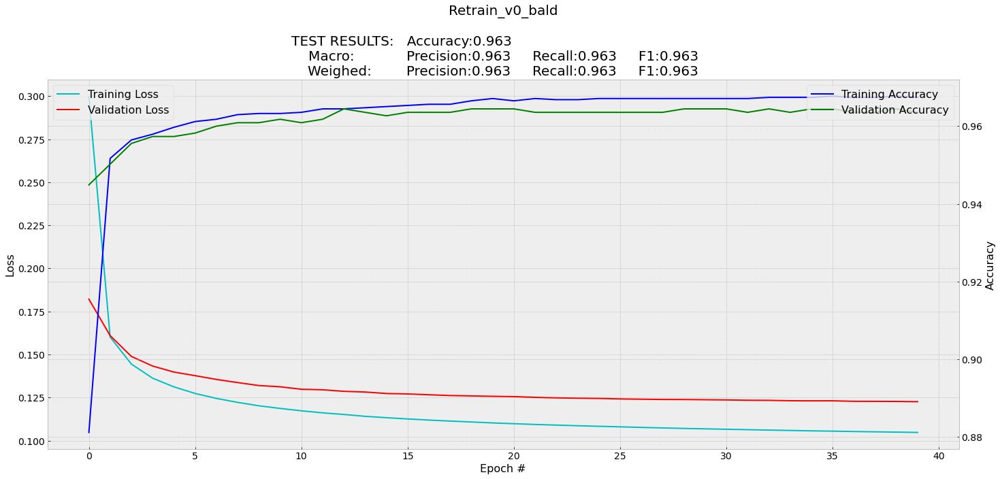

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP
All: 0.966 
True: 0.959111111 
False: 0.972889


#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_20 (InputLayer)        [(None, 1, 512)]          0         
_________________________________________________________________
flatten_19 (Flatten)         (None, 512)               0         
_________________________________________________________________
dense_12 (Dense)             (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.01,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 
# Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=200, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/200
27/27 [==============================] - 1s 13ms/step - loss: 0.2680 - accuracy: 0.9013 - val_loss: 0.1706 - val_accuracy: 0.9422
Epoch 2/200
27/27 [==============================] - 0s 5ms/step - loss: 0.1512 - accuracy: 0.9517 - val_loss: 0.1498 - val_accuracy: 0.9538
Epoch 3/200
27/27 [==============================] - 0s 5ms/step - loss: 0.1371 - accuracy: 0.9570 - val_loss: 0.1425 - val_accuracy: 0.9591
Epoch 4/200
27/27 [==============================] - 0s 5ms/step - loss: 0.1304 - accuracy: 0.9603 - val_loss: 0.1378 - val_accuracy: 0.9591
Epoch 5/200
27/27 [==============================] - 0s 4ms/step - loss: 0.1259 - accuracy: 0.9630 - val_loss: 0.1344 - val_accuracy: 0.9618
Epoch 6/200
27/27 [==============================] - 0s 4ms/step - loss: 0.1228 - accuracy: 0.9627 - val_loss: 0.1326 - val_accuracy: 0.9618
Epoch 7/200
27/27 [==============================] - 0s 5ms/step - loss: 0.1200 - accuracy: 0.9639 - val_loss: 0.1309 - val_accuracy: 0.9618
Epoch 8/200


8102

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.966
True: 0.9591111111111111
False: 0.9728888888888889
              precision    recall  f1-score   support

           0       0.97      0.96      0.97      2250
           1       0.96      0.97      0.97      2250

    accuracy                           0.97      4500
   macro avg       0.97      0.97      0.97      4500
weighted avg       0.97      0.97      0.97      4500



#### Gráfico de entrenamiento

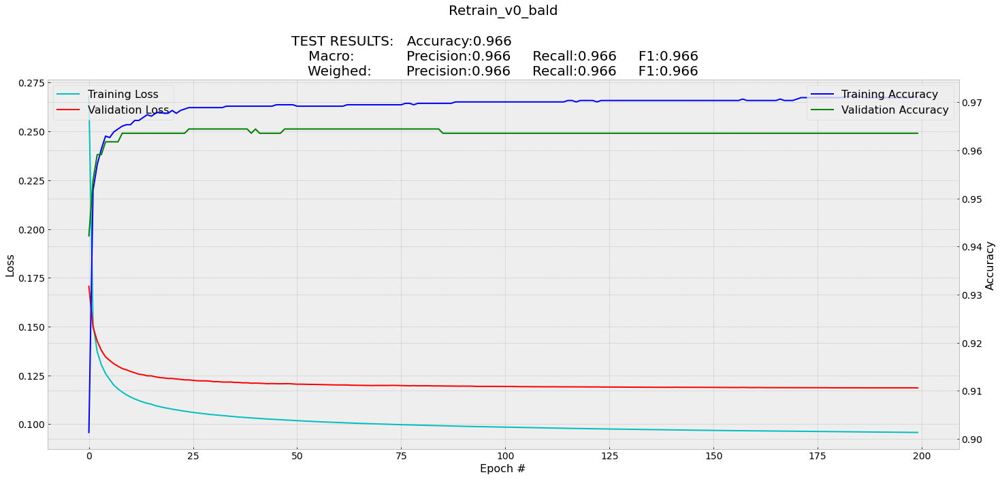

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP
All: 0.57133 
True: 0.672888 
False: 0.46977

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 
# Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/20
27/27 [==============================] - 1s 10ms/step - loss: 0.7414 - accuracy: 0.5141 - val_loss: 0.7220 - val_accuracy: 0.5280
Epoch 2/20
27/27 [==============================] - 0s 4ms/step - loss: 0.7283 - accuracy: 0.5236 - val_loss: 0.7151 - val_accuracy: 0.5298
Epoch 3/20
27/27 [==============================] - 0s 5ms/step - loss: 0.7228 - accuracy: 0.5292 - val_loss: 0.7110 - val_accuracy: 0.5351
Epoch 4/20
27/27 [==============================] - 0s 5ms/step - loss: 0.7191 - accuracy: 0.5345 - val_loss: 0.7080 - val_accuracy: 0.5396
Epoch 5/20
27/27 [==============================] - 0s 5ms/step - loss: 0.7164 - accuracy: 0.5399 - val_loss: 0.7057 - val_accuracy: 0.5396
Epoch 6/20
27/27 [==============================] - 0s 4ms/step - loss: 0.7142 - accuracy: 0.5416 - val_loss: 0.7038 - val_accuracy: 0.5422
Epoch 7/20
27/27 [==============================] - 0s 5ms/step - loss: 0.7123 - accuracy: 0.5440 - val_loss: 0.7022 - val_accuracy: 0.5458
Epoch 8/20
27/27 [=

8157

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.5713333333333334
True: 0.6728888888888889
False: 0.4697777777777778
              precision    recall  f1-score   support

           0       0.56      0.67      0.61      2250
           1       0.59      0.47      0.52      2250

    accuracy                           0.57      4500
   macro avg       0.57      0.57      0.57      4500
weighted avg       0.57      0.57      0.57      4500



#### Gráfico de entrenamiento

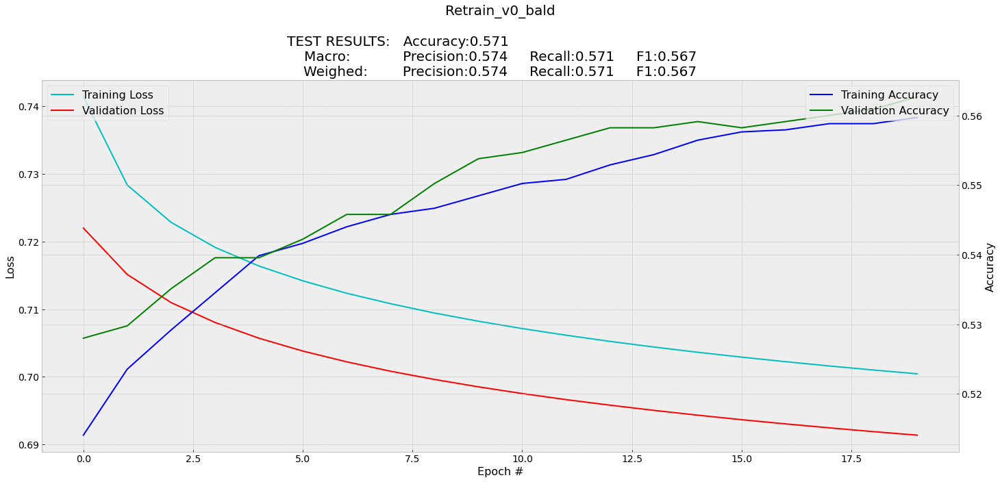

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.9642222222222222
True: 0.9608888888888889
False: 0.9675555555555555

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_6 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 
# Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/20
27/27 [==============================] - 1s 10ms/step - loss: 0.5368 - accuracy: 0.7561 - val_loss: 0.3591 - val_accuracy: 0.9156
Epoch 2/20
27/27 [==============================] - 0s 6ms/step - loss: 0.2894 - accuracy: 0.9280 - val_loss: 0.2395 - val_accuracy: 0.9378
Epoch 3/20
27/27 [==============================] - 0s 4ms/step - loss: 0.2096 - accuracy: 0.9473 - val_loss: 0.1931 - val_accuracy: 0.9431
Epoch 4/20
27/27 [==============================] - 0s 4ms/step - loss: 0.1723 - accuracy: 0.9561 - val_loss: 0.1665 - val_accuracy: 0.9529
Epoch 5/20
27/27 [==============================] - 0s 5ms/step - loss: 0.1503 - accuracy: 0.9582 - val_loss: 0.1506 - val_accuracy: 0.9600
Epoch 6/20
27/27 [==============================] - 0s 5ms/step - loss: 0.1358 - accuracy: 0.9624 - val_loss: 0.1402 - val_accuracy: 0.9600
Epoch 7/20
27/27 [==============================] - 0s 4ms/step - loss: 0.1256 - accuracy: 0.9644 - val_loss: 0.1333 - val_accuracy: 0.9627
Epoch 8/20
27/27 [=

8669

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.9642222222222222
True: 0.9608888888888889
False: 0.9675555555555555
              precision    recall  f1-score   support

           0       0.97      0.96      0.96      2250
           1       0.96      0.97      0.96      2250

    accuracy                           0.96      4500
   macro avg       0.96      0.96      0.96      4500
weighted avg       0.96      0.96      0.96      4500



#### Gráfico de entrenamiento

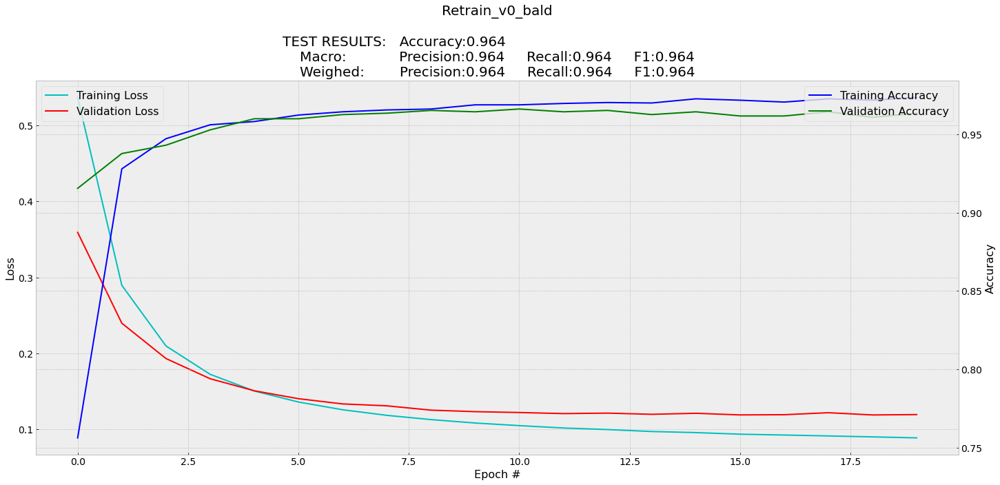

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP
All: 0.9626666666666667
True: 0.9626666666666667
False: 0.9626666666666667

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_14 (InputLayer)        [(None, 1, 512)]          0         
_________________________________________________________________
flatten_13 (Flatten)         (None, 512)               0         
_________________________________________________________________
dense_8 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 
# Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=50, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/50
27/27 [==============================] - 1s 12ms/step - loss: 0.4726 - accuracy: 0.8240 - val_loss: 0.3237 - val_accuracy: 0.9262
Epoch 2/50
27/27 [==============================] - 0s 4ms/step - loss: 0.2614 - accuracy: 0.9378 - val_loss: 0.2235 - val_accuracy: 0.9396
Epoch 3/50
27/27 [==============================] - 0s 4ms/step - loss: 0.1949 - accuracy: 0.9496 - val_loss: 0.1836 - val_accuracy: 0.9484
Epoch 4/50
27/27 [==============================] - 0s 5ms/step - loss: 0.1634 - accuracy: 0.9553 - val_loss: 0.1613 - val_accuracy: 0.9520
Epoch 5/50
27/27 [==============================] - 0s 4ms/step - loss: 0.1443 - accuracy: 0.9576 - val_loss: 0.1477 - val_accuracy: 0.9564
Epoch 6/50
27/27 [==============================] - 0s 4ms/step - loss: 0.1325 - accuracy: 0.9606 - val_loss: 0.1395 - val_accuracy: 0.9600
Epoch 7/50
27/27 [==============================] - 0s 4ms/step - loss: 0.1235 - accuracy: 0.9624 - val_loss: 0.1325 - val_accuracy: 0.9627
Epoch 8/50
27/27 [=

8397

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.9626666666666667
True: 0.9626666666666667
False: 0.9626666666666667
              precision    recall  f1-score   support

           0       0.96      0.96      0.96      2250
           1       0.96      0.96      0.96      2250

    accuracy                           0.96      4500
   macro avg       0.96      0.96      0.96      4500
weighted avg       0.96      0.96      0.96      4500



#### Gráfico de entrenamiento

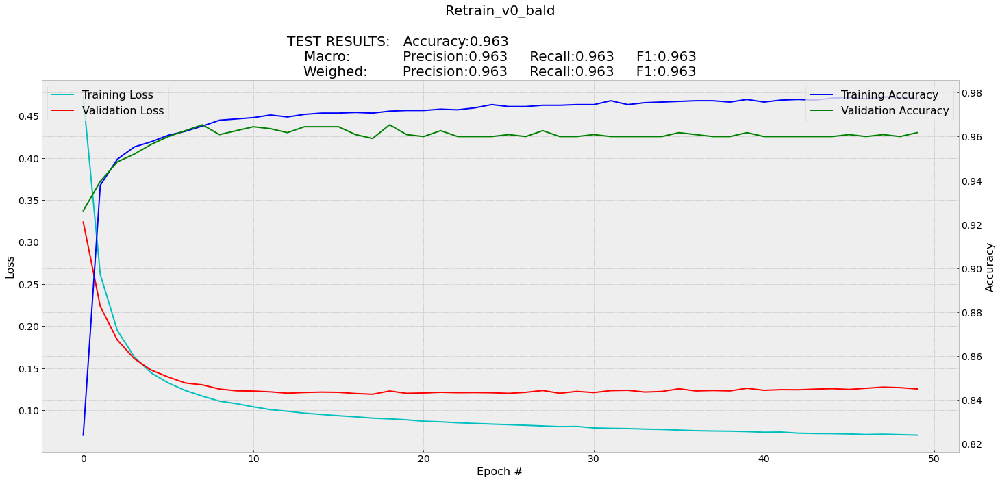

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP
All: 0.9044444 
True: 0.876 
False: 0.932888

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_8 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_7 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_5 (Dense)              (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-06), metrics=["accuracy"]) 
# Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/20
27/27 [==============================] - 1s 12ms/step - loss: 0.5899 - accuracy: 0.7147 - val_loss: 0.5290 - val_accuracy: 0.7858
Epoch 2/20
27/27 [==============================] - 0s 5ms/step - loss: 0.5032 - accuracy: 0.8231 - val_loss: 0.4866 - val_accuracy: 0.8213
Epoch 3/20
27/27 [==============================] - 0s 4ms/step - loss: 0.4713 - accuracy: 0.8492 - val_loss: 0.4635 - val_accuracy: 0.8409
Epoch 4/20
27/27 [==============================] - 0s 5ms/step - loss: 0.4520 - accuracy: 0.8640 - val_loss: 0.4478 - val_accuracy: 0.8613
Epoch 5/20
27/27 [==============================] - 0s 4ms/step - loss: 0.4382 - accuracy: 0.8738 - val_loss: 0.4363 - val_accuracy: 0.8738
Epoch 6/20
27/27 [==============================] - 0s 4ms/step - loss: 0.4278 - accuracy: 0.8809 - val_loss: 0.4272 - val_accuracy: 0.8773
Epoch 7/20
27/27 [==============================] - 0s 5ms/step - loss: 0.4194 - accuracy: 0.8853 - val_loss: 0.4197 - val_accuracy: 0.8827
Epoch 8/20
27/27 [=

8214

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.9044444444444445
True: 0.876
False: 0.9328888888888889
              precision    recall  f1-score   support

           0       0.93      0.88      0.90      2250
           1       0.88      0.93      0.91      2250

    accuracy                           0.90      4500
   macro avg       0.91      0.90      0.90      4500
weighted avg       0.91      0.90      0.90      4500



#### Gráfico de entrenamiento

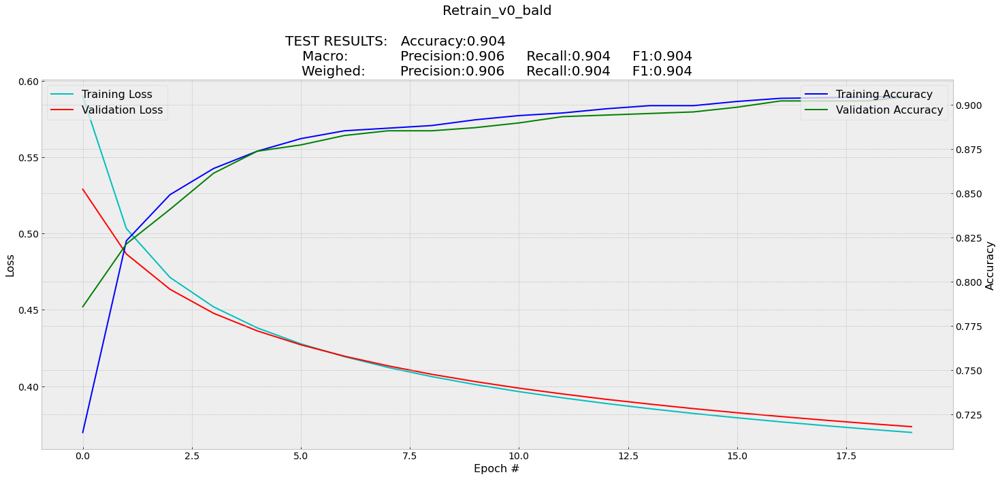

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.9442222222222222
True: 0.9275555555555556
False: 0.9608888888888889


#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(2, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_24 (InputLayer)        [(None, 1, 512)]          0         
_________________________________________________________________
flatten_23 (Flatten)         (None, 512)               0         
_________________________________________________________________
dense_15 (Dense)             (None, 2)                 1026      
Total params: 1,026
Trainable params: 1,026
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-06), metrics=["accuracy"]) 
# Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0.2, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=2000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/2000
27/27 [==============================] - 1s 10ms/step - loss: 0.6004 - accuracy: 0.6868 - val_loss: 0.5396 - val_accuracy: 0.7636
Epoch 2/2000
27/27 [==============================] - 0s 5ms/step - loss: 0.5092 - accuracy: 0.8110 - val_loss: 0.4967 - val_accuracy: 0.8196
Epoch 3/2000
27/27 [==============================] - 0s 4ms/step - loss: 0.4767 - accuracy: 0.8400 - val_loss: 0.4726 - val_accuracy: 0.8364
Epoch 4/2000
27/27 [==============================] - 0s 4ms/step - loss: 0.4569 - accuracy: 0.8604 - val_loss: 0.4566 - val_accuracy: 0.8507
Epoch 5/2000
27/27 [==============================] - 0s 5ms/step - loss: 0.4428 - accuracy: 0.8705 - val_loss: 0.4444 - val_accuracy: 0.8560
Epoch 6/2000
27/27 [==============================] - 0s 5ms/step - loss: 0.4321 - accuracy: 0.8794 - val_loss: 0.4349 - val_accuracy: 0.8613
Epoch 7/2000
27/27 [==============================] - 0s 4ms/step - loss: 0.4233 - accuracy: 0.8847 - val_loss: 0.4270 - val_accuracy: 0.8649
Epoch

9093

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

Data['Accuracy']=[np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                                                                      True_acc/(len(Data['Training']['Classes']['Test'])/2),
                                                                      False_acc/(len(Data['Training']['Classes']['Test'])/2)]
print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.9442222222222222
True: 0.9275555555555556
False: 0.9608888888888889
              precision    recall  f1-score   support

           0       0.96      0.93      0.94      2250
           1       0.93      0.96      0.95      2250

    accuracy                           0.94      4500
   macro avg       0.94      0.94      0.94      4500
weighted avg       0.94      0.94      0.94      4500



#### Gráfico de entrenamiento

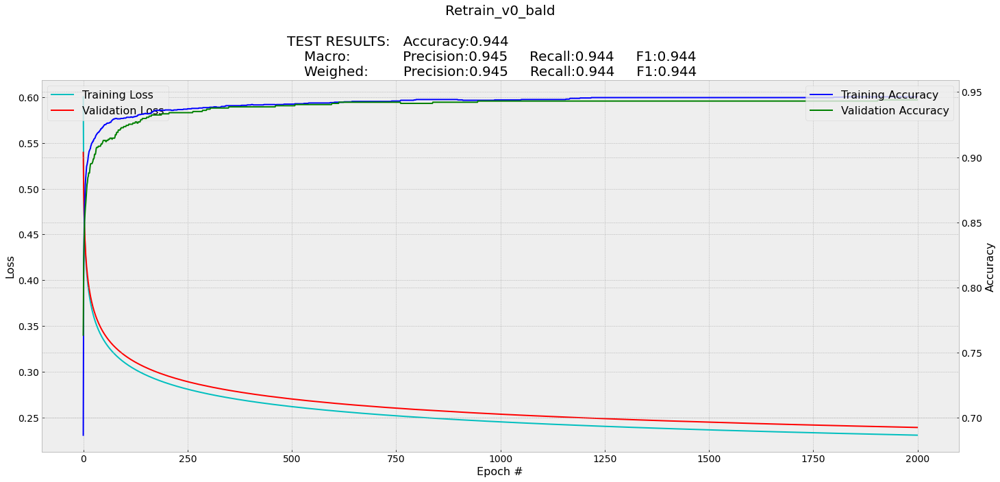

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19
All: 0.9471 
True: 0.9382 
False: 0.956

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
27/27 [==============================] - 101s 2s/step - loss: 0.7504 - accuracy: 0.8154 - val_loss: 0.2488 - val_accuracy: 0.9004
Epoch 2/20
27/27 [==============================] - 29s 1s/step - loss: 0.1747 - accuracy: 0.9304 - val_loss: 0.2059 - val_accuracy: 0.9244
Epoch 3/20
27/27 [==============================] - 29s 1s/step - loss: 0.1159 - accuracy: 0.9556 - val_loss: 0.2632 - val_accuracy: 0.9049
Epoch 4/20
27/27 [==============================] - 29s 1s/step - loss: 0.0884 - accuracy: 0.9671 - val_loss: 0.1943 - val_accuracy: 0.9342
Epoch 5/20
27/27 [==============================] - 29s 1s/step - loss: 0.0530 - accuracy: 0.9831 - val_loss: 0.2436 - val_accuracy: 0.9396
Epoch 6/20
27/27 [==============================] - 29s 1s/step - loss: 0.0250 - accuracy: 0.9929 - val_loss: 0.2622 - val_accuracy: 0.9404
Epoch 7/20
27/27 [==============================] - 29s 1s/step - loss: 0.0127 - accuracy: 0.9970 - val_loss: 0.2973 - val_accuracy: 0.9378
Epoch 8/20
27/27 [=

1624

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.9471111111111111
True: 0.9382222222222222
False: 0.956
              precision    recall  f1-score   support

           0       0.96      0.94      0.95      2250
           1       0.94      0.96      0.95      2250

    accuracy                           0.95      4500
   macro avg       0.95      0.95      0.95      4500
weighted avg       0.95      0.95      0.95      4500



#### Gráfico de entrenamiento

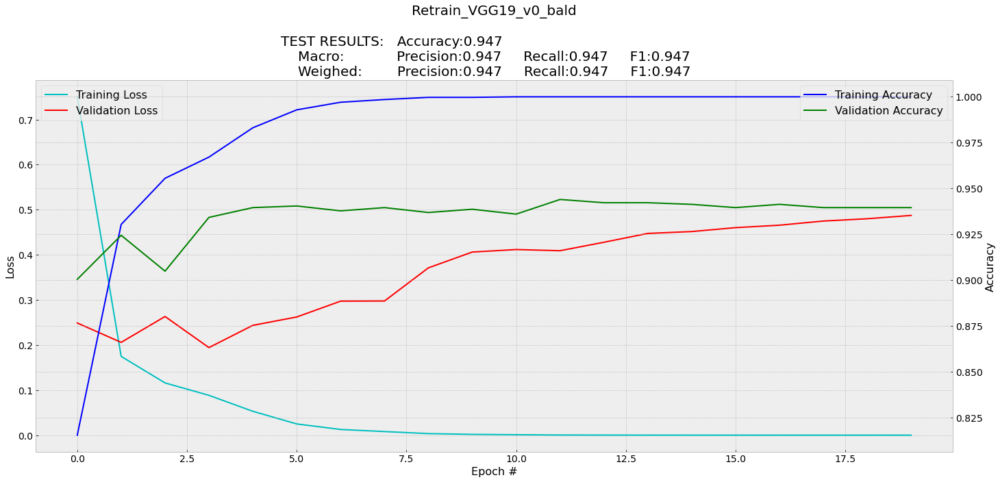

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.9122223 
True: 0.912444444 
False: 0.912

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_11 (InputLayer)        [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0  

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
27/27 [==============================] - 31s 1s/step - loss: 2.5757 - accuracy: 0.6406 - val_loss: 0.6572 - val_accuracy: 0.7538
Epoch 2/20
27/27 [==============================] - 30s 1s/step - loss: 0.3942 - accuracy: 0.8412 - val_loss: 0.4433 - val_accuracy: 0.8240
Epoch 3/20
27/27 [==============================] - 30s 1s/step - loss: 0.2397 - accuracy: 0.8999 - val_loss: 0.3937 - val_accuracy: 0.8560
Epoch 4/20
27/27 [==============================] - 30s 1s/step - loss: 0.1634 - accuracy: 0.9336 - val_loss: 0.3824 - val_accuracy: 0.8676
Epoch 5/20
27/27 [==============================] - 30s 1s/step - loss: 0.1106 - accuracy: 0.9618 - val_loss: 0.3771 - val_accuracy: 0.8800
Epoch 6/20
27/27 [==============================] - 30s 1s/step - loss: 0.0782 - accuracy: 0.9772 - val_loss: 0.3817 - val_accuracy: 0.8809
Epoch 7/20
27/27 [==============================] - 30s 1s/step - loss: 0.0550 - accuracy: 0.9896 - val_loss: 0.3909 - val_accuracy: 0.8818
Epoch 8/20
27/27 [==

11584

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.9122222222222223
True: 0.9124444444444444
False: 0.912
              precision    recall  f1-score   support

           0       0.91      0.91      0.91      2250
           1       0.91      0.91      0.91      2250

    accuracy                           0.91      4500
   macro avg       0.91      0.91      0.91      4500
weighted avg       0.91      0.91      0.91      4500



#### Gráfico de entrenamiento

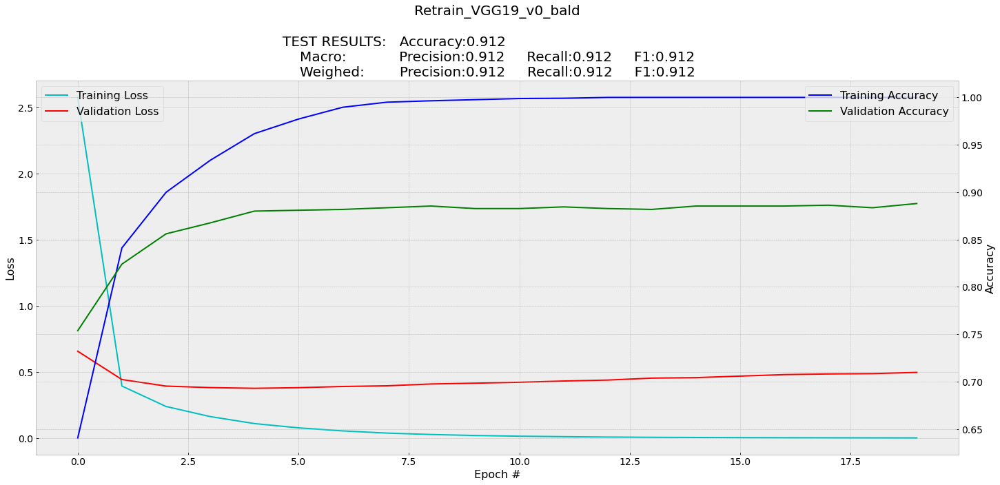

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.932222 
True: 0.96667 
False: 0.89778

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_18 (InputLayer)        [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0  

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
27/27 [==============================] - 31s 1s/step - loss: 1.1922 - accuracy: 0.6607 - val_loss: 0.4681 - val_accuracy: 0.7787
Epoch 2/10
27/27 [==============================] - 29s 1s/step - loss: 0.2771 - accuracy: 0.8853 - val_loss: 0.2683 - val_accuracy: 0.8862
Epoch 3/10
27/27 [==============================] - 29s 1s/step - loss: 0.1949 - accuracy: 0.9253 - val_loss: 0.3049 - val_accuracy: 0.8978
Epoch 4/10
27/27 [==============================] - 29s 1s/step - loss: 0.1642 - accuracy: 0.9399 - val_loss: 0.2187 - val_accuracy: 0.9209
Epoch 5/10
27/27 [==============================] - 29s 1s/step - loss: 0.1317 - accuracy: 0.9532 - val_loss: 0.2358 - val_accuracy: 0.9200
Epoch 6/10
27/27 [==============================] - 29s 1s/step - loss: 0.1068 - accuracy: 0.9639 - val_loss: 0.1947 - val_accuracy: 0.9307
Epoch 7/10
27/27 [==============================] - 29s 1s/step - loss: 0.0924 - accuracy: 0.9683 - val_loss: 0.2222 - val_accuracy: 0.9138
Epoch 8/10
27/27 [==

10953

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['VGG19 Model Accuracy']=[np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.9322222222222222
True: 0.9666666666666667
False: 0.8977777777777778
              precision    recall  f1-score   support

           0       0.90      0.97      0.93      2250
           1       0.96      0.90      0.93      2250

    accuracy                           0.93      4500
   macro avg       0.93      0.93      0.93      4500
weighted avg       0.93      0.93      0.93      4500



#### Gráfico de entrenamiento

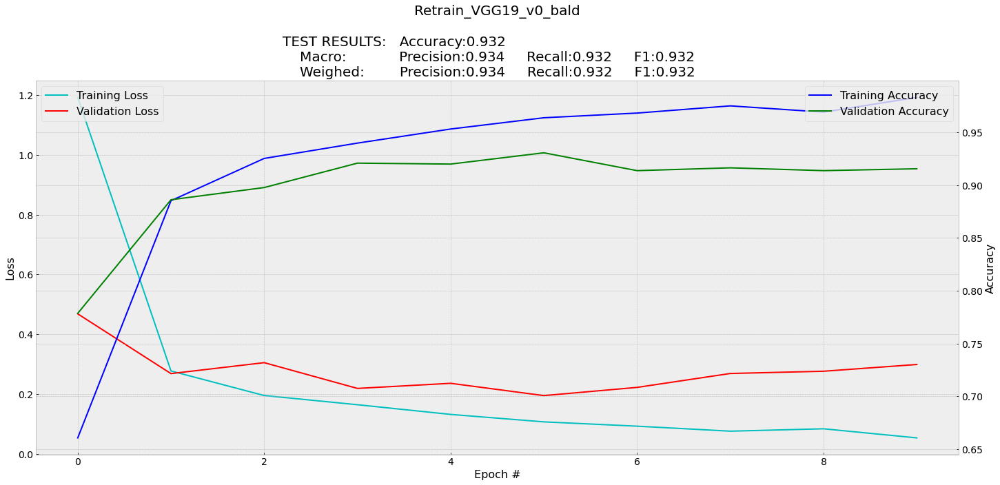

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.914 
True: 0.9017777777777778 
False: 0.9262222222222222

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_3[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
27/27 [==============================] - 49s 2s/step - loss: 0.5333 - accuracy: 0.7227 - val_loss: 0.5713 - val_accuracy: 0.7387
Epoch 2/20
27/27 [==============================] - 37s 1s/step - loss: 0.2013 - accuracy: 0.9333 - val_loss: 0.4715 - val_accuracy: 0.8018
Epoch 3/20
27/27 [==============================] - 37s 1s/step - loss: 0.0877 - accuracy: 0.9748 - val_loss: 0.3392 - val_accuracy: 0.8667
Epoch 4/20
27/27 [==============================] - 37s 1s/step - loss: 0.0375 - accuracy: 0.9923 - val_loss: 0.3486 - val_accuracy: 0.8756
Epoch 5/20
27/27 [==============================] - 37s 1s/step - loss: 0.0185 - accuracy: 0.9979 - val_loss: 0.3141 - val_accuracy: 0.8889
Epoch 6/20
27/27 [==============================] - 37s 1s/step - loss: 0.0127 - accuracy: 0.9976 - val_loss: 0.3135 - val_accuracy: 0.8880
Epoch 7/20
27/27 [==============================] - 37s 1s/step - loss: 0.0114 - accuracy: 0.9997 - val_loss: 0.3351 - val_accuracy: 0.8862
Epoch 8/20
27/27 [==

7430

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.914
True: 0.9017777777777778
False: 0.9262222222222222
              precision    recall  f1-score   support

           0       0.92      0.90      0.91      2250
           1       0.90      0.93      0.92      2250

    accuracy                           0.91      4500
   macro avg       0.91      0.91      0.91      4500
weighted avg       0.91      0.91      0.91      4500



#### Gráfico de entrenamiento

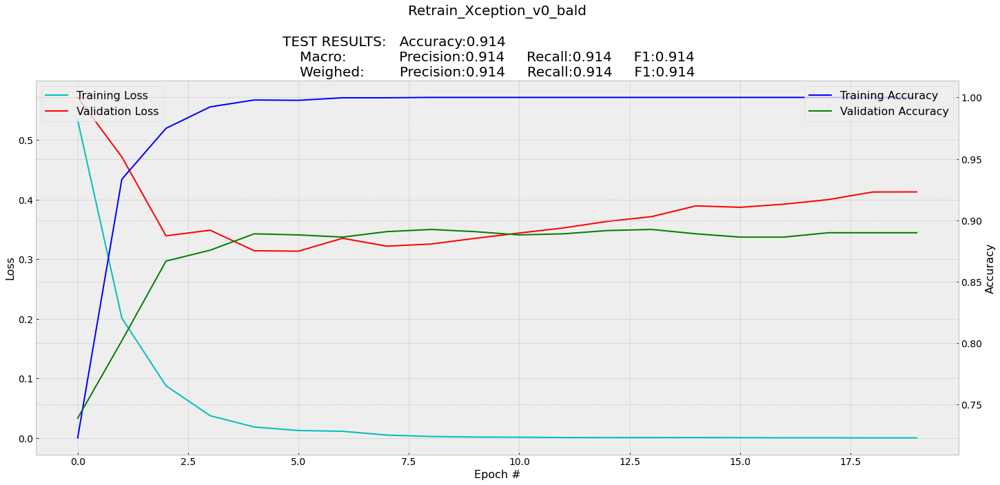

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception
All: 0.9157777 
True: 0.90577777 
False: 0.92577777

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_9[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
27/27 [==============================] - 43s 1s/step - loss: 0.5103 - accuracy: 0.7399 - val_loss: 0.4471 - val_accuracy: 0.8098
Epoch 2/10
27/27 [==============================] - 37s 1s/step - loss: 0.1938 - accuracy: 0.9363 - val_loss: 0.3835 - val_accuracy: 0.8418
Epoch 3/10
27/27 [==============================] - 37s 1s/step - loss: 0.0806 - accuracy: 0.9799 - val_loss: 0.3385 - val_accuracy: 0.8604
Epoch 4/10
27/27 [==============================] - 37s 1s/step - loss: 0.0338 - accuracy: 0.9944 - val_loss: 0.3064 - val_accuracy: 0.8782
Epoch 5/10
27/27 [==============================] - 37s 1s/step - loss: 0.0166 - accuracy: 0.9982 - val_loss: 0.3046 - val_accuracy: 0.8844
Epoch 6/10
27/27 [==============================] - 37s 1s/step - loss: 0.0086 - accuracy: 0.9997 - val_loss: 0.3078 - val_accuracy: 0.8898
Epoch 7/10
27/27 [==============================] - 37s 1s/step - loss: 0.0047 - accuracy: 0.9997 - val_loss: 0.3068 - val_accuracy: 0.8880
Epoch 8/10
27/27 [==

26219

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.9157777777777778
True: 0.9057777777777778
False: 0.9257777777777778
              precision    recall  f1-score   support

           0       0.92      0.91      0.91      2250
           1       0.91      0.93      0.92      2250

    accuracy                           0.92      4500
   macro avg       0.92      0.92      0.92      4500
weighted avg       0.92      0.92      0.92      4500



#### Gráfico de entrenamiento

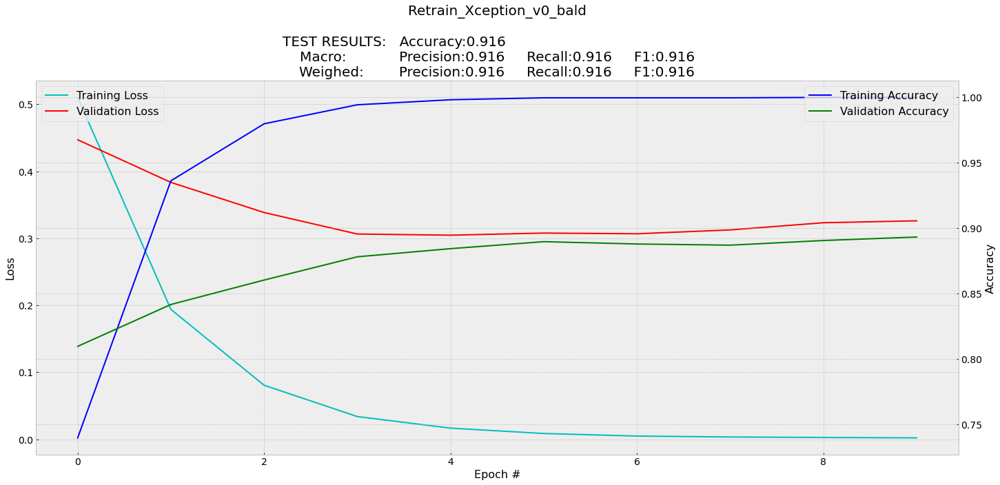

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.8946666666666667
True: 0.8888888888888888
False: 0.9004444444444445

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_10 (InputLayer)           [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_10[0][0]                   
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
27/27 [==============================] - 43s 1s/step - loss: 0.6488 - accuracy: 0.6204 - val_loss: 0.6330 - val_accuracy: 0.6569
Epoch 2/20
27/27 [==============================] - 37s 1s/step - loss: 0.4927 - accuracy: 0.7867 - val_loss: 0.5613 - val_accuracy: 0.6960
Epoch 3/20
27/27 [==============================] - 37s 1s/step - loss: 0.3988 - accuracy: 0.8542 - val_loss: 0.5208 - val_accuracy: 0.7200
Epoch 4/20
27/27 [==============================] - 37s 1s/step - loss: 0.3246 - accuracy: 0.8907 - val_loss: 0.4644 - val_accuracy: 0.7627
Epoch 5/20
27/27 [==============================] - 37s 1s/step - loss: 0.2669 - accuracy: 0.9159 - val_loss: 0.4188 - val_accuracy: 0.7982
Epoch 6/20
27/27 [==============================] - 37s 1s/step - loss: 0.2178 - accuracy: 0.9375 - val_loss: 0.3826 - val_accuracy: 0.8258
Epoch 7/20
27/27 [==============================] - 37s 1s/step - loss: 0.1797 - accuracy: 0.9532 - val_loss: 0.3587 - val_accuracy: 0.8364
Epoch 8/20
27/27 [==

26976

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.8946666666666667
True: 0.8888888888888888
False: 0.9004444444444445
              precision    recall  f1-score   support

           0       0.90      0.89      0.89      2250
           1       0.89      0.90      0.90      2250

    accuracy                           0.89      4500
   macro avg       0.89      0.89      0.89      4500
weighted avg       0.89      0.89      0.89      4500



#### Gráfico de entrenamiento

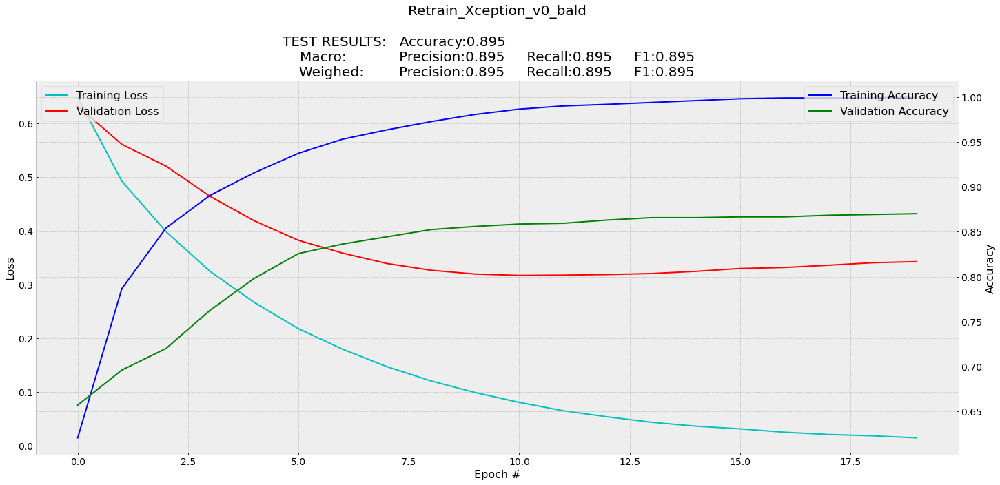

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception
All: 0.9204444444444444
True: 0.9031111111111111
False: 0.9377777777777778

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_15"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_16 (InputLayer)           [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_16[0][0]                   
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
___________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
27/27 [==============================] - 43s 1s/step - loss: 0.4088 - accuracy: 0.8136 - val_loss: 0.4991 - val_accuracy: 0.8213
Epoch 2/10
27/27 [==============================] - 37s 1s/step - loss: 0.0986 - accuracy: 0.9677 - val_loss: 0.3421 - val_accuracy: 0.8756
Epoch 3/10
27/27 [==============================] - 37s 1s/step - loss: 0.0262 - accuracy: 0.9944 - val_loss: 0.3126 - val_accuracy: 0.8898
Epoch 4/10
27/27 [==============================] - 37s 1s/step - loss: 0.0086 - accuracy: 0.9991 - val_loss: 0.2967 - val_accuracy: 0.9022
Epoch 5/10
27/27 [==============================] - 37s 1s/step - loss: 0.0049 - accuracy: 0.9991 - val_loss: 0.3137 - val_accuracy: 0.9049
Epoch 6/10
27/27 [==============================] - 37s 1s/step - loss: 0.0020 - accuracy: 1.0000 - val_loss: 0.3225 - val_accuracy: 0.9040
Epoch 7/10
27/27 [==============================] - 37s 1s/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.3313 - val_accuracy: 0.9076
Epoch 8/10
27/27 [==

26160

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.9204444444444444
True: 0.9031111111111111
False: 0.9377777777777778
              precision    recall  f1-score   support

           0       0.94      0.90      0.92      2250
           1       0.91      0.94      0.92      2250

    accuracy                           0.92      4500
   macro avg       0.92      0.92      0.92      4500
weighted avg       0.92      0.92      0.92      4500



#### Gráfico de entrenamiento

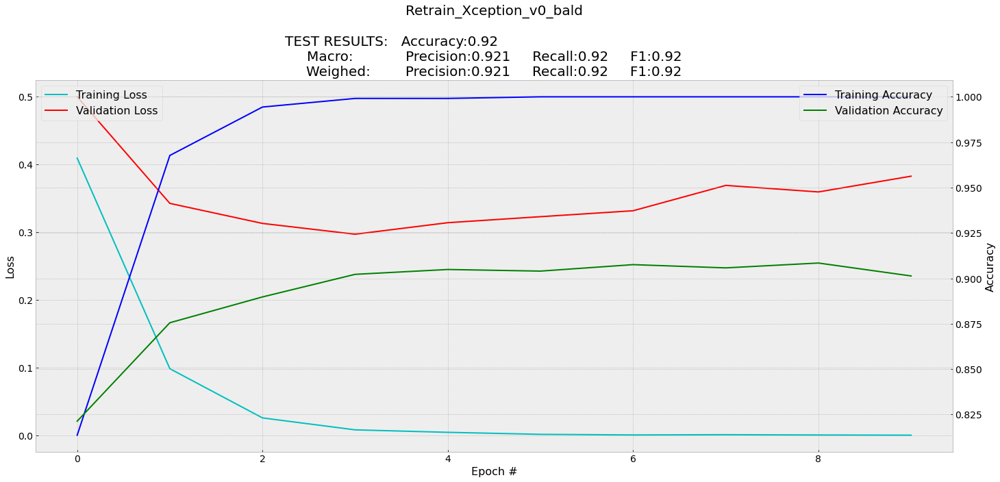

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.9251111111111111
True: 0.9164444444444444
False: 0.9337777777777778

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(2, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_21"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_22 (InputLayer)           [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_22[0][0]                   
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
___________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=9, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/9
27/27 [==============================] - 43s 1s/step - loss: 0.4211 - accuracy: 0.8074 - val_loss: 0.6691 - val_accuracy: 0.7769
Epoch 2/9
27/27 [==============================] - 37s 1s/step - loss: 0.1019 - accuracy: 0.9639 - val_loss: 0.5340 - val_accuracy: 0.8373
Epoch 3/9
27/27 [==============================] - 37s 1s/step - loss: 0.0286 - accuracy: 0.9938 - val_loss: 0.4400 - val_accuracy: 0.8587
Epoch 4/9
27/27 [==============================] - 37s 1s/step - loss: 0.0081 - accuracy: 0.9991 - val_loss: 0.3648 - val_accuracy: 0.8791
Epoch 5/9
27/27 [==============================] - 37s 1s/step - loss: 0.0029 - accuracy: 0.9997 - val_loss: 0.3403 - val_accuracy: 0.8951
Epoch 6/9
27/27 [==============================] - 37s 1s/step - loss: 0.0015 - accuracy: 1.0000 - val_loss: 0.3250 - val_accuracy: 0.8978
Epoch 7/9
27/27 [==============================] - 37s 1s/step - loss: 0.0010 - accuracy: 1.0000 - val_loss: 0.3283 - val_accuracy: 0.9049
Epoch 8/9
27/27 [==========

26431

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
True_acc=0
False_acc=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==1:
            False_acc+=1
    else:
        if pred==0:
            True_acc+=1
    i+=1

    
Data['Xception Model Accuracy']=[np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']),
                  True_acc/(len(Data['Training']['Classes']['Test'])/2), False_acc/(len(Data['Training']['Classes']['Test'])/2)]

print('True:',True_acc/(len(Data['Training']['Classes']['Test'])/2))
print('False:',False_acc/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.9251111111111111
True: 0.9164444444444444
False: 0.9337777777777778
              precision    recall  f1-score   support

           0       0.93      0.92      0.92      2250
           1       0.92      0.93      0.93      2250

    accuracy                           0.93      4500
   macro avg       0.93      0.93      0.93      4500
weighted avg       0.93      0.93      0.93      4500



#### Gráfico de entrenamiento

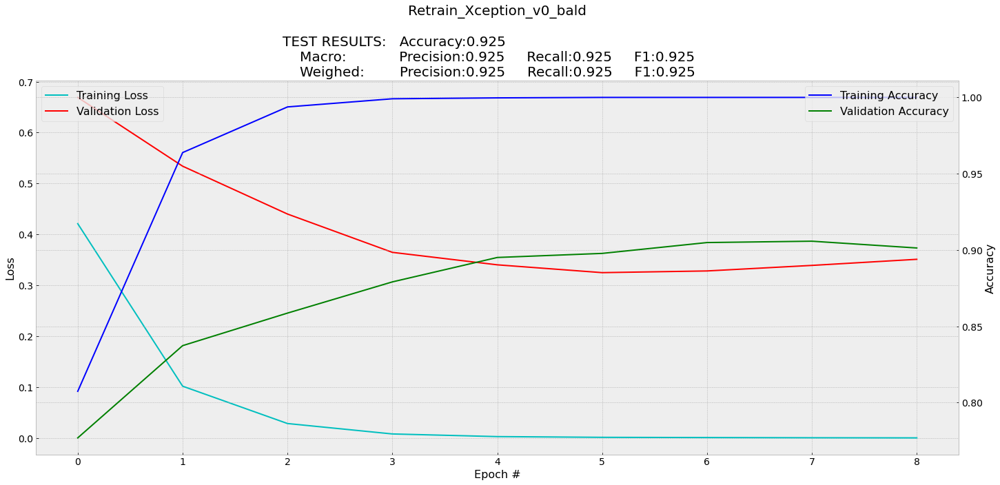

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

# Etiqueta Celeba: "rosy cheeks"

## Proceso

### CLIP crear "prompt" y preparar parámetros

In [ ]:
import torch
import clip
from PIL import Image
import glob

Name_feature='_rosy_cheecks'
id_feature=29
Save_Data_Path=BASE_FOLDER_2+'Retrain_v0'+Name_feature+'.pkl'

Index_To_Test=[]
Label_To_Test=[]
Data_To_Train=[]
Label_To_Train=[]
Data = {'Training':{}, 'Model Name':{}, 'H':{}, 'Classes':{}}
Data['Training']={'Images':{},'Images array':{}, 'Classes':{}, 'Classes array':{}, 'Index':{}, 'H':{}}
Data['Training']['Images']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Images array']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes array']={'Train':{}, 'Validate':{}}

clip_tokens=[ 'A picture of a person', 'A picture of a person with rosy cheeks', 'A picture of a person with rosy cheek',
            'A picture of a rosy cheeks person', 'A picture of a rosy cheek person', 
             'A picture of a person who have rosy cheeks', 'A picture of a person who have rosy cheek',
             'A picture of a person with flush cheeks', 'A picture of a person with color cheeks',
             'A picture of a person who turn red', 'A picture of a person who turn scarlet',
             'A picture of a redden person','A picture of a person with cheeks',
             'A picture of a person with pale cheeks', 'A picture of a person with blanch cheeks']

N_Tokens=len(clip_tokens)
print(N_Tokens)
print(clip_tokens)
for current_token in clip_tokens:
    print(current_token)

# [ 'A picture of a person',"A picture of a person with 5 o'clock shadow",'A picture of a person with arched eyebrows',
# 'A picture of an attractive person','A picture of a person with bags under eyes',
# 'A picture of a bald person','A picture of a person with bangs','A picture of a person with big lips',
# 'A picture of a person with big nose','A picture of a person with black hair',
# 'A picture of a person with blond hair','A blurry picture of a person',
# 'A picture of a person with brown hair','A picture of a person with bushy eyebrows',
# 'A picture of a chubby person','A picture of a person with double chin','A picture of a person with eyeglasses',
# 'A picture of a person with goatee','A picture of a person with gray hair','A picture of a person with heavy makeup',
# 'A picture of a person with high cheekbones','A picture of a male person',
# 'A picture of a person with mouth slightly open','A picture of a person with mustache',
# 'A picture of a person with narrow eyes','A picture of a person with no beard',
# 'A picture of a person with oval face','A picture of a person with pale skin','A picture of a person with pointy nose',
# 'A picture of a person with receding hairline','A picture of a person with rosy cheeks','A picture of a person with sideburns',
# 'A picture of a person who is smiling','A picture of a person with straight hair','A picture of a person with wavy hair',
# 'A picture of a person with earrings','A picture of a person with hat','A picture of a person with lipstick',
# 'A picture of a person with necklace','A picture of a person with necktie','A picture of a young person']

15
['A picture of a person', 'A picture of a person with rosy cheeks', 'A picture of a person with rosy cheek', 'A picture of a rosy cheeks person', 'A picture of a rosy cheek person', 'A picture of a person who have rosy cheeks', 'A picture of a person who have rosy cheek', 'A picture of a person with flush cheeks', 'A picture of a person with color cheeks', 'A picture of a person who turn red', 'A picture of a person who turn scarlet', 'A picture of a redden person', 'A picture of a person with cheeks', 'A picture of a person with pale cheeks', 'A picture of a person with blanch cheeks']
A picture of a person
A picture of a person with rosy cheeks
A picture of a person with rosy cheek
A picture of a rosy cheeks person
A picture of a rosy cheek person
A picture of a person who have rosy cheeks
A picture of a person who have rosy cheek
A picture of a person with flush cheeks
A picture of a person with color cheeks
A picture of a person who turn red
A picture of a person who turn scarle

### Cargar CLIP

In [ ]:
clip_device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, clip_transform = clip.load("ViT-B/32", device=clip_device)
clip_text = clip.tokenize(clip_tokens).to(clip_device)

# CLIP features
text_features = clip_model.encode_text(clip_text)

test_index=1
test_image_path=Path_images+str(test_index).zfill(6)+'.jpg'
img_proeprocessed = clip_transform(Image.open(test_image_path)).unsqueeze(0).to(clip_device)
img_features = clip_model.encode_image(img_proeprocessed)
img_features_shape= img_features.shape

print('\n- Image Features:')
print('     Type:',type(img_features))
print('     Shape:',img_features_shape)
print('\n- Text Features:')
print('     Type:',type(text_features))
print('     Shape:',text_features.shape)
print('\n- Image Features Tensor:')
print(img_features)
print('\n- Text Features Tesor:')
print(text_features)


- Image Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([1, 512])

- Text Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([15, 512])

- Image Features Tensor:
tensor([[-6.0150e-02,  1.7044e-02, -9.9854e-02,  2.3523e-01, -6.8359e-02,
         -8.4814e-01, -3.7036e-01, -4.8169e-01, -3.1921e-02, -3.8666e-02,
         -5.1666e-02, -1.9775e-01,  6.2061e-01, -5.4565e-02,  7.4365e-01,
          4.4678e-02,  1.5791e+00, -4.6045e-01,  1.3513e-01, -1.4685e-01,
         -3.7012e-01, -3.7183e-01, -4.6509e-01, -2.8833e-01, -1.7578e-01,
         -1.3904e-01,  2.9028e-01, -9.5642e-02,  3.9746e-01,  1.3770e-01,
          5.1855e-01,  1.5613e-01,  8.7524e-02, -1.0674e-02, -9.4531e-01,
          2.2595e-01, -3.6133e-02,  4.6924e-01,  9.4604e-02,  1.5908e+00,
          2.1533e-01,  1.9360e-01, -5.3284e-02, -7.5500e-02, -6.1111e-03,
          1.4443e+00,  1.2891e-01,  5.3613e-01,  4.5630e-01,  3.9478e-01,
          1.7310e-01,  1.6138e-01, -2.8870e-02, -2.5464e-01, -

### Seleccionar indices a usar del Dataset Celeba

In [ ]:
# encontrar indices man_woman true/false
Index_Features_0=[]
Index_Features_1=[]

i=0
for descripton in Description_data:
    i=i+1
    if descripton[id_feature]: 
        Index_Features_0.append(i)
    else:
        Index_Features_1.append(i)

## Mostrar Results       
min_value=9999999
print('Examples of celeba:')
print(Description_labels[id_feature]+':',len(Index_Features_0))
print('Not '+Description_labels[id_feature]+':',len(Index_Features_1))  

# Smiling -  True: 97669
# Smiling - False: 104930

### Cargar Datos (ejectuar si se dispone del archivo de datos creado)

In [ ]:
## LOAD DATA
file_to_load = open(Save_Data_Path, "rb")
df_loaded = pickle.load(file_to_load)
file_to_load.close()

Data=df_loaded['Data']
Index_To_Test=df_loaded['Index_To_Test']
Label_To_Test=df_loaded['Label_To_Test']
Data_To_Train=df_loaded['Data_To_Train']
Label_To_Train=df_loaded['Label_To_Train']

### Preparar datos (ejectuar solo si no se dispone del archivo de datos creado)

In [ ]:
def Preprocess_img(images_id,clip_device,clip_model,clip_preprocess,clip_text):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    probs=CLIP_get_probs_only(test_image_path, clip_text, clip_model, clip_preprocess, clip_device)
    return clip_model.encode_image(clip_img).detach().numpy(), np.array(img_current), probs

def Preprocess_img2(images_id,clip_device,clip_model,clip_preprocess):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    return clip_model.encode_image(clip_img).detach().numpy(), np.array(img_current)

Data['Training']['Images']['Test']=[]
Data['Training']['Images']['Not Test']=[]
Data['Training']['Classes']['Test']=[]
Data['Training']['Classes']['Not Test']=[]
Data['Training']['Images array']['Test']=[]
Data['Training']['Images array']['Not Test']=[]

Data['Prediccion_Probs']=np.zeros((16000,N_Tokens))
n=0
for i in range(4000):
    Index_To_Test.append(Index_Features_0[i])
    Label_To_Test.append(clip_tokens[1])
    img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_0[i],clip_device,clip_model,clip_transform,clip_text)
    Data['Training']['Images']['Test'].append(img)
    Data['Training']['Images array']['Test'].append(img_arr)
    Data['Training']['Classes']['Test'].append(0)
    n+=1
    Index_To_Test.append(Index_Features_1[i])
    Label_To_Test.append(clip_tokens[2])
    img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_1[i],clip_device,clip_model,clip_transform,clip_text)
    Data['Training']['Images']['Test'].append(img)
    Data['Training']['Images array']['Test'].append(img_arr)
    Data['Training']['Classes']['Test'].append(1)
    n+=1

    if i % 400 == 0 and i>0:
        print('Test images load (%):',i/40)
        
        df_to_save= {'Data': Data,
                      'Index_To_Test':Index_To_Test,
                      'Label_To_Test':Label_To_Test,
                      'Data_To_Train':Data_To_Train,
                      'Label_To_Train':Label_To_Train
        }
        save_df_to_file(df_to_save,Save_Data_Path)

    gc.collect() 
    
for i in range(4000,8000):
    Data_To_Train.append(Index_Features_0[i])
    Label_To_Train.append(clip_tokens[1])
    img, img_arr=Preprocess_img2(Index_Features_0[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Not Test'].append(img)
    Data['Training']['Images array']['Not Test'].append(img_arr)
    Data['Training']['Classes']['Not Test'].append(0)

    Data_To_Train.append(Index_Features_1[i])
    Label_To_Train.append(clip_tokens[2])
    img, img_arr=Preprocess_img2(Index_Features_1[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Not Test'].append(img)
    Data['Training']['Images array']['Not Test'].append(img_arr)
    Data['Training']['Classes']['Not Test'].append(1)

    if i % 400 == 0 and i>2000:
        print('Train images load (%):',(i-4000)/40)
        df_to_save= {'Data': Data,
                      'Index_To_Test':Index_To_Test,
                      'Label_To_Test':Label_To_Test,
                      'Data_To_Train':Data_To_Train,
                      'Label_To_Train':Label_To_Train
        }
        save_df_to_file(df_to_save,Save_Data_Path)
    # gc.collect()

Data['Classes']=[]
for element in np.unique(Data['Training']['Classes']['Test']):
    Data['Classes'].append(np.int(element))

Data['Training']['Images']['Train'], Data['Training']['Images']['Validate'], Data['Training']['Classes']['Train'], Data['Training']['Classes']['Validate'] = train_test_split(Data['Training']['Images']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)
Data['Training']['Images array']['Train'], Data['Training']['Images array']['Validate'], Data['Training']['Classes array']['Train'], Data['Training']['Classes array']['Validate'] = train_test_split(Data['Training']['Images array']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)

df_to_save= {'Data': Data,
              'Index_To_Test':Index_To_Test,
              'Label_To_Test':Label_To_Test,
              'Data_To_Train':Data_To_Train,
              'Label_To_Train':Label_To_Train
}
save_df_to_file(df_to_save,Save_Data_Path)

## Visualizar número de entrenamiento
print('NÚMERO DE DATOS PARA ENTRENAR/TEST')
print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Not Test']),'con',len(np.unique(Data['Training']['Classes']['Test'])),'clases')
print('Número de datos para Test:',  len(Data['Training']['Classes']['Test']),'con',len(np.unique(Data['Training']['Classes']['Not Test'])),'clases')

## Visualizar número de entrenamiento
print('\nNÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN')
print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Train']),'con',len(np.unique(Data['Training']['Classes']['Train'])),'clases')
print('Número de datos para Validación:',  len(Data['Training']['Classes']['Validate']),'con',len(np.unique(Data['Training']['Classes']['Validate'])),'clases')


Test images load (%): 10.0
Test images load (%): 20.0
Test images load (%): 30.0
Test images load (%): 40.0
Test images load (%): 50.0
Test images load (%): 60.0
Test images load (%): 70.0
Test images load (%): 80.0
Test images load (%): 90.0
Train images load (%): 0.0
Train images load (%): 10.0
Train images load (%): 20.0
Train images load (%): 30.0
Train images load (%): 40.0
Train images load (%): 50.0
Train images load (%): 60.0
Train images load (%): 70.0
Train images load (%): 80.0
Train images load (%): 90.0
NÚMERO DE DATOS PARA ENTRENAR/TEST
Número de datos para Entrenamiento: 8000 con 2 clases
Número de datos para Test: 8000 con 2 clases

NÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN
Número de datos para Entrenamiento: 6000 con 2 clases
Número de datos para Validación: 2000 con 2 clases


## CLIP prompts

##### Calcular tokens celeba

In [ ]:
Prediccion_Probs=Data['Prediccion_Probs']

N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(len(clip_tokens)-1)
Precision_False=np.zeros(len(clip_tokens)-1)
Precision_All=np.zeros(len(clip_tokens)-1)

for i in range(len(clip_tokens)-1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0,1,2,3,4,5,6,7,8,9,10,11]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [12,13]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    else:
        for k in [12,13]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [0,1,2,3,4,5,6,7,8,9,10,11]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba

In [ ]:
## Resulrts
celeba_labels=[29,29,29,29,29,29,29,29,29,29,29,29,29,29]
dataframe_array=[]
for i in range(len(clip_tokens)-1):
    dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])

dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(len(clip_tokens)-1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref.csv",';')
print(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref.csv")

,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Rosy_Cheeks,A picture of a person with rosy cheeks,27.05,72.25,49.65
1,Rosy_Cheeks,A picture of a person with rosy cheek,48.7,65.2,56.95
2,Rosy_Cheeks,A picture of a rosy cheeks person,18.1,82.12,50.11
3,Rosy_Cheeks,A picture of a rosy cheek person,22.38,84.28,53.32
4,Rosy_Cheeks,A picture of a person who have rosy cheeks,23.98,75.82,49.9
5,Rosy_Cheeks,A picture of a person who have rosy cheek,12.88,80.53,46.7
6,Rosy_Cheeks,A picture of a person with flush cheeks,12.88,80.53,46.7
7,Rosy_Cheeks,A picture of a person with color cheeks,13.68,82.65,48.16
8,Rosy_Cheeks,A picture of a person who turn red,13.48,88.68,51.08
9,Rosy_Cheeks,A picture of a person who turn scarlet,1.52,95.68,48.6


/content/drive/My Drive/Colab Notebooks/CLIP__rosy_cheecks_vs_ref.csv


##### Calcular tokens celeba - cambio de referencia 1

In [ ]:
New_reference=12
N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(13)
Precision_False=np.zeros(13)
Precision_All=np.zeros(13)

for i in range(len(clip_tokens)-1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0,1,2,3,4,5,6,7,8,9,10]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,New_reference]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [12,13]:
            Index_Features_False[k-1].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,New_reference]:
                Precision_False[k-1]+=1
                Precision_All[k-1]+=1
    else:
        for k in [12,13]:
            Index_Features_True[k-1].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,New_reference]:
                Precision_True[k-1]+=1
                Precision_All[k-1]+=1

        for k in [0,1,2,3,4,5,6,7,8,9,10]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,New_reference]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba - cambio de referencia 1

In [ ]:
## Resulrts
celeba_labels=[29,29,29,29,29,29,29,29,29,29,29,29,29,29,29]
dataframe_array=[]
for i in range(13):
    if i<10: 
        dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])

    else: 
        dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+2],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])
dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(13)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
print('Referencia:',clip_tokens[New_reference])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref_b.csv",';')

Referencia: A picture of a person with cheeks


,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Rosy_Cheeks,A picture of a person with rosy cheeks,42.55,46.5,44.52
1,Rosy_Cheeks,A picture of a person with rosy cheek,65.68,36.0,50.84
2,Rosy_Cheeks,A picture of a rosy cheeks person,26.9,60.92,43.91
3,Rosy_Cheeks,A picture of a rosy cheek person,41.18,57.4,49.29
4,Rosy_Cheeks,A picture of a person who have rosy cheeks,37.55,50.5,44.02
5,Rosy_Cheeks,A picture of a person who have rosy cheek,26.12,56.28,41.2
6,Rosy_Cheeks,A picture of a person with flush cheeks,26.12,56.28,41.2
7,Rosy_Cheeks,A picture of a person with color cheeks,32.83,52.78,42.8
8,Rosy_Cheeks,A picture of a person who turn red,34.67,58.4,46.54
9,Rosy_Cheeks,A picture of a person who turn scarlet,9.57,80.65,45.11


##### Calcular tokens celeba - cambio de referencia 2

In [ ]:
New_reference=13
N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(11)
Precision_False=np.zeros(11)
Precision_All=np.zeros(11)

for i in range(11):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0,1,2,3,4,5,6,7,8,9,10]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,New_reference]:
                Precision_True[k]+=1
                Precision_All[k]+=1
    else:
        for k in [0,1,2,3,4,5,6,7,8,9,10]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,New_reference]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba - cambio de referencia 2

In [ ]:
## Resulrts
celeba_labels=[29,29,29,29,29,29,29,29,29,29,29,29,29]
dataframe_array=[]
for i in range(11):
    dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                      Precision_percent_True[i],
                      Precision_percent_False[i],
                      Precision_percent_All[i]
                      ])


dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(11)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
print('Referencia:',clip_tokens[New_reference])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref_c.csv",';')

Referencia: A picture of a person with pale cheeks


,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Rosy_Cheeks,A picture of a person with rosy cheeks,42.9,50.08,46.49
1,Rosy_Cheeks,A picture of a person with rosy cheek,64.75,38.0,51.38
2,Rosy_Cheeks,A picture of a rosy cheeks person,31.2,61.6,46.4
3,Rosy_Cheeks,A picture of a rosy cheek person,42.95,57.82,50.39
4,Rosy_Cheeks,A picture of a person who have rosy cheeks,39.22,52.2,45.71
5,Rosy_Cheeks,A picture of a person who have rosy cheek,29.6,55.9,42.75
6,Rosy_Cheeks,A picture of a person with flush cheeks,29.6,55.9,42.75
7,Rosy_Cheeks,A picture of a person with color cheeks,40.05,52.38,46.21
8,Rosy_Cheeks,A picture of a person who turn red,37.02,57.2,47.11
9,Rosy_Cheeks,A picture of a person who turn scarlet,10.3,81.98,46.14


##### Calcular tokens celeba - cambio de referencia 3

In [ ]:
New_reference=14
N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(11)
Precision_False=np.zeros(11)
Precision_All=np.zeros(11)

for i in range(11):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0,1,2,3,4,5,6,7,8,9,10]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,New_reference]:
                Precision_True[k]+=1
                Precision_All[k]+=1
    else:
        for k in [0,1,2,3,4,5,6,7,8,9,10]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,New_reference]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba - cambio de referencia 3

In [ ]:
## Resulrts
celeba_labels=[29,29,29,29,29,29,29,29,29,29,29,29,29]
dataframe_array=[]
for i in range(11):
    dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                      Precision_percent_True[i],
                      Precision_percent_False[i],
                      Precision_percent_All[i]
                      ])


dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(11)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
print('Referencia:',clip_tokens[New_reference])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref_d.csv",';')

Referencia: A picture of a person with blanch cheeks


,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Rosy_Cheeks,A picture of a person with rosy cheeks,19.6,64.3,41.95
1,Rosy_Cheeks,A picture of a person with rosy cheek,37.95,54.58,46.26
2,Rosy_Cheeks,A picture of a rosy cheeks person,10.6,77.38,43.99
3,Rosy_Cheeks,A picture of a rosy cheek person,13.88,78.5,46.19
4,Rosy_Cheeks,A picture of a person who have rosy cheeks,15.25,69.28,42.26
5,Rosy_Cheeks,A picture of a person who have rosy cheek,8.5,73.42,40.96
6,Rosy_Cheeks,A picture of a person with flush cheeks,8.5,73.42,40.96
7,Rosy_Cheeks,A picture of a person with color cheeks,11.25,72.82,42.04
8,Rosy_Cheeks,A picture of a person who turn red,16.5,74.15,45.32
9,Rosy_Cheeks,A picture of a person who turn scarlet,3.48,88.18,45.82


## Modelos

### CLIP 
All: 0.86725
True: 0.8955
False: 0.839

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten (Flatten)            (None, 512)               0         
_________________________________________________________________
dense (Dense)                (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.1,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=200, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/200
47/47 [==============================] - 3s 8ms/step - loss: 0.5368 - accuracy: 0.8105 - val_loss: 0.3731 - val_accuracy: 0.8485
Epoch 2/200
47/47 [==============================] - 0s 5ms/step - loss: 0.3231 - accuracy: 0.8665 - val_loss: 0.3238 - val_accuracy: 0.8655
Epoch 3/200
47/47 [==============================] - 0s 5ms/step - loss: 0.3100 - accuracy: 0.8677 - val_loss: 0.3177 - val_accuracy: 0.8720
Epoch 4/200
47/47 [==============================] - 0s 5ms/step - loss: 0.2954 - accuracy: 0.8752 - val_loss: 0.3161 - val_accuracy: 0.8720
Epoch 5/200
47/47 [==============================] - 0s 4ms/step - loss: 0.2924 - accuracy: 0.8770 - val_loss: 0.3141 - val_accuracy: 0.8740
Epoch 6/200
47/47 [==============================] - 0s 4ms/step - loss: 0.2885 - accuracy: 0.8788 - val_loss: 0.3120 - val_accuracy: 0.8775
Epoch 7/200
47/47 [==============================] - 0s 5ms/step - loss: 0.2880 - accuracy: 0.8788 - val_loss: 0.3171 - val_accuracy: 0.8705
Epoch 8/200
4

1617

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.86725
True: 0.8955
False: 0.839
              precision    recall  f1-score   support

           0       0.85      0.90      0.87      4000
           1       0.89      0.84      0.86      4000

    accuracy                           0.87      8000
   macro avg       0.87      0.87      0.87      8000
weighted avg       0.87      0.87      0.87      8000



#### Gráfico de entrenamiento

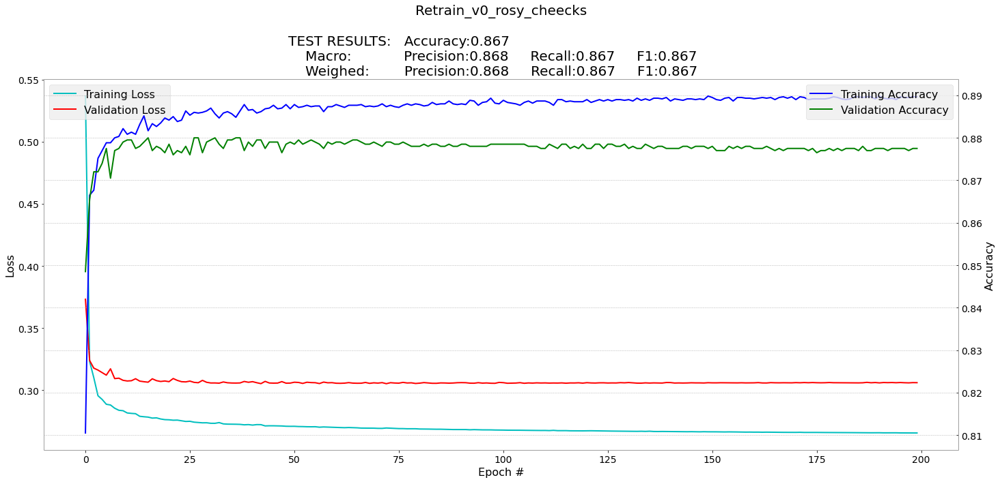

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.849625
True: 0.85625
False: 0.843

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

80150528/80134624 [==============================] - 1s 0us/step
Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
____________________________________________________________

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=25, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/25
47/47 [==============================] - 108s 1s/step - loss: 1.0947 - accuracy: 0.6657 - val_loss: 0.5010 - val_accuracy: 0.7700
Epoch 2/25
47/47 [==============================] - 48s 1s/step - loss: 0.4474 - accuracy: 0.8022 - val_loss: 0.4200 - val_accuracy: 0.8175
Epoch 3/25
47/47 [==============================] - 48s 1s/step - loss: 0.3741 - accuracy: 0.8383 - val_loss: 0.4004 - val_accuracy: 0.8260
Epoch 4/25
47/47 [==============================] - 48s 1s/step - loss: 0.3376 - accuracy: 0.8577 - val_loss: 0.3896 - val_accuracy: 0.8430
Epoch 5/25
47/47 [==============================] - 48s 1s/step - loss: 0.2627 - accuracy: 0.8943 - val_loss: 0.3823 - val_accuracy: 0.8390
Epoch 6/25
47/47 [==============================] - 48s 1s/step - loss: 0.2099 - accuracy: 0.9172 - val_loss: 0.4147 - val_accuracy: 0.8190
Epoch 7/25
47/47 [==============================] - 48s 1s/step - loss: 0.1509 - accuracy: 0.9447 - val_loss: 0.4744 - val_accuracy: 0.8270
Epoch 8/25
47/47 [=

6

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.849625
True: 0.85625
False: 0.843
              precision    recall  f1-score   support

           0       0.85      0.86      0.85      4000
           1       0.85      0.84      0.85      4000

    accuracy                           0.85      8000
   macro avg       0.85      0.85      0.85      8000
weighted avg       0.85      0.85      0.85      8000



#### Gráfico de entrenamiento

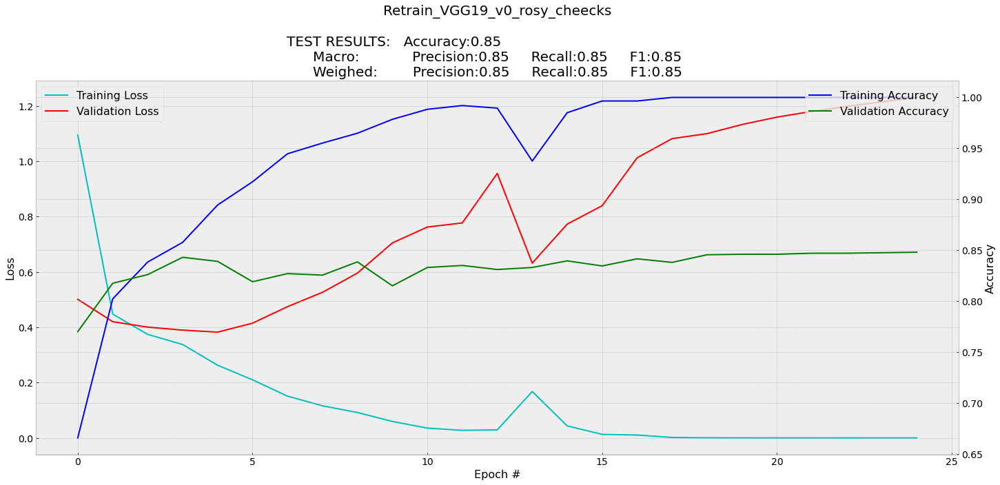

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.814875
True: 0.866
False: 0.76375

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_10 (InputLayer)           [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_10[0][0]                   
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=5, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/5
47/47 [==============================] - 65s 1s/step - loss: 0.5689 - accuracy: 0.7362 - val_loss: 0.5181 - val_accuracy: 0.7620
Epoch 2/5
47/47 [==============================] - 59s 1s/step - loss: 0.1858 - accuracy: 0.9370 - val_loss: 0.5945 - val_accuracy: 0.7680
Epoch 3/5
47/47 [==============================] - 59s 1s/step - loss: 0.0498 - accuracy: 0.9908 - val_loss: 0.6557 - val_accuracy: 0.7865
Epoch 4/5
47/47 [==============================] - 59s 1s/step - loss: 0.0130 - accuracy: 0.9988 - val_loss: 0.6020 - val_accuracy: 0.8160
Epoch 5/5
47/47 [==============================] - 59s 1s/step - loss: 0.0043 - accuracy: 1.0000 - val_loss: 0.6403 - val_accuracy: 0.8145


26925

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.814875
True: 0.866
False: 0.76375
              precision    recall  f1-score   support

           0       0.79      0.87      0.82      4000
           1       0.85      0.76      0.80      4000

    accuracy                           0.81      8000
   macro avg       0.82      0.81      0.81      8000
weighted avg       0.82      0.81      0.81      8000



#### Gráfico de entrenamiento

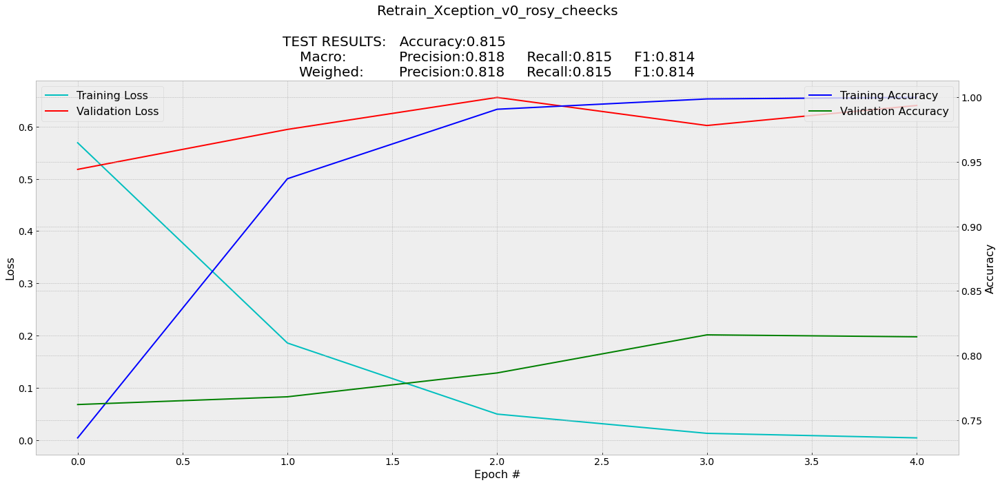

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

# Etiqueta Celeba: "high_cheekbones"

## Proceso

### CLIP crear "prompt" y preparar parámetros

In [ ]:
import torch
import clip
from PIL import Image
import glob

Name_feature='high_cheekbones'
id_feature=19
Save_Data_Path=BASE_FOLDER_2+'Retrain_v0'+Name_feature+'.pkl'

Index_To_Test=[]
Label_To_Test=[]
Data_To_Train=[]
Label_To_Train=[]
Data = {'Training':{}, 'Model Name':{}, 'H':{}, 'Classes':{}}
Data['Training']={'Images':{},'Images array':{}, 'Classes':{}, 'Classes array':{}, 'Index':{}, 'H':{}}
Data['Training']['Images']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Images array']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes array']={'Train':{}, 'Validate':{}}

clip_tokens=[ 'A picture of a person', 'A picture of a person with high cheekbones', 
             'A picture of a person with normal cheekbones','A picture of a person low cheekbones']

N_Tokens=len(clip_tokens)
print(N_Tokens)
print(clip_tokens)
for current_token in clip_tokens:
    print(current_token)

# [ 'A picture of a person',"A picture of a person with 5 o'clock shadow",'A picture of a person with arched eyebrows',
# 'A picture of an attractive person','A picture of a person with bags under eyes',
# 'A picture of a bald person','A picture of a person with bangs','A picture of a person with big lips',
# 'A picture of a person with big nose','A picture of a person with black hair',
# 'A picture of a person with blond hair','A blurry picture of a person',
# 'A picture of a person with brown hair','A picture of a person with bushy eyebrows',
# 'A picture of a chubby person','A picture of a person with double chin','A picture of a person with eyeglasses',
# 'A picture of a person with goatee','A picture of a person with gray hair','A picture of a person with heavy makeup',
# 'A picture of a person with high cheekbones','A picture of a male person',
# 'A picture of a person with mouth slightly open','A picture of a person with mustache',
# 'A picture of a person with narrow eyes','A picture of a person with no beard',
# 'A picture of a person with oval face','A picture of a person with pale skin','A picture of a person with pointy nose',
# 'A picture of a person with receding hairline','A picture of a person with rosy cheeks','A picture of a person with sideburns',
# 'A picture of a person who is smiling','A picture of a person with straight hair','A picture of a person with wavy hair',
# 'A picture of a person with earrings','A picture of a person with hat','A picture of a person with lipstick',
# 'A picture of a person with necklace','A picture of a person with necktie','A picture of a young person']

4
['A picture of a person', 'A picture of a person with high cheekbones', 'A picture of a person with normal cheekbones', 'A picture of a person low cheekbones']
A picture of a person
A picture of a person with high cheekbones
A picture of a person with normal cheekbones
A picture of a person low cheekbones


### Cargar CLIP

In [ ]:
clip_device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, clip_transform = clip.load("ViT-B/32", device=clip_device)
clip_text = clip.tokenize(clip_tokens).to(clip_device)

# CLIP features
text_features = clip_model.encode_text(clip_text)

test_index=1
test_image_path=Path_images+str(test_index).zfill(6)+'.jpg'
img_proeprocessed = clip_transform(Image.open(test_image_path)).unsqueeze(0).to(clip_device)
img_features = clip_model.encode_image(img_proeprocessed)
img_features_shape= img_features.shape

print('\n- Image Features:')
print('     Type:',type(img_features))
print('     Shape:',img_features_shape)
print('\n- Text Features:')
print('     Type:',type(text_features))
print('     Shape:',text_features.shape)
print('\n- Image Features Tensor:')
print(img_features)
print('\n- Text Features Tesor:')
print(text_features)

100%|███████████████████████████████████████| 338M/338M [00:07<00:00, 49.8MiB/s]



- Image Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([1, 512])

- Text Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([4, 512])

- Image Features Tensor:
tensor([[-6.0150e-02,  1.7044e-02, -9.9854e-02,  2.3523e-01, -6.8359e-02,
         -8.4814e-01, -3.7036e-01, -4.8169e-01, -3.1921e-02, -3.8666e-02,
         -5.1666e-02, -1.9775e-01,  6.2061e-01, -5.4565e-02,  7.4365e-01,
          4.4678e-02,  1.5791e+00, -4.6045e-01,  1.3513e-01, -1.4685e-01,
         -3.7012e-01, -3.7183e-01, -4.6509e-01, -2.8833e-01, -1.7578e-01,
         -1.3904e-01,  2.9028e-01, -9.5642e-02,  3.9746e-01,  1.3770e-01,
          5.1855e-01,  1.5613e-01,  8.7524e-02, -1.0674e-02, -9.4531e-01,
          2.2595e-01, -3.6133e-02,  4.6924e-01,  9.4604e-02,  1.5908e+00,
          2.1533e-01,  1.9360e-01, -5.3284e-02, -7.5500e-02, -6.1111e-03,
          1.4443e+00,  1.2891e-01,  5.3613e-01,  4.5630e-01,  3.9478e-01,
          1.7310e-01,  1.6138e-01, -2.8870e-02, -2.5464e-01, -1

### Seleccionar indices a usar del Dataset Celeba

In [ ]:
# encontrar indices man_woman true/false
Index_Features_0=[]
Index_Features_1=[]

i=0
for descripton in Description_data:
    i=i+1
    if descripton[id_feature]: 
        Index_Features_0.append(i)
    else:
        Index_Features_1.append(i)

## Mostrar Results       
min_value=9999999
print('Examples of celeba:')
print(Description_labels[id_feature]+':',len(Index_Features_0))
print('Not '+Description_labels[id_feature]+':',len(Index_Features_1))  

# Smiling -  True: 97669
# Smiling - False: 104930

Examples of celeba:
High_Cheekbones: 92189
Not High_Cheekbones: 110410


### Cargar Datos (ejectuar si se dispone del archivo de datos creado)

In [ ]:
## LOAD DATA
file_to_load = open(Save_Data_Path, "rb")
df_loaded = pickle.load(file_to_load)
file_to_load.close()

Data=df_loaded['Data']
Index_To_Test=df_loaded['Index_To_Test']
Label_To_Test=df_loaded['Label_To_Test']
Data_To_Train=df_loaded['Data_To_Train']
Label_To_Train=df_loaded['Label_To_Train']

### Preparar datos (ejectuar solo si no se dispone del archivo de datos creado)

In [ ]:
## Funcion si gpu
def CLIP_get_probs_only(img_path,img_txt, img_model, img_transf, img_device):
    img_proeprocessed = img_transf(Image.open(img_path)).unsqueeze(0).to(img_device)

    img_features = img_model.encode_image(img_proeprocessed)
    txt_features = img_model.encode_text(img_txt)
    
    img_logits, img_logits_txt = img_model(img_proeprocessed, img_txt)
    # image_p=softmax(img_logits.detach().numpy()[0])
    image_p=img_logits.detach().cpu().numpy()[0]

    return image_p

def Preprocess_img(images_id,clip_device,clip_model,clip_preprocess,clip_text):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    probs=CLIP_get_probs_only(test_image_path, clip_text, clip_model, clip_preprocess, clip_device)
    return clip_model.encode_image(clip_img).detach().cpu().numpy(), np.array(img_current), probs

def Preprocess_img2(images_id,clip_device,clip_model,clip_preprocess):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    return clip_model.encode_image(clip_img).detach().cpu().numpy(), np.array(img_current)

# Data['Training']['Images']['Test']=[]
# Data['Training']['Images']['Not Test']=[]
# Data['Training']['Classes']['Test']=[]
# Data['Training']['Classes']['Not Test']=[]
# Data['Training']['Images array']['Test']=[]
# Data['Training']['Images array']['Not Test']=[]

# Data['Prediccion_Probs']=np.zeros((16000,N_Tokens))
# n=0
# for i in range(4000):
#     Index_To_Test.append(Index_Features_0[i])
#     Label_To_Test.append(clip_tokens[1])
#     img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_0[i],clip_device,clip_model,clip_transform,clip_text)
#     Data['Training']['Images']['Test'].append(img)
#     Data['Training']['Images array']['Test'].append(img_arr)
#     Data['Training']['Classes']['Test'].append(0)
#     n+=1
#     Index_To_Test.append(Index_Features_1[i])
#     Label_To_Test.append(clip_tokens[2])
#     img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_1[i],clip_device,clip_model,clip_transform,clip_text)
#     Data['Training']['Images']['Test'].append(img)
#     Data['Training']['Images array']['Test'].append(img_arr)
#     Data['Training']['Classes']['Test'].append(1)
#     n+=1

#     if i % 400 == 0 and i>0:
#         print('Test images load (%):',i/40)
        
#         df_to_save= {'Data': Data,
#                       'Index_To_Test':Index_To_Test,
#                       'Label_To_Test':Label_To_Test,
#                       'Data_To_Train':Data_To_Train,
#                       'Label_To_Train':Label_To_Train
#         }
#         save_df_to_file(df_to_save,Save_Data_Path)

#     gc.collect() 
    
# for i in range(4000,8000):
#     Data_To_Train.append(Index_Features_0[i])
#     Label_To_Train.append(clip_tokens[1])
#     img, img_arr=Preprocess_img2(Index_Features_0[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Not Test'].append(img)
#     Data['Training']['Images array']['Not Test'].append(img_arr)
#     Data['Training']['Classes']['Not Test'].append(0)

#     Data_To_Train.append(Index_Features_1[i])
#     Label_To_Train.append(clip_tokens[2])
#     img, img_arr=Preprocess_img2(Index_Features_1[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Not Test'].append(img)
#     Data['Training']['Images array']['Not Test'].append(img_arr)
#     Data['Training']['Classes']['Not Test'].append(1)

#     if i % 400 == 0 and i>2000:
#         print('Train images load (%):',(i-4000)/40)
#         df_to_save= {'Data': Data,
#                       'Index_To_Test':Index_To_Test,
#                       'Label_To_Test':Label_To_Test,
#                       'Data_To_Train':Data_To_Train,
#                       'Label_To_Train':Label_To_Train
#         }
#         save_df_to_file(df_to_save,Save_Data_Path)
#     # gc.collect()

# Data['Classes']=[]
# for element in np.unique(Data['Training']['Classes']['Test']):
#     Data['Classes'].append(np.int(element))

# Data['Training']['Images']['Train'], Data['Training']['Images']['Validate'], Data['Training']['Classes']['Train'], Data['Training']['Classes']['Validate'] = train_test_split(Data['Training']['Images']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)
# Data['Training']['Images array']['Train'], Data['Training']['Images array']['Validate'], Data['Training']['Classes array']['Train'], Data['Training']['Classes array']['Validate'] = train_test_split(Data['Training']['Images array']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)

# df_to_save= {'Data': Data,
#               'Index_To_Test':Index_To_Test,
#               'Label_To_Test':Label_To_Test,
#               'Data_To_Train':Data_To_Train,
#               'Label_To_Train':Label_To_Train
# }
# save_df_to_file(df_to_save,Save_Data_Path)

# ## Visualizar número de entrenamiento
# print('NÚMERO DE DATOS PARA ENTRENAR/TEST')
# print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Not Test']),'con',len(np.unique(Data['Training']['Classes']['Test'])),'clases')
# print('Número de datos para Test:',  len(Data['Training']['Classes']['Test']),'con',len(np.unique(Data['Training']['Classes']['Not Test'])),'clases')

# ## Visualizar número de entrenamiento
# print('\nNÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN')
# print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Train']),'con',len(np.unique(Data['Training']['Classes']['Train'])),'clases')
# print('Número de datos para Validación:',  len(Data['Training']['Classes']['Validate']),'con',len(np.unique(Data['Training']['Classes']['Validate'])),'clases')


## CLIP prompts

##### Calcular tokens celeba

In [ ]:
Prediccion_Probs=Data['Prediccion_Probs']

N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(len(clip_tokens)-1)
Precision_False=np.zeros(len(clip_tokens)-1)
Precision_All=np.zeros(len(clip_tokens)-1)

for i in range(len(clip_tokens)-1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [1]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    else:
        for k in [1]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [0]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba

In [ ]:
## Resulrts
celeba_labels=[19,19,19]
dataframe_array=[]
for i in range(len(clip_tokens)-1):
    dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])

dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(len(clip_tokens)-1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref.csv",';')
print(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref.csv")

,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,High_Cheekbones,A picture of a person with high cheekbones,21.28,76.32,48.8
1,High_Cheekbones,A picture of a person with low cheekbones,35.98,65.58,50.78


/content/drive/My Drive/Colab Notebooks/CLIP_high_cheekbones_vs_ref.csv


##### Calcular tokens celeba - cambio de referencia 1

In [ ]:
New_reference=2
N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(13)
Precision_False=np.zeros(13)
Precision_All=np.zeros(13)

for i in range(len(clip_tokens)-1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,New_reference]:
                Precision_True[k]+=1
                Precision_All[k]+=1

    else:

        for k in [0]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,New_reference]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba - cambio de referencia 1

In [ ]:
## Resulrts
celeba_labels=[19]
dataframe_array=[]
for i in range(1):
    if i<10: 
        dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[New_reference],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])

    else: 
        dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+2],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])
dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
print('Referencia:',clip_tokens[New_reference])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref_b.csv",';')

Referencia: A picture of a person with low cheekbones


,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,High_Cheekbones,A picture of a person with low cheekbones,4.18,94.58,49.38


## Modelos

### CLIP 
All: 0.831625
True: 0.82725
False: 0.836

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten (Flatten)            (None, 512)               0         
_________________________________________________________________
dense (Dense)                (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.1,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 3s 7ms/step - loss: 0.4786 - accuracy: 0.7938 - val_loss: 0.4045 - val_accuracy: 0.8175
Epoch 2/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.3614 - accuracy: 0.8425 - val_loss: 0.3908 - val_accuracy: 0.8240
Epoch 3/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.3542 - accuracy: 0.8428 - val_loss: 0.3907 - val_accuracy: 0.8270
Epoch 4/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.3481 - accuracy: 0.8472 - val_loss: 0.3898 - val_accuracy: 0.8310
Epoch 5/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.3423 - accuracy: 0.8520 - val_loss: 0.3898 - val_accuracy: 0.8290
Epoch 6/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.3399 - accuracy: 0.8547 - val_loss: 0.3898 - val_accuracy: 0.8270
Epoch 7/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.3392 - accuracy: 0.8525 - val_loss: 0.3880 - val_accuracy: 0.8335
Epoch 

1616

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.831625
True: 0.82725
False: 0.836
              precision    recall  f1-score   support

           0       0.83      0.83      0.83      4000
           1       0.83      0.84      0.83      4000

    accuracy                           0.83      8000
   macro avg       0.83      0.83      0.83      8000
weighted avg       0.83      0.83      0.83      8000



#### Gráfico de entrenamiento

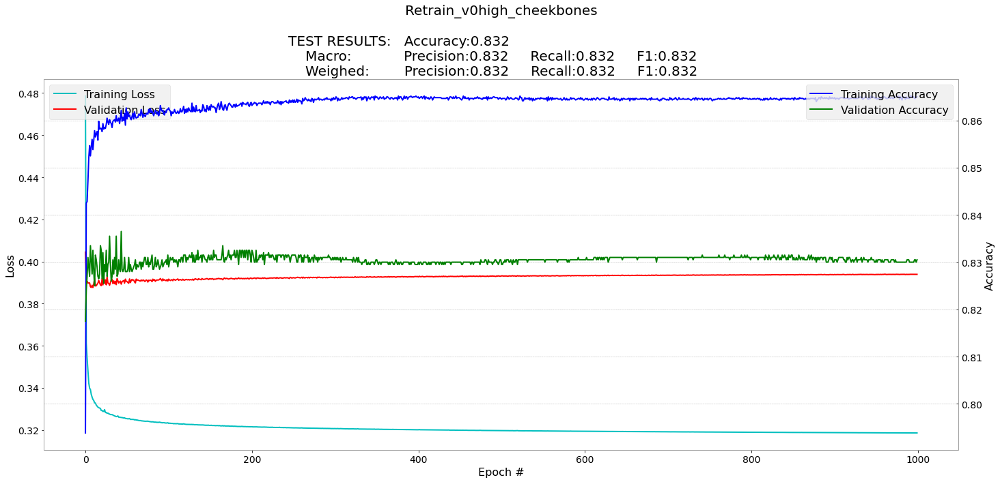

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.833
True: 0.82775
False: 0.83825

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_11 (InputLayer)        [(None, 1, 512)]          0         
_________________________________________________________________
flatten_10 (Flatten)         (None, 512)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.1,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=200, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/200
47/47 [==============================] - 1s 7ms/step - loss: 0.5128 - accuracy: 0.7843 - val_loss: 0.4259 - val_accuracy: 0.8185
Epoch 2/200
47/47 [==============================] - 0s 4ms/step - loss: 0.3698 - accuracy: 0.8398 - val_loss: 0.4002 - val_accuracy: 0.8270
Epoch 3/200
47/47 [==============================] - 0s 4ms/step - loss: 0.3533 - accuracy: 0.8452 - val_loss: 0.4026 - val_accuracy: 0.8240
Epoch 4/200
47/47 [==============================] - 0s 4ms/step - loss: 0.3490 - accuracy: 0.8462 - val_loss: 0.3939 - val_accuracy: 0.8305
Epoch 5/200
47/47 [==============================] - 0s 4ms/step - loss: 0.3436 - accuracy: 0.8493 - val_loss: 0.3945 - val_accuracy: 0.8275
Epoch 6/200
47/47 [==============================] - 0s 4ms/step - loss: 0.3415 - accuracy: 0.8503 - val_loss: 0.3979 - val_accuracy: 0.8235
Epoch 7/200
47/47 [==============================] - 0s 5ms/step - loss: 0.3394 - accuracy: 0.8532 - val_loss: 0.3952 - val_accuracy: 0.8230
Epoch 8/200
4

2676

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.833
True: 0.82775
False: 0.83825
              precision    recall  f1-score   support

           0       0.84      0.83      0.83      4000
           1       0.83      0.84      0.83      4000

    accuracy                           0.83      8000
   macro avg       0.83      0.83      0.83      8000
weighted avg       0.83      0.83      0.83      8000



#### Gráfico de entrenamiento

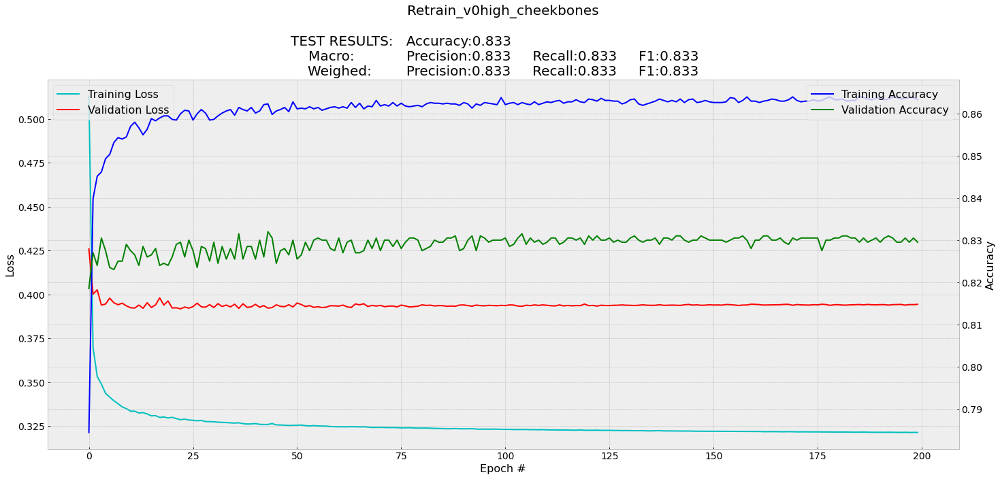

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.83425
True: 0.8375
False: 0.831

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.01,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 1s 8ms/step - loss: 0.5290 - accuracy: 0.7412 - val_loss: 0.4468 - val_accuracy: 0.7970
Epoch 2/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.4298 - accuracy: 0.8075 - val_loss: 0.4244 - val_accuracy: 0.8135
Epoch 3/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.4153 - accuracy: 0.8155 - val_loss: 0.4166 - val_accuracy: 0.8200
Epoch 4/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.4076 - accuracy: 0.8195 - val_loss: 0.4117 - val_accuracy: 0.8250
Epoch 5/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.4028 - accuracy: 0.8235 - val_loss: 0.4088 - val_accuracy: 0.8255
Epoch 6/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.3989 - accuracy: 0.8262 - val_loss: 0.4048 - val_accuracy: 0.8275
Epoch 7/1000
47/47 [==============================] - 0s 6ms/step - loss: 0.3959 - accuracy: 0.8263 - val_loss: 0.4017 - val_accuracy: 0.8320
Epoch 

1068

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.83425
True: 0.8375
False: 0.831
              precision    recall  f1-score   support

           0       0.83      0.84      0.83      4000
           1       0.84      0.83      0.83      4000

    accuracy                           0.83      8000
   macro avg       0.83      0.83      0.83      8000
weighted avg       0.83      0.83      0.83      8000



#### Gráfico de entrenamiento

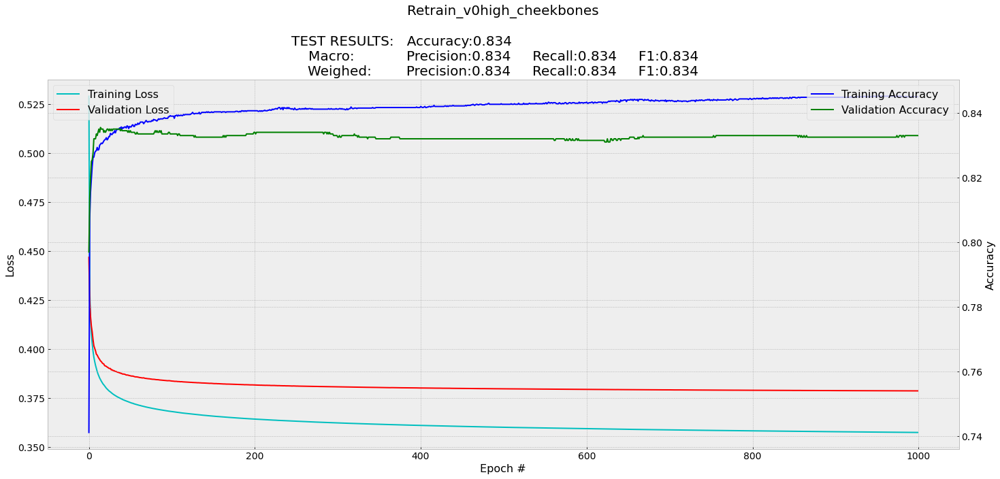

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.7455
True: 0.7265
False: 0.7645

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 1s 8ms/step - loss: 1.0202 - accuracy: 0.5028 - val_loss: 0.8836 - val_accuracy: 0.5800
Epoch 2/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.8362 - accuracy: 0.5970 - val_loss: 0.8156 - val_accuracy: 0.6045
Epoch 3/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.7878 - accuracy: 0.6188 - val_loss: 0.7816 - val_accuracy: 0.6195
Epoch 4/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.7598 - accuracy: 0.6332 - val_loss: 0.7591 - val_accuracy: 0.6280
Epoch 5/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.7405 - accuracy: 0.6402 - val_loss: 0.7427 - val_accuracy: 0.6360
Epoch 6/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.7260 - accuracy: 0.6460 - val_loss: 0.7302 - val_accuracy: 0.6435
Epoch 7/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.7145 - accuracy: 0.6528 - val_loss: 0.7200 - val_accuracy: 0.6495
Epoch 

2677

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.7455
True: 0.7265
False: 0.7645
              precision    recall  f1-score   support

           0       0.76      0.73      0.74      4000
           1       0.74      0.76      0.75      4000

    accuracy                           0.75      8000
   macro avg       0.75      0.75      0.75      8000
weighted avg       0.75      0.75      0.75      8000



#### Gráfico de entrenamiento

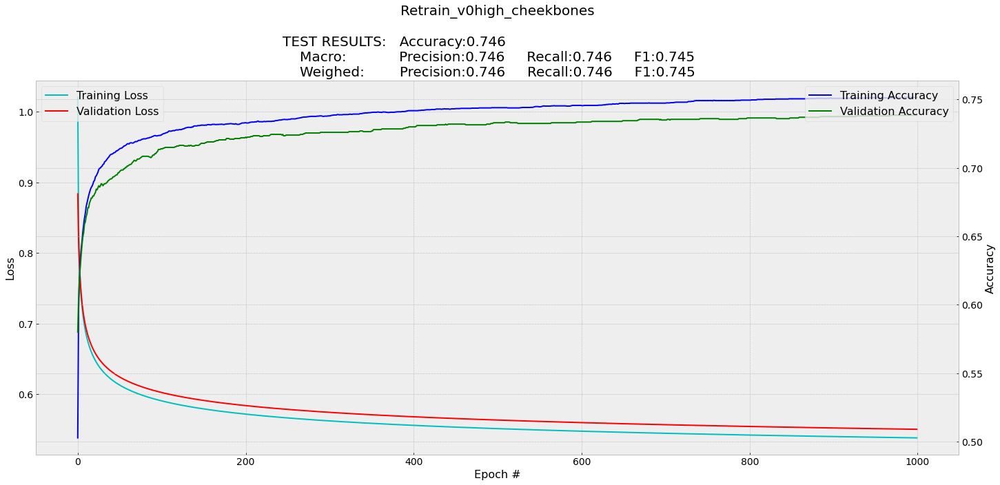

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.758375
True: 0.75125
False: 0.7655

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_12 (InputLayer)        [(None, 1, 512)]          0         
_________________________________________________________________
flatten_11 (Flatten)         (None, 512)               0         
_________________________________________________________________
dense_5 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=2000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/2000
47/47 [==============================] - 1s 7ms/step - loss: 0.9258 - accuracy: 0.5740 - val_loss: 0.8123 - val_accuracy: 0.6260
Epoch 2/2000
47/47 [==============================] - 0s 4ms/step - loss: 0.7734 - accuracy: 0.6367 - val_loss: 0.7541 - val_accuracy: 0.6440
Epoch 3/2000
47/47 [==============================] - 0s 5ms/step - loss: 0.7332 - accuracy: 0.6572 - val_loss: 0.7249 - val_accuracy: 0.6570
Epoch 4/2000
47/47 [==============================] - 0s 4ms/step - loss: 0.7098 - accuracy: 0.6650 - val_loss: 0.7056 - val_accuracy: 0.6615
Epoch 5/2000
47/47 [==============================] - 0s 5ms/step - loss: 0.6936 - accuracy: 0.6725 - val_loss: 0.6916 - val_accuracy: 0.6680
Epoch 6/2000
47/47 [==============================] - 0s 4ms/step - loss: 0.6814 - accuracy: 0.6748 - val_loss: 0.6809 - val_accuracy: 0.6700
Epoch 7/2000
47/47 [==============================] - 0s 5ms/step - loss: 0.6718 - accuracy: 0.6780 - val_loss: 0.6722 - val_accuracy: 0.6730
Epoch 

2677

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.758375
True: 0.75125
False: 0.7655
              precision    recall  f1-score   support

           0       0.76      0.75      0.76      4000
           1       0.75      0.77      0.76      4000

    accuracy                           0.76      8000
   macro avg       0.76      0.76      0.76      8000
weighted avg       0.76      0.76      0.76      8000



#### Gráfico de entrenamiento

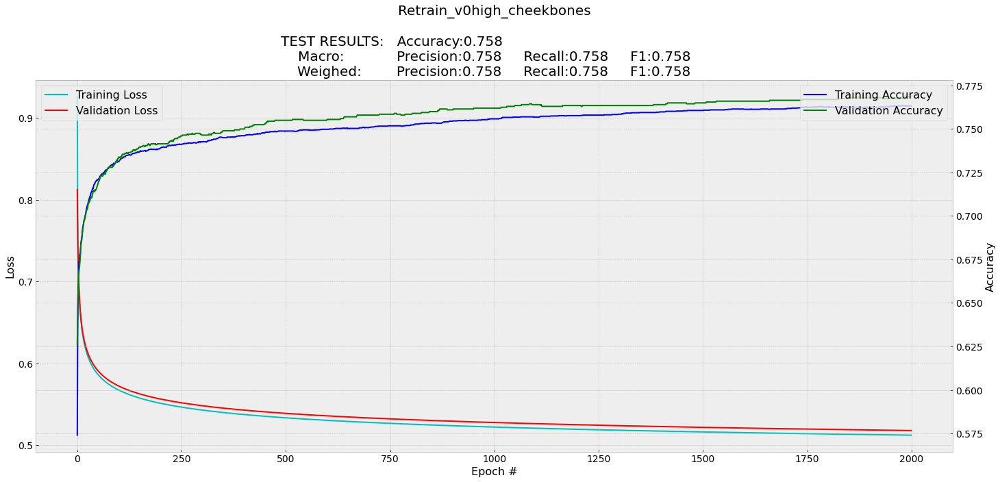

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.82625
True: 0.83225
False: 0.82025

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0005,decay=0.0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 1s 7ms/step - loss: 1.0878 - accuracy: 0.4958 - val_loss: 0.7553 - val_accuracy: 0.6410
Epoch 2/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.6445 - accuracy: 0.7205 - val_loss: 0.6083 - val_accuracy: 0.7190
Epoch 3/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.5524 - accuracy: 0.7610 - val_loss: 0.5464 - val_accuracy: 0.7500
Epoch 4/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.5052 - accuracy: 0.7817 - val_loss: 0.5058 - val_accuracy: 0.7745
Epoch 5/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.4750 - accuracy: 0.7938 - val_loss: 0.4798 - val_accuracy: 0.7855
Epoch 6/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.4539 - accuracy: 0.8033 - val_loss: 0.4606 - val_accuracy: 0.7960
Epoch 7/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.4383 - accuracy: 0.8075 - val_loss: 0.4454 - val_accuracy: 0.8085
Epoch 

2677

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.82625
True: 0.83225
False: 0.82025
              precision    recall  f1-score   support

           0       0.82      0.83      0.83      4000
           1       0.83      0.82      0.83      4000

    accuracy                           0.83      8000
   macro avg       0.83      0.83      0.83      8000
weighted avg       0.83      0.83      0.83      8000



#### Gráfico de entrenamiento

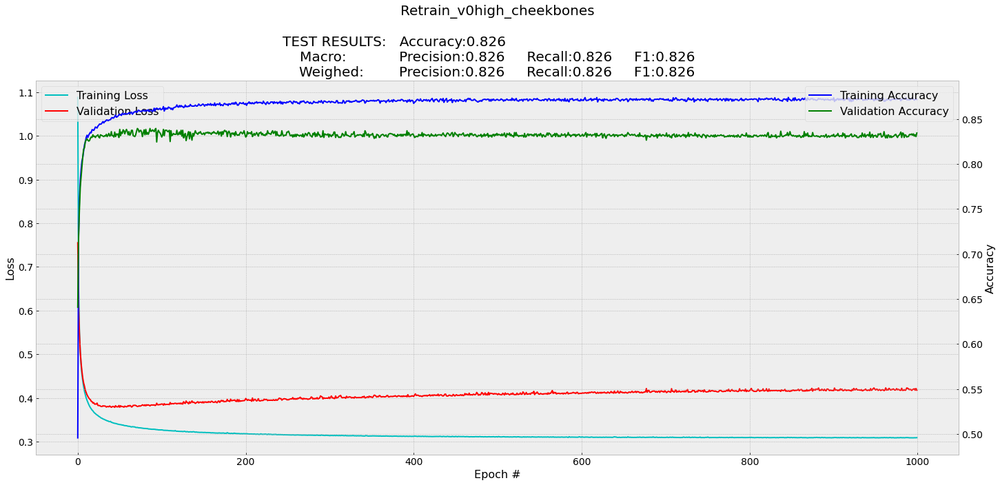

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.7755
True: 0.786
False: 0.765

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

80150528/80134624 [==============================] - 1s 0us/step
Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
____________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=25, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/25
47/47 [==============================] - 117s 2s/step - loss: 1.2944 - accuracy: 0.5658 - val_loss: 0.6338 - val_accuracy: 0.6275
Epoch 2/25
47/47 [==============================] - 52s 1s/step - loss: 0.6046 - accuracy: 0.6790 - val_loss: 0.6257 - val_accuracy: 0.6540
Epoch 3/25
47/47 [==============================] - 52s 1s/step - loss: 0.5557 - accuracy: 0.7117 - val_loss: 0.5593 - val_accuracy: 0.7085
Epoch 4/25
47/47 [==============================] - 53s 1s/step - loss: 0.4977 - accuracy: 0.7578 - val_loss: 0.5291 - val_accuracy: 0.7365
Epoch 5/25
47/47 [==============================] - 52s 1s/step - loss: 0.4413 - accuracy: 0.7968 - val_loss: 0.5289 - val_accuracy: 0.7485
Epoch 6/25
47/47 [==============================] - 53s 1s/step - loss: 0.4172 - accuracy: 0.8112 - val_loss: 0.5955 - val_accuracy: 0.6920
Epoch 7/25
47/47 [==============================] - 52s 1s/step - loss: 0.3633 - accuracy: 0.8387 - val_loss: 0.4987 - val_accuracy: 0.7625
Epoch 8/25
47/47 [=

1621

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.7755
True: 0.786
False: 0.765
              precision    recall  f1-score   support

           0       0.77      0.79      0.78      4000
           1       0.78      0.77      0.77      4000

    accuracy                           0.78      8000
   macro avg       0.78      0.78      0.78      8000
weighted avg       0.78      0.78      0.78      8000



#### Gráfico de entrenamiento

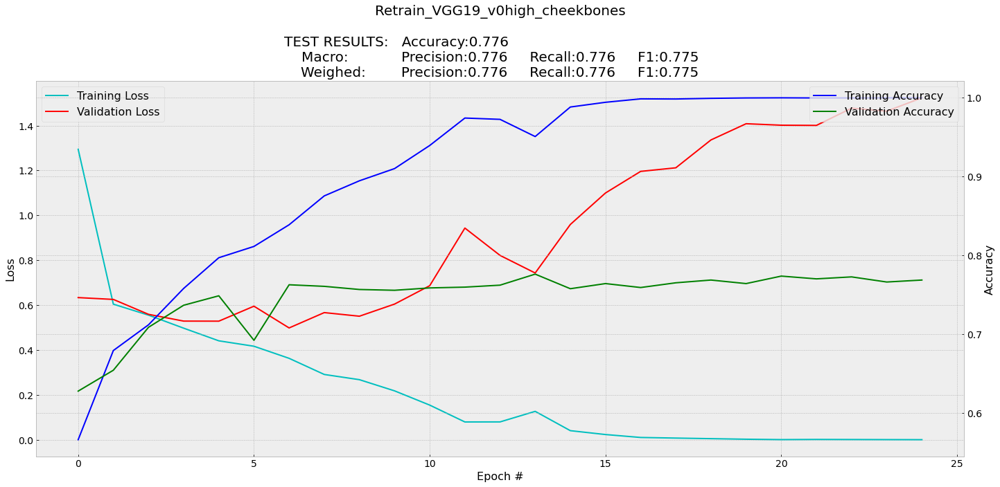

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.70225
True: 0.69325
False: 0.71125

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=25, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/25
47/47 [==============================] - 55s 1s/step - loss: 2.2733 - accuracy: 0.5158 - val_loss: 0.8596 - val_accuracy: 0.5690
Epoch 2/25
47/47 [==============================] - 53s 1s/step - loss: 0.7290 - accuracy: 0.6252 - val_loss: 0.7497 - val_accuracy: 0.5990
Epoch 3/25
47/47 [==============================] - 53s 1s/step - loss: 0.6152 - accuracy: 0.6873 - val_loss: 0.7046 - val_accuracy: 0.6190
Epoch 4/25
47/47 [==============================] - 53s 1s/step - loss: 0.5370 - accuracy: 0.7342 - val_loss: 0.6932 - val_accuracy: 0.6435
Epoch 5/25
47/47 [==============================] - 53s 1s/step - loss: 0.4681 - accuracy: 0.7840 - val_loss: 0.6868 - val_accuracy: 0.6480
Epoch 6/25
47/47 [==============================] - 53s 1s/step - loss: 0.3965 - accuracy: 0.8307 - val_loss: 0.6856 - val_accuracy: 0.6665
Epoch 7/25
47/47 [==============================] - 53s 1s/step - loss: 0.3332 - accuracy: 0.8660 - val_loss: 0.6914 - val_accuracy: 0.6780
Epoch 8/25
47/47 [==

5571

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.70225
True: 0.69325
False: 0.71125
              precision    recall  f1-score   support

           0       0.71      0.69      0.70      4000
           1       0.70      0.71      0.70      4000
           3       0.00      0.00      0.00         0

    accuracy                           0.70      8000
   macro avg       0.47      0.47      0.47      8000
weighted avg       0.70      0.70      0.70      8000



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


#### Gráfico de entrenamiento

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


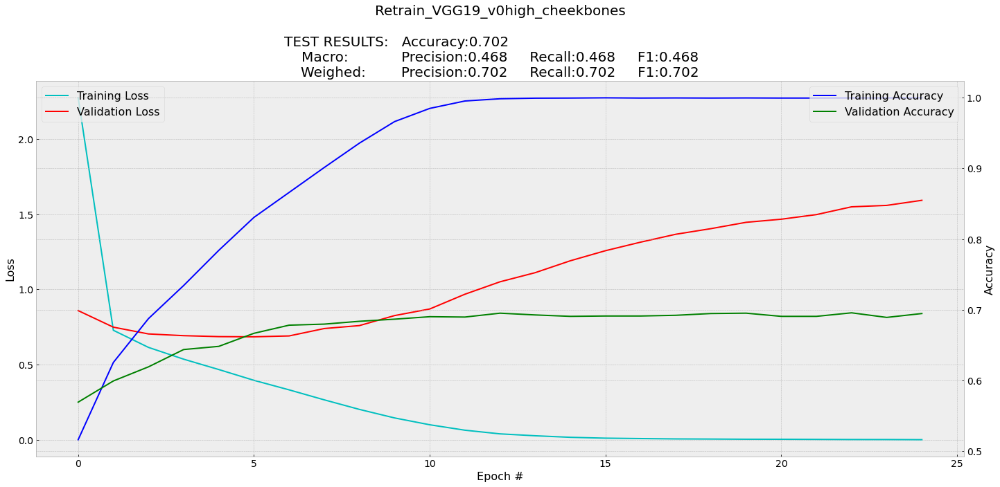

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.79525
True: 0.738
False: 0.8525

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=30, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/30
47/47 [==============================] - 54s 1s/step - loss: 1.1691 - accuracy: 0.5423 - val_loss: 0.6560 - val_accuracy: 0.6145
Epoch 2/30
47/47 [==============================] - 52s 1s/step - loss: 0.6537 - accuracy: 0.6128 - val_loss: 0.6242 - val_accuracy: 0.6480
Epoch 3/30
47/47 [==============================] - 52s 1s/step - loss: 0.6065 - accuracy: 0.6653 - val_loss: 0.6079 - val_accuracy: 0.6610
Epoch 4/30
47/47 [==============================] - 52s 1s/step - loss: 0.5809 - accuracy: 0.6945 - val_loss: 0.6125 - val_accuracy: 0.6715
Epoch 5/30
47/47 [==============================] - 52s 1s/step - loss: 0.5512 - accuracy: 0.7227 - val_loss: 0.5811 - val_accuracy: 0.6860
Epoch 6/30
47/47 [==============================] - 52s 1s/step - loss: 0.5070 - accuracy: 0.7565 - val_loss: 0.5136 - val_accuracy: 0.7520
Epoch 7/30
47/47 [==============================] - 52s 1s/step - loss: 0.4555 - accuracy: 0.7870 - val_loss: 0.4804 - val_accuracy: 0.7795
Epoch 8/30
47/47 [==

5570

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.79525
True: 0.738
False: 0.8525
              precision    recall  f1-score   support

           0       0.83      0.74      0.78      4000
           1       0.76      0.85      0.81      4000

    accuracy                           0.80      8000
   macro avg       0.80      0.80      0.79      8000
weighted avg       0.80      0.80      0.79      8000



#### Gráfico de entrenamiento

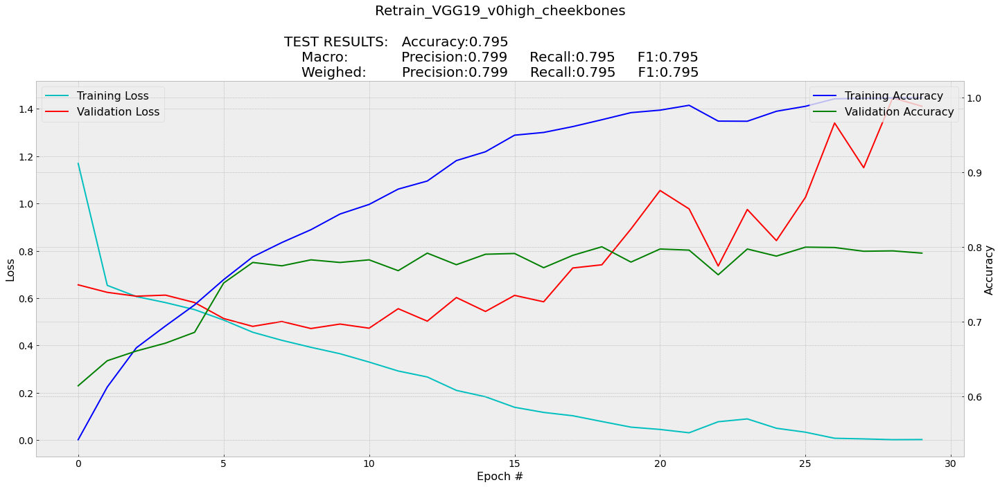

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.71525
True: 0.70825
False: 0.72225

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

83697664/83683744 [==============================] - 1s 0us/step
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_3[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
___________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 74s 1s/step - loss: 0.7106 - accuracy: 0.6090 - val_loss: 0.6577 - val_accuracy: 0.6225
Epoch 2/10
47/47 [==============================] - 61s 1s/step - loss: 0.2794 - accuracy: 0.9093 - val_loss: 0.6164 - val_accuracy: 0.6895
Epoch 3/10
47/47 [==============================] - 61s 1s/step - loss: 0.0781 - accuracy: 0.9885 - val_loss: 0.6793 - val_accuracy: 0.6865
Epoch 4/10
47/47 [==============================] - 61s 1s/step - loss: 0.0200 - accuracy: 0.9992 - val_loss: 0.7489 - val_accuracy: 0.7025
Epoch 5/10
47/47 [==============================] - 61s 1s/step - loss: 0.0064 - accuracy: 0.9998 - val_loss: 0.7995 - val_accuracy: 0.7145
Epoch 6/10
47/47 [==============================] - 61s 1s/step - loss: 0.0035 - accuracy: 0.9998 - val_loss: 0.8415 - val_accuracy: 0.7230
Epoch 7/10
47/47 [==============================] - 61s 1s/step - loss: 0.0026 - accuracy: 0.9998 - val_loss: 0.8882 - val_accuracy: 0.7235
Epoch 8/10
47/47 [==

1624

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.71525
True: 0.70825
False: 0.72225
              precision    recall  f1-score   support

           0       0.72      0.71      0.71      4000
           1       0.71      0.72      0.72      4000

    accuracy                           0.72      8000
   macro avg       0.72      0.72      0.72      8000
weighted avg       0.72      0.72      0.72      8000



#### Gráfico de entrenamiento

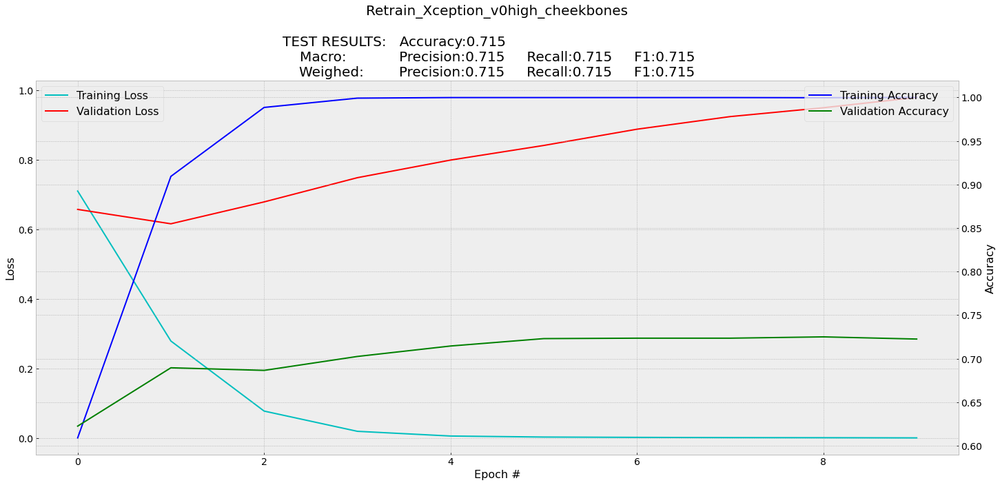

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.712125
True: 0.70375
False: 0.7205

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

83697664/83683744 [==============================] - 3s 0us/step
Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_8[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
___________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 78s 1s/step - loss: 0.7079 - accuracy: 0.6075 - val_loss: 0.7156 - val_accuracy: 0.6100
Epoch 2/20
47/47 [==============================] - 65s 1s/step - loss: 0.2871 - accuracy: 0.9057 - val_loss: 0.7699 - val_accuracy: 0.6465
Epoch 3/20
47/47 [==============================] - 64s 1s/step - loss: 0.0794 - accuracy: 0.9893 - val_loss: 0.7608 - val_accuracy: 0.6760
Epoch 4/20
47/47 [==============================] - 65s 1s/step - loss: 0.0166 - accuracy: 0.9995 - val_loss: 0.8331 - val_accuracy: 0.6890
Epoch 5/20
47/47 [==============================] - 64s 1s/step - loss: 0.0064 - accuracy: 0.9998 - val_loss: 0.8541 - val_accuracy: 0.7085
Epoch 6/20
47/47 [==============================] - 64s 1s/step - loss: 0.0033 - accuracy: 0.9998 - val_loss: 0.8990 - val_accuracy: 0.7100
Epoch 7/20
47/47 [==============================] - 64s 1s/step - loss: 0.0024 - accuracy: 0.9997 - val_loss: 0.9379 - val_accuracy: 0.7155
Epoch 8/20
47/47 [==

1624

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.712125
True: 0.70375
False: 0.7205
              precision    recall  f1-score   support

           0       0.72      0.70      0.71      4000
           1       0.71      0.72      0.71      4000

    accuracy                           0.71      8000
   macro avg       0.71      0.71      0.71      8000
weighted avg       0.71      0.71      0.71      8000



#### Gráfico de entrenamiento

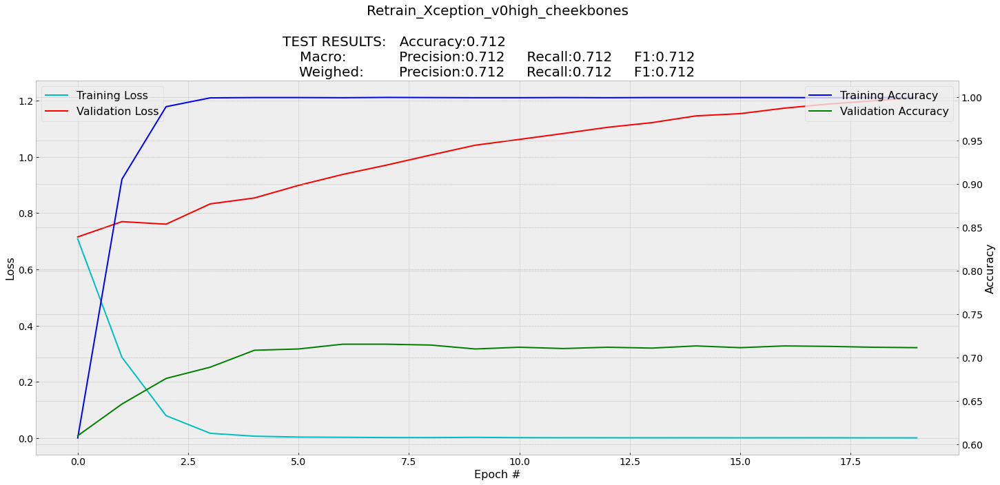

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.682625
True: 0.66425
False: 0.701

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_9[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 71s 1s/step - loss: 0.9921 - accuracy: 0.5112 - val_loss: 0.7655 - val_accuracy: 0.5600
Epoch 2/20
47/47 [==============================] - 65s 1s/step - loss: 0.6927 - accuracy: 0.6542 - val_loss: 0.7265 - val_accuracy: 0.6030
Epoch 3/20
47/47 [==============================] - 65s 1s/step - loss: 0.5878 - accuracy: 0.7253 - val_loss: 0.6994 - val_accuracy: 0.6165
Epoch 4/20
47/47 [==============================] - 65s 1s/step - loss: 0.5159 - accuracy: 0.7825 - val_loss: 0.6736 - val_accuracy: 0.6455
Epoch 5/20
47/47 [==============================] - 65s 1s/step - loss: 0.4559 - accuracy: 0.8275 - val_loss: 0.6515 - val_accuracy: 0.6545
Epoch 6/20
47/47 [==============================] - 65s 1s/step - loss: 0.4001 - accuracy: 0.8670 - val_loss: 0.6375 - val_accuracy: 0.6690
Epoch 7/20
47/47 [==============================] - 64s 1s/step - loss: 0.3509 - accuracy: 0.8942 - val_loss: 0.6317 - val_accuracy: 0.6725
Epoch 8/20
47/47 [==

20186

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.682625
True: 0.66425
False: 0.701
              precision    recall  f1-score   support

           0       0.69      0.66      0.68      4000
           1       0.68      0.70      0.69      4000

    accuracy                           0.68      8000
   macro avg       0.68      0.68      0.68      8000
weighted avg       0.68      0.68      0.68      8000



#### Gráfico de entrenamiento

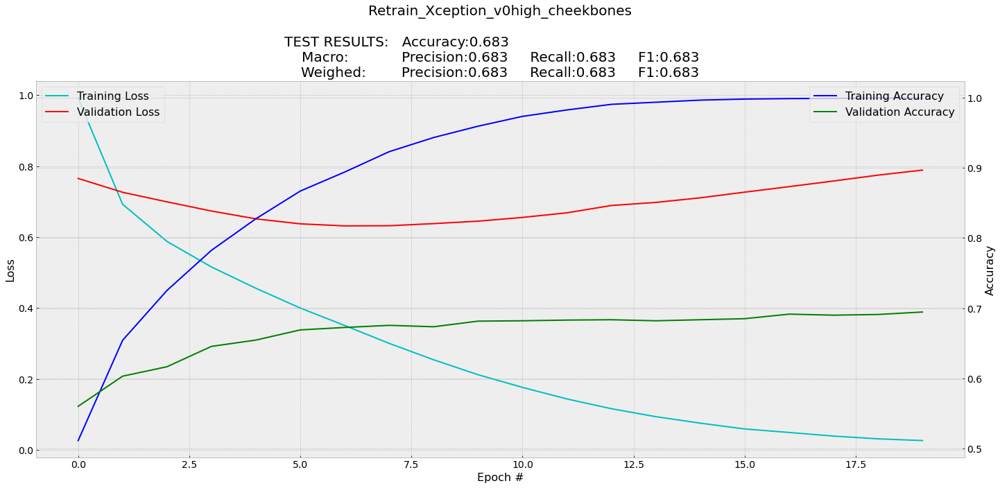

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.697125
True: 0.68425
False: 0.71

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_5[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 67s 1s/step - loss: 0.7980 - accuracy: 0.5572 - val_loss: 0.6779 - val_accuracy: 0.6115
Epoch 2/10
47/47 [==============================] - 60s 1s/step - loss: 0.4265 - accuracy: 0.8305 - val_loss: 0.6214 - val_accuracy: 0.6695
Epoch 3/10
47/47 [==============================] - 60s 1s/step - loss: 0.2350 - accuracy: 0.9455 - val_loss: 0.6459 - val_accuracy: 0.6745
Epoch 4/10
47/47 [==============================] - 61s 1s/step - loss: 0.1104 - accuracy: 0.9880 - val_loss: 0.6470 - val_accuracy: 0.6990
Epoch 5/10
47/47 [==============================] - 60s 1s/step - loss: 0.0451 - accuracy: 0.9992 - val_loss: 0.7054 - val_accuracy: 0.6965
Epoch 6/10
47/47 [==============================] - 60s 1s/step - loss: 0.0205 - accuracy: 0.9998 - val_loss: 0.7496 - val_accuracy: 0.7035
Epoch 7/10
47/47 [==============================] - 61s 1s/step - loss: 0.0112 - accuracy: 0.9998 - val_loss: 0.7990 - val_accuracy: 0.7010
Epoch 8/10
47/47 [==

20186

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.697125
True: 0.68425
False: 0.71
              precision    recall  f1-score   support

           0       0.70      0.68      0.69      4000
           1       0.69      0.71      0.70      4000

    accuracy                           0.70      8000
   macro avg       0.70      0.70      0.70      8000
weighted avg       0.70      0.70      0.70      8000



#### Gráfico de entrenamiento

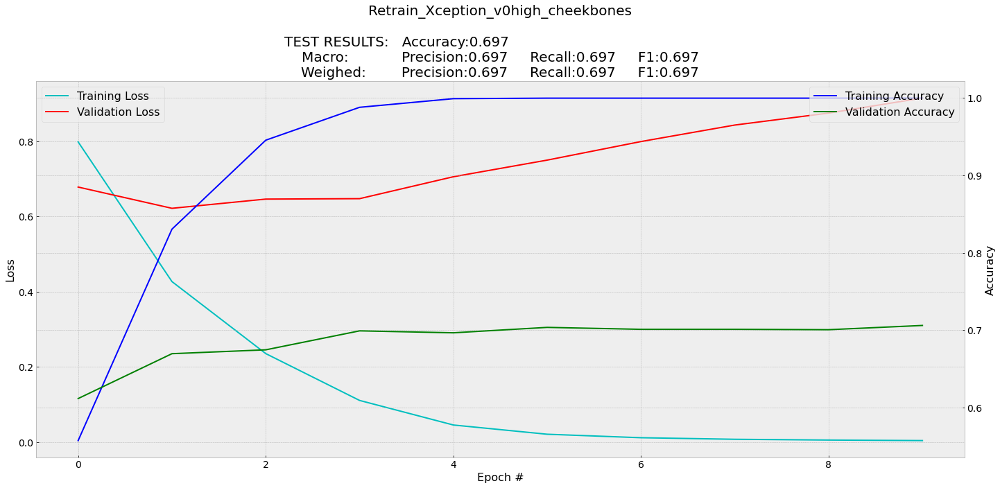

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.69575
True: 0.6875
False: 0.704

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_10 (InputLayer)           [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_10[0][0]                   
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 71s 1s/step - loss: 0.7805 - accuracy: 0.5722 - val_loss: 0.6924 - val_accuracy: 0.6100
Epoch 2/20
47/47 [==============================] - 65s 1s/step - loss: 0.4267 - accuracy: 0.8247 - val_loss: 0.6443 - val_accuracy: 0.6525
Epoch 3/20
47/47 [==============================] - 65s 1s/step - loss: 0.2386 - accuracy: 0.9358 - val_loss: 0.6502 - val_accuracy: 0.6745
Epoch 4/20
47/47 [==============================] - 64s 1s/step - loss: 0.1104 - accuracy: 0.9832 - val_loss: 0.6967 - val_accuracy: 0.6930
Epoch 5/20
47/47 [==============================] - 65s 1s/step - loss: 0.0399 - accuracy: 0.9992 - val_loss: 0.7727 - val_accuracy: 0.6910
Epoch 6/20
47/47 [==============================] - 65s 1s/step - loss: 0.0176 - accuracy: 0.9997 - val_loss: 0.8414 - val_accuracy: 0.6925
Epoch 7/20
47/47 [==============================] - 64s 1s/step - loss: 0.0092 - accuracy: 0.9997 - val_loss: 0.9263 - val_accuracy: 0.6960
Epoch 8/20
47/47 [==

20186

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.69575
True: 0.6875
False: 0.704
              precision    recall  f1-score   support

           0       0.70      0.69      0.69      4000
           1       0.69      0.70      0.70      4000

    accuracy                           0.70      8000
   macro avg       0.70      0.70      0.70      8000
weighted avg       0.70      0.70      0.70      8000



#### Gráfico de entrenamiento

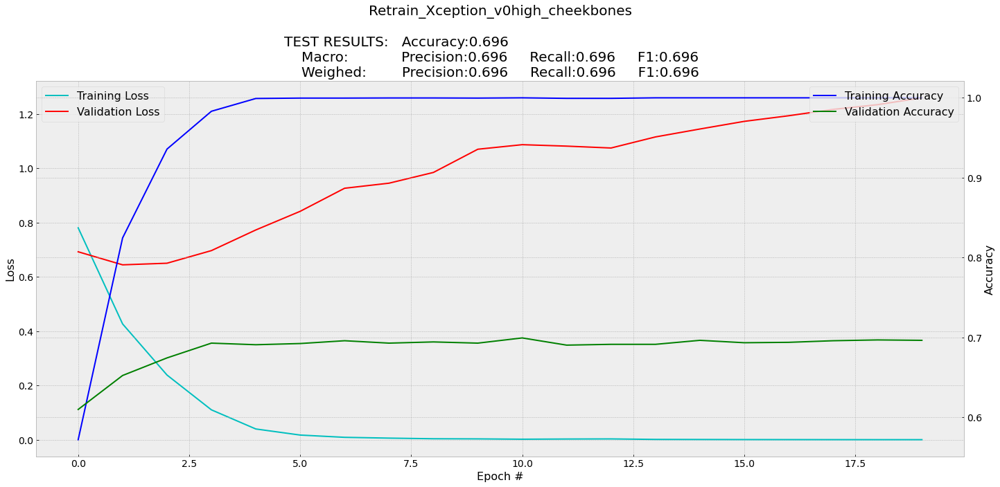

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

# Etiqueta Celeba: "big nose"

## Proceso

### CLIP crear "prompt" y preparar parámetros

In [ ]:
import torch
import clip
from PIL import Image
import glob

Name_feature='_big_nose'
id_feature=7
Save_Data_Path=BASE_FOLDER_2+'Retrain_v0'+Name_feature+'.pkl'

Index_To_Test=[]
Label_To_Test=[]
Data_To_Train=[]
Label_To_Train=[]
Data = {'Training':{}, 'Model Name':{}, 'H':{}, 'Classes':{}}
Data['Training']={'Images':{},'Images array':{}, 'Classes':{}, 'Classes array':{}, 'Index':{}, 'H':{}}
Data['Training']['Images']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Images array']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes array']={'Train':{}, 'Validate':{}}

clip_tokens=[ 'A picture of a person', 'A picture of a big-nosed person', 'A picture of a normal-nosed person',
            'A picture of a small-nosed person']

N_Tokens=len(clip_tokens)
print(N_Tokens)
print(clip_tokens)
for current_token in clip_tokens:
    print(current_token)

# [ 'A picture of a person',"A picture of a person with 5 o'clock shadow",'A picture of a person with arched eyebrows',
# 'A picture of an attractive person','A picture of a person with bags under eyes',
# 'A picture of a bald person','A picture of a person with bangs','A picture of a person with big lips',
# 'A picture of a person with big nose','A picture of a person with black hair',
# 'A picture of a person with blond hair','A blurry picture of a person',
# 'A picture of a person with brown hair','A picture of a person with bushy eyebrows',
# 'A picture of a chubby person','A picture of a person with double chin','A picture of a person with eyeglasses',
# 'A picture of a person with goatee','A picture of a person with gray hair','A picture of a person with heavy makeup',
# 'A picture of a person with high cheekbones','A picture of a male person',
# 'A picture of a person with mouth slightly open','A picture of a person with mustache',
# 'A picture of a person with narrow eyes','A picture of a person with no beard',
# 'A picture of a person with oval face','A picture of a person with pale skin','A picture of a person with pointy nose',
# 'A picture of a person with receding hairline','A picture of a person with rosy cheeks','A picture of a person with sideburns',
# 'A picture of a person who is smiling','A picture of a person with straight hair','A picture of a person with wavy hair',
# 'A picture of a person with earrings','A picture of a person with hat','A picture of a person with lipstick',
# 'A picture of a person with necklace','A picture of a person with necktie','A picture of a young person']

4
['A picture of a person', 'A picture of a big-nosed person', 'A picture of a normal-nosed person', 'A picture of a small-nosed person']
A picture of a person
A picture of a big-nosed person
A picture of a normal-nosed person
A picture of a small-nosed person


### Cargar CLIP

In [ ]:
clip_device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, clip_transform = clip.load("ViT-B/32", device=clip_device)
clip_text = clip.tokenize(clip_tokens).to(clip_device)

# CLIP features
text_features = clip_model.encode_text(clip_text)

test_index=1
test_image_path=Path_images+str(test_index).zfill(6)+'.jpg'
img_proeprocessed = clip_transform(Image.open(test_image_path)).unsqueeze(0).to(clip_device)
img_features = clip_model.encode_image(img_proeprocessed)
img_features_shape= img_features.shape

print('\n- Image Features:')
print('     Type:',type(img_features))
print('     Shape:',img_features_shape)
print('\n- Text Features:')
print('     Type:',type(text_features))
print('     Shape:',text_features.shape)
print('\n- Image Features Tensor:')
print(img_features)
print('\n- Text Features Tesor:')
print(text_features)

100%|███████████████████████████████████████| 338M/338M [00:04<00:00, 72.8MiB/s]



- Image Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([1, 512])

- Text Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([4, 512])

- Image Features Tensor:
tensor([[-6.0150e-02,  1.7044e-02, -9.9854e-02,  2.3523e-01, -6.8359e-02,
         -8.4814e-01, -3.7036e-01, -4.8169e-01, -3.1921e-02, -3.8666e-02,
         -5.1666e-02, -1.9775e-01,  6.2061e-01, -5.4565e-02,  7.4365e-01,
          4.4678e-02,  1.5791e+00, -4.6045e-01,  1.3513e-01, -1.4685e-01,
         -3.7012e-01, -3.7183e-01, -4.6509e-01, -2.8833e-01, -1.7578e-01,
         -1.3904e-01,  2.9028e-01, -9.5642e-02,  3.9746e-01,  1.3770e-01,
          5.1855e-01,  1.5613e-01,  8.7524e-02, -1.0674e-02, -9.4531e-01,
          2.2595e-01, -3.6133e-02,  4.6924e-01,  9.4604e-02,  1.5908e+00,
          2.1533e-01,  1.9360e-01, -5.3284e-02, -7.5500e-02, -6.1111e-03,
          1.4443e+00,  1.2891e-01,  5.3613e-01,  4.5630e-01,  3.9478e-01,
          1.7310e-01,  1.6138e-01, -2.8870e-02, -2.5464e-01, -1

### Seleccionar indices a usar del Dataset Celeba

In [ ]:
# encontrar indices man_woman true/false
Index_Features_0=[]
Index_Features_1=[]

i=0
for descripton in Description_data:
    i=i+1
    if descripton[id_feature]: 
        Index_Features_0.append(i)
    else:
        Index_Features_1.append(i)

## Mostrar Results       
min_value=9999999
print('Examples of celeba:')
print(Description_labels[id_feature]+':',len(Index_Features_0))
print('Not '+Description_labels[id_feature]+':',len(Index_Features_1))  

# Smiling -  True: 97669
# Smiling - False: 104930

Examples of celeba:
Big_Nose: 47516
Not Big_Nose: 155083


### Cargar Datos (ejectuar si se dispone del archivo de datos creado)

In [ ]:
## LOAD DATA
file_to_load = open(Save_Data_Path, "rb")
df_loaded = pickle.load(file_to_load)
file_to_load.close()

Data=df_loaded['Data']
Index_To_Test=df_loaded['Index_To_Test']
Label_To_Test=df_loaded['Label_To_Test']
Data_To_Train=df_loaded['Data_To_Train']
Label_To_Train=df_loaded['Label_To_Train']

### Preparar datos (ejectuar solo si no se dispone del archivo de datos creado)

In [ ]:
def Preprocess_img(images_id,clip_device,clip_model,clip_preprocess,clip_text):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    probs=CLIP_get_probs_only(test_image_path, clip_text, clip_model, clip_preprocess, clip_device)
    return clip_model.encode_image(clip_img).detach().cpu().numpy(), np.array(img_current), probs

def Preprocess_img2(images_id,clip_device,clip_model,clip_preprocess):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    return clip_model.encode_image(clip_img).detach().cpu().numpy(), np.array(img_current)

def CLIP_get_probs_only(img_path,img_txt, img_model, img_transf, img_device):
    img_proeprocessed = img_transf(Image.open(img_path)).unsqueeze(0).to(img_device)

    img_features = img_model.encode_image(img_proeprocessed)
    txt_features = img_model.encode_text(img_txt)
    
    img_logits, img_logits_txt = img_model(img_proeprocessed, img_txt)
    # image_p=softmax(img_logits.detach().numpy()[0])
    image_p=img_logits.detach().cpu().numpy()[0]

    return image_p

# Data['Training']['Images']['Test']=[]
# Data['Training']['Images']['Not Test']=[]
# Data['Training']['Classes']['Test']=[]
# Data['Training']['Classes']['Not Test']=[]
# Data['Training']['Images array']['Test']=[]
# Data['Training']['Images array']['Not Test']=[]

# Data['Prediccion_Probs']=np.zeros((16000,N_Tokens))
# n=0
# for i in range(4000):
#     Index_To_Test.append(Index_Features_0[i])
#     Label_To_Test.append(clip_tokens[1])
#     img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_0[i],clip_device,clip_model,clip_transform,clip_text)
#     Data['Training']['Images']['Test'].append(img)
#     Data['Training']['Images array']['Test'].append(img_arr)
#     Data['Training']['Classes']['Test'].append(0)
#     n+=1
#     Index_To_Test.append(Index_Features_1[i])
#     Label_To_Test.append(clip_tokens[2])
#     img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_1[i],clip_device,clip_model,clip_transform,clip_text)
#     Data['Training']['Images']['Test'].append(img)
#     Data['Training']['Images array']['Test'].append(img_arr)
#     Data['Training']['Classes']['Test'].append(1)
#     n+=1

#     if i % 400 == 0 and i>0:
#         print('Test images load (%):',i/40)
        
#         df_to_save= {'Data': Data,
#                       'Index_To_Test':Index_To_Test,
#                       'Label_To_Test':Label_To_Test,
#                       'Data_To_Train':Data_To_Train,
#                       'Label_To_Train':Label_To_Train
#         }
#         save_df_to_file(df_to_save,Save_Data_Path)

#     gc.collect() 
    
# for i in range(4000,8000):
#     Data_To_Train.append(Index_Features_0[i])
#     Label_To_Train.append(clip_tokens[1])
#     img, img_arr=Preprocess_img2(Index_Features_0[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Not Test'].append(img)
#     Data['Training']['Images array']['Not Test'].append(img_arr)
#     Data['Training']['Classes']['Not Test'].append(0)

#     Data_To_Train.append(Index_Features_1[i])
#     Label_To_Train.append(clip_tokens[2])
#     img, img_arr=Preprocess_img2(Index_Features_1[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Not Test'].append(img)
#     Data['Training']['Images array']['Not Test'].append(img_arr)
#     Data['Training']['Classes']['Not Test'].append(1)

#     if i % 400 == 0 and i>2000:
#         print('Train images load (%):',(i-4000)/40)
#         df_to_save= {'Data': Data,
#                       'Index_To_Test':Index_To_Test,
#                       'Label_To_Test':Label_To_Test,
#                       'Data_To_Train':Data_To_Train,
#                       'Label_To_Train':Label_To_Train
#         }
#         save_df_to_file(df_to_save,Save_Data_Path)
#     # gc.collect()

# Data['Classes']=[]
# for element in np.unique(Data['Training']['Classes']['Test']):
#     Data['Classes'].append(np.int(element))

# Data['Training']['Images']['Train'], Data['Training']['Images']['Validate'], Data['Training']['Classes']['Train'], Data['Training']['Classes']['Validate'] = train_test_split(Data['Training']['Images']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)
# Data['Training']['Images array']['Train'], Data['Training']['Images array']['Validate'], Data['Training']['Classes array']['Train'], Data['Training']['Classes array']['Validate'] = train_test_split(Data['Training']['Images array']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)

# df_to_save= {'Data': Data,
#               'Index_To_Test':Index_To_Test,
#               'Label_To_Test':Label_To_Test,
#               'Data_To_Train':Data_To_Train,
#               'Label_To_Train':Label_To_Train
# }
# save_df_to_file(df_to_save,Save_Data_Path)

# ## Visualizar número de entrenamiento
# print('NÚMERO DE DATOS PARA ENTRENAR/TEST')
# print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Not Test']),'con',len(np.unique(Data['Training']['Classes']['Test'])),'clases')
# print('Número de datos para Test:',  len(Data['Training']['Classes']['Test']),'con',len(np.unique(Data['Training']['Classes']['Not Test'])),'clases')

# ## Visualizar número de entrenamiento
# print('\nNÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN')
# print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Train']),'con',len(np.unique(Data['Training']['Classes']['Train'])),'clases')
# print('Número de datos para Validación:',  len(Data['Training']['Classes']['Validate']),'con',len(np.unique(Data['Training']['Classes']['Validate'])),'clases')


## CLIP prompts

##### Calcular tokens celeba

In [ ]:
Prediccion_Probs=Data['Prediccion_Probs']

N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(len(clip_tokens)-1)
Precision_False=np.zeros(len(clip_tokens)-1)
Precision_All=np.zeros(len(clip_tokens)-1)

for i in range(len(clip_tokens)-1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [1,2]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    else:
        for k in [1,2]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [0]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba

In [ ]:
## Resulrts
celeba_labels=[7,7,7]
dataframe_array=[]
for i in range(len(clip_tokens)-1):
    dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])

dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(len(clip_tokens)-1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref.csv",';')
print(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref.csv")

,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Big_Nose,A picture of a big-nosed person,12.45,90.52,51.49
1,Big_Nose,A picture of a normal-nosed person,18.8,78.0,48.4
2,Big_Nose,A picture of a small-nosed person,16.2,86.35,51.28


/content/drive/My Drive/Colab Notebooks/CLIP__big_nose_vs_ref.csv


##### Calcular tokens celeba - cambio de referencia 1

In [ ]:
New_reference=2
N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(1)
Precision_False=np.zeros(1)
Precision_All=np.zeros(1)

for i in range(len(clip_tokens)-1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,New_reference]:
                Precision_True[k]+=1
                Precision_All[k]+=1

    else:

        for k in [0]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,New_reference]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba - cambio de referencia 1

In [ ]:
## Resulrts
celeba_labels=[7]
dataframe_array=[]
for i in range(1):
    if i<10: 
        dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])

    else: 
        dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+2],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])
dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
print('Referencia:',clip_tokens[New_reference])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref_b.csv",';')

Referencia: A picture of a normal-nosed person


,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Big_Nose,A picture of a big-nosed person,25.2,68.3,46.75


##### Calcular tokens celeba - cambio de referencia 2

In [ ]:
New_reference=3
N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(11)
Precision_False=np.zeros(11)
Precision_All=np.zeros(11)

for i in range(1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,New_reference]:
                Precision_True[k]+=1
                Precision_All[k]+=1
    else:
        for k in [0]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,New_reference]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba - cambio de referencia 2

In [ ]:
## Resulrts
celeba_labels=[7]
dataframe_array=[]
for i in range(1):
    dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                      Precision_percent_True[i],
                      Precision_percent_False[i],
                      Precision_percent_All[i]
                      ])


dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
print('Referencia:',clip_tokens[New_reference])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref_c.csv",';')

Referencia: A picture of a small-nosed person


,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Big_Nose,A picture of a big-nosed person,35.0,72.5,53.75


## Modelos

### CLIP 
All: 0.76675
True: 0.76575
False: 0.76775

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten (Flatten)            (None, 512)               0         
_________________________________________________________________
dense (Dense)                (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.1,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 3s 9ms/step - loss: 0.6092 - accuracy: 0.7193 - val_loss: 0.5419 - val_accuracy: 0.7455
Epoch 2/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.4851 - accuracy: 0.7663 - val_loss: 0.4992 - val_accuracy: 0.7520
Epoch 3/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.4668 - accuracy: 0.7720 - val_loss: 0.4931 - val_accuracy: 0.7545
Epoch 4/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.4610 - accuracy: 0.7770 - val_loss: 0.4965 - val_accuracy: 0.7490
Epoch 5/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.4562 - accuracy: 0.7815 - val_loss: 0.5080 - val_accuracy: 0.7440
Epoch 6/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.4519 - accuracy: 0.7853 - val_loss: 0.4894 - val_accuracy: 0.7565
Epoch 7/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.4498 - accuracy: 0.7847 - val_loss: 0.4926 - val_accuracy: 0.7530
Epoch 

1617

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.76675
True: 0.76575
False: 0.76775
              precision    recall  f1-score   support

           0       0.77      0.77      0.77      4000
           1       0.77      0.77      0.77      4000

    accuracy                           0.77      8000
   macro avg       0.77      0.77      0.77      8000
weighted avg       0.77      0.77      0.77      8000



#### Gráfico de entrenamiento

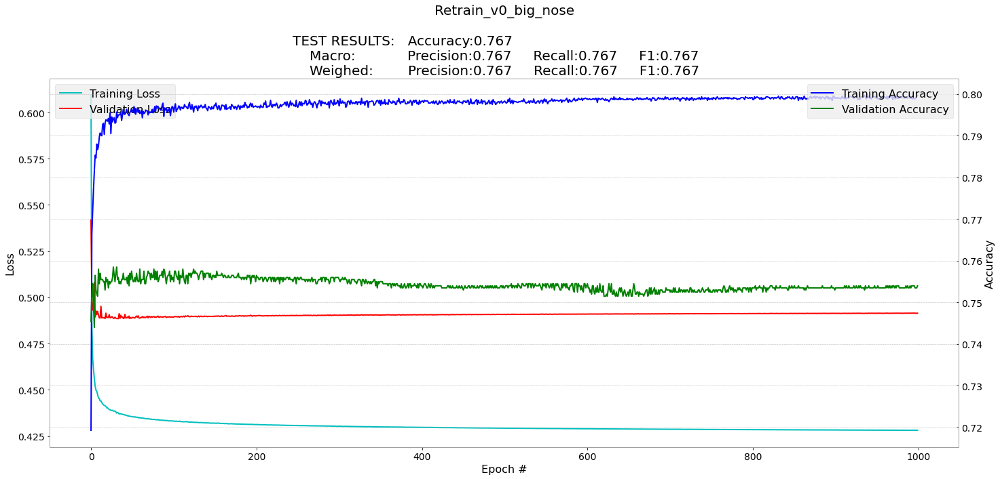

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.76625
True: 0.76325
False: 0.76925              p

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.01,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 1s 8ms/step - loss: 0.5954 - accuracy: 0.6943 - val_loss: 0.5217 - val_accuracy: 0.7480
Epoch 2/1000
47/47 [==============================] - 0s 6ms/step - loss: 0.5112 - accuracy: 0.7470 - val_loss: 0.5147 - val_accuracy: 0.7605
Epoch 3/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.5031 - accuracy: 0.7522 - val_loss: 0.5084 - val_accuracy: 0.7610
Epoch 4/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.4982 - accuracy: 0.7540 - val_loss: 0.5055 - val_accuracy: 0.7600
Epoch 5/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.4955 - accuracy: 0.7570 - val_loss: 0.5041 - val_accuracy: 0.7615
Epoch 6/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.4932 - accuracy: 0.7573 - val_loss: 0.5028 - val_accuracy: 0.7605
Epoch 7/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.4915 - accuracy: 0.7583 - val_loss: 0.5017 - val_accuracy: 0.7610
Epoch 

2677

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.76625
True: 0.76325
False: 0.76925
              precision    recall  f1-score   support

           0       0.77      0.76      0.77      4000
           1       0.76      0.77      0.77      4000

    accuracy                           0.77      8000
   macro avg       0.77      0.77      0.77      8000
weighted avg       0.77      0.77      0.77      8000



#### Gráfico de entrenamiento

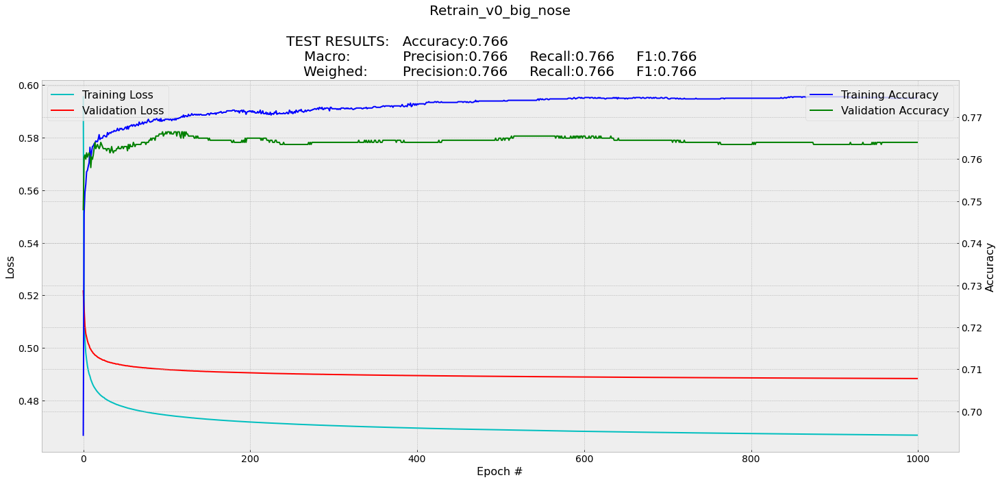

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.726125
True: 0.7355
False: 0.71675              

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 1s 8ms/step - loss: 1.0430 - accuracy: 0.4947 - val_loss: 0.8933 - val_accuracy: 0.5590
Epoch 2/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.8551 - accuracy: 0.5750 - val_loss: 0.8217 - val_accuracy: 0.5920
Epoch 3/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.8039 - accuracy: 0.6002 - val_loss: 0.7854 - val_accuracy: 0.6105
Epoch 4/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.7743 - accuracy: 0.6142 - val_loss: 0.7617 - val_accuracy: 0.6220
Epoch 5/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.7537 - accuracy: 0.6257 - val_loss: 0.7443 - val_accuracy: 0.6355
Epoch 6/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.7383 - accuracy: 0.6323 - val_loss: 0.7311 - val_accuracy: 0.6450
Epoch 7/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.7262 - accuracy: 0.6418 - val_loss: 0.7202 - val_accuracy: 0.6520
Epoch 

2677

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.726125
True: 0.7355
False: 0.71675
              precision    recall  f1-score   support

           0       0.72      0.74      0.73      4000
           1       0.73      0.72      0.72      4000

    accuracy                           0.73      8000
   macro avg       0.73      0.73      0.73      8000
weighted avg       0.73      0.73      0.73      8000



#### Gráfico de entrenamiento

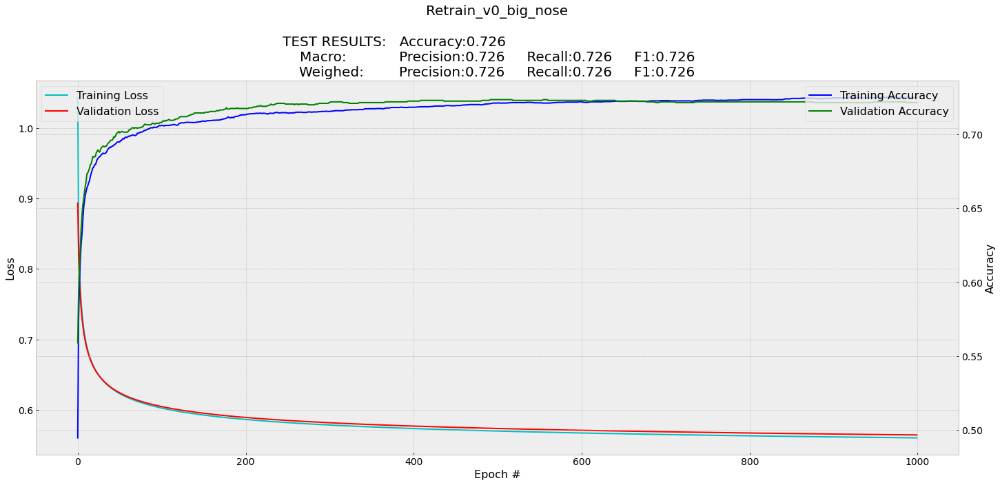

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.75425
True: 0.75625
False: 0.75225

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0005,decay=0.0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 1s 9ms/step - loss: 1.0797 - accuracy: 0.5363 - val_loss: 0.7517 - val_accuracy: 0.6450
Epoch 2/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.6627 - accuracy: 0.6895 - val_loss: 0.6112 - val_accuracy: 0.7125
Epoch 3/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.5835 - accuracy: 0.7218 - val_loss: 0.5682 - val_accuracy: 0.7325
Epoch 4/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.5520 - accuracy: 0.7312 - val_loss: 0.5459 - val_accuracy: 0.7395
Epoch 5/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.5342 - accuracy: 0.7393 - val_loss: 0.5333 - val_accuracy: 0.7485
Epoch 6/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.5225 - accuracy: 0.7465 - val_loss: 0.5246 - val_accuracy: 0.7495
Epoch 7/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.5135 - accuracy: 0.7530 - val_loss: 0.5182 - val_accuracy: 0.7520
Epoch 

2676

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.75425
True: 0.75625
False: 0.75225
              precision    recall  f1-score   support

           0       0.75      0.76      0.75      4000
           1       0.76      0.75      0.75      4000

    accuracy                           0.75      8000
   macro avg       0.75      0.75      0.75      8000
weighted avg       0.75      0.75      0.75      8000



#### Gráfico de entrenamiento

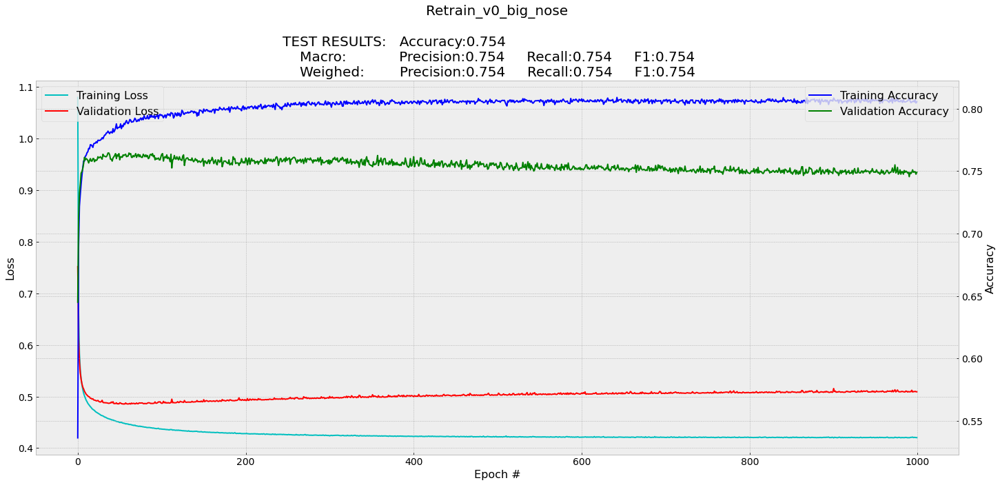

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.76575
True: 0.76
False: 0.7715

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_14 (InputLayer)        [(None, 1, 512)]          0         
_________________________________________________________________
flatten_13 (Flatten)         (None, 512)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0005,decay=0.0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=50, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/50
47/47 [==============================] - 1s 9ms/step - loss: 1.1455 - accuracy: 0.4873 - val_loss: 0.7950 - val_accuracy: 0.6060
Epoch 2/50
47/47 [==============================] - 0s 5ms/step - loss: 0.6927 - accuracy: 0.6737 - val_loss: 0.6482 - val_accuracy: 0.6765
Epoch 3/50
47/47 [==============================] - 0s 4ms/step - loss: 0.6070 - accuracy: 0.7062 - val_loss: 0.5967 - val_accuracy: 0.6975
Epoch 4/50
47/47 [==============================] - 0s 4ms/step - loss: 0.5699 - accuracy: 0.7243 - val_loss: 0.5687 - val_accuracy: 0.7105
Epoch 5/50
47/47 [==============================] - 0s 5ms/step - loss: 0.5483 - accuracy: 0.7358 - val_loss: 0.5517 - val_accuracy: 0.7275
Epoch 6/50
47/47 [==============================] - 0s 5ms/step - loss: 0.5334 - accuracy: 0.7430 - val_loss: 0.5390 - val_accuracy: 0.7385
Epoch 7/50
47/47 [==============================] - 0s 5ms/step - loss: 0.5230 - accuracy: 0.7475 - val_loss: 0.5301 - val_accuracy: 0.7450
Epoch 8/50
47/47 [==

2676

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.76575
True: 0.76
False: 0.7715
              precision    recall  f1-score   support

           0       0.77      0.76      0.76      4000
           1       0.76      0.77      0.77      4000

    accuracy                           0.77      8000
   macro avg       0.77      0.77      0.77      8000
weighted avg       0.77      0.77      0.77      8000



#### Gráfico de entrenamiento

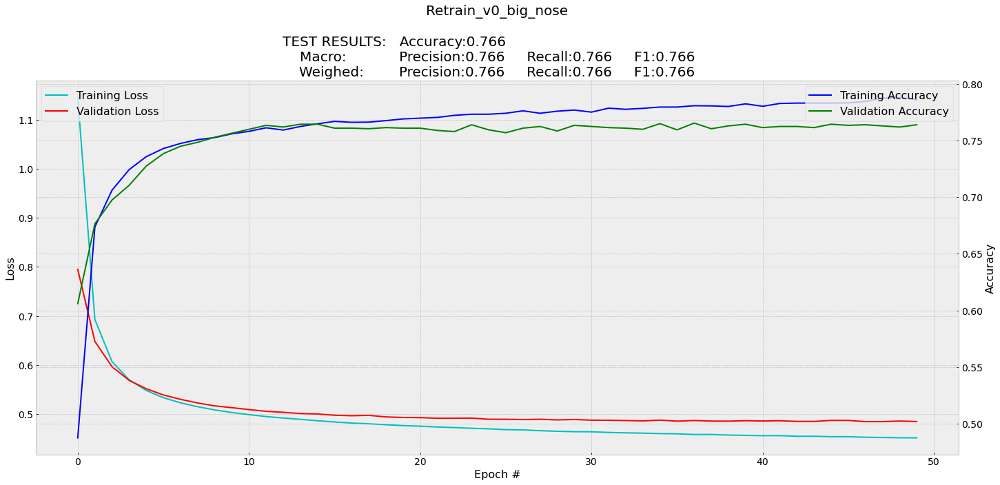

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.667875
True: 0.51675
False: 0.819

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

80150528/80134624 [==============================] - 1s 0us/step
Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
____________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 114s 2s/step - loss: 1.1067 - accuracy: 0.5613 - val_loss: 0.6494 - val_accuracy: 0.6285
Epoch 2/20
47/47 [==============================] - 51s 1s/step - loss: 0.6083 - accuracy: 0.6682 - val_loss: 0.6172 - val_accuracy: 0.6785
Epoch 3/20
47/47 [==============================] - 51s 1s/step - loss: 0.5599 - accuracy: 0.7080 - val_loss: 0.5872 - val_accuracy: 0.6885
Epoch 4/20
47/47 [==============================] - 51s 1s/step - loss: 0.5287 - accuracy: 0.7405 - val_loss: 0.5898 - val_accuracy: 0.6900
Epoch 5/20
47/47 [==============================] - 51s 1s/step - loss: 0.4612 - accuracy: 0.7812 - val_loss: 0.6337 - val_accuracy: 0.6825
Epoch 6/20
47/47 [==============================] - 51s 1s/step - loss: 0.3950 - accuracy: 0.8228 - val_loss: 0.6916 - val_accuracy: 0.6805
Epoch 7/20
47/47 [==============================] - 51s 1s/step - loss: 0.3246 - accuracy: 0.8608 - val_loss: 0.7038 - val_accuracy: 0.6950
Epoch 8/20
47/47 [=

1621

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.667875
True: 0.51675
False: 0.819
              precision    recall  f1-score   support

           0       0.74      0.52      0.61      4000
           1       0.63      0.82      0.71      4000

    accuracy                           0.67      8000
   macro avg       0.68      0.67      0.66      8000
weighted avg       0.68      0.67      0.66      8000



#### Gráfico de entrenamiento

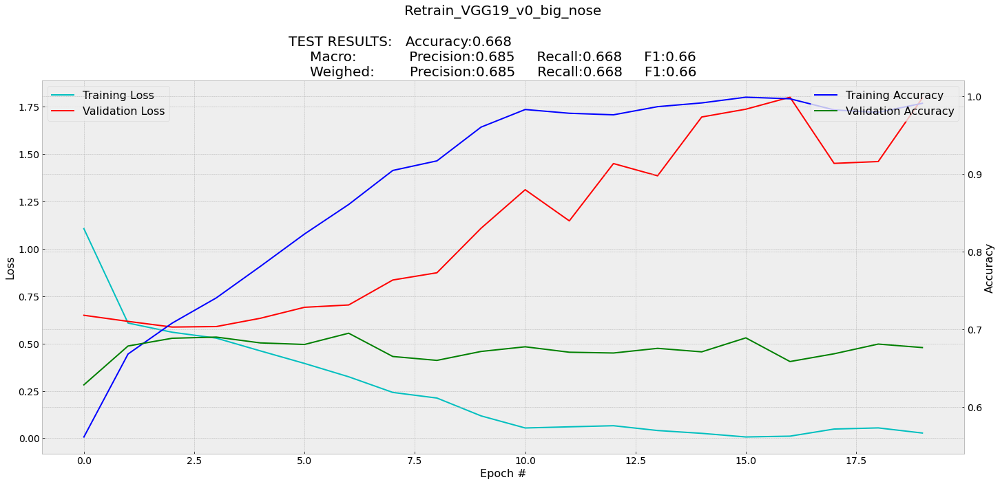

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.68825
True: 0.68225
False: 0.69425

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_15 (InputLayer)        [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0  

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=30, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/30
47/47 [==============================] - 54s 1s/step - loss: 1.1800 - accuracy: 0.5567 - val_loss: 0.6393 - val_accuracy: 0.6365
Epoch 2/30
47/47 [==============================] - 51s 1s/step - loss: 0.6207 - accuracy: 0.6592 - val_loss: 0.5978 - val_accuracy: 0.6875
Epoch 3/30
47/47 [==============================] - 51s 1s/step - loss: 0.5802 - accuracy: 0.6988 - val_loss: 0.6107 - val_accuracy: 0.6675
Epoch 4/30
47/47 [==============================] - 51s 1s/step - loss: 0.5573 - accuracy: 0.7147 - val_loss: 0.5788 - val_accuracy: 0.7045
Epoch 5/30
47/47 [==============================] - 51s 1s/step - loss: 0.5103 - accuracy: 0.7495 - val_loss: 0.5817 - val_accuracy: 0.7085
Epoch 6/30
47/47 [==============================] - 51s 1s/step - loss: 0.4725 - accuracy: 0.7813 - val_loss: 0.6069 - val_accuracy: 0.6915
Epoch 7/30
47/47 [==============================] - 51s 1s/step - loss: 0.4446 - accuracy: 0.7927 - val_loss: 0.5861 - val_accuracy: 0.6890
Epoch 8/30
47/47 [==

5571

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.68825
True: 0.68225
False: 0.69425
              precision    recall  f1-score   support

           0       0.69      0.68      0.69      4000
           1       0.69      0.69      0.69      4000

    accuracy                           0.69      8000
   macro avg       0.69      0.69      0.69      8000
weighted avg       0.69      0.69      0.69      8000



#### Gráfico de entrenamiento

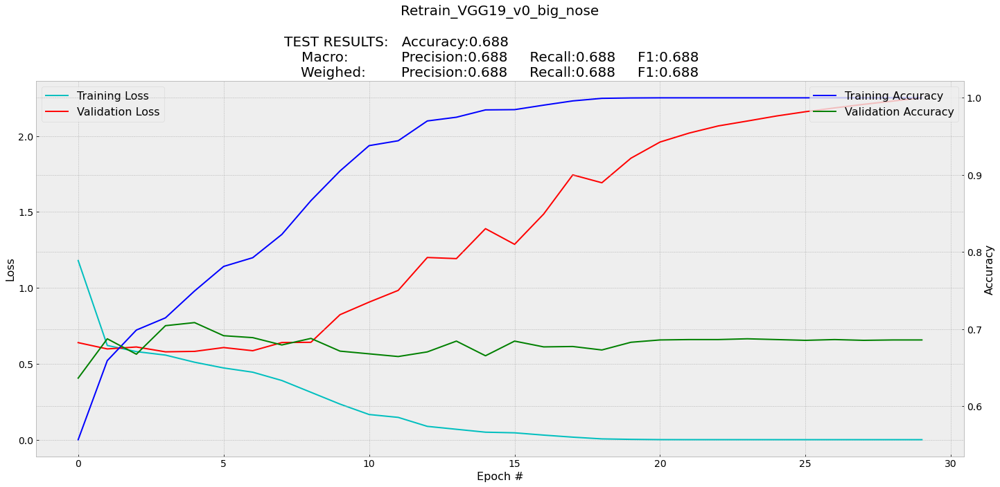

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.6535
True: 0.66975
False: 0.63725

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 53s 1s/step - loss: 2.2243 - accuracy: 0.5352 - val_loss: 0.8330 - val_accuracy: 0.5925
Epoch 2/10
47/47 [==============================] - 51s 1s/step - loss: 0.7201 - accuracy: 0.6405 - val_loss: 0.7232 - val_accuracy: 0.6205
Epoch 3/10
47/47 [==============================] - 51s 1s/step - loss: 0.6073 - accuracy: 0.6968 - val_loss: 0.6991 - val_accuracy: 0.6350
Epoch 4/10
47/47 [==============================] - 51s 1s/step - loss: 0.5336 - accuracy: 0.7428 - val_loss: 0.6993 - val_accuracy: 0.6440
Epoch 5/10
47/47 [==============================] - 51s 1s/step - loss: 0.4697 - accuracy: 0.7862 - val_loss: 0.6920 - val_accuracy: 0.6510
Epoch 6/10
47/47 [==============================] - 51s 1s/step - loss: 0.4084 - accuracy: 0.8188 - val_loss: 0.7016 - val_accuracy: 0.6525
Epoch 7/10
47/47 [==============================] - 51s 1s/step - loss: 0.3500 - accuracy: 0.8553 - val_loss: 0.7251 - val_accuracy: 0.6540
Epoch 8/10
47/47 [==

5571

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.6535
True: 0.66975
False: 0.63725
              precision    recall  f1-score   support

           0       0.65      0.67      0.66      4000
           1       0.66      0.64      0.65      4000

    accuracy                           0.65      8000
   macro avg       0.65      0.65      0.65      8000
weighted avg       0.65      0.65      0.65      8000



#### Gráfico de entrenamiento

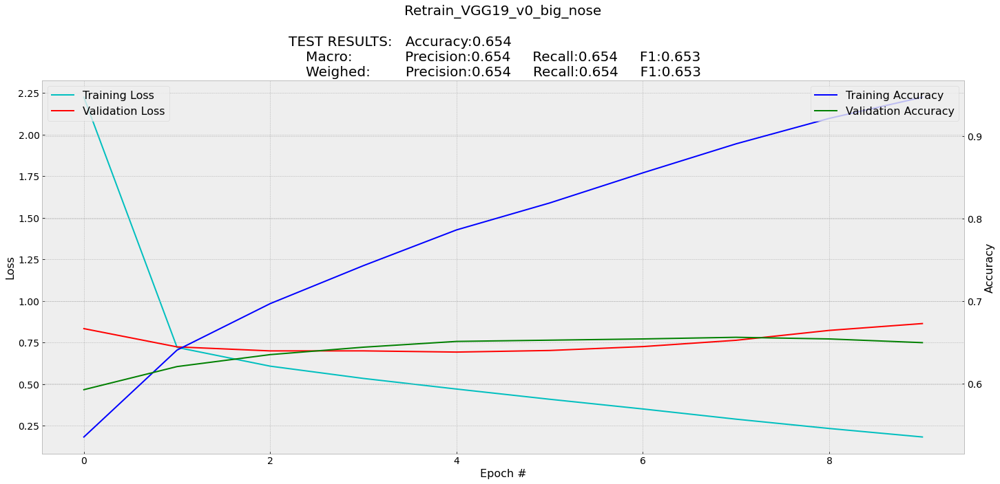

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.655
True: 0.658
False: 0.652
              

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_13 (InputLayer)        [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0  

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=25, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/25
47/47 [==============================] - 54s 1s/step - loss: 1.7787 - accuracy: 0.5620 - val_loss: 0.7596 - val_accuracy: 0.6250
Epoch 2/25
47/47 [==============================] - 52s 1s/step - loss: 0.6768 - accuracy: 0.6488 - val_loss: 0.6802 - val_accuracy: 0.6400
Epoch 3/25
47/47 [==============================] - 52s 1s/step - loss: 0.5919 - accuracy: 0.6962 - val_loss: 0.6591 - val_accuracy: 0.6570
Epoch 4/25
47/47 [==============================] - 52s 1s/step - loss: 0.5351 - accuracy: 0.7327 - val_loss: 0.6570 - val_accuracy: 0.6570
Epoch 5/25
47/47 [==============================] - 52s 1s/step - loss: 0.4770 - accuracy: 0.7737 - val_loss: 0.6644 - val_accuracy: 0.6690
Epoch 6/25
47/47 [==============================] - 52s 1s/step - loss: 0.4244 - accuracy: 0.8032 - val_loss: 0.6602 - val_accuracy: 0.6655
Epoch 7/25
47/47 [==============================] - 52s 1s/step - loss: 0.3714 - accuracy: 0.8465 - val_loss: 0.6811 - val_accuracy: 0.6750
Epoch 8/25
47/47 [==

5571

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.655
True: 0.658
False: 0.652
              precision    recall  f1-score   support

           0       0.65      0.66      0.66      4000
           1       0.66      0.65      0.65      4000

    accuracy                           0.66      8000
   macro avg       0.66      0.66      0.65      8000
weighted avg       0.66      0.66      0.65      8000



#### Gráfico de entrenamiento

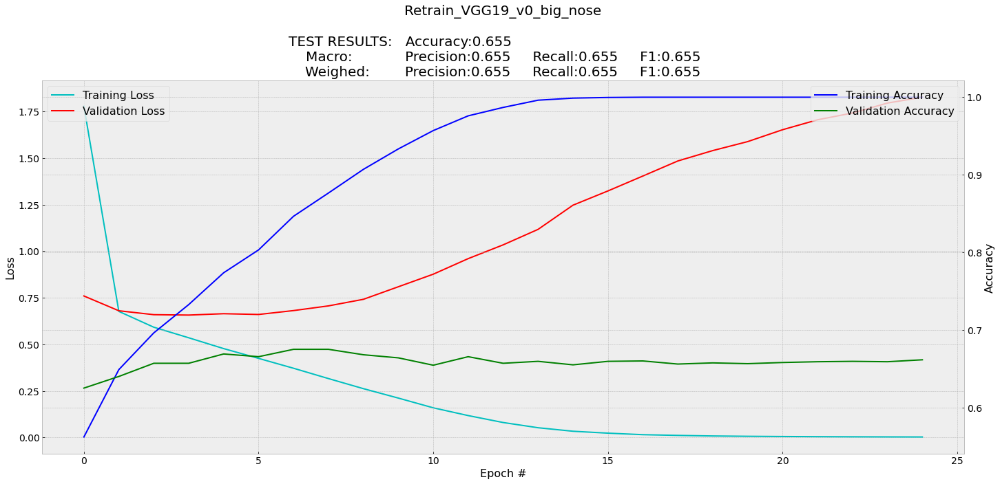

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.6925
True: 0.5985
False: 0.7865

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

80150528/80134624 [==============================] - 1s 0us/step
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
______________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 117s 2s/step - loss: 1.1942 - accuracy: 0.5138 - val_loss: 0.6891 - val_accuracy: 0.5530
Epoch 2/10
47/47 [==============================] - 51s 1s/step - loss: 0.6836 - accuracy: 0.5642 - val_loss: 0.6462 - val_accuracy: 0.6280
Epoch 3/10
47/47 [==============================] - 51s 1s/step - loss: 0.6419 - accuracy: 0.6288 - val_loss: 0.6145 - val_accuracy: 0.6585
Epoch 4/10
47/47 [==============================] - 51s 1s/step - loss: 0.6181 - accuracy: 0.6630 - val_loss: 0.6031 - val_accuracy: 0.6790
Epoch 5/10
47/47 [==============================] - 52s 1s/step - loss: 0.6021 - accuracy: 0.6767 - val_loss: 0.6225 - val_accuracy: 0.6530
Epoch 6/10
47/47 [==============================] - 51s 1s/step - loss: 0.5857 - accuracy: 0.6935 - val_loss: 0.5812 - val_accuracy: 0.6925
Epoch 7/10
47/47 [==============================] - 51s 1s/step - loss: 0.5625 - accuracy: 0.7078 - val_loss: 0.5709 - val_accuracy: 0.7130
Epoch 8/10
47/47 [=

1625

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.6925
True: 0.5985
False: 0.7865
              precision    recall  f1-score   support

           0       0.74      0.60      0.66      4000
           1       0.66      0.79      0.72      4000

    accuracy                           0.69      8000
   macro avg       0.70      0.69      0.69      8000
weighted avg       0.70      0.69      0.69      8000



#### Gráfico de entrenamiento

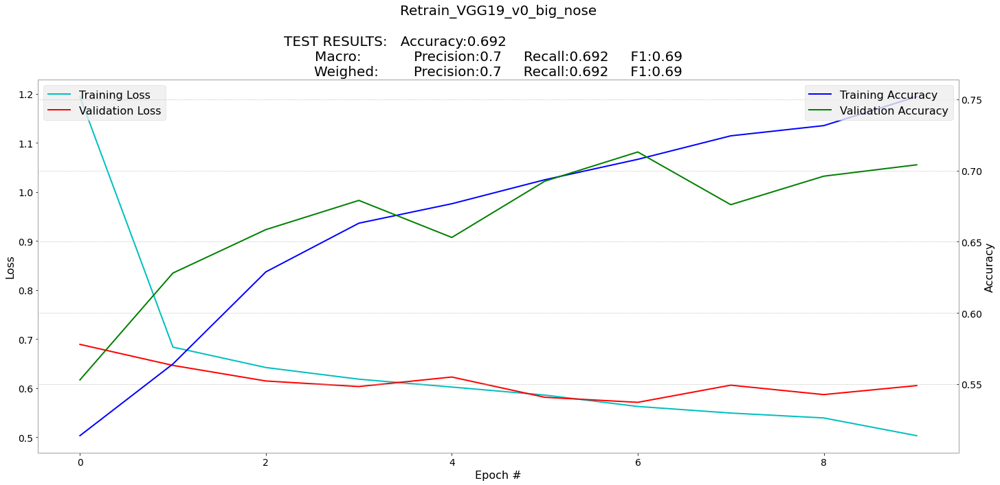

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.678625
True: 0.70725
False: 0.65

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 53s 1s/step - loss: 1.0757 - accuracy: 0.5687 - val_loss: 0.6627 - val_accuracy: 0.6085
Epoch 2/10
47/47 [==============================] - 51s 1s/step - loss: 0.6169 - accuracy: 0.6632 - val_loss: 0.6531 - val_accuracy: 0.6275
Epoch 3/10
47/47 [==============================] - 51s 1s/step - loss: 0.5737 - accuracy: 0.7003 - val_loss: 0.5777 - val_accuracy: 0.7090
Epoch 4/10
47/47 [==============================] - 51s 1s/step - loss: 0.5497 - accuracy: 0.7243 - val_loss: 0.5711 - val_accuracy: 0.7135
Epoch 5/10
47/47 [==============================] - 51s 1s/step - loss: 0.5297 - accuracy: 0.7312 - val_loss: 0.5623 - val_accuracy: 0.7180
Epoch 6/10
47/47 [==============================] - 51s 1s/step - loss: 0.4894 - accuracy: 0.7667 - val_loss: 0.5930 - val_accuracy: 0.7030
Epoch 7/10
47/47 [==============================] - 51s 1s/step - loss: 0.4380 - accuracy: 0.7973 - val_loss: 0.6507 - val_accuracy: 0.6715
Epoch 8/10
47/47 [==

5570

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.678625
True: 0.70725
False: 0.65
              precision    recall  f1-score   support

           0       0.67      0.71      0.69      4000
           1       0.69      0.65      0.67      4000

    accuracy                           0.68      8000
   macro avg       0.68      0.68      0.68      8000
weighted avg       0.68      0.68      0.68      8000



#### Gráfico de entrenamiento

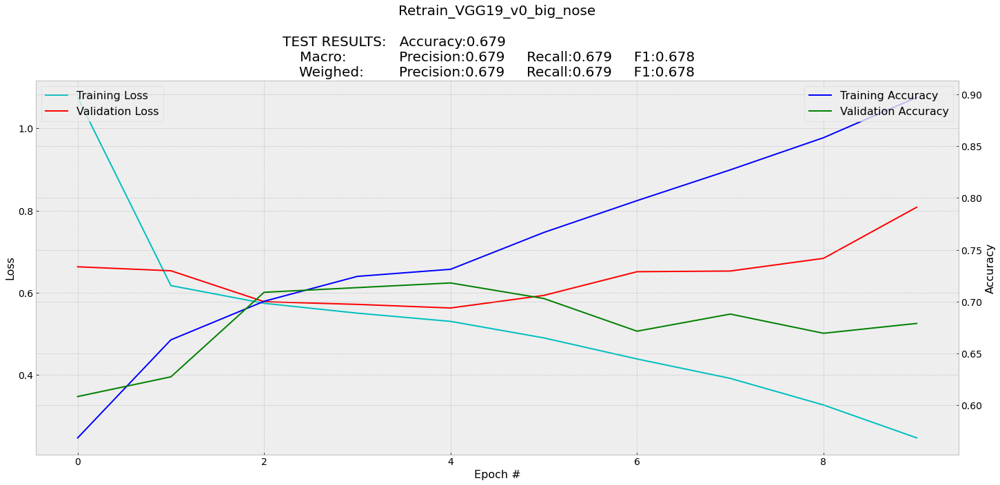

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.676
True: 0.631
False: 0.721

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

80150528/80134624 [==============================] - 2s 0us/step
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
______________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=25, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/25
47/47 [==============================] - 117s 2s/step - loss: 1.3339 - accuracy: 0.5390 - val_loss: 0.6895 - val_accuracy: 0.5495
Epoch 2/25
47/47 [==============================] - 51s 1s/step - loss: 0.6599 - accuracy: 0.6193 - val_loss: 0.6412 - val_accuracy: 0.6460
Epoch 3/25
47/47 [==============================] - 51s 1s/step - loss: 0.6269 - accuracy: 0.6488 - val_loss: 0.6380 - val_accuracy: 0.6335
Epoch 4/25
47/47 [==============================] - 51s 1s/step - loss: 0.6037 - accuracy: 0.6722 - val_loss: 0.6086 - val_accuracy: 0.6740
Epoch 5/25
47/47 [==============================] - 51s 1s/step - loss: 0.5810 - accuracy: 0.6918 - val_loss: 0.6029 - val_accuracy: 0.6685
Epoch 6/25
47/47 [==============================] - 51s 1s/step - loss: 0.5642 - accuracy: 0.7122 - val_loss: 0.5765 - val_accuracy: 0.7010
Epoch 7/25
47/47 [==============================] - 51s 1s/step - loss: 0.5434 - accuracy: 0.7227 - val_loss: 0.5705 - val_accuracy: 0.7075
Epoch 8/25
47/47 [=

1620

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.676
True: 0.631
False: 0.721
              precision    recall  f1-score   support

           0       0.69      0.63      0.66      4000
           1       0.66      0.72      0.69      4000

    accuracy                           0.68      8000
   macro avg       0.68      0.68      0.68      8000
weighted avg       0.68      0.68      0.68      8000



#### Gráfico de entrenamiento

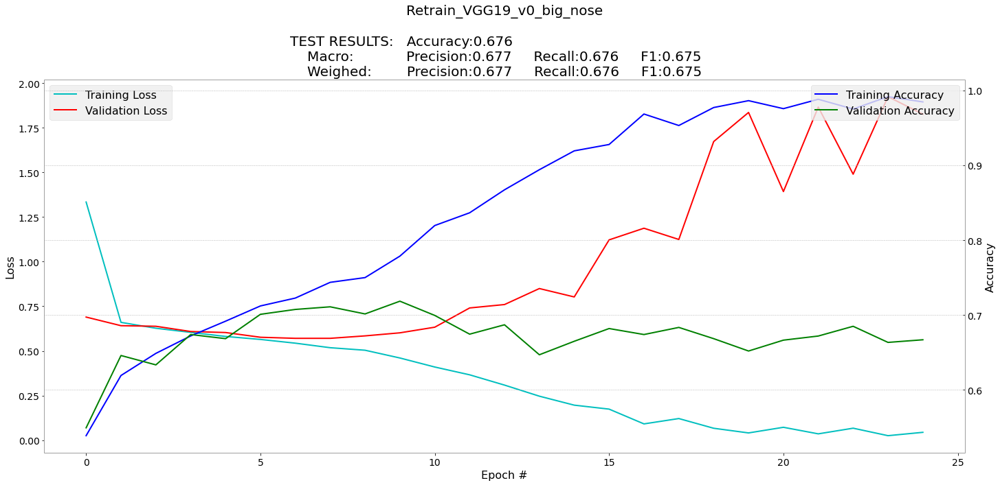

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.68275
True: 0.68175
False: 0.68375

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

83697664/83683744 [==============================] - 1s 0us/step
Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_8[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
___________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 77s 1s/step - loss: 0.6924 - accuracy: 0.6298 - val_loss: 0.6350 - val_accuracy: 0.6695
Epoch 2/10
47/47 [==============================] - 63s 1s/step - loss: 0.2907 - accuracy: 0.8928 - val_loss: 0.6482 - val_accuracy: 0.6785
Epoch 3/10
47/47 [==============================] - 63s 1s/step - loss: 0.0844 - accuracy: 0.9833 - val_loss: 0.7152 - val_accuracy: 0.6905
Epoch 4/10
47/47 [==============================] - 63s 1s/step - loss: 0.0175 - accuracy: 0.9995 - val_loss: 0.8098 - val_accuracy: 0.6940
Epoch 5/10
47/47 [==============================] - 63s 1s/step - loss: 0.0051 - accuracy: 1.0000 - val_loss: 0.8878 - val_accuracy: 0.6900
Epoch 6/10
47/47 [==============================] - 63s 1s/step - loss: 0.0030 - accuracy: 0.9998 - val_loss: 0.9553 - val_accuracy: 0.6900
Epoch 7/10
47/47 [==============================] - 63s 1s/step - loss: 0.0019 - accuracy: 1.0000 - val_loss: 1.0299 - val_accuracy: 0.6840
Epoch 8/10
47/47 [==

1624

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.68275
True: 0.68175
False: 0.68375
              precision    recall  f1-score   support

           0       0.68      0.68      0.68      4000
           1       0.68      0.68      0.68      4000

    accuracy                           0.68      8000
   macro avg       0.68      0.68      0.68      8000
weighted avg       0.68      0.68      0.68      8000



#### Gráfico de entrenamiento

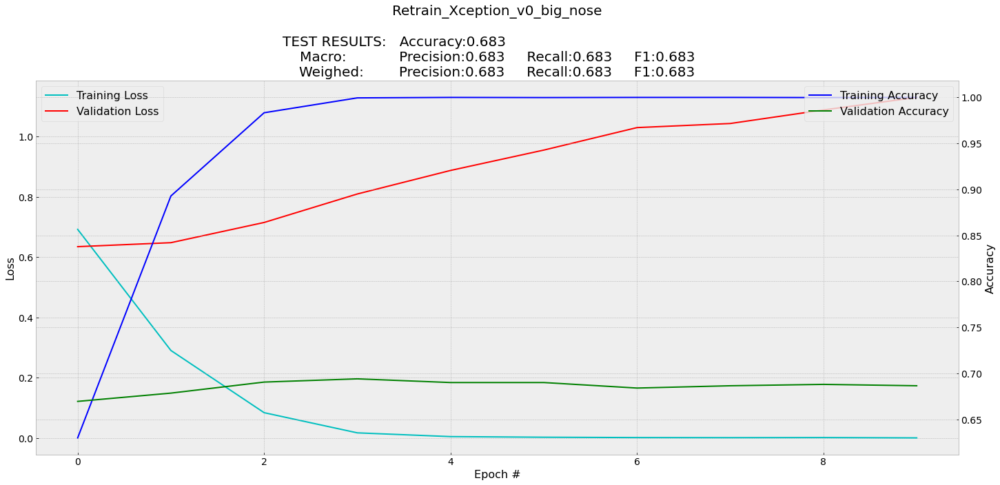

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.675625
True: 0.68575
False: 0.6655

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_9[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 69s 1s/step - loss: 1.0436 - accuracy: 0.4823 - val_loss: 0.7195 - val_accuracy: 0.6000
Epoch 2/10
47/47 [==============================] - 63s 1s/step - loss: 0.7002 - accuracy: 0.6577 - val_loss: 0.6907 - val_accuracy: 0.6380
Epoch 3/10
47/47 [==============================] - 63s 1s/step - loss: 0.5837 - accuracy: 0.7357 - val_loss: 0.6747 - val_accuracy: 0.6645
Epoch 4/10
47/47 [==============================] - 63s 1s/step - loss: 0.5121 - accuracy: 0.7800 - val_loss: 0.6529 - val_accuracy: 0.6720
Epoch 5/10
47/47 [==============================] - 63s 1s/step - loss: 0.4537 - accuracy: 0.8183 - val_loss: 0.6364 - val_accuracy: 0.6765
Epoch 6/10
47/47 [==============================] - 63s 1s/step - loss: 0.4024 - accuracy: 0.8502 - val_loss: 0.6297 - val_accuracy: 0.6815
Epoch 7/10
47/47 [==============================] - 63s 1s/step - loss: 0.3514 - accuracy: 0.8843 - val_loss: 0.6327 - val_accuracy: 0.6815
Epoch 8/10
47/47 [==

20185

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.675625
True: 0.68575
False: 0.6655
              precision    recall  f1-score   support

           0       0.67      0.69      0.68      4000
           1       0.68      0.67      0.67      4000

    accuracy                           0.68      8000
   macro avg       0.68      0.68      0.68      8000
weighted avg       0.68      0.68      0.68      8000



#### Gráfico de entrenamiento

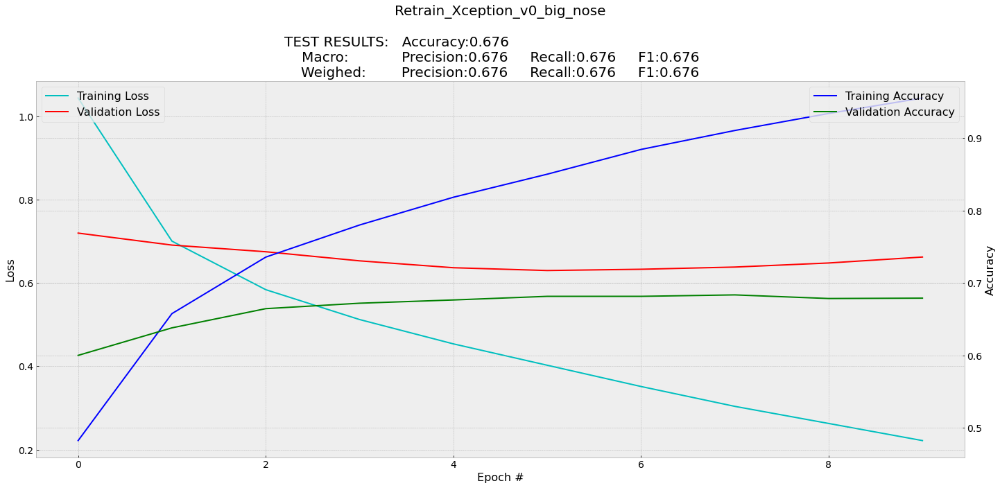

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.6715
True: 0.6595
False: 0.6835

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

83697664/83683744 [==============================] - 1s 0us/step
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_2[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
___________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=25, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/25
47/47 [==============================] - 78s 1s/step - loss: 1.0157 - accuracy: 0.4923 - val_loss: 0.7471 - val_accuracy: 0.5920
Epoch 2/25
47/47 [==============================] - 64s 1s/step - loss: 0.6853 - accuracy: 0.6608 - val_loss: 0.7063 - val_accuracy: 0.6405
Epoch 3/25
47/47 [==============================] - 64s 1s/step - loss: 0.5780 - accuracy: 0.7290 - val_loss: 0.6863 - val_accuracy: 0.6505
Epoch 4/25
47/47 [==============================] - 64s 1s/step - loss: 0.5092 - accuracy: 0.7768 - val_loss: 0.6617 - val_accuracy: 0.6530
Epoch 5/25
47/47 [==============================] - 64s 1s/step - loss: 0.4518 - accuracy: 0.8160 - val_loss: 0.6466 - val_accuracy: 0.6580
Epoch 6/25
47/47 [==============================] - 64s 1s/step - loss: 0.3972 - accuracy: 0.8500 - val_loss: 0.6425 - val_accuracy: 0.6610
Epoch 7/25
47/47 [==============================] - 64s 1s/step - loss: 0.3515 - accuracy: 0.8775 - val_loss: 0.6438 - val_accuracy: 0.6615
Epoch 8/25
47/47 [==

1625

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.6715
True: 0.6595
False: 0.6835
              precision    recall  f1-score   support

           0       0.68      0.66      0.67      4000
           1       0.67      0.68      0.68      4000

    accuracy                           0.67      8000
   macro avg       0.67      0.67      0.67      8000
weighted avg       0.67      0.67      0.67      8000



#### Gráfico de entrenamiento

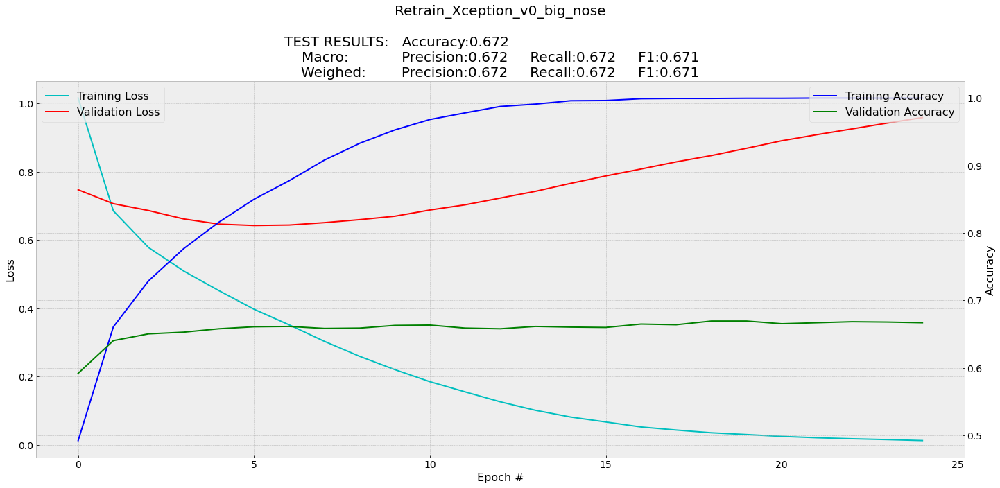

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.673
True: 0.67
False: 0.676

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_10"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_11 (InputLayer)           [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_11[0][0]                   
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
___________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 70s 1s/step - loss: 0.9947 - accuracy: 0.5275 - val_loss: 0.7265 - val_accuracy: 0.5945
Epoch 2/20
47/47 [==============================] - 63s 1s/step - loss: 0.6830 - accuracy: 0.6738 - val_loss: 0.6849 - val_accuracy: 0.6305
Epoch 3/20
47/47 [==============================] - 63s 1s/step - loss: 0.5761 - accuracy: 0.7303 - val_loss: 0.6740 - val_accuracy: 0.6365
Epoch 4/20
47/47 [==============================] - 63s 1s/step - loss: 0.5046 - accuracy: 0.7812 - val_loss: 0.6509 - val_accuracy: 0.6540
Epoch 5/20
47/47 [==============================] - 63s 1s/step - loss: 0.4474 - accuracy: 0.8163 - val_loss: 0.6384 - val_accuracy: 0.6640
Epoch 6/20
47/47 [==============================] - 63s 1s/step - loss: 0.3974 - accuracy: 0.8487 - val_loss: 0.6357 - val_accuracy: 0.6670
Epoch 7/20
47/47 [==============================] - 63s 1s/step - loss: 0.3483 - accuracy: 0.8823 - val_loss: 0.6386 - val_accuracy: 0.6705
Epoch 8/20
47/47 [==

20186

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.673
True: 0.67
False: 0.676
              precision    recall  f1-score   support

           0       0.67      0.67      0.67      4000
           1       0.67      0.68      0.67      4000

    accuracy                           0.67      8000
   macro avg       0.67      0.67      0.67      8000
weighted avg       0.67      0.67      0.67      8000



#### Gráfico de entrenamiento

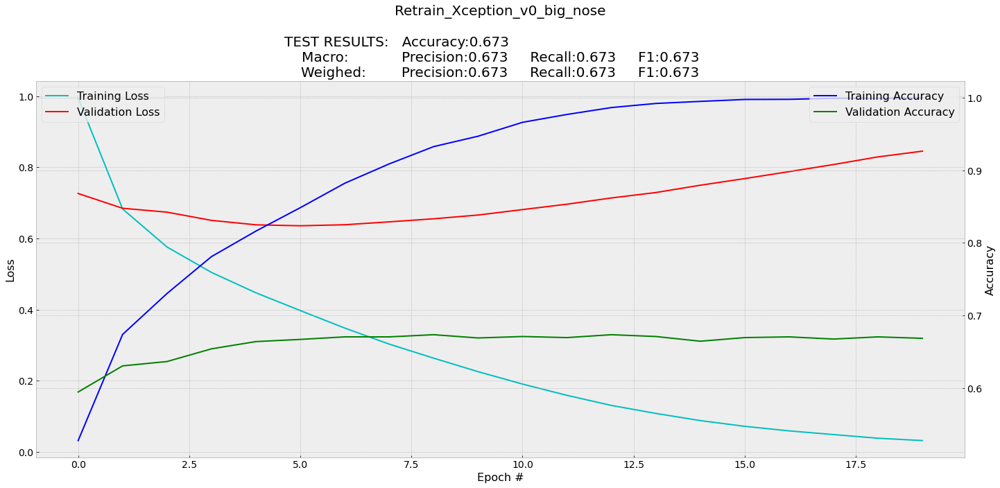

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.681875
True: 0.674
False: 0.68975

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_10 (InputLayer)           [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_10[0][0]                   
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 70s 1s/step - loss: 0.7405 - accuracy: 0.6142 - val_loss: 0.6411 - val_accuracy: 0.6750
Epoch 2/10
47/47 [==============================] - 63s 1s/step - loss: 0.4060 - accuracy: 0.8257 - val_loss: 0.6287 - val_accuracy: 0.6840
Epoch 3/10
47/47 [==============================] - 63s 1s/step - loss: 0.2267 - accuracy: 0.9353 - val_loss: 0.6517 - val_accuracy: 0.6760
Epoch 4/10
47/47 [==============================] - 63s 1s/step - loss: 0.1018 - accuracy: 0.9860 - val_loss: 0.7087 - val_accuracy: 0.6785
Epoch 5/10
47/47 [==============================] - 63s 1s/step - loss: 0.0398 - accuracy: 0.9982 - val_loss: 0.7817 - val_accuracy: 0.6825
Epoch 6/10
47/47 [==============================] - 63s 1s/step - loss: 0.0173 - accuracy: 0.9997 - val_loss: 0.8668 - val_accuracy: 0.6755
Epoch 7/10
47/47 [==============================] - 63s 1s/step - loss: 0.0087 - accuracy: 1.0000 - val_loss: 0.9350 - val_accuracy: 0.6785
Epoch 8/10
47/47 [==

20186

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.681875
True: 0.674
False: 0.68975
              precision    recall  f1-score   support

           0       0.68      0.67      0.68      4000
           1       0.68      0.69      0.68      4000

    accuracy                           0.68      8000
   macro avg       0.68      0.68      0.68      8000
weighted avg       0.68      0.68      0.68      8000



#### Gráfico de entrenamiento

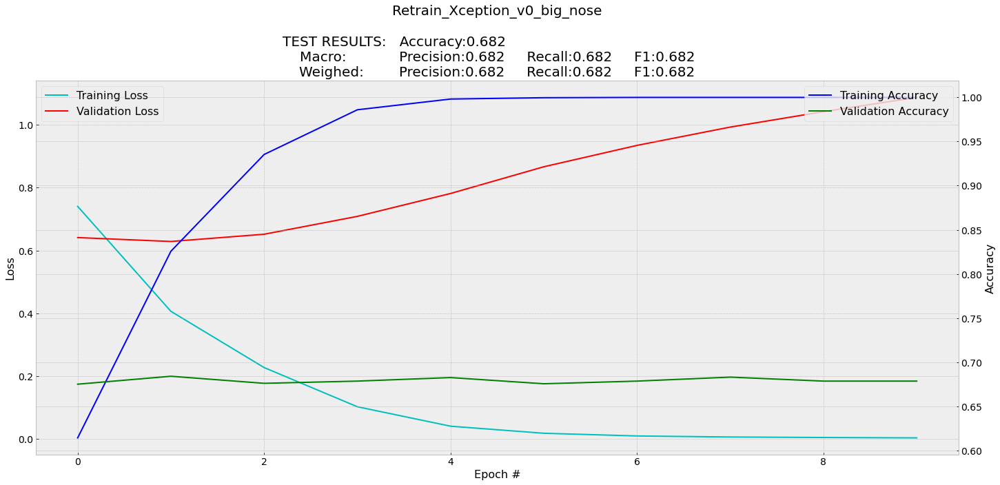

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

# Etiquetas Celeba: "hair color"

## Proceso

### CLIP crear "prompt" y preparar parámetros

In [ ]:
import torch
import clip
from PIL import Image
import glob

Name_feature='_hair_color'
id_feature=[8,9,11,17,11,8,9,11,17,11,8,9,11,17,11]
Save_Data_Path=BASE_FOLDER_2+'Retrain_v0'+Name_feature+'.pkl'

Index_To_Test=[]
Label_To_Test=[]
Data_To_Train=[]
Label_To_Train=[]
Data = {'Training':{}, 'Model Name':{}, 'H':{}, 'Classes':{}}
Data['Training']={'Images':{},'Images array':{}, 'Classes':{}, 'Classes array':{}, 'Index':{}, 'H':{}}
Data['Training']['Images']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Images array']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes array']={'Train':{}, 'Validate':{}}

clip_tokens=[ 'A picture of a person', 'A picture of a black-haired person', 'A picture of a blond-haired person',
            'A picture of a tawny-haired person', 'A picture of a gray-haired person', 'A picture of a brown-haired person',
            'A picture of a person who is black-haired', 'A picture of a person who is blond-haired',
            'A picture of a person who is tawny-haired', 'A picture of a person who is gray-haired', 'A picture of a person who is brown-haired',
            'A picture of a person with black hair', 'A picture of a person with blond hair',
            'A picture of a person with tawny hair', 'A picture of a person with gray hair', 'A picture of a person with brown hair']



N_Tokens=len(clip_tokens)
print(N_Tokens)
print(clip_tokens)
for current_token in clip_tokens:
    print(current_token)

# [ 'A picture of a person',"A picture of a person with 5 o'clock shadow",'A picture of a person with arched eyebrows',
# 'A picture of an attractive person','A picture of a person with bags under eyes',
# 'A picture of a bald person','A picture of a person with bangs','A picture of a person with big lips',
# 'A picture of a person with big nose','A picture of a person with black hair',
# 'A picture of a person with blond hair','A blurry picture of a person',
# 'A picture of a person with brown hair','A picture of a person with bushy eyebrows',
# 'A picture of a chubby person','A picture of a person with double chin','A picture of a person with eyeglasses',
# 'A picture of a person with goatee','A picture of a person with gray hair','A picture of a person with heavy makeup',
# 'A picture of a person with high cheekbones','A picture of a male person',
# 'A picture of a person with mouth slightly open','A picture of a person with mustache',
# 'A picture of a person with narrow eyes','A picture of a person with no beard',
# 'A picture of a person with oval face','A picture of a person with pale skin','A picture of a person with pointy nose',
# 'A picture of a person with receding hairline','A picture of a person with rosy cheeks','A picture of a person with sideburns',
# 'A picture of a person who is smiling','A picture of a person with straight hair','A picture of a person with wavy hair',
# 'A picture of a person with earrings','A picture of a person with hat','A picture of a person with lipstick',
# 'A picture of a person with necklace','A picture of a person with necktie','A picture of a young person']

16
['A picture of a person', 'A picture of a black-haired person', 'A picture of a blond-haired person', 'A picture of a tawny-haired person', 'A picture of a gray-haired person', 'A picture of a brown-haired person', 'A picture of a person who is black-haired', 'A picture of a person who is blond-haired', 'A picture of a person who is tawny-haired', 'A picture of a person who is gray-haired', 'A picture of a person who is brown-haired', 'A picture of a person with black hair', 'A picture of a person with blond hair', 'A picture of a person with tawny hair', 'A picture of a person with gray hair', 'A picture of a person with brown hair']
A picture of a person
A picture of a black-haired person
A picture of a blond-haired person
A picture of a tawny-haired person
A picture of a gray-haired person
A picture of a brown-haired person
A picture of a person who is black-haired
A picture of a person who is blond-haired
A picture of a person who is tawny-haired
A picture of a person who is gra

### Cargar CLIP

In [ ]:
clip_device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, clip_transform = clip.load("ViT-B/32", device=clip_device)
clip_text = clip.tokenize(clip_tokens).to(clip_device)

# CLIP features
text_features = clip_model.encode_text(clip_text)

test_index=1
test_image_path=Path_images+str(test_index).zfill(6)+'.jpg'
img_proeprocessed = clip_transform(Image.open(test_image_path)).unsqueeze(0).to(clip_device)
img_features = clip_model.encode_image(img_proeprocessed)
img_features_shape= img_features.shape

print('\n- Image Features:')
print('     Type:',type(img_features))
print('     Shape:',img_features_shape)
print('\n- Text Features:')
print('     Type:',type(text_features))
print('     Shape:',text_features.shape)
print('\n- Image Features Tensor:')
print(img_features)
print('\n- Text Features Tesor:')
print(text_features)


- Image Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([1, 512])

- Text Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([16, 512])

- Image Features Tensor:
tensor([[-6.0404e-02,  1.7240e-02, -9.9850e-02,  2.3513e-01, -6.8890e-02,
         -8.4871e-01, -3.7039e-01, -4.8284e-01, -3.2268e-02, -3.9296e-02,
         -5.1600e-02, -1.9830e-01,  6.2027e-01, -5.4041e-02,  7.4352e-01,
          4.5765e-02,  1.5815e+00, -4.6115e-01,  1.3545e-01, -1.4627e-01,
         -3.7019e-01, -3.7086e-01, -4.6507e-01, -2.8898e-01, -1.7615e-01,
         -1.3906e-01,  2.9042e-01, -9.5162e-02,  3.9787e-01,  1.3850e-01,
          5.1834e-01,  1.5671e-01,  8.8045e-02, -1.0247e-02, -9.4437e-01,
          2.2662e-01, -3.5586e-02,  4.6863e-01,  9.3730e-02,  1.5896e+00,
          2.1631e-01,  1.9313e-01, -5.4020e-02, -7.5199e-02, -7.1617e-03,
          1.4450e+00,  1.2884e-01,  5.3698e-01,  4.5629e-01,  3.9521e-01,
          1.7347e-01,  1.6259e-01, -3.0306e-02, -2.5555e-01, -

### Seleccionar indices a usar del Dataset Celeba

In [ ]:
# encontrar indices man_woman true/false
Index_Features_0=[]
Index_Features_1=[]
Index_Features_2=[]
Index_Features_3=[]

i=0
for descripton in Description_data:
    i=i+1
    if descripton[id_feature[0]] and (not descripton[id_feature[1]]) and (not descripton[id_feature[2]]) and (not descripton[id_feature[3]]) and (not descripton[4]): 
        Index_Features_0.append(i)
    elif descripton[id_feature[1]] and (not descripton[id_feature[0]]) and (not descripton[id_feature[2]]) and (not descripton[id_feature[3]]) and (not descripton[4]):
        Index_Features_1.append(i)
    elif descripton[id_feature[2]] and (not descripton[id_feature[1]]) and (not descripton[id_feature[0]]) and (not descripton[id_feature[3]]) and (not descripton[4]):
        Index_Features_2.append(i)
    elif descripton[id_feature[3]] and (not descripton[id_feature[1]]) and (not descripton[id_feature[2]]) and (not descripton[id_feature[0]]) and (not descripton[4]):
        Index_Features_3.append(i)

## Mostrar Results       
min_value=9999999
print('Examples of celeba:')
print(Description_labels[id_feature[0]]+':',len(Index_Features_0))
print(Description_labels[id_feature[1]]+':',len(Index_Features_1))  
print(Description_labels[id_feature[2]]+':',len(Index_Features_2))
print(Description_labels[id_feature[3]]+':',len(Index_Features_3))  

# Smiling -  True: 97669
# Smiling - False: 104930

Examples of celeba:
Black_Hair: 47264
Blond_Hair: 28251
Brown_Hair: 39165
Gray_Hair: 6828


### Cargar Datos (ejectuar si se dispone del archivo de datos creado)

In [ ]:
## LOAD DATA
file_to_load = open(Save_Data_Path, "rb")
df_loaded = pickle.load(file_to_load)
file_to_load.close()

Data=df_loaded['Data']
Index_To_Test=df_loaded['Index_To_Test']
Label_To_Test=df_loaded['Label_To_Test']
Data_To_Train=df_loaded['Data_To_Train']
Label_To_Train=df_loaded['Label_To_Train']

### Preparar datos (ejectuar solo si no se dispone del archivo de datos creado)

In [ ]:
def Preprocess_img(images_id,clip_device,clip_model,clip_preprocess,clip_text):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    probs=CLIP_get_probs_only(test_image_path, clip_text, clip_model, clip_preprocess, clip_device)
    return clip_model.encode_image(clip_img).detach().numpy(), np.array(img_current), probs

def Preprocess_img2(images_id,clip_device,clip_model,clip_preprocess):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    return clip_model.encode_image(clip_img).detach().numpy(), np.array(img_current)

Data['Training']['Images']['Test']=[]
Data['Training']['Images']['Not Test']=[]
Data['Training']['Classes']['Test']=[]
Data['Training']['Classes']['Not Test']=[]
Data['Training']['Images array']['Test']=[]
Data['Training']['Images array']['Not Test']=[]

Data['Prediccion_Probs']=np.zeros((16000,N_Tokens))
n=0
for i in range(2000):
    Index_To_Test.append(Index_Features_0[i])
    Label_To_Test.append(clip_tokens[1])
    img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_0[i],clip_device,clip_model,clip_transform,clip_text)
    Data['Training']['Images']['Test'].append(img)
    Data['Training']['Images array']['Test'].append(img_arr)
    Data['Training']['Classes']['Test'].append(0)
    n+=1
    Index_To_Test.append(Index_Features_1[i])
    Label_To_Test.append(clip_tokens[2])
    img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_1[i],clip_device,clip_model,clip_transform,clip_text)
    Data['Training']['Images']['Test'].append(img)
    Data['Training']['Images array']['Test'].append(img_arr)
    Data['Training']['Classes']['Test'].append(1)
    n+=1
    Index_To_Test.append(Index_Features_2[i])
    Label_To_Test.append(clip_tokens[3])
    img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_2[i],clip_device,clip_model,clip_transform,clip_text)
    Data['Training']['Images']['Test'].append(img)
    Data['Training']['Images array']['Test'].append(img_arr)
    Data['Training']['Classes']['Test'].append(2)
    n+=1
    Index_To_Test.append(Index_Features_3[i])
    Label_To_Test.append(clip_tokens[4])
    img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_3[i],clip_device,clip_model,clip_transform,clip_text)
    Data['Training']['Images']['Test'].append(img)
    Data['Training']['Images array']['Test'].append(img_arr)
    Data['Training']['Classes']['Test'].append(3)
    n+=1

    if i % 200 == 0 and i>0:
        print('Test images load (%):',i/20)
        
        df_to_save= {'Data': Data,
                      'Index_To_Test':Index_To_Test,
                      'Label_To_Test':Label_To_Test,
                      'Data_To_Train':Data_To_Train,
                      'Label_To_Train':Label_To_Train
        }
        save_df_to_file(df_to_save,Save_Data_Path)

    gc.collect() 
    
for i in range(2000,4000):
    Data_To_Train.append(Index_Features_0[i])
    Label_To_Train.append(clip_tokens[1])
    img, img_arr=Preprocess_img2(Index_Features_0[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Not Test'].append(img)
    Data['Training']['Images array']['Not Test'].append(img_arr)
    Data['Training']['Classes']['Not Test'].append(0)

    Data_To_Train.append(Index_Features_1[i])
    Label_To_Train.append(clip_tokens[2])
    img, img_arr=Preprocess_img2(Index_Features_1[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Not Test'].append(img)
    Data['Training']['Images array']['Not Test'].append(img_arr)
    Data['Training']['Classes']['Not Test'].append(1)

    Data_To_Train.append(Index_Features_2[i])
    Label_To_Train.append(clip_tokens[3])
    img, img_arr=Preprocess_img2(Index_Features_2[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Not Test'].append(img)
    Data['Training']['Images array']['Not Test'].append(img_arr)
    Data['Training']['Classes']['Not Test'].append(2)

    Data_To_Train.append(Index_Features_3[i])
    Label_To_Train.append(clip_tokens[4])
    img, img_arr=Preprocess_img2(Index_Features_3[i],clip_device,clip_model,clip_transform)
    Data['Training']['Images']['Not Test'].append(img)
    Data['Training']['Images array']['Not Test'].append(img_arr)
    Data['Training']['Classes']['Not Test'].append(3)

    if i % 200 == 0 and i>2000:
        print('Train images load (%):',(i-2000)/20)
        df_to_save= {'Data': Data,
                      'Index_To_Test':Index_To_Test,
                      'Label_To_Test':Label_To_Test,
                      'Data_To_Train':Data_To_Train,
                      'Label_To_Train':Label_To_Train
        }
        save_df_to_file(df_to_save,Save_Data_Path)
    # gc.collect()

Data['Classes']=[]
for element in np.unique(Data['Training']['Classes']['Test']):
    Data['Classes'].append(np.int(element))

Data['Training']['Images']['Train'], Data['Training']['Images']['Validate'], Data['Training']['Classes']['Train'], Data['Training']['Classes']['Validate'] = train_test_split(Data['Training']['Images']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)
Data['Training']['Images array']['Train'], Data['Training']['Images array']['Validate'], Data['Training']['Classes array']['Train'], Data['Training']['Classes array']['Validate'] = train_test_split(Data['Training']['Images array']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)

df_to_save= {'Data': Data,
              'Index_To_Test':Index_To_Test,
              'Label_To_Test':Label_To_Test,
              'Data_To_Train':Data_To_Train,
              'Label_To_Train':Label_To_Train
}
save_df_to_file(df_to_save,Save_Data_Path)

## Visualizar número de entrenamiento
print('NÚMERO DE DATOS PARA ENTRENAR/TEST')
print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Not Test']),'con',len(np.unique(Data['Training']['Classes']['Test'])),'clases')
print('Número de datos para Test:',  len(Data['Training']['Classes']['Test']),'con',len(np.unique(Data['Training']['Classes']['Not Test'])),'clases')

## Visualizar número de entrenamiento
print('\nNÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN')
print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Train']),'con',len(np.unique(Data['Training']['Classes']['Train'])),'clases')
print('Número de datos para Validación:',  len(Data['Training']['Classes']['Validate']),'con',len(np.unique(Data['Training']['Classes']['Validate'])),'clases')


Test images load (%): 10.0
Test images load (%): 20.0
Test images load (%): 30.0
Test images load (%): 40.0
Test images load (%): 50.0
Test images load (%): 60.0
Test images load (%): 70.0
Test images load (%): 80.0
Test images load (%): 90.0
Train images load (%): 10.0
Train images load (%): 20.0
Train images load (%): 30.0
Train images load (%): 40.0
Train images load (%): 50.0
Train images load (%): 60.0
Train images load (%): 70.0
Train images load (%): 80.0
Train images load (%): 90.0
NÚMERO DE DATOS PARA ENTRENAR/TEST
Número de datos para Entrenamiento: 8000 con 4 clases
Número de datos para Test: 8000 con 4 clases

NÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN
Número de datos para Entrenamiento: 6000 con 4 clases
Número de datos para Validación: 2000 con 4 clases


## CLIP prompts

##### Calcular tokens celeba

In [ ]:
Prediccion_Probs=Data['Prediccion_Probs']

N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(15)
Precision_False=np.zeros(15)
Precision_All=np.zeros(15)

for i in range(15):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 4 == 0:
        for k in [0,5,10]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [1,2,3,4,6,7,8,9,11,12,13,14]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    elif i % 4 == 1:
        for k in [1,6,11]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1
        for k in [0,2,3,4,5,7,8,9,10,12,13,14]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    elif i % 4 == 2:
        for k in [2,4,7,9,12,14]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [0,1,3,5,6,8,10,11,13]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    else:
        for k in [3,8,13]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [0,1,2,4,5,6,7,9,10,11,12,14]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/2000,2)
Precision_percent_False=np.round(100*Precision_False/6000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

In [ ]:
print('\nResultasdos de 8000 imagenes probadas:')
for i in range(15):
    print('\n',clip_tokens[i+1])
    print(' True:',Precision_percent_True[i],Precision_True[i])
    print('False:',Precision_percent_False[i],Precision_False[i])
    print('  All:',Precision_percent_All[i],Precision_All[i])


Resultasdos de 8000 imagenes probadas:

 A picture of a black-haired person
 True: 76.9 1538.0
False: 74.58 4475.0
  All: 75.16 6013.0

 A picture of a blond-haired person
 True: 98.9 1978.0
False: 69.47 4168.0
  All: 76.82 6146.0

 A picture of a tawny-haired person
 True: 89.4 1788.0
False: 38.2 2292.0
  All: 51.0 4080.0

 A picture of a gray-haired person
 True: 72.1 1442.0
False: 92.67 5560.0
  All: 87.52 7002.0

 A picture of a brown-haired person
 True: 94.0 1880.0
False: 33.77 2026.0
  All: 48.82 3906.0

 A picture of a person who is black-haired
 True: 89.45 1789.0
False: 54.9 3294.0
  All: 63.54 5083.0

 A picture of a person who is blond-haired
 True: 99.5 1990.0
False: 44.3 2658.0
  All: 58.1 4648.0

 A picture of a person who is tawny-haired
 True: 92.65 1853.0
False: 29.4 1764.0
  All: 45.21 3617.0

 A picture of a person who is gray-haired
 True: 86.35 1727.0
False: 71.15 4269.0
  All: 74.95 5996.0

 A picture of a person who is brown-haired
 True: 97.8 1956.0
False: 17.

##### Mostrar resultados celeba

In [ ]:
## Resulrts
celeba_labels=[8,9,11,17,11,8,9,11,17,11,8,9,11,17,11]
dataframe_array=[]
for i in range(15):
    dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])

dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(15)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref.csv",';')
print(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref.csv")

,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Black_Hair,A picture of a black-haired person,76.9,74.58,75.16
1,Blond_Hair,A picture of a blond-haired person,98.9,69.47,76.82
2,Brown_Hair,A picture of a tawny-haired person,89.4,38.2,51.0
3,Gray_Hair,A picture of a gray-haired person,72.1,92.67,87.52
4,Brown_Hair,A picture of a brown-haired person,94.0,33.77,48.82
5,Black_Hair,A picture of a person who is black-haired,89.45,54.9,63.54
6,Blond_Hair,A picture of a person who is blond-haired,99.5,44.3,58.1
7,Brown_Hair,A picture of a person who is tawny-haired,92.65,29.4,45.21
8,Gray_Hair,A picture of a person who is gray-haired,86.35,71.15,74.95
9,Brown_Hair,A picture of a person who is brown-haired,97.8,17.57,37.62


/content/drive/My Drive/Colab Notebooks/CLIP__hair_color2_vs_ref.csv


##### Calacular tokens extra

In [ ]:
Precision_extra_True=np.zeros(1000).astype(int)
Precision_extra_False=np.zeros(1000).astype(int)
Precision_extra_All=np.zeros(1000).astype(int)
Original_reference=np.zeros(1000).astype(int)
Precision_extra_tokens=[]
for i in range(1000):
    Precision_extra_tokens.append([])



for j in range(len(Index_To_Test)):
    i=0


# 0 A picture of a person
# 1 A picture of a black-haired person
# 2 A picture of a blond-haired person
# 3 A picture of a tawny-haired person
# 4 A picture of a gray-haired person
# 5 A picture of a brown-haired person
# 6 A picture of a person who is black-haired
# 7 A picture of a person who is blond-haired
# 8 A picture of a person who is tawny-haired
# 9 A picture of a person who is gray-haired
# 10 A picture of a person who is brown-haired
# 11 A picture of a person with black hair
# 12 A picture of a person with blond hair
# 13 A picture of a person with tawny hair
# 14 A picture of a person with gray hair
# 15 A picture of a person with brown hair

    ## black 1
    k1=1
    k2=2
    k3=3
    k4=4
    k5=5
    Original_reference[i]=0  
    Precision_extra_tokens[i]=[k1,k2,k3,k4]
    current_result=Prediccion_Probs[j,k1]>np.max(Prediccion_Probs[j,[k2,k3,k4]])
    if j % 4 == 0:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## blond 1
    Original_reference[i]=1  
    Precision_extra_tokens[i]=[k2,k1,k3,k4]
    current_result=Prediccion_Probs[j,k2]>np.max(Prediccion_Probs[j,[k,k3,k4]])
    if j % 4 == 1:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## brown 1
    Original_reference[i]=2  
    Precision_extra_tokens[i]=[k3,k1,k2,k4]
    current_result=Prediccion_Probs[j,k3]>np.max(Prediccion_Probs[j,[k1,k2,k4]])
    if j % 4 == 2:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## gray 1
    Original_reference[i]=3  
    Precision_extra_tokens[i]=[k4,k1,k2,k3]
    current_result=Prediccion_Probs[j,k4]>np.max(Prediccion_Probs[j,[k1,k2,k3]])
    if j % 4 == 3:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## black 1b
    Original_reference[i]=0  
    Precision_extra_tokens[i]=[k1,k2,k5,k4]
    current_result=Prediccion_Probs[j,k1]>np.max(Prediccion_Probs[j,[k2,k5,k4]])
    if j % 4 == 0:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## blond 1b
    Original_reference[i]=1  
    Precision_extra_tokens[i]=[k2,k1,k5,k4]
    current_result=Prediccion_Probs[j,k2]>np.max(Prediccion_Probs[j,[k1,k5,k4]])
    if j % 4 == 1:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## brown 1b
    Original_reference[i]=2  
    Precision_extra_tokens[i]=[k5,k1,k2,k4]
    current_result=Prediccion_Probs[j,k5]>np.max(Prediccion_Probs[j,[k1,k2,k4]])
    if j % 4 == 2:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## gray 1b
    Original_reference[i]=3  
    Precision_extra_tokens[i]=[k4,k1,k2,k5]
    current_result=Prediccion_Probs[j,k4]>np.max(Prediccion_Probs[j,[k1,k2,k5]])
    if j % 4 == 3:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## black 2
    k1+=5
    k2+=5
    k3+=5
    k4+=5
    k5+=5
    Original_reference[i]=0  
    Precision_extra_tokens[i]=[k1,k2,k3,k4]
    current_result=Prediccion_Probs[j,k1]>np.max(Prediccion_Probs[j,[k2,k3,k4]])
    if j % 4 == 0:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## blond 2
    Original_reference[i]=1  
    Precision_extra_tokens[i]=[k2,k1,k3,k4]
    current_result=Prediccion_Probs[j,k2]>np.max(Prediccion_Probs[j,[k,k3,k4]])
    if j % 4 == 1:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## brown 2
    Original_reference[i]=2  
    Precision_extra_tokens[i]=[k3,k1,k2,k4]
    current_result=Prediccion_Probs[j,k3]>np.max(Prediccion_Probs[j,[k1,k2,k4]])
    if j % 4 == 2:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## gray 2
    Original_reference[i]=3  
    Precision_extra_tokens[i]=[k4,k1,k2,k3]
    current_result=Prediccion_Probs[j,k4]>np.max(Prediccion_Probs[j,[k1,k2,k3]])
    if j % 4 == 3:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## black 2b
    Original_reference[i]=0  
    Precision_extra_tokens[i]=[k1,k2,k5,k4]
    current_result=Prediccion_Probs[j,k1]>np.max(Prediccion_Probs[j,[k2,k5,k4]])
    if j % 4 == 0:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## blond 2b
    Original_reference[i]=1  
    Precision_extra_tokens[i]=[k2,k1,k5,k4]
    current_result=Prediccion_Probs[j,k2]>np.max(Prediccion_Probs[j,[k1,k5,k4]])
    if j % 4 == 1:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## brown 2b
    Original_reference[i]=2  
    Precision_extra_tokens[i]=[k5,k1,k2,k4]
    current_result=Prediccion_Probs[j,k5]>np.max(Prediccion_Probs[j,[k1,k2,k4]])
    if j % 4 == 2:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## gray 2b
    Original_reference[i]=3  
    Precision_extra_tokens[i]=[k4,k1,k2,k5]
    current_result=Prediccion_Probs[j,k4]>np.max(Prediccion_Probs[j,[k1,k2,k5]])
    if j % 4 == 3:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## black 3
    k1+=5
    k2+=5
    k3+=5
    k4+=5
    k5+=5
    Original_reference[i]=0  
    Precision_extra_tokens[i]=[k1,k2,k3,k4]
    current_result=Prediccion_Probs[j,k1]>np.max(Prediccion_Probs[j,[k2,k3,k4]])
    if j % 4 == 0:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## blond 3
    Original_reference[i]=1  
    Precision_extra_tokens[i]=[k2,k1,k3,k4]
    current_result=Prediccion_Probs[j,k2]>np.max(Prediccion_Probs[j,[k,k3,k4]])
    if j % 4 == 1:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## brown 3
    Original_reference[i]=2  
    Precision_extra_tokens[i]=[k3,k1,k2,k4]
    current_result=Prediccion_Probs[j,k3]>np.max(Prediccion_Probs[j,[k1,k2,k4]])
    if j % 4 == 2:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## gray 3
    Original_reference[i]=3  
    Precision_extra_tokens[i]=[k4,k1,k2,k3]
    current_result=Prediccion_Probs[j,k4]>np.max(Prediccion_Probs[j,[k1,k2,k3]])
    if j % 4 == 3:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## black 3b
    Original_reference[i]=0  
    Precision_extra_tokens[i]=[k1,k2,k5,k4]
    current_result=Prediccion_Probs[j,k1]>np.max(Prediccion_Probs[j,[k2,k5,k4]])
    if j % 4 == 0:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## blond 3b
    Original_reference[i]=1  
    Precision_extra_tokens[i]=[k2,k1,k5,k4]
    current_result=Prediccion_Probs[j,k2]>np.max(Prediccion_Probs[j,[k1,k5,k4]])
    if j % 4 == 1:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## brown 3b
    Original_reference[i]=2  
    Precision_extra_tokens[i]=[k5,k1,k2,k4]
    current_result=Prediccion_Probs[j,k5]>np.max(Prediccion_Probs[j,[k1,k2,k4]])
    if j % 4 == 2:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1

    ## gray 3b
    Original_reference[i]=3  
    Precision_extra_tokens[i]=[k4,k1,k2,k5]
    current_result=Prediccion_Probs[j,k4]>np.max(Prediccion_Probs[j,[k1,k2,k5]])
    if j % 4 == 3:   
        if current_result:
            Precision_extra_True[i]+=1
            Precision_extra_All[i]+=1
    else:
        if not current_result:
            Precision_extra_False[i]+=1
            Precision_extra_All[i]+=1
    i+=1


Precision_extra_True=Precision_extra_True[:i]
Precision_extra_False=Precision_extra_False[:i]
Precision_extra_All=Precision_extra_All[:i]
Original_reference=Original_reference[:i]
for j in range(1000-i):
    Precision_extra_tokens.pop(-1)

# Calcular %
Precision_extra_percent_True=np.round(100*Precision_extra_True/2000,2)
Precision_extra_percent_False=np.round(100*Precision_extra_False/6000,2)
Precision_extra_percent_All=np.round(100*Precision_extra_All/8000,2)

##### Mostrar resultados tokens extra

In [ ]:
Precision_extra_tokens_ref=[]
Precision_extra_tokens_vs=[]
for current_element in Precision_extra_tokens:
    first_element=True
    for current_index in current_element:
        if first_element:
            Precision_extra_tokens_ref.append(clip_tokens[current_index])
            text_to_save=''
            first_element=False
        else:
            text_to_save=text_to_save+clip_tokens[current_index]+', '
    Precision_extra_tokens_vs.append(text_to_save[:-2])


## Resulrts
# celeba_labels=["5 o'clock shadow ",'arched eyebrows','attractive','bags under eyes',
#                   'bald','bangs','big lips','big nose','black hair','blond hair','blurry',
#                   'brown hair','bushy eyebrows','chubby','double chin','eyeglasses',
#                   'goatee','gray hair','heavy makeup','high cheekbones','male',
#                   'mouth slightly open','mustache','narrow eyes','no beard','oval face',
#                   'pale skin','pointy nose','receding hairline','rosy cheeks','sideburns',
#                     'smiling','straight hair','wavy hair','wearing earrings','wearing hat',
#                     'wearing lipstick','wearing necklace','wearing necktie','young']

dataframe_array=[]
for i in range(len(Precision_extra_tokens)):
    dataframe_array.append([Description_labels[id_feature[Original_reference[i]]], 
                          Precision_extra_tokens_ref[i],
                          Precision_extra_tokens_vs[i],
                          Precision_extra_percent_True[i],
                          Precision_extra_percent_False[i],
                          Precision_extra_percent_All[i],
                          Precision_percent_True[Original_reference[i]],
                          Precision_percent_False[Original_reference[i]],
                          Precision_percent_All[Original_reference[i]]
                          ])

dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(len(dataframe_array[:,0]))), 
                            columns=['Celeba dataset feature', 'CLIP textual reference', 'CLIP textual vs' ,'Precision-True', 'Precision-False', 'Precision','Celeba Reference Precision Precision-True', 'Celeba Reference Precision-False', 'Celeba Reference Precision Precision']
                            )
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_multiple.csv",';')

,Celeba dataset feature,CLIP textual reference,CLIP textual vs,Precision-True,Precision-False,Precision,Celeba Reference Precision Precision-True,Celeba Reference Precision-False,Celeba Reference Precision Precision
0,Black_Hair,A picture of a black-haired person,"A picture of a blond-haired person, A picture ...",75.5,92.0,87.88,76.9,74.58,75.16
1,Blond_Hair,A picture of a blond-haired person,"A picture of a black-haired person, A picture ...",88.85,88.3,88.44,98.9,69.47,76.82
2,Brown_Hair,A picture of a tawny-haired person,"A picture of a black-haired person, A picture ...",76.5,83.27,81.58,89.4,38.2,51.0
3,Gray_Hair,A picture of a gray-haired person,"A picture of a black-haired person, A picture ...",54.15,99.28,88.0,72.1,92.67,87.52
4,Black_Hair,A picture of a black-haired person,"A picture of a blond-haired person, A picture ...",60.8,96.25,87.39,76.9,74.58,75.16
5,Blond_Hair,A picture of a blond-haired person,"A picture of a black-haired person, A picture ...",94.05,90.95,91.72,98.9,69.47,76.82
6,Brown_Hair,A picture of a brown-haired person,"A picture of a black-haired person, A picture ...",84.65,75.48,77.78,89.4,38.2,51.0
7,Gray_Hair,A picture of a gray-haired person,"A picture of a black-haired person, A picture ...",47.25,99.57,86.49,72.1,92.67,87.52
8,Black_Hair,A picture of a person who is black-haired,"A picture of a person who is blond-haired, A p...",76.75,92.7,88.71,76.9,74.58,75.16
9,Blond_Hair,A picture of a person who is blond-haired,"A picture of a person who is black-haired, A p...",92.2,80.78,83.64,98.9,69.47,76.82


## Modelos

### CLIP 
all: 0.895875

Black: all 0.949125 true: 0.9065 false: 0.9633333333333334

Blond: all 0.953875 true: 0.8965 false: 0.973

Brown: all 0.9155 true: 0.833 false: 0.943

Gray: all 0.97325 true: 0.9475 false: 0.9818333333333333


#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense (Dense)                (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.1,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 1s 7ms/step - loss: 0.5734 - accuracy: 0.8362 - val_loss: 0.3120 - val_accuracy: 0.8985
Epoch 2/20
47/47 [==============================] - 0s 5ms/step - loss: 0.2956 - accuracy: 0.9017 - val_loss: 0.2801 - val_accuracy: 0.9050
Epoch 3/20
47/47 [==============================] - 0s 5ms/step - loss: 0.2590 - accuracy: 0.9067 - val_loss: 0.2666 - val_accuracy: 0.9065
Epoch 4/20
47/47 [==============================] - 0s 4ms/step - loss: 0.2406 - accuracy: 0.9123 - val_loss: 0.2660 - val_accuracy: 0.9060
Epoch 5/20
47/47 [==============================] - 0s 5ms/step - loss: 0.2314 - accuracy: 0.9162 - val_loss: 0.2604 - val_accuracy: 0.9050
Epoch 6/20
47/47 [==============================] - 0s 5ms/step - loss: 0.2244 - accuracy: 0.9180 - val_loss: 0.2601 - val_accuracy: 0.9045
Epoch 7/20
47/47 [==============================] - 0s 4ms/step - loss: 0.2193 - accuracy: 0.9195 - val_loss: 0.2564 - val_accuracy: 0.9065
Epoch 8/20
47/47 [==

6923

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

all: 0.895875

Black: all 0.949125 true: 0.9065 false: 0.9633333333333334

Blond: all 0.953875 true: 0.8965 false: 0.973

Brown: all 0.9155 true: 0.833 false: 0.943

Gray: all 0.97325 true: 0.9475 false: 0.9818333333333333
              precision    recall  f1-score   support

           0       0.89      0.91      0.90      2000
           1       0.92      0.90      0.91      2000
           2       0.83      0.83      0.83      2000
           3       0.95      0.95      0.95      2000

    accuracy                           0.90      8000
   macro avg       0.90      0.90      0.90      8000
weighted avg       0.90      0.90      0.90      8000



#### Gráfico de entrenamiento

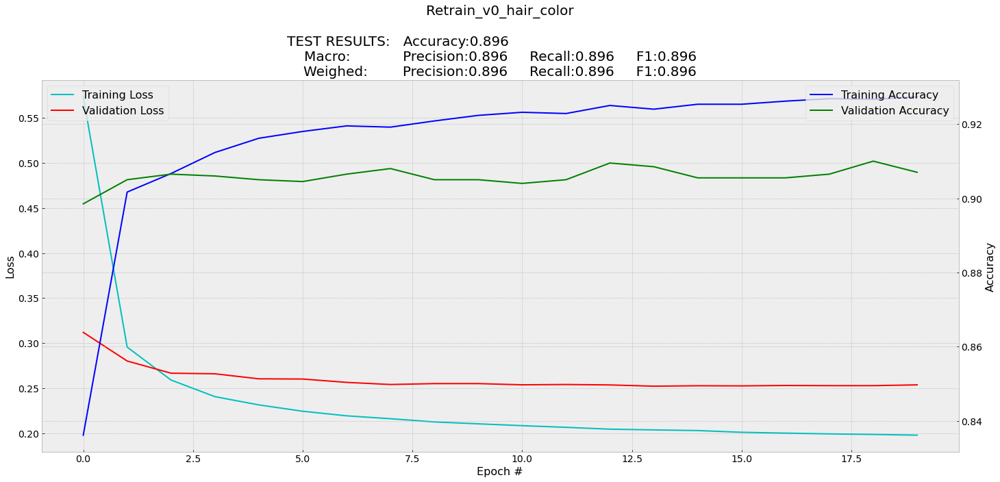

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
all: 0.897875

Black: all 0.951 true: 0.9105 false: 0.9645

Blond: all 0.952875 true: 0.907 false: 0.9681666666666666

Brown: all 0.917625 true: 0.828 false: 0.9475

Gray: all 0.97425 true: 0.946 false: 0.9836666666666667

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.1,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=100, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/100
47/47 [==============================] - 1s 7ms/step - loss: 0.7733 - accuracy: 0.8048 - val_loss: 0.3622 - val_accuracy: 0.8920
Epoch 2/100
47/47 [==============================] - 0s 5ms/step - loss: 0.3247 - accuracy: 0.8988 - val_loss: 0.3141 - val_accuracy: 0.8950
Epoch 3/100
47/47 [==============================] - 0s 5ms/step - loss: 0.2791 - accuracy: 0.9080 - val_loss: 0.2913 - val_accuracy: 0.8975
Epoch 4/100
47/47 [==============================] - 0s 4ms/step - loss: 0.2571 - accuracy: 0.9112 - val_loss: 0.2824 - val_accuracy: 0.9010
Epoch 5/100
47/47 [==============================] - 0s 3ms/step - loss: 0.2438 - accuracy: 0.9153 - val_loss: 0.2817 - val_accuracy: 0.9020
Epoch 6/100
47/47 [==============================] - 0s 4ms/step - loss: 0.2351 - accuracy: 0.9160 - val_loss: 0.2756 - val_accuracy: 0.9005
Epoch 7/100
47/47 [==============================] - 0s 4ms/step - loss: 0.2291 - accuracy: 0.9178 - val_loss: 0.2772 - val_accuracy: 0.8995
Epoch 8/100
4

8180

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

all: 0.897875

Black: all 0.951 true: 0.9105 false: 0.9645

Blond: all 0.952875 true: 0.907 false: 0.9681666666666666

Brown: all 0.917625 true: 0.828 false: 0.9475

Gray: all 0.97425 true: 0.946 false: 0.9836666666666667
              precision    recall  f1-score   support

           0       0.90      0.91      0.90      2000
           1       0.90      0.91      0.91      2000
           2       0.84      0.83      0.83      2000
           3       0.95      0.95      0.95      2000

    accuracy                           0.90      8000
   macro avg       0.90      0.90      0.90      8000
weighted avg       0.90      0.90      0.90      8000



#### Gráfico de entrenamiento

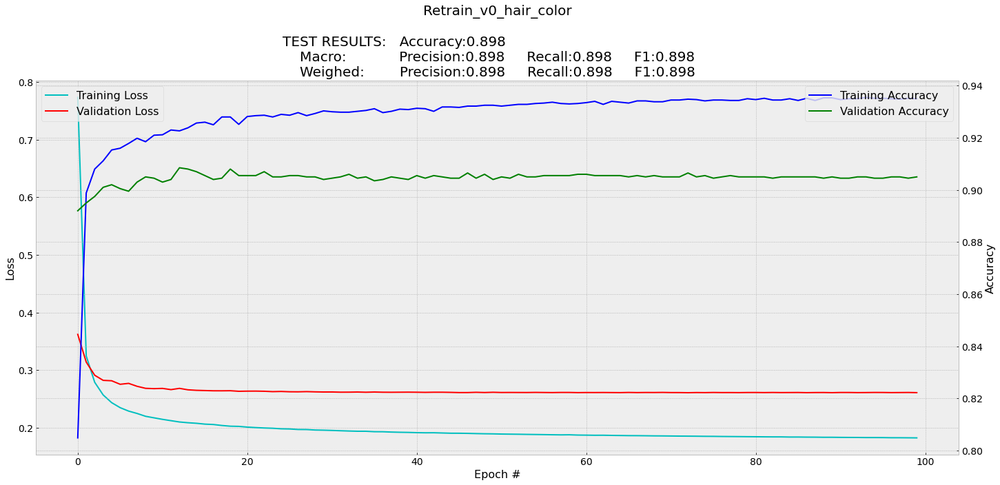

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP
all: 0.423375

Black: all 0.6765 true: 0.386 false: 0.7733333333333333

Blond: all 0.7455 true: 0.608 false: 0.7913333333333333

Brown: all 0.706875 true: 0.065 false: 0.9208333333333333

Gray: all 0.717875 true: 0.6345 false: 0.7456666666666667

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 1s 6ms/step - loss: 1.4220 - accuracy: 0.3307 - val_loss: 1.4276 - val_accuracy: 0.3335
Epoch 2/1000
47/47 [==============================] - 0s 4ms/step - loss: 1.4046 - accuracy: 0.3483 - val_loss: 1.4175 - val_accuracy: 0.3435
Epoch 3/1000
47/47 [==============================] - 0s 3ms/step - loss: 1.3974 - accuracy: 0.3537 - val_loss: 1.4115 - val_accuracy: 0.3475
Epoch 4/1000
47/47 [==============================] - 0s 3ms/step - loss: 1.3926 - accuracy: 0.3573 - val_loss: 1.4072 - val_accuracy: 0.3515
Epoch 5/1000
47/47 [==============================] - 0s 4ms/step - loss: 1.3890 - accuracy: 0.3613 - val_loss: 1.4039 - val_accuracy: 0.3535
Epoch 6/1000
47/47 [==============================] - 0s 3ms/step - loss: 1.3862 - accuracy: 0.3637 - val_loss: 1.4012 - val_accuracy: 0.3545
Epoch 7/1000
47/47 [==============================] - 0s 3ms/step - loss: 1.3838 - accuracy: 0.3665 - val_loss: 1.3989 - val_accuracy: 0.3545
Epoch 

7888

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

all: 0.423375

Black: all 0.6765 true: 0.386 false: 0.7733333333333333

Blond: all 0.7455 true: 0.608 false: 0.7913333333333333

Brown: all 0.706875 true: 0.065 false: 0.9208333333333333

Gray: all 0.717875 true: 0.6345 false: 0.7456666666666667
              precision    recall  f1-score   support

           0       0.36      0.39      0.37      2000
           1       0.49      0.61      0.54      2000
           2       0.21      0.07      0.10      2000
           3       0.45      0.63      0.53      2000

    accuracy                           0.42      8000
   macro avg       0.38      0.42      0.39      8000
weighted avg       0.38      0.42      0.39      8000



#### Gráfico de entrenamiento

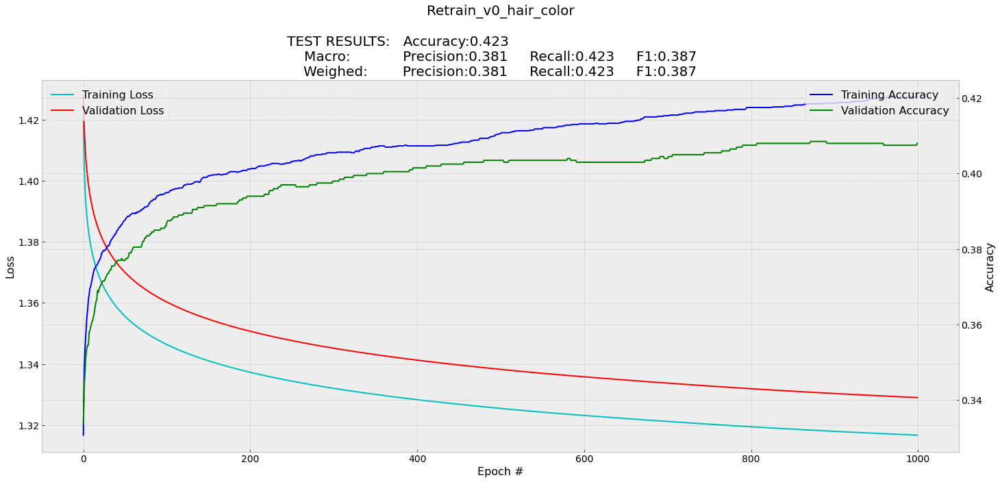

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
all: 0.896625

Black: all 0.94775 true: 0.9105 false: 0.9601666666666666

Blond: all 0.95625 true: 0.9 false: 0.975

Brown: all 0.91525 true: 0.8305 false: 0.9435

Gray: all 0.974 true: 0.9455 false: 0.9835

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_6 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.01,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=100, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/100
47/47 [==============================] - 1s 7ms/step - loss: 0.6230 - accuracy: 0.7975 - val_loss: 0.4413 - val_accuracy: 0.8700
Epoch 2/100
47/47 [==============================] - 0s 5ms/step - loss: 0.4203 - accuracy: 0.8733 - val_loss: 0.3951 - val_accuracy: 0.8810
Epoch 3/100
47/47 [==============================] - 0s 5ms/step - loss: 0.3874 - accuracy: 0.8820 - val_loss: 0.3712 - val_accuracy: 0.8870
Epoch 4/100
47/47 [==============================] - 0s 4ms/step - loss: 0.3687 - accuracy: 0.8867 - val_loss: 0.3580 - val_accuracy: 0.8905
Epoch 5/100
47/47 [==============================] - 0s 5ms/step - loss: 0.3574 - accuracy: 0.8878 - val_loss: 0.3481 - val_accuracy: 0.8925
Epoch 6/100
47/47 [==============================] - 0s 5ms/step - loss: 0.3487 - accuracy: 0.8902 - val_loss: 0.3418 - val_accuracy: 0.8950
Epoch 7/100
47/47 [==============================] - 0s 5ms/step - loss: 0.3423 - accuracy: 0.8908 - val_loss: 0.3365 - val_accuracy: 0.8925
Epoch 8/100
4

8334

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

all: 0.896625

Black: all 0.94775 true: 0.9105 false: 0.9601666666666666

Blond: all 0.95625 true: 0.9 false: 0.975

Brown: all 0.91525 true: 0.8305 false: 0.9435

Gray: all 0.974 true: 0.9455 false: 0.9835
              precision    recall  f1-score   support

           0       0.88      0.91      0.90      2000
           1       0.92      0.90      0.91      2000
           2       0.83      0.83      0.83      2000
           3       0.95      0.95      0.95      2000

    accuracy                           0.90      8000
   macro avg       0.90      0.90      0.90      8000
weighted avg       0.90      0.90      0.90      8000



#### Gráfico de entrenamiento

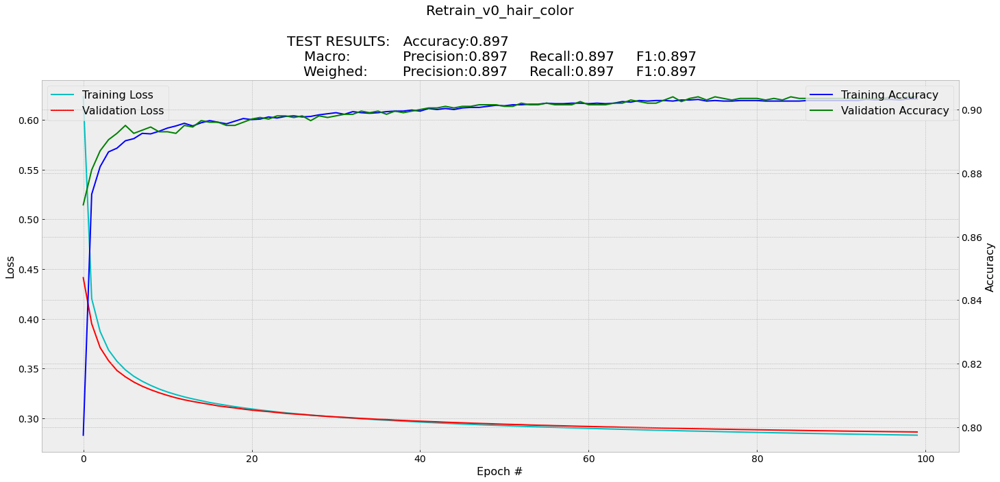

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP
all: 0.809375

Black: all 0.892125 true: 0.786 false: 0.9275

Blond: all 0.927375 true: 0.871 false: 0.9461666666666667

Brown: all 0.851125 true: 0.6495 false: 0.9183333333333333

Gray: all 0.948125 true: 0.931 false: 0.9538333333333333

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten (Flatten)            (None, 512)               0         
_________________________________________________________________
dense (Dense)                (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 1s 7ms/step - loss: 1.3095 - accuracy: 0.4028 - val_loss: 1.2181 - val_accuracy: 0.4945
Epoch 2/1000
47/47 [==============================] - 0s 2ms/step - loss: 1.1864 - accuracy: 0.5335 - val_loss: 1.1569 - val_accuracy: 0.5625
Epoch 3/1000
47/47 [==============================] - 0s 3ms/step - loss: 1.1400 - accuracy: 0.5772 - val_loss: 1.1219 - val_accuracy: 0.5950
Epoch 4/1000
47/47 [==============================] - 0s 3ms/step - loss: 1.1106 - accuracy: 0.6013 - val_loss: 1.0975 - val_accuracy: 0.6140
Epoch 5/1000
47/47 [==============================] - 0s 2ms/step - loss: 1.0891 - accuracy: 0.6188 - val_loss: 1.0788 - val_accuracy: 0.6325
Epoch 6/1000
47/47 [==============================] - 0s 3ms/step - loss: 1.0721 - accuracy: 0.6330 - val_loss: 1.0637 - val_accuracy: 0.6435
Epoch 7/1000
47/47 [==============================] - 0s 2ms/step - loss: 1.0582 - accuracy: 0.6462 - val_loss: 1.0510 - val_accuracy: 0.6555
Epoch 

1621

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

all: 0.809375

Black: all 0.892125 true: 0.786 false: 0.9275

Blond: all 0.927375 true: 0.871 false: 0.9461666666666667

Brown: all 0.851125 true: 0.6495 false: 0.9183333333333333

Gray: all 0.948125 true: 0.931 false: 0.9538333333333333
              precision    recall  f1-score   support

           0       0.78      0.79      0.78      2000
           1       0.84      0.87      0.86      2000
           2       0.73      0.65      0.69      2000
           3       0.87      0.93      0.90      2000

    accuracy                           0.81      8000
   macro avg       0.81      0.81      0.81      8000
weighted avg       0.81      0.81      0.81      8000



#### Gráfico de entrenamiento

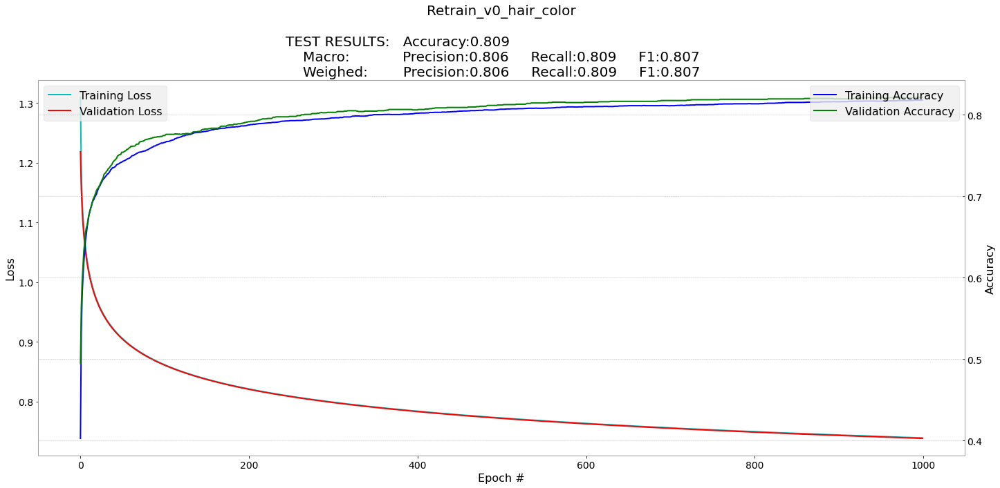

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
all: 0.9035

Black: all 0.952 true: 0.9105 false: 0.9658333333333333

Blond: all 0.957375 true: 0.906 false: 0.9745

Brown: all 0.919875 true: 0.845 false: 0.9448333333333333

Gray: all 0.97775 true: 0.9525 false: 0.9861666666666666

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=300, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/300
47/47 [==============================] - 1s 6ms/step - loss: 1.5631 - accuracy: 0.2545 - val_loss: 1.5113 - val_accuracy: 0.2555
Epoch 2/300
47/47 [==============================] - 0s 3ms/step - loss: 1.4585 - accuracy: 0.2672 - val_loss: 1.4176 - val_accuracy: 0.2830
Epoch 3/300
47/47 [==============================] - 0s 4ms/step - loss: 1.3757 - accuracy: 0.3127 - val_loss: 1.3429 - val_accuracy: 0.3270
Epoch 4/300
47/47 [==============================] - 0s 4ms/step - loss: 1.3087 - accuracy: 0.3662 - val_loss: 1.2806 - val_accuracy: 0.3920
Epoch 5/300
47/47 [==============================] - 0s 3ms/step - loss: 1.2516 - accuracy: 0.4248 - val_loss: 1.2276 - val_accuracy: 0.4515
Epoch 6/300
47/47 [==============================] - 0s 3ms/step - loss: 1.2019 - accuracy: 0.4877 - val_loss: 1.1808 - val_accuracy: 0.5095
Epoch 7/300
47/47 [==============================] - 0s 3ms/step - loss: 1.1576 - accuracy: 0.5413 - val_loss: 1.1382 - val_accuracy: 0.5590
Epoch 8/300
4

2703

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

all: 0.9035

Black: all 0.952 true: 0.9105 false: 0.9658333333333333

Blond: all 0.957375 true: 0.906 false: 0.9745

Brown: all 0.919875 true: 0.845 false: 0.9448333333333333

Gray: all 0.97775 true: 0.9525 false: 0.9861666666666666
              precision    recall  f1-score   support

           0       0.90      0.91      0.90      2000
           1       0.92      0.91      0.91      2000
           2       0.84      0.84      0.84      2000
           3       0.96      0.95      0.96      2000

    accuracy                           0.90      8000
   macro avg       0.90      0.90      0.90      8000
weighted avg       0.90      0.90      0.90      8000



#### Gráfico de entrenamiento

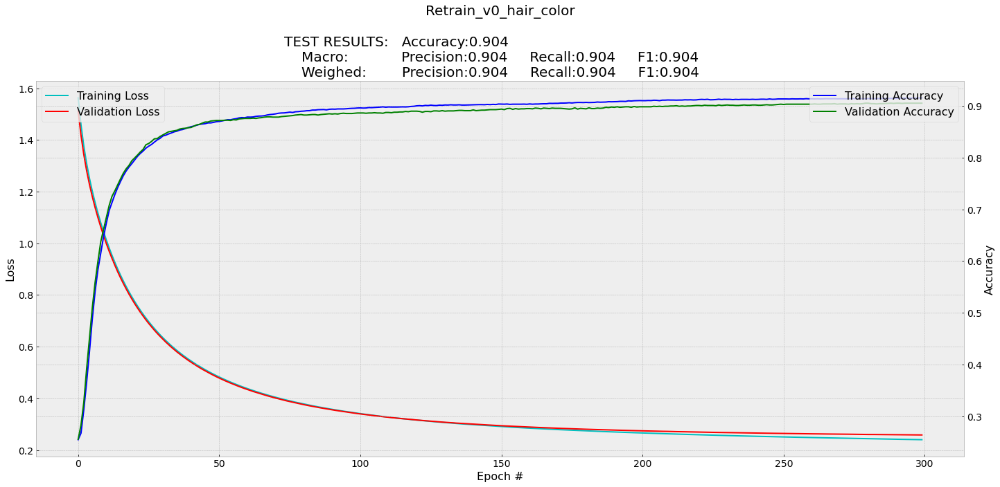

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
all: 0.898875

Black: all 0.9495 true: 0.905 false: 0.9643333333333334

Blond: all 0.955125 true: 0.9045 false: 0.972

Brown: all 0.918375 true: 0.8375 false: 0.9453333333333334

Gray: all 0.97475 true: 0.9485 false: 0.9835

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten (Flatten)            (None, 512)               0         
_________________________________________________________________
dense (Dense)                (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 3s 8ms/step - loss: 1.4903 - accuracy: 0.2415 - val_loss: 1.4458 - val_accuracy: 0.2650
Epoch 2/1000
47/47 [==============================] - 0s 4ms/step - loss: 1.4225 - accuracy: 0.2790 - val_loss: 1.3867 - val_accuracy: 0.3085
Epoch 3/1000
47/47 [==============================] - 0s 5ms/step - loss: 1.3644 - accuracy: 0.3378 - val_loss: 1.3340 - val_accuracy: 0.3670
Epoch 4/1000
47/47 [==============================] - 0s 5ms/step - loss: 1.3124 - accuracy: 0.3962 - val_loss: 1.2853 - val_accuracy: 0.4265
Epoch 5/1000
47/47 [==============================] - 0s 5ms/step - loss: 1.2641 - accuracy: 0.4488 - val_loss: 1.2396 - val_accuracy: 0.4825
Epoch 6/1000
47/47 [==============================] - 0s 5ms/step - loss: 1.2191 - accuracy: 0.5005 - val_loss: 1.1968 - val_accuracy: 0.5305
Epoch 7/1000
47/47 [==============================] - 0s 4ms/step - loss: 1.1769 - accuracy: 0.5432 - val_loss: 1.1563 - val_accuracy: 0.5690
Epoch 

1613

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

all: 0.898875

Black: all 0.9495 true: 0.905 false: 0.9643333333333334

Blond: all 0.955125 true: 0.9045 false: 0.972

Brown: all 0.918375 true: 0.8375 false: 0.9453333333333334

Gray: all 0.97475 true: 0.9485 false: 0.9835
              precision    recall  f1-score   support

           0       0.89      0.91      0.90      2000
           1       0.92      0.90      0.91      2000
           2       0.84      0.84      0.84      2000
           3       0.95      0.95      0.95      2000

    accuracy                           0.90      8000
   macro avg       0.90      0.90      0.90      8000
weighted avg       0.90      0.90      0.90      8000



#### Gráfico de entrenamiento

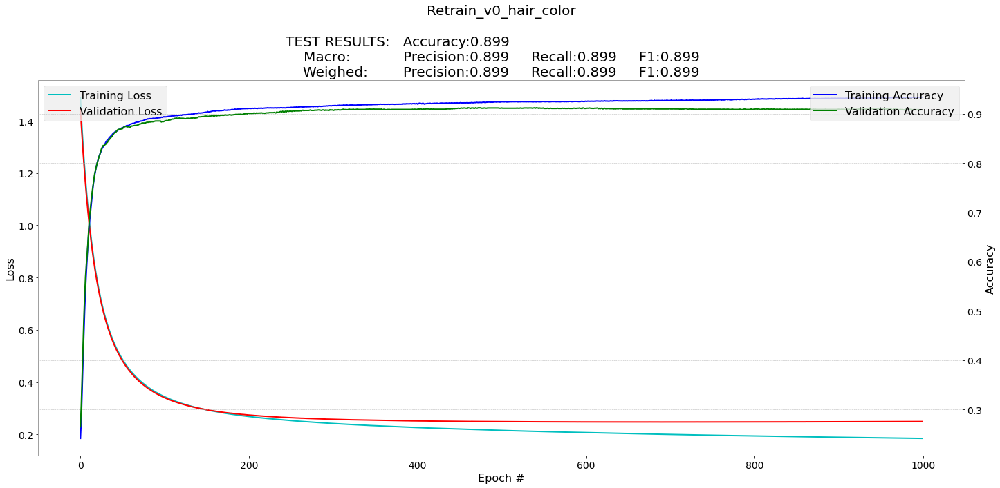

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
all: 0.856125

Black: all 0.931 true: 0.873 false: 0.9503333333333334

Blond: all 0.93325 true: 0.882 false: 0.9503333333333334

Brown: all 0.896125 true: 0.767 false: 0.9391666666666667

Gray: all 0.951875 true: 0.9025 false: 0.9683333333333334

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 54s 1s/step - loss: 1.6480 - accuracy: 0.4112 - val_loss: 1.1203 - val_accuracy: 0.5035
Epoch 2/20
47/47 [==============================] - 52s 1s/step - loss: 0.8028 - accuracy: 0.6602 - val_loss: 0.7934 - val_accuracy: 0.6775
Epoch 3/20
47/47 [==============================] - 52s 1s/step - loss: 0.5800 - accuracy: 0.7733 - val_loss: 0.5671 - val_accuracy: 0.7725
Epoch 4/20
47/47 [==============================] - 52s 1s/step - loss: 0.4352 - accuracy: 0.8340 - val_loss: 0.4545 - val_accuracy: 0.8220
Epoch 5/20
47/47 [==============================] - 53s 1s/step - loss: 0.3313 - accuracy: 0.8733 - val_loss: 0.4345 - val_accuracy: 0.8290
Epoch 6/20
47/47 [==============================] - 53s 1s/step - loss: 0.2607 - accuracy: 0.9078 - val_loss: 0.4166 - val_accuracy: 0.8465
Epoch 7/20
47/47 [==============================] - 52s 1s/step - loss: 0.1962 - accuracy: 0.9263 - val_loss: 0.5160 - val_accuracy: 0.8155
Epoch 8/20
47/47 [==

11078

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

all: 0.856125

Black: all 0.931 true: 0.873 false: 0.9503333333333334

Blond: all 0.93325 true: 0.882 false: 0.9503333333333334

Brown: all 0.896125 true: 0.767 false: 0.9391666666666667

Gray: all 0.951875 true: 0.9025 false: 0.9683333333333334
              precision    recall  f1-score   support

           0       0.85      0.87      0.86      2000
           1       0.86      0.88      0.87      2000
           2       0.81      0.77      0.79      2000
           3       0.90      0.90      0.90      2000

    accuracy                           0.86      8000
   macro avg       0.86      0.86      0.86      8000
weighted avg       0.86      0.86      0.86      8000



#### Gráfico de entrenamiento

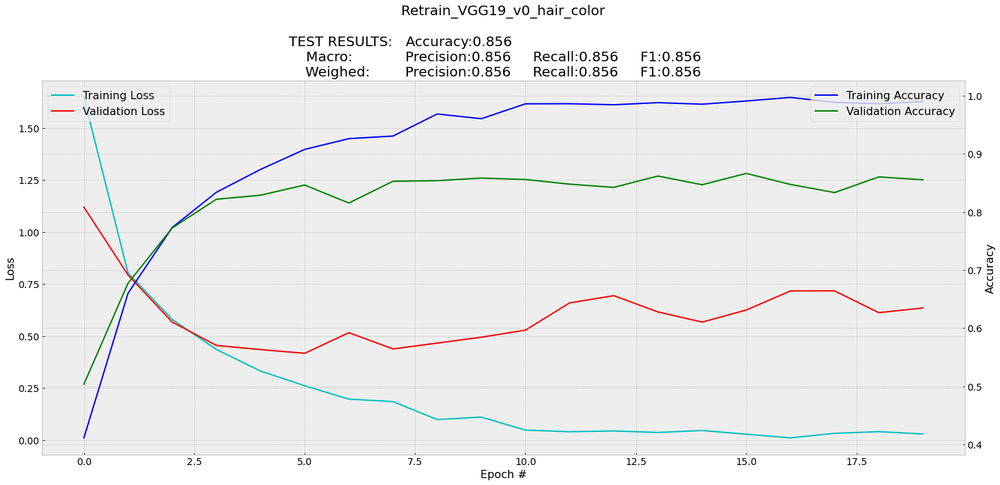

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
all: 0.867625

Black: all 0.939875 true: 0.899 false: 0.9535

Blond: all 0.93625 true: 0.8665 false: 0.9595

Brown: all 0.908 true: 0.8045 false: 0.9425

Gray: all 0.951125 true: 0.9005 false: 0.968

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=25, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/25
47/47 [==============================] - 54s 1s/step - loss: 1.7197 - accuracy: 0.4422 - val_loss: 0.8739 - val_accuracy: 0.6375
Epoch 2/25
47/47 [==============================] - 52s 1s/step - loss: 0.6917 - accuracy: 0.7237 - val_loss: 0.5867 - val_accuracy: 0.7780
Epoch 3/25
47/47 [==============================] - 52s 1s/step - loss: 0.4893 - accuracy: 0.8113 - val_loss: 0.5179 - val_accuracy: 0.8010
Epoch 4/25
47/47 [==============================] - 52s 1s/step - loss: 0.3842 - accuracy: 0.8535 - val_loss: 0.4545 - val_accuracy: 0.8295
Epoch 5/25
47/47 [==============================] - 52s 1s/step - loss: 0.2818 - accuracy: 0.8917 - val_loss: 0.4659 - val_accuracy: 0.8300
Epoch 6/25
47/47 [==============================] - 52s 1s/step - loss: 0.2147 - accuracy: 0.9157 - val_loss: 0.4693 - val_accuracy: 0.8395
Epoch 7/25
47/47 [==============================] - 52s 1s/step - loss: 0.1984 - accuracy: 0.9270 - val_loss: 0.4756 - val_accuracy: 0.8420
Epoch 8/25
47/47 [==

12089

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

all: 0.867625

Black: all 0.939875 true: 0.899 false: 0.9535

Blond: all 0.93625 true: 0.8665 false: 0.9595

Brown: all 0.908 true: 0.8045 false: 0.9425

Gray: all 0.951125 true: 0.9005 false: 0.968
              precision    recall  f1-score   support

           0       0.87      0.90      0.88      2000
           1       0.88      0.87      0.87      2000
           2       0.82      0.80      0.81      2000
           3       0.90      0.90      0.90      2000

    accuracy                           0.87      8000
   macro avg       0.87      0.87      0.87      8000
weighted avg       0.87      0.87      0.87      8000



#### Gráfico de entrenamiento

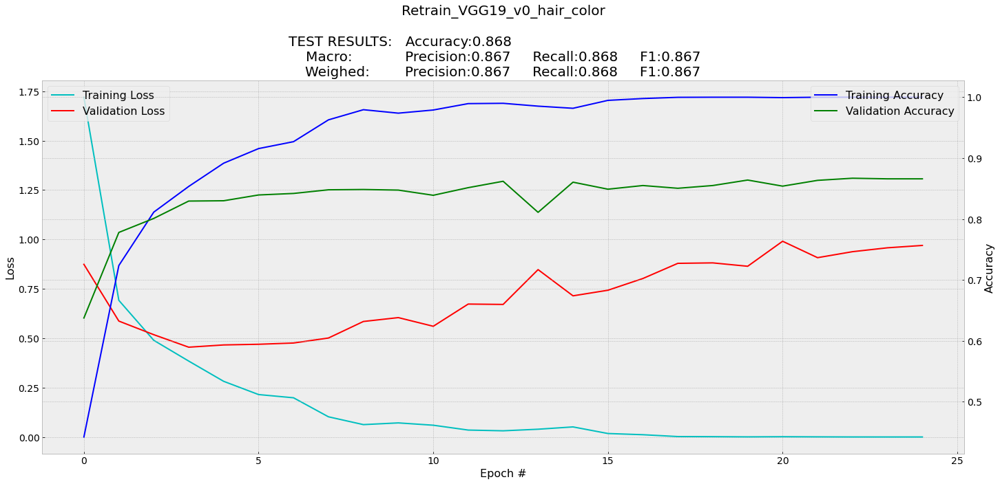

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
all: 0.853875

Black: all 0.93675 true: 0.871 false: 0.9586666666666667

Blond: all 0.925875 true: 0.925 false: 0.9261666666666667

Brown: all 0.9035 true: 0.732 false: 0.9606666666666667

Gray: all 0.941625 true: 0.8875 false: 0.9596666666666667

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

80150528/80134624 [==============================] - 1s 0us/step
Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
____________________________________________________________

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 89s 2s/step - loss: 1.5891 - accuracy: 0.4875 - val_loss: 0.8021 - val_accuracy: 0.6785
Epoch 2/20
47/47 [==============================] - 52s 1s/step - loss: 0.7511 - accuracy: 0.6947 - val_loss: 0.8042 - val_accuracy: 0.6590
Epoch 3/20
47/47 [==============================] - 53s 1s/step - loss: 0.5820 - accuracy: 0.7730 - val_loss: 0.6782 - val_accuracy: 0.7270
Epoch 4/20
47/47 [==============================] - 52s 1s/step - loss: 0.4620 - accuracy: 0.8265 - val_loss: 0.4582 - val_accuracy: 0.8215
Epoch 5/20
47/47 [==============================] - 53s 1s/step - loss: 0.4057 - accuracy: 0.8442 - val_loss: 0.4826 - val_accuracy: 0.8145
Epoch 6/20
47/47 [==============================] - 53s 1s/step - loss: 0.3762 - accuracy: 0.8557 - val_loss: 0.4194 - val_accuracy: 0.8400
Epoch 7/20
47/47 [==============================] - 53s 1s/step - loss: 0.2844 - accuracy: 0.8925 - val_loss: 0.3869 - val_accuracy: 0.8545
Epoch 8/20
47/47 [==

2389

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

all: 0.853875

Black: all 0.93675 true: 0.871 false: 0.9586666666666667

Blond: all 0.925875 true: 0.925 false: 0.9261666666666667

Brown: all 0.9035 true: 0.732 false: 0.9606666666666667

Gray: all 0.941625 true: 0.8875 false: 0.9596666666666667
              precision    recall  f1-score   support

           0       0.88      0.87      0.87      2000
           1       0.81      0.93      0.86      2000
           2       0.86      0.73      0.79      2000
           3       0.88      0.89      0.88      2000

    accuracy                           0.85      8000
   macro avg       0.86      0.85      0.85      8000
weighted avg       0.86      0.85      0.85      8000



#### Gráfico de entrenamiento

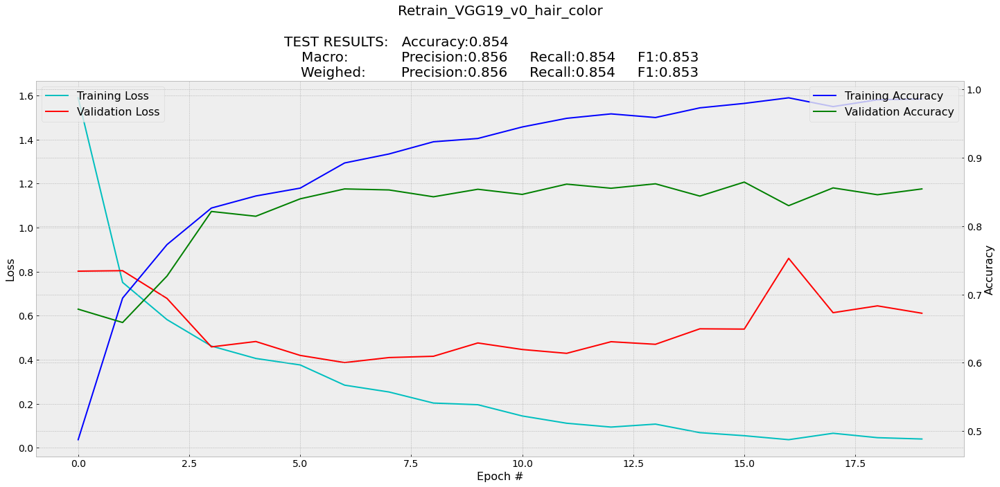

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
all: 0.874

Black: all 0.941 true: 0.897 false: 0.9556666666666667

Blond: all 0.94525 true: 0.891 false: 0.9633333333333334

Brown: all 0.90875 true: 0.808 false: 0.9423333333333334

Gray: all 0.953 true: 0.9 false: 0.9706666666666667

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

80150528/80134624 [==============================] - 1s 0us/step
Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
____________________________________________________________

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=30, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/30
47/47 [==============================] - 88s 2s/step - loss: 1.7316 - accuracy: 0.2817 - val_loss: 1.3424 - val_accuracy: 0.3670
Epoch 2/30
47/47 [==============================] - 52s 1s/step - loss: 1.2372 - accuracy: 0.3932 - val_loss: 1.0769 - val_accuracy: 0.5075
Epoch 3/30
47/47 [==============================] - 52s 1s/step - loss: 0.9180 - accuracy: 0.5918 - val_loss: 0.9690 - val_accuracy: 0.5545
Epoch 4/30
47/47 [==============================] - 52s 1s/step - loss: 0.7014 - accuracy: 0.7220 - val_loss: 0.5941 - val_accuracy: 0.7695
Epoch 5/30
47/47 [==============================] - 52s 1s/step - loss: 0.5017 - accuracy: 0.8145 - val_loss: 0.5125 - val_accuracy: 0.8030
Epoch 6/30
47/47 [==============================] - 52s 1s/step - loss: 0.3954 - accuracy: 0.8557 - val_loss: 0.4082 - val_accuracy: 0.8440
Epoch 7/30
47/47 [==============================] - 52s 1s/step - loss: 0.3346 - accuracy: 0.8797 - val_loss: 0.3979 - val_accuracy: 0.8500
Epoch 8/30
47/47 [==

2381

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

all: 0.874

Black: all 0.941 true: 0.897 false: 0.9556666666666667

Blond: all 0.94525 true: 0.891 false: 0.9633333333333334

Brown: all 0.90875 true: 0.808 false: 0.9423333333333334

Gray: all 0.953 true: 0.9 false: 0.9706666666666667
              precision    recall  f1-score   support

           0       0.87      0.90      0.88      2000
           1       0.89      0.89      0.89      2000
           2       0.82      0.81      0.82      2000
           3       0.91      0.90      0.91      2000

    accuracy                           0.87      8000
   macro avg       0.87      0.87      0.87      8000
weighted avg       0.87      0.87      0.87      8000



#### Gráfico de entrenamiento

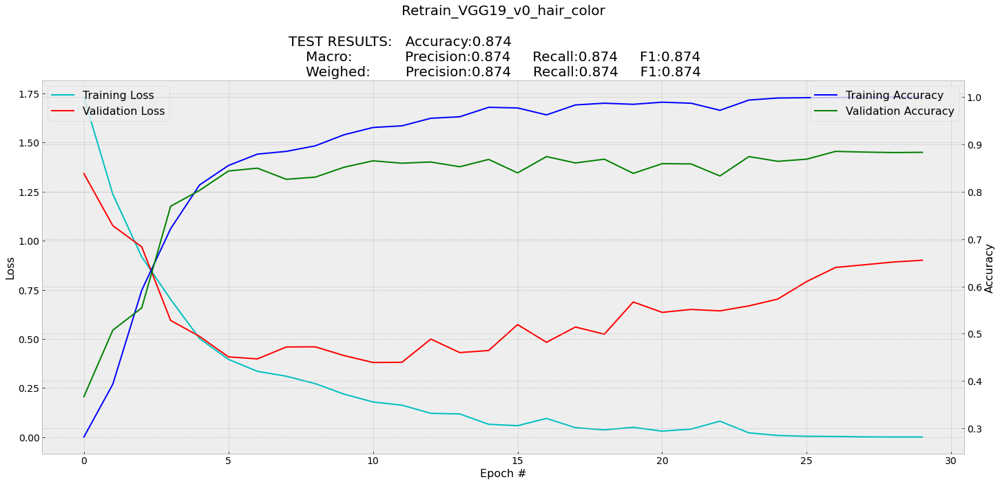

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
all: 0.816

Black: all 0.916375 true: 0.834 false: 0.9438333333333333

Blond: all 0.91425 true: 0.8395 false: 0.9391666666666667

Brown: all 0.868875 true: 0.7185 false: 0.919

Gray: all 0.9325 true: 0.872 false: 0.9526666666666667

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_3[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=25, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/25
47/47 [==============================] - 70s 1s/step - loss: 1.0719 - accuracy: 0.5317 - val_loss: 0.8491 - val_accuracy: 0.6475
Epoch 2/25
47/47 [==============================] - 64s 1s/step - loss: 0.4709 - accuracy: 0.8338 - val_loss: 0.7069 - val_accuracy: 0.7160
Epoch 3/25
47/47 [==============================] - 64s 1s/step - loss: 0.2200 - accuracy: 0.9402 - val_loss: 0.5735 - val_accuracy: 0.7760
Epoch 4/25
47/47 [==============================] - 64s 1s/step - loss: 0.0953 - accuracy: 0.9852 - val_loss: 0.5635 - val_accuracy: 0.7935
Epoch 5/25
47/47 [==============================] - 64s 1s/step - loss: 0.0411 - accuracy: 0.9963 - val_loss: 0.5599 - val_accuracy: 0.8030
Epoch 6/25
47/47 [==============================] - 64s 1s/step - loss: 0.0190 - accuracy: 0.9993 - val_loss: 0.5936 - val_accuracy: 0.8035
Epoch 7/25
47/47 [==============================] - 64s 1s/step - loss: 0.0108 - accuracy: 0.9998 - val_loss: 0.6196 - val_accuracy: 0.8030
Epoch 8/25
47/47 [==

26090

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

all: 0.816

Black: all 0.916375 true: 0.834 false: 0.9438333333333333

Blond: all 0.91425 true: 0.8395 false: 0.9391666666666667

Brown: all 0.868875 true: 0.7185 false: 0.919

Gray: all 0.9325 true: 0.872 false: 0.9526666666666667
              precision    recall  f1-score   support

           0       0.83      0.83      0.83      2000
           1       0.82      0.84      0.83      2000
           2       0.75      0.72      0.73      2000
           3       0.86      0.87      0.87      2000

    accuracy                           0.82      8000
   macro avg       0.82      0.82      0.82      8000
weighted avg       0.82      0.82      0.82      8000



#### Gráfico de entrenamiento

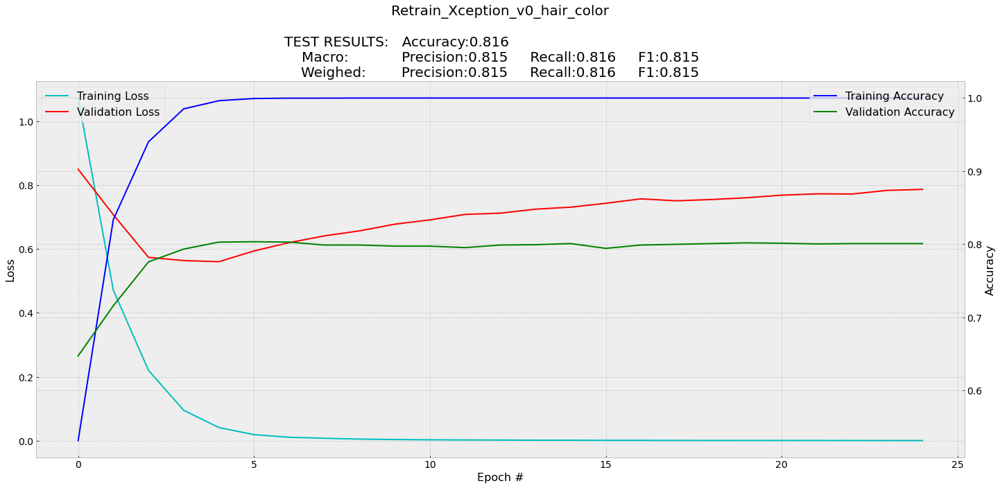

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
all: 0.801125

Black: all 0.90925 true: 0.8155 false: 0.9405

Blond: all 0.909 true: 0.8335 false: 0.9341666666666667

Brown: all 0.85975 true: 0.7015 false: 0.9125

Gray: all 0.92425 true: 0.854 false: 0.9476666666666667

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

83697664/83683744 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
_____________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=25, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/25
47/47 [==============================] - 109s 2s/step - loss: 1.3706 - accuracy: 0.3327 - val_loss: 1.3257 - val_accuracy: 0.3530
Epoch 2/25
47/47 [==============================] - 65s 1s/step - loss: 1.1259 - accuracy: 0.5425 - val_loss: 1.1607 - val_accuracy: 0.4865
Epoch 3/25
47/47 [==============================] - 65s 1s/step - loss: 0.9245 - accuracy: 0.6695 - val_loss: 1.0054 - val_accuracy: 0.6025
Epoch 4/25
47/47 [==============================] - 64s 1s/step - loss: 0.7586 - accuracy: 0.7425 - val_loss: 0.8768 - val_accuracy: 0.6530
Epoch 5/25
47/47 [==============================] - 65s 1s/step - loss: 0.6217 - accuracy: 0.7985 - val_loss: 0.7787 - val_accuracy: 0.6880
Epoch 6/25
47/47 [==============================] - 65s 1s/step - loss: 0.5119 - accuracy: 0.8432 - val_loss: 0.7223 - val_accuracy: 0.7075
Epoch 7/25
47/47 [==============================] - 65s 1s/step - loss: 0.4208 - accuracy: 0.8817 - val_loss: 0.6798 - val_accuracy: 0.7260
Epoch 8/25
47/47 [=

1612

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

all: 0.801125

Black: all 0.90925 true: 0.8155 false: 0.9405

Blond: all 0.909 true: 0.8335 false: 0.9341666666666667

Brown: all 0.85975 true: 0.7015 false: 0.9125

Gray: all 0.92425 true: 0.854 false: 0.9476666666666667
              precision    recall  f1-score   support

           0       0.82      0.82      0.82      2000
           1       0.81      0.83      0.82      2000
           2       0.73      0.70      0.71      2000
           3       0.84      0.85      0.85      2000

    accuracy                           0.80      8000
   macro avg       0.80      0.80      0.80      8000
weighted avg       0.80      0.80      0.80      8000



#### Gráfico de entrenamiento

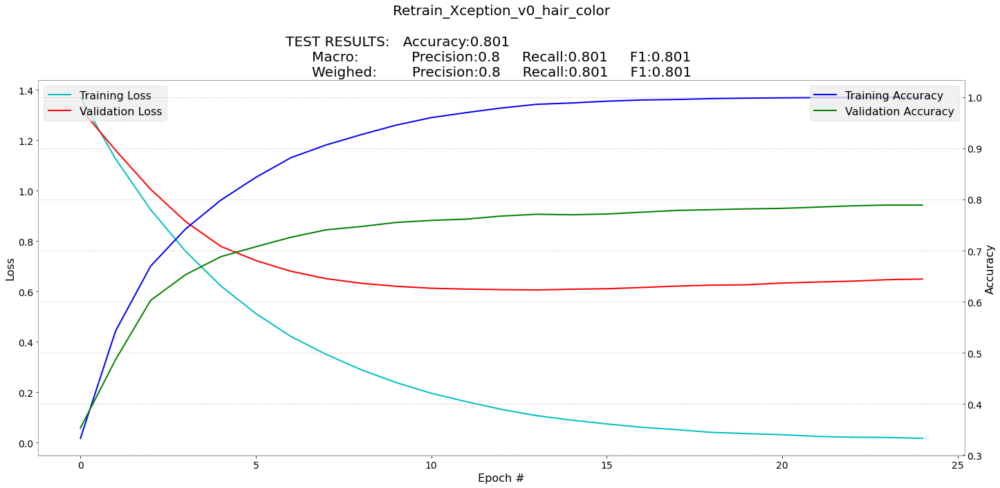

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
all: 0.827625

Black: all 0.9215 true: 0.875 false: 0.937

Blond: all 0.919625 true: 0.8555 false: 0.941

Brown: all 0.8755 true: 0.7005 false: 0.9338333333333333

Gray: all 0.938625 true: 0.8795 false: 0.9583333333333334

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

83697664/83683744 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
_____________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=8, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/8
47/47 [==============================] - 108s 1s/step - loss: 0.8904 - accuracy: 0.6218 - val_loss: 0.9504 - val_accuracy: 0.6655
Epoch 2/8
47/47 [==============================] - 64s 1s/step - loss: 0.2990 - accuracy: 0.8945 - val_loss: 0.7625 - val_accuracy: 0.7230
Epoch 3/8
47/47 [==============================] - 64s 1s/step - loss: 0.0777 - accuracy: 0.9818 - val_loss: 0.6232 - val_accuracy: 0.7920
Epoch 4/8
47/47 [==============================] - 64s 1s/step - loss: 0.0192 - accuracy: 0.9985 - val_loss: 0.5671 - val_accuracy: 0.8235
Epoch 5/8
47/47 [==============================] - 64s 1s/step - loss: 0.0081 - accuracy: 0.9995 - val_loss: 0.5816 - val_accuracy: 0.8315
Epoch 6/8
47/47 [==============================] - 64s 1s/step - loss: 0.0040 - accuracy: 0.9998 - val_loss: 0.6072 - val_accuracy: 0.8325
Epoch 7/8
47/47 [==============================] - 64s 1s/step - loss: 0.0025 - accuracy: 1.0000 - val_loss: 0.6498 - val_accuracy: 0.8305
Epoch 8/8
47/47 [=========

2163

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

all: 0.827625

Black: all 0.9215 true: 0.875 false: 0.937

Blond: all 0.919625 true: 0.8555 false: 0.941

Brown: all 0.8755 true: 0.7005 false: 0.9338333333333333

Gray: all 0.938625 true: 0.8795 false: 0.9583333333333334
              precision    recall  f1-score   support

           0       0.82      0.88      0.85      2000
           1       0.83      0.86      0.84      2000
           2       0.78      0.70      0.74      2000
           3       0.88      0.88      0.88      2000

    accuracy                           0.83      8000
   macro avg       0.83      0.83      0.83      8000
weighted avg       0.83      0.83      0.83      8000



#### Gráfico de entrenamiento

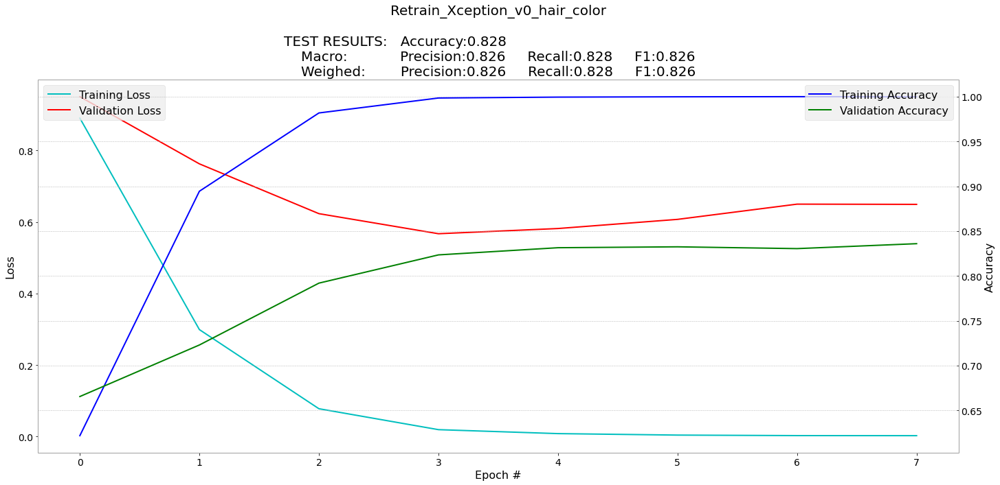

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

## Modelos

### CLIP 
all: 0.9035

Black: all 0.952 true: 0.9105 false: 0.9658333333333333

Blond: all 0.957375 true: 0.906 false: 0.9745

Brown: all 0.919875 true: 0.845 false: 0.9448333333333333

Gray: all 0.97775 true: 0.9525 false: 0.9861666666666666

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=300, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/300
47/47 [==============================] - 1s 6ms/step - loss: 1.5631 - accuracy: 0.2545 - val_loss: 1.5113 - val_accuracy: 0.2555
Epoch 2/300
47/47 [==============================] - 0s 3ms/step - loss: 1.4585 - accuracy: 0.2672 - val_loss: 1.4176 - val_accuracy: 0.2830
Epoch 3/300
47/47 [==============================] - 0s 4ms/step - loss: 1.3757 - accuracy: 0.3127 - val_loss: 1.3429 - val_accuracy: 0.3270
Epoch 4/300
47/47 [==============================] - 0s 4ms/step - loss: 1.3087 - accuracy: 0.3662 - val_loss: 1.2806 - val_accuracy: 0.3920
Epoch 5/300
47/47 [==============================] - 0s 3ms/step - loss: 1.2516 - accuracy: 0.4248 - val_loss: 1.2276 - val_accuracy: 0.4515
Epoch 6/300
47/47 [==============================] - 0s 3ms/step - loss: 1.2019 - accuracy: 0.4877 - val_loss: 1.1808 - val_accuracy: 0.5095
Epoch 7/300
47/47 [==============================] - 0s 3ms/step - loss: 1.1576 - accuracy: 0.5413 - val_loss: 1.1382 - val_accuracy: 0.5590
Epoch 8/300
4

2703

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

all: 0.9035

Black: all 0.952 true: 0.9105 false: 0.9658333333333333

Blond: all 0.957375 true: 0.906 false: 0.9745

Brown: all 0.919875 true: 0.845 false: 0.9448333333333333

Gray: all 0.97775 true: 0.9525 false: 0.9861666666666666
              precision    recall  f1-score   support

           0       0.90      0.91      0.90      2000
           1       0.92      0.91      0.91      2000
           2       0.84      0.84      0.84      2000
           3       0.96      0.95      0.96      2000

    accuracy                           0.90      8000
   macro avg       0.90      0.90      0.90      8000
weighted avg       0.90      0.90      0.90      8000



#### Gráfico de entrenamiento

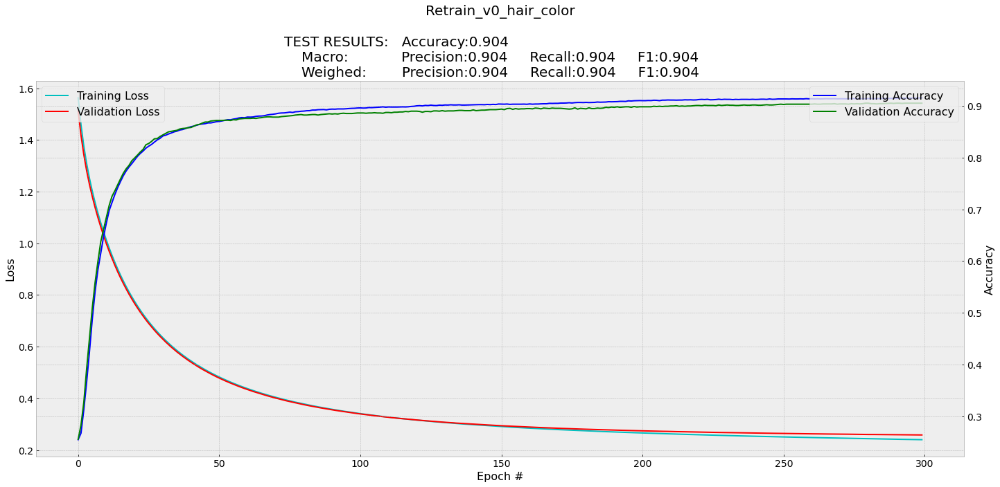

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
all: 0.874

Black: all 0.941 true: 0.897 false: 0.9556666666666667

Blond: all 0.94525 true: 0.891 false: 0.9633333333333334

Brown: all 0.90875 true: 0.808 false: 0.9423333333333334

Gray: all 0.953 true: 0.9 false: 0.9706666666666667

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

80150528/80134624 [==============================] - 1s 0us/step
Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
____________________________________________________________

#### Entrenar modelo

In [ ]:
Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=30, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/30
47/47 [==============================] - 88s 2s/step - loss: 1.7316 - accuracy: 0.2817 - val_loss: 1.3424 - val_accuracy: 0.3670
Epoch 2/30
47/47 [==============================] - 52s 1s/step - loss: 1.2372 - accuracy: 0.3932 - val_loss: 1.0769 - val_accuracy: 0.5075
Epoch 3/30
47/47 [==============================] - 52s 1s/step - loss: 0.9180 - accuracy: 0.5918 - val_loss: 0.9690 - val_accuracy: 0.5545
Epoch 4/30
47/47 [==============================] - 52s 1s/step - loss: 0.7014 - accuracy: 0.7220 - val_loss: 0.5941 - val_accuracy: 0.7695
Epoch 5/30
47/47 [==============================] - 52s 1s/step - loss: 0.5017 - accuracy: 0.8145 - val_loss: 0.5125 - val_accuracy: 0.8030
Epoch 6/30
47/47 [==============================] - 52s 1s/step - loss: 0.3954 - accuracy: 0.8557 - val_loss: 0.4082 - val_accuracy: 0.8440
Epoch 7/30
47/47 [==============================] - 52s 1s/step - loss: 0.3346 - accuracy: 0.8797 - val_loss: 0.3979 - val_accuracy: 0.8500
Epoch 8/30
47/47 [==

2381

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

all: 0.874

Black: all 0.941 true: 0.897 false: 0.9556666666666667

Blond: all 0.94525 true: 0.891 false: 0.9633333333333334

Brown: all 0.90875 true: 0.808 false: 0.9423333333333334

Gray: all 0.953 true: 0.9 false: 0.9706666666666667
              precision    recall  f1-score   support

           0       0.87      0.90      0.88      2000
           1       0.89      0.89      0.89      2000
           2       0.82      0.81      0.82      2000
           3       0.91      0.90      0.91      2000

    accuracy                           0.87      8000
   macro avg       0.87      0.87      0.87      8000
weighted avg       0.87      0.87      0.87      8000



#### Gráfico de entrenamiento

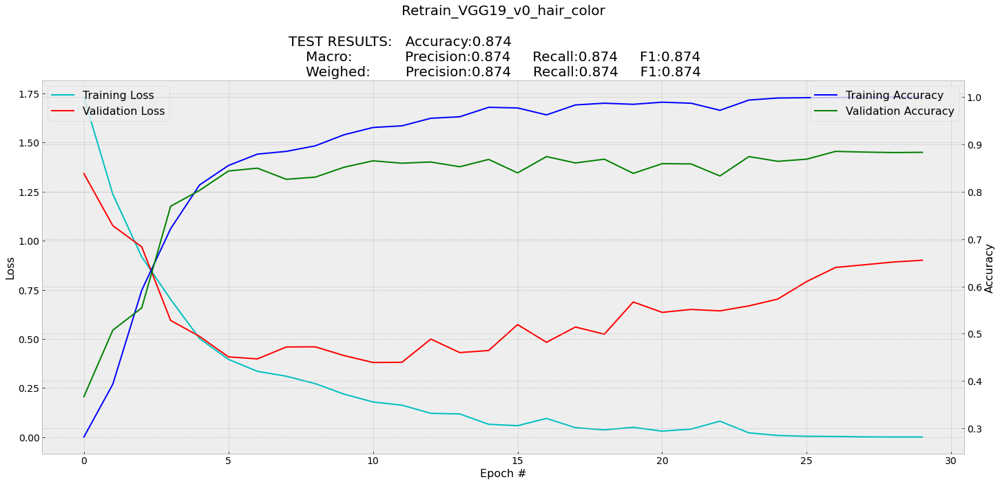

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
all: 0.827625

Black: all 0.9215 true: 0.875 false: 0.937

Blond: all 0.919625 true: 0.8555 false: 0.941

Brown: all 0.8755 true: 0.7005 false: 0.9338333333333333

Gray: all 0.938625 true: 0.8795 false: 0.9583333333333334

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

83697664/83683744 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
_____________________________

#### Entrenar modelo

In [ ]:
Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=8, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/8
47/47 [==============================] - 108s 1s/step - loss: 0.8904 - accuracy: 0.6218 - val_loss: 0.9504 - val_accuracy: 0.6655
Epoch 2/8
47/47 [==============================] - 64s 1s/step - loss: 0.2990 - accuracy: 0.8945 - val_loss: 0.7625 - val_accuracy: 0.7230
Epoch 3/8
47/47 [==============================] - 64s 1s/step - loss: 0.0777 - accuracy: 0.9818 - val_loss: 0.6232 - val_accuracy: 0.7920
Epoch 4/8
47/47 [==============================] - 64s 1s/step - loss: 0.0192 - accuracy: 0.9985 - val_loss: 0.5671 - val_accuracy: 0.8235
Epoch 5/8
47/47 [==============================] - 64s 1s/step - loss: 0.0081 - accuracy: 0.9995 - val_loss: 0.5816 - val_accuracy: 0.8315
Epoch 6/8
47/47 [==============================] - 64s 1s/step - loss: 0.0040 - accuracy: 0.9998 - val_loss: 0.6072 - val_accuracy: 0.8325
Epoch 7/8
47/47 [==============================] - 64s 1s/step - loss: 0.0025 - accuracy: 1.0000 - val_loss: 0.6498 - val_accuracy: 0.8305
Epoch 8/8
47/47 [=========

2163

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

acc_all=0
acc_0=0
acc_1=0
acc_2=0
acc_3=0
acc_true_0=0
acc_true_1=0
acc_true_2=0
acc_true_3=0
acc_false_0=0
acc_false_1=0
acc_false_2=0
acc_false_3=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 4 == 0:
        if pred==0:
            acc_true_0+=1
            acc_all+=1
    else:
        if pred!=0:
            acc_false_0+=1    

    if i % 4 == 1:
        if pred==1:
            acc_true_1+=1
            acc_all+=1
    else:
        if pred!=1:
            acc_false_1+=1
            
    if i % 4 == 2:
        if pred==2:
            acc_true_2+=1
            acc_all+=1
    else:
        if pred!=2:
            acc_false_2+=1
            
    if i % 4 == 3:
        if pred==3:
            acc_true_3+=1
            acc_all+=1
    else:
        if pred!=3:
            acc_false_3+=1
    i+=1
acc_0=acc_true_0+acc_false_0
acc_1=acc_true_1+acc_false_1
acc_2=acc_true_2+acc_false_2
acc_3=acc_true_3+acc_false_3

print('all:',acc_all/len(Data['Training']['Classes']['Test']))
print('\nBlack:','all',acc_0/len(Data['Training']['Classes']['Test']),'true:',acc_true_0/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_0/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBlond:','all',acc_1/len(Data['Training']['Classes']['Test']),'true:',acc_true_1/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_1/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nBrown:','all',acc_2/len(Data['Training']['Classes']['Test']),'true:',acc_true_2/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_2/(len(Data['Training']['Classes']['Test'])*3/4))
print('\nGray:','all',acc_3/len(Data['Training']['Classes']['Test']),'true:',acc_true_3/(len(Data['Training']['Classes']['Test'])/4),'false:',acc_false_3/(len(Data['Training']['Classes']['Test'])*3/4))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

all: 0.827625

Black: all 0.9215 true: 0.875 false: 0.937

Blond: all 0.919625 true: 0.8555 false: 0.941

Brown: all 0.8755 true: 0.7005 false: 0.9338333333333333

Gray: all 0.938625 true: 0.8795 false: 0.9583333333333334
              precision    recall  f1-score   support

           0       0.82      0.88      0.85      2000
           1       0.83      0.86      0.84      2000
           2       0.78      0.70      0.74      2000
           3       0.88      0.88      0.88      2000

    accuracy                           0.83      8000
   macro avg       0.83      0.83      0.83      8000
weighted avg       0.83      0.83      0.83      8000



#### Gráfico de entrenamiento

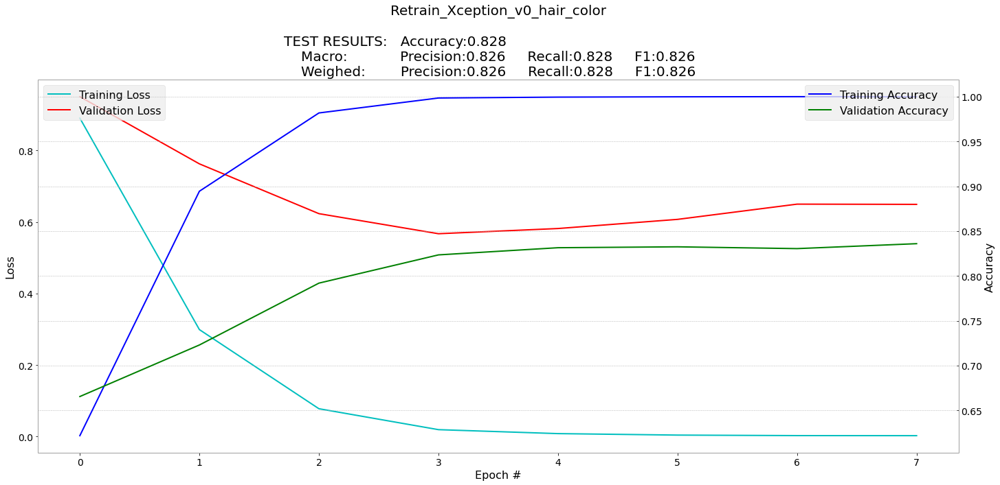

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

# Etiqueta Celeba: "hat"

## Proceso

### CLIP crear "prompt" y preparar parámetros

In [ ]:
import torch
import clip
from PIL import Image
import glob

Name_feature='_hat'
id_feature=35
Save_Data_Path=BASE_FOLDER_2+'Retrain_v0'+Name_feature+'.pkl'

Index_To_Test=[]
Label_To_Test=[]
Data_To_Train=[]
Label_To_Train=[]
Data = {'Training':{}, 'Model Name':{}, 'H':{}, 'Classes':{}}
Data['Training']={'Images':{},'Images array':{}, 'Classes':{}, 'Classes array':{}, 'Index':{}, 'H':{}}
Data['Training']['Images']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Images array']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes array']={'Train':{}, 'Validate':{}}

clip_tokens=[ 'A picture of a person', 'A picture of a person with hat', 
             'A picture of a person with hair','A picture of a person with hair or bald']

N_Tokens=len(clip_tokens)
print(N_Tokens)
print(clip_tokens)
for current_token in clip_tokens:
    print(current_token)

# [ 'A picture of a person',"A picture of a person with 5 o'clock shadow",'A picture of a person with arched eyebrows',
# 'A picture of an attractive person','A picture of a person with bags under eyes',
# 'A picture of a bald person','A picture of a person with bangs','A picture of a person with big lips',
# 'A picture of a person with big nose','A picture of a person with black hair',
# 'A picture of a person with blond hair','A blurry picture of a person',
# 'A picture of a person with brown hair','A picture of a person with bushy eyebrows',
# 'A picture of a chubby person','A picture of a person with double chin','A picture of a person with eyeglasses',
# 'A picture of a person with goatee','A picture of a person with gray hair','A picture of a person with heavy makeup',
# 'A picture of a person with high cheekbones','A picture of a male person',
# 'A picture of a person with mouth slightly open','A picture of a person with mustache',
# 'A picture of a person with narrow eyes','A picture of a person with no beard',
# 'A picture of a person with oval face','A picture of a person with pale skin','A picture of a person with pointy nose',
# 'A picture of a person with receding hairline','A picture of a person with rosy cheeks','A picture of a person with sideburns',
# 'A picture of a person who is smiling','A picture of a person with straight hair','A picture of a person with wavy hair',
# 'A picture of a person with earrings','A picture of a person with hat','A picture of a person with lipstick',
# 'A picture of a person with necklace','A picture of a person with necktie','A picture of a young person']

4
['A picture of a person', 'A picture of a person with hat', 'A picture of a person with hair', 'A picture of a person with hair or bald']
A picture of a person
A picture of a person with hat
A picture of a person with hair
A picture of a person with hair or bald


### Cargar CLIP

In [ ]:
clip_device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, clip_transform = clip.load("ViT-B/32", device=clip_device)
clip_text = clip.tokenize(clip_tokens).to(clip_device)

# CLIP features
text_features = clip_model.encode_text(clip_text)

test_index=1
test_image_path=Path_images+str(test_index).zfill(6)+'.jpg'
img_proeprocessed = clip_transform(Image.open(test_image_path)).unsqueeze(0).to(clip_device)
img_features = clip_model.encode_image(img_proeprocessed)
img_features_shape= img_features.shape

print('\n- Image Features:')
print('     Type:',type(img_features))
print('     Shape:',img_features_shape)
print('\n- Text Features:')
print('     Type:',type(text_features))
print('     Shape:',text_features.shape)
print('\n- Image Features Tensor:')
print(img_features)
print('\n- Text Features Tesor:')
print(text_features)


- Image Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([1, 512])

- Text Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([4, 512])

- Image Features Tensor:
tensor([[-6.0150e-02,  1.7044e-02, -9.9854e-02,  2.3523e-01, -6.8359e-02,
         -8.4814e-01, -3.7036e-01, -4.8169e-01, -3.1921e-02, -3.8666e-02,
         -5.1666e-02, -1.9775e-01,  6.2061e-01, -5.4565e-02,  7.4365e-01,
          4.4678e-02,  1.5791e+00, -4.6045e-01,  1.3513e-01, -1.4685e-01,
         -3.7012e-01, -3.7183e-01, -4.6509e-01, -2.8833e-01, -1.7578e-01,
         -1.3904e-01,  2.9028e-01, -9.5642e-02,  3.9746e-01,  1.3770e-01,
          5.1855e-01,  1.5613e-01,  8.7524e-02, -1.0674e-02, -9.4531e-01,
          2.2595e-01, -3.6133e-02,  4.6924e-01,  9.4604e-02,  1.5908e+00,
          2.1533e-01,  1.9360e-01, -5.3284e-02, -7.5500e-02, -6.1111e-03,
          1.4443e+00,  1.2891e-01,  5.3613e-01,  4.5630e-01,  3.9478e-01,
          1.7310e-01,  1.6138e-01, -2.8870e-02, -2.5464e-01, -1

### Seleccionar indices a usar del Dataset Celeba

In [ ]:
# encontrar indices man_woman true/false
Index_Features_0=[]
Index_Features_1=[]

i=0
for descripton in Description_data:
    i=i+1
    if descripton[id_feature]: 
        Index_Features_0.append(i)
    else:
        Index_Features_1.append(i)

## Mostrar Results       
min_value=9999999
print('Examples of celeba:')
print(Description_labels[id_feature]+':',len(Index_Features_0))
print('Not '+Description_labels[id_feature]+':',len(Index_Features_1))  

# Smiling -  True: 97669
# Smiling - False: 104930

Examples of celeba:
Wearing_Hat: 9818
Not Wearing_Hat: 192781


### Cargar Datos (ejectuar si se dispone del archivo de datos creado)

In [ ]:
## LOAD DATA
file_to_load = open(Save_Data_Path, "rb")
df_loaded = pickle.load(file_to_load)
file_to_load.close()

Data=df_loaded['Data']
Index_To_Test=df_loaded['Index_To_Test']
Label_To_Test=df_loaded['Label_To_Test']
Data_To_Train=df_loaded['Data_To_Train']
Label_To_Train=df_loaded['Label_To_Train']

### Preparar datos (ejectuar solo si no se dispone del archivo de datos creado)

In [ ]:
## Funcion si gpu
def CLIP_get_probs_only(img_path,img_txt, img_model, img_transf, img_device):
    img_proeprocessed = img_transf(Image.open(img_path)).unsqueeze(0).to(img_device)

    img_features = img_model.encode_image(img_proeprocessed)
    txt_features = img_model.encode_text(img_txt)
    
    img_logits, img_logits_txt = img_model(img_proeprocessed, img_txt)
    # image_p=softmax(img_logits.detach().numpy()[0])
    image_p=img_logits.detach().cpu().numpy()[0]

    return image_p

def Preprocess_img(images_id,clip_device,clip_model,clip_preprocess,clip_text):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    probs=CLIP_get_probs_only(test_image_path, clip_text, clip_model, clip_preprocess, clip_device)
    return clip_model.encode_image(clip_img).detach().cpu().numpy(), np.array(img_current), probs

def Preprocess_img2(images_id,clip_device,clip_model,clip_preprocess):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    return clip_model.encode_image(clip_img).detach().cpu().numpy(), np.array(img_current)

# Data['Training']['Images']['Test']=[]
# Data['Training']['Images']['Not Test']=[]
# Data['Training']['Classes']['Test']=[]
# Data['Training']['Classes']['Not Test']=[]
# Data['Training']['Images array']['Test']=[]
# Data['Training']['Images array']['Not Test']=[]

# Data['Prediccion_Probs']=np.zeros((16000,N_Tokens))
# n=0
# for i in range(4000):
#     Index_To_Test.append(Index_Features_0[i])
#     Label_To_Test.append(clip_tokens[1])
#     img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_0[i],clip_device,clip_model,clip_transform,clip_text)
#     Data['Training']['Images']['Test'].append(img)
#     Data['Training']['Images array']['Test'].append(img_arr)
#     Data['Training']['Classes']['Test'].append(0)
#     n+=1
#     Index_To_Test.append(Index_Features_1[i])
#     Label_To_Test.append(clip_tokens[2])
#     img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_1[i],clip_device,clip_model,clip_transform,clip_text)
#     Data['Training']['Images']['Test'].append(img)
#     Data['Training']['Images array']['Test'].append(img_arr)
#     Data['Training']['Classes']['Test'].append(1)
#     n+=1

#     if i % 400 == 0 and i>0:
#         print('Test images load (%):',i/40)
        
#         df_to_save= {'Data': Data,
#                       'Index_To_Test':Index_To_Test,
#                       'Label_To_Test':Label_To_Test,
#                       'Data_To_Train':Data_To_Train,
#                       'Label_To_Train':Label_To_Train
#         }
#         save_df_to_file(df_to_save,Save_Data_Path)

#     gc.collect() 
    
# for i in range(4000,8000):
#     Data_To_Train.append(Index_Features_0[i])
#     Label_To_Train.append(clip_tokens[1])
#     img, img_arr=Preprocess_img2(Index_Features_0[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Not Test'].append(img)
#     Data['Training']['Images array']['Not Test'].append(img_arr)
#     Data['Training']['Classes']['Not Test'].append(0)

#     Data_To_Train.append(Index_Features_1[i])
#     Label_To_Train.append(clip_tokens[2])
#     img, img_arr=Preprocess_img2(Index_Features_1[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Not Test'].append(img)
#     Data['Training']['Images array']['Not Test'].append(img_arr)
#     Data['Training']['Classes']['Not Test'].append(1)

#     if i % 400 == 0 and i>2000:
#         print('Train images load (%):',(i-4000)/40)
#         df_to_save= {'Data': Data,
#                       'Index_To_Test':Index_To_Test,
#                       'Label_To_Test':Label_To_Test,
#                       'Data_To_Train':Data_To_Train,
#                       'Label_To_Train':Label_To_Train
#         }
#         save_df_to_file(df_to_save,Save_Data_Path)
#     # gc.collect()

# Data['Classes']=[]
# for element in np.unique(Data['Training']['Classes']['Test']):
#     Data['Classes'].append(np.int(element))

# Data['Training']['Images']['Train'], Data['Training']['Images']['Validate'], Data['Training']['Classes']['Train'], Data['Training']['Classes']['Validate'] = train_test_split(Data['Training']['Images']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)
# Data['Training']['Images array']['Train'], Data['Training']['Images array']['Validate'], Data['Training']['Classes array']['Train'], Data['Training']['Classes array']['Validate'] = train_test_split(Data['Training']['Images array']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)

# df_to_save= {'Data': Data,
#               'Index_To_Test':Index_To_Test,
#               'Label_To_Test':Label_To_Test,
#               'Data_To_Train':Data_To_Train,
#               'Label_To_Train':Label_To_Train
# }
# save_df_to_file(df_to_save,Save_Data_Path)

# ## Visualizar número de entrenamiento
# print('NÚMERO DE DATOS PARA ENTRENAR/TEST')
# print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Not Test']),'con',len(np.unique(Data['Training']['Classes']['Test'])),'clases')
# print('Número de datos para Test:',  len(Data['Training']['Classes']['Test']),'con',len(np.unique(Data['Training']['Classes']['Not Test'])),'clases')

# ## Visualizar número de entrenamiento
# print('\nNÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN')
# print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Train']),'con',len(np.unique(Data['Training']['Classes']['Train'])),'clases')
# print('Número de datos para Validación:',  len(Data['Training']['Classes']['Validate']),'con',len(np.unique(Data['Training']['Classes']['Validate'])),'clases')


## CLIP prompts

##### Calcular tokens celeba

In [ ]:
Prediccion_Probs=Data['Prediccion_Probs']

N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(len(clip_tokens)-1)
Precision_False=np.zeros(len(clip_tokens)-1)
Precision_All=np.zeros(len(clip_tokens)-1)

for i in range(len(clip_tokens)-1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [1,2]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    else:
        for k in [1,2]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [0]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba

In [ ]:
## Resulrts
celeba_labels=[35,35,35]
dataframe_array=[]
for i in range(len(clip_tokens)-1):
    dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])

dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(len(clip_tokens)-1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref.csv",';')
print(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref.csv")

,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Wearing_Hat,A picture of a person with hat,80.95,97.82,89.39
1,Wearing_Hat,A picture of a person with hair,43.98,84.82,64.4
2,Wearing_Hat,A picture of a person with hair or bald,32.15,87.15,59.65


/content/drive/My Drive/Colab Notebooks/CLIP__hat_vs_ref.csv


##### Calcular tokens celeba - cambio de referencia 1

In [ ]:
New_reference=2
N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(13)
Precision_False=np.zeros(13)
Precision_All=np.zeros(13)

for i in range(len(clip_tokens)-1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,New_reference]:
                Precision_True[k]+=1
                Precision_All[k]+=1

    else:

        for k in [0]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,New_reference]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba - cambio de referencia 1

In [ ]:
## Resulrts
celeba_labels=[35]
dataframe_array=[]
for i in range(1):
    if i<10: 
        dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])

    else: 
        dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+2],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])
dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
print('Referencia:',clip_tokens[New_reference])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref_b.csv",';')

Referencia: A picture of a person with hair


,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Wearing_Hat,A picture of a person with hat,89.2,92.45,90.82


##### Calcular tokens celeba - cambio de referencia 2

In [ ]:
New_reference=3
N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(11)
Precision_False=np.zeros(11)
Precision_All=np.zeros(11)

for i in range(11):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,New_reference]:
                Precision_True[k]+=1
                Precision_All[k]+=1
    else:
        for k in [0]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,New_reference]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba - cambio de referencia 2

In [ ]:
## Resulrts
celeba_labels=[35]
dataframe_array=[]
for i in range(1):
    dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                      Precision_percent_True[i],
                      Precision_percent_False[i],
                      Precision_percent_All[i]
                      ])


dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
print('Referencia:',clip_tokens[New_reference])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref_c.csv",';')

Referencia: A picture of a person with hair or bald


,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Wearing_Hat,A picture of a person with hat,90.9,86.5,88.7


## Modelos

### CLIP 
All: 0.96525
True: 0.96425
False: 0.96625

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten (Flatten)            (None, 512)               0         
_________________________________________________________________
dense (Dense)                (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.1,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=100, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/100
47/47 [==============================] - 3s 8ms/step - loss: 0.1620 - accuracy: 0.9477 - val_loss: 0.1167 - val_accuracy: 0.9690
Epoch 2/100
47/47 [==============================] - 0s 5ms/step - loss: 0.0860 - accuracy: 0.9743 - val_loss: 0.1135 - val_accuracy: 0.9695
Epoch 3/100
47/47 [==============================] - 0s 4ms/step - loss: 0.0786 - accuracy: 0.9772 - val_loss: 0.1110 - val_accuracy: 0.9695
Epoch 4/100
47/47 [==============================] - 0s 5ms/step - loss: 0.0737 - accuracy: 0.9785 - val_loss: 0.1119 - val_accuracy: 0.9700
Epoch 5/100
47/47 [==============================] - 0s 5ms/step - loss: 0.0715 - accuracy: 0.9797 - val_loss: 0.1099 - val_accuracy: 0.9675
Epoch 6/100
47/47 [==============================] - 0s 4ms/step - loss: 0.0689 - accuracy: 0.9810 - val_loss: 0.1112 - val_accuracy: 0.9680
Epoch 7/100
47/47 [==============================] - 0s 5ms/step - loss: 0.0678 - accuracy: 0.9807 - val_loss: 0.1094 - val_accuracy: 0.9675
Epoch 8/100
4

1617

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.96525
True: 0.96425
False: 0.96625
              precision    recall  f1-score   support

           0       0.97      0.96      0.97      4000
           1       0.96      0.97      0.97      4000

    accuracy                           0.97      8000
   macro avg       0.97      0.97      0.97      8000
weighted avg       0.97      0.97      0.97      8000



#### Gráfico de entrenamiento

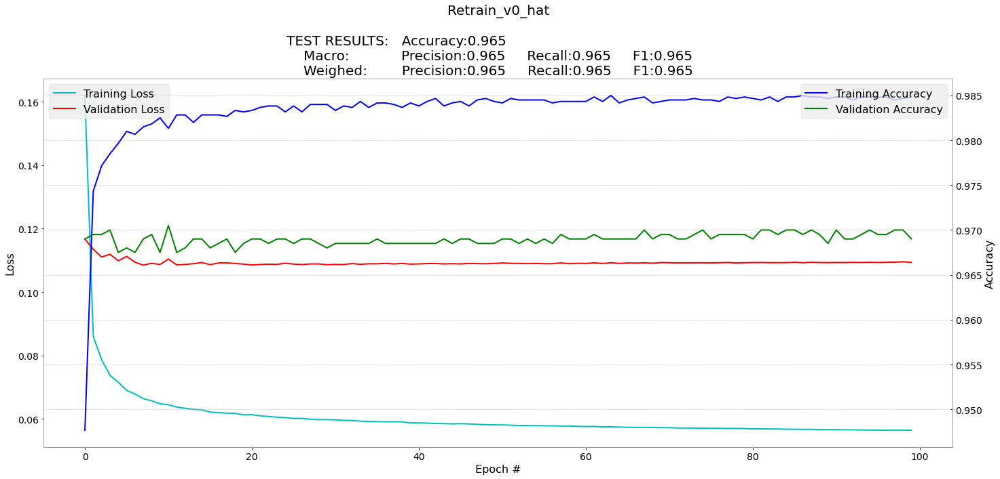

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.964
True: 0.968
False: 0.96

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten (Flatten)            (None, 512)               0         
_________________________________________________________________
dense (Dense)                (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.1,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=4, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/4
47/47 [==============================] - 3s 10ms/step - loss: 0.1698 - accuracy: 0.9378 - val_loss: 0.1134 - val_accuracy: 0.9670
Epoch 2/4
47/47 [==============================] - 0s 5ms/step - loss: 0.0867 - accuracy: 0.9757 - val_loss: 0.1089 - val_accuracy: 0.9665
Epoch 3/4
47/47 [==============================] - 0s 5ms/step - loss: 0.0782 - accuracy: 0.9767 - val_loss: 0.1057 - val_accuracy: 0.9665
Epoch 4/4
47/47 [==============================] - 0s 6ms/step - loss: 0.0742 - accuracy: 0.9780 - val_loss: 0.1076 - val_accuracy: 0.9690


1616

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.964
True: 0.968
False: 0.96
              precision    recall  f1-score   support

           0       0.96      0.97      0.96      4000
           1       0.97      0.96      0.96      4000

    accuracy                           0.96      8000
   macro avg       0.96      0.96      0.96      8000
weighted avg       0.96      0.96      0.96      8000



#### Gráfico de entrenamiento

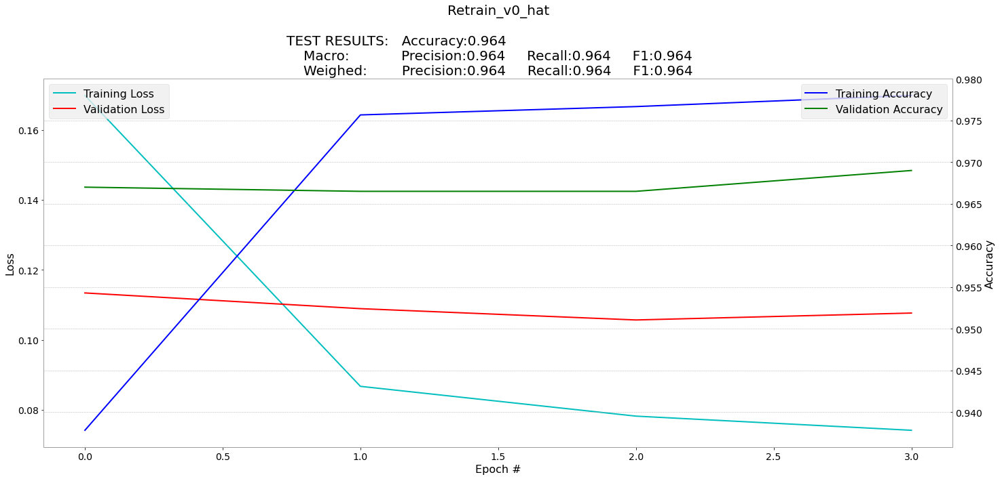

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.966
True: 0.9655
False: 0.9665

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.1,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 1s 10ms/step - loss: 0.1893 - accuracy: 0.9320 - val_loss: 0.1275 - val_accuracy: 0.9660
Epoch 2/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.0907 - accuracy: 0.9740 - val_loss: 0.1208 - val_accuracy: 0.9660
Epoch 3/1000
47/47 [==============================] - 0s 4ms/step - loss: 0.0819 - accuracy: 0.9770 - val_loss: 0.1133 - val_accuracy: 0.9675
Epoch 4/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.0763 - accuracy: 0.9788 - val_loss: 0.1143 - val_accuracy: 0.9685
Epoch 5/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.0742 - accuracy: 0.9795 - val_loss: 0.1111 - val_accuracy: 0.9670
Epoch 6/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.0721 - accuracy: 0.9787 - val_loss: 0.1175 - val_accuracy: 0.9695
Epoch 7/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.0715 - accuracy: 0.9802 - val_loss: 0.1096 - val_accuracy: 0.9690
Epoch

2677

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.966
True: 0.9655
False: 0.9665
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      4000
           1       0.97      0.97      0.97      4000

    accuracy                           0.97      8000
   macro avg       0.97      0.97      0.97      8000
weighted avg       0.97      0.97      0.97      8000



#### Gráfico de entrenamiento

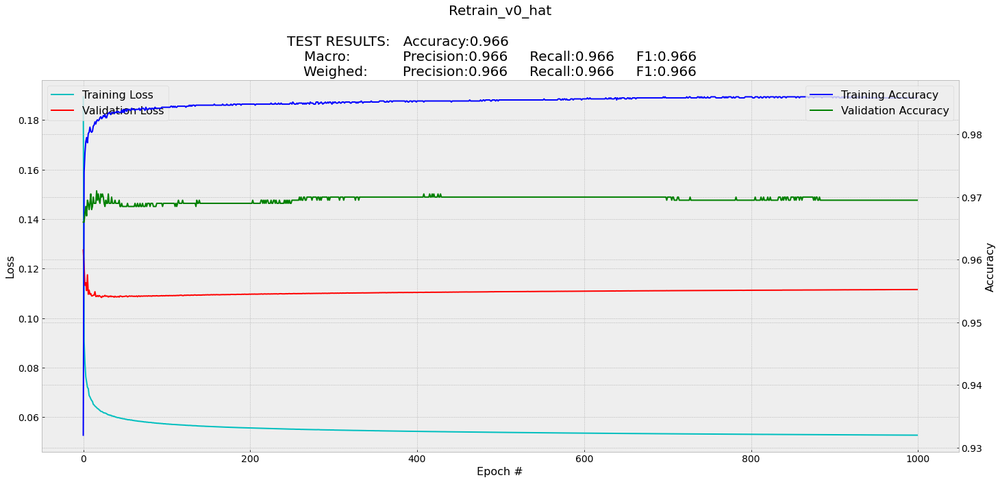

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.96375
True: 0.96025
False: 0.96725

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.01,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=100, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/100
47/47 [==============================] - 1s 8ms/step - loss: 0.3596 - accuracy: 0.8658 - val_loss: 0.2310 - val_accuracy: 0.9385
Epoch 2/100
47/47 [==============================] - 0s 4ms/step - loss: 0.2049 - accuracy: 0.9485 - val_loss: 0.1952 - val_accuracy: 0.9500
Epoch 3/100
47/47 [==============================] - 0s 5ms/step - loss: 0.1783 - accuracy: 0.9577 - val_loss: 0.1791 - val_accuracy: 0.9545
Epoch 4/100
47/47 [==============================] - 0s 4ms/step - loss: 0.1645 - accuracy: 0.9608 - val_loss: 0.1686 - val_accuracy: 0.9555
Epoch 5/100
47/47 [==============================] - 0s 5ms/step - loss: 0.1547 - accuracy: 0.9650 - val_loss: 0.1613 - val_accuracy: 0.9590
Epoch 6/100
47/47 [==============================] - 0s 4ms/step - loss: 0.1479 - accuracy: 0.9653 - val_loss: 0.1557 - val_accuracy: 0.9600
Epoch 7/100
47/47 [==============================] - 0s 4ms/step - loss: 0.1426 - accuracy: 0.9668 - val_loss: 0.1514 - val_accuracy: 0.9605
Epoch 8/100
4

2677

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.96375
True: 0.96025
False: 0.96725
              precision    recall  f1-score   support

           0       0.97      0.96      0.96      4000
           1       0.96      0.97      0.96      4000

    accuracy                           0.96      8000
   macro avg       0.96      0.96      0.96      8000
weighted avg       0.96      0.96      0.96      8000



#### Gráfico de entrenamiento

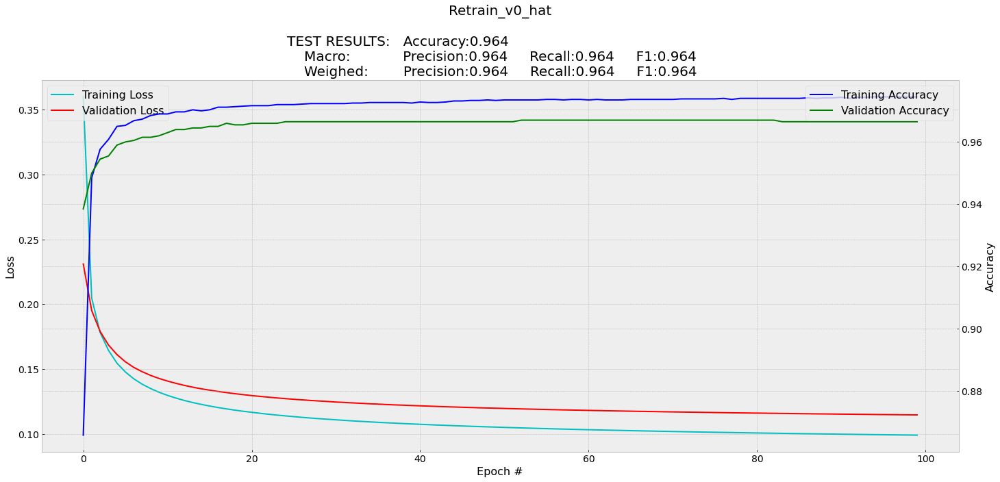

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.965125
True: 0.96225
False: 0.968

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.01,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=60, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/60
47/47 [==============================] - 1s 13ms/step - loss: 0.3448 - accuracy: 0.8802 - val_loss: 0.2270 - val_accuracy: 0.9420
Epoch 2/60
47/47 [==============================] - 0s 5ms/step - loss: 0.1958 - accuracy: 0.9540 - val_loss: 0.1925 - val_accuracy: 0.9535
Epoch 3/60
47/47 [==============================] - 0s 5ms/step - loss: 0.1714 - accuracy: 0.9630 - val_loss: 0.1764 - val_accuracy: 0.9570
Epoch 4/60
47/47 [==============================] - 0s 5ms/step - loss: 0.1581 - accuracy: 0.9665 - val_loss: 0.1664 - val_accuracy: 0.9595
Epoch 5/60
47/47 [==============================] - 0s 6ms/step - loss: 0.1493 - accuracy: 0.9685 - val_loss: 0.1593 - val_accuracy: 0.9615
Epoch 6/60
47/47 [==============================] - 0s 5ms/step - loss: 0.1429 - accuracy: 0.9687 - val_loss: 0.1541 - val_accuracy: 0.9630
Epoch 7/60
47/47 [==============================] - 0s 6ms/step - loss: 0.1380 - accuracy: 0.9693 - val_loss: 0.1500 - val_accuracy: 0.9625
Epoch 8/60
47/47 [=

2677

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.965125
True: 0.96225
False: 0.968
              precision    recall  f1-score   support

           0       0.97      0.96      0.97      4000
           1       0.96      0.97      0.97      4000

    accuracy                           0.97      8000
   macro avg       0.97      0.97      0.97      8000
weighted avg       0.97      0.97      0.97      8000



#### Gráfico de entrenamiento

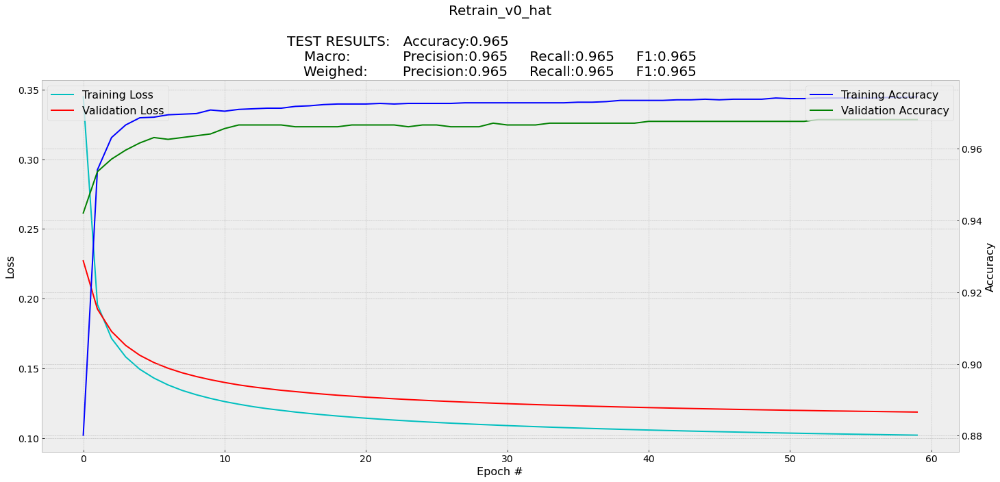

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.847125
True: 0.83725
False: 0.857

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=100, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/100
47/47 [==============================] - 1s 8ms/step - loss: 0.8950 - accuracy: 0.5670 - val_loss: 0.7866 - val_accuracy: 0.6220
Epoch 2/100
47/47 [==============================] - 0s 4ms/step - loss: 0.7368 - accuracy: 0.6650 - val_loss: 0.7215 - val_accuracy: 0.6705
Epoch 3/100
47/47 [==============================] - 0s 4ms/step - loss: 0.6891 - accuracy: 0.7017 - val_loss: 0.6867 - val_accuracy: 0.6995
Epoch 4/100
47/47 [==============================] - 0s 5ms/step - loss: 0.6604 - accuracy: 0.7222 - val_loss: 0.6634 - val_accuracy: 0.7210
Epoch 5/100
47/47 [==============================] - 0s 5ms/step - loss: 0.6402 - accuracy: 0.7357 - val_loss: 0.6460 - val_accuracy: 0.7325
Epoch 6/100
47/47 [==============================] - 0s 5ms/step - loss: 0.6247 - accuracy: 0.7453 - val_loss: 0.6323 - val_accuracy: 0.7435
Epoch 7/100
47/47 [==============================] - 0s 4ms/step - loss: 0.6122 - accuracy: 0.7535 - val_loss: 0.6210 - val_accuracy: 0.7495
Epoch 8/100
4

2677

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.847125
True: 0.83725
False: 0.857
              precision    recall  f1-score   support

           0       0.85      0.84      0.85      4000
           1       0.84      0.86      0.85      4000

    accuracy                           0.85      8000
   macro avg       0.85      0.85      0.85      8000
weighted avg       0.85      0.85      0.85      8000



#### Gráfico de entrenamiento

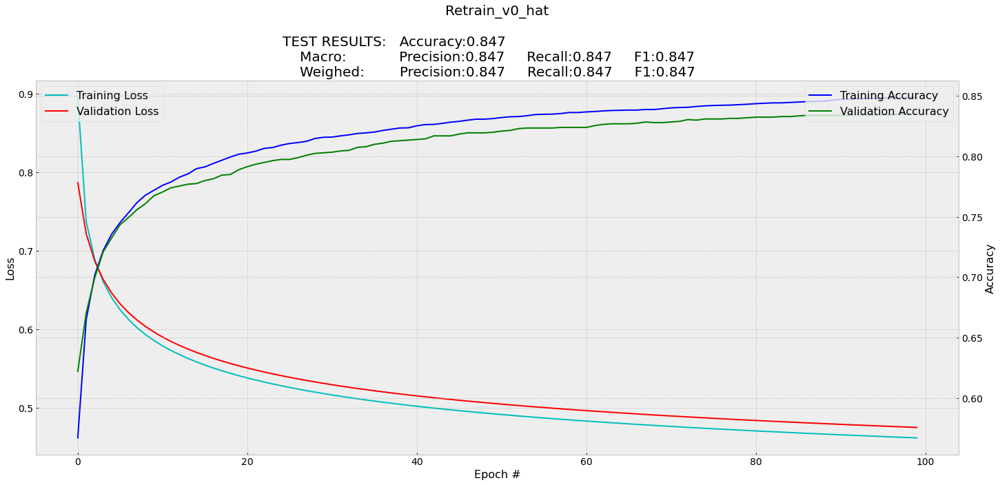

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.88625
True: 0.88
False: 0.8925

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.001,decay=0.2, beta_1=0.9, beta_2=0.98, epsilon=1e-06), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1500, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1500
47/47 [==============================] - 1s 10ms/step - loss: 1.1392 - accuracy: 0.4982 - val_loss: 0.9743 - val_accuracy: 0.5290
Epoch 2/1500
47/47 [==============================] - 0s 4ms/step - loss: 0.8974 - accuracy: 0.5753 - val_loss: 0.8660 - val_accuracy: 0.5930
Epoch 3/1500
47/47 [==============================] - 0s 5ms/step - loss: 0.8228 - accuracy: 0.6213 - val_loss: 0.8108 - val_accuracy: 0.6320
Epoch 4/1500
47/47 [==============================] - 0s 6ms/step - loss: 0.7792 - accuracy: 0.6465 - val_loss: 0.7742 - val_accuracy: 0.6615
Epoch 5/1500
47/47 [==============================] - 0s 5ms/step - loss: 0.7487 - accuracy: 0.6728 - val_loss: 0.7475 - val_accuracy: 0.6880
Epoch 6/1500
47/47 [==============================] - 0s 5ms/step - loss: 0.7257 - accuracy: 0.6893 - val_loss: 0.7267 - val_accuracy: 0.7030
Epoch 7/1500
47/47 [==============================] - 0s 4ms/step - loss: 0.7075 - accuracy: 0.7058 - val_loss: 0.7098 - val_accuracy: 0.7170
Epoch

2677

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.88625
True: 0.88
False: 0.8925
              precision    recall  f1-score   support

           0       0.89      0.88      0.89      4000
           1       0.88      0.89      0.89      4000

    accuracy                           0.89      8000
   macro avg       0.89      0.89      0.89      8000
weighted avg       0.89      0.89      0.89      8000



#### Gráfico de entrenamiento

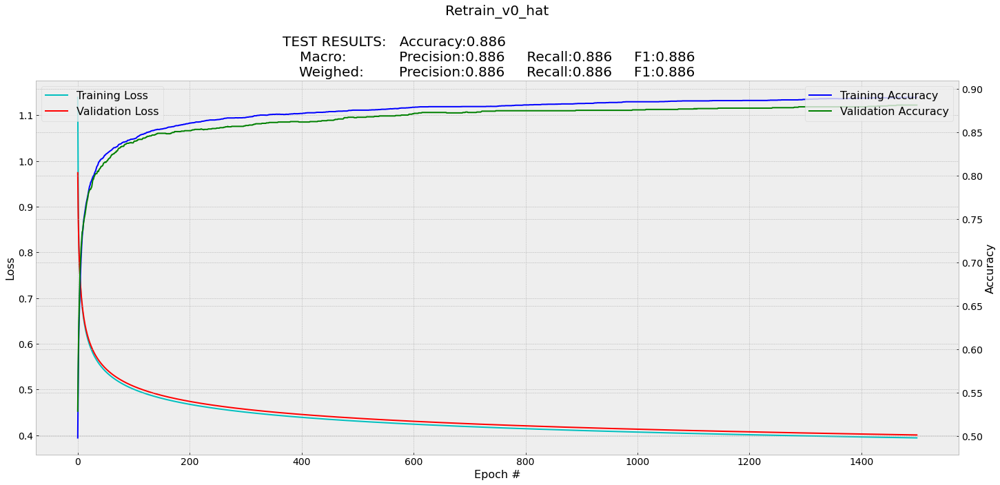

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.967125
True: 0.96625
False: 0.968

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0005,decay=0.0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=100, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/100
47/47 [==============================] - 1s 8ms/step - loss: 0.9350 - accuracy: 0.6040 - val_loss: 0.6298 - val_accuracy: 0.7695
Epoch 2/100
47/47 [==============================] - 0s 4ms/step - loss: 0.5332 - accuracy: 0.8152 - val_loss: 0.4542 - val_accuracy: 0.8540
Epoch 3/100
47/47 [==============================] - 0s 4ms/step - loss: 0.4047 - accuracy: 0.8800 - val_loss: 0.3642 - val_accuracy: 0.8940
Epoch 4/100
47/47 [==============================] - 0s 4ms/step - loss: 0.3300 - accuracy: 0.9127 - val_loss: 0.3068 - val_accuracy: 0.9215
Epoch 5/100
47/47 [==============================] - 0s 4ms/step - loss: 0.2799 - accuracy: 0.9338 - val_loss: 0.2670 - val_accuracy: 0.9345
Epoch 6/100
47/47 [==============================] - 0s 4ms/step - loss: 0.2444 - accuracy: 0.9470 - val_loss: 0.2374 - val_accuracy: 0.9445
Epoch 7/100
47/47 [==============================] - 0s 5ms/step - loss: 0.2179 - accuracy: 0.9543 - val_loss: 0.2156 - val_accuracy: 0.9490
Epoch 8/100
4

2676

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.967125
True: 0.96625
False: 0.968
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      4000
           1       0.97      0.97      0.97      4000

    accuracy                           0.97      8000
   macro avg       0.97      0.97      0.97      8000
weighted avg       0.97      0.97      0.97      8000



#### Gráfico de entrenamiento

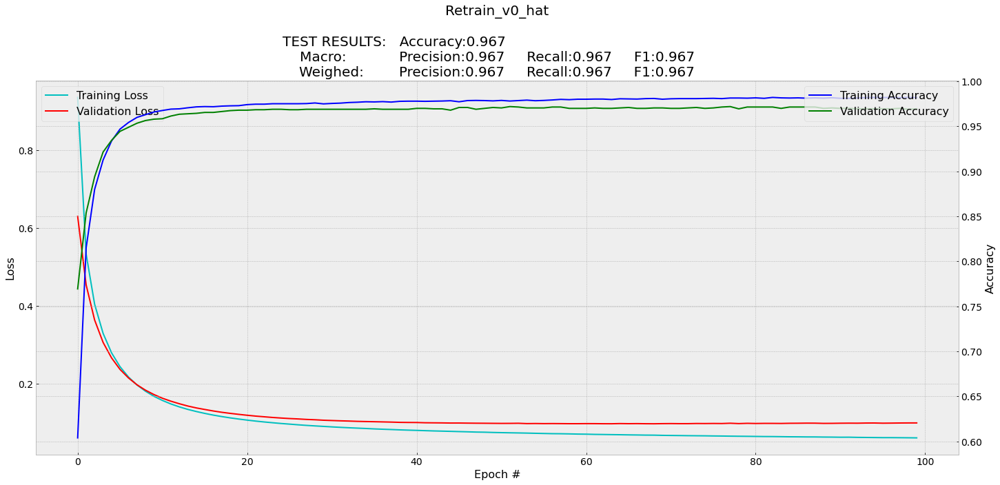

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### CLIP 
All: 0.958375
True: 0.9585
False: 0.95825
              pr

#### Crear modelo

In [ ]:
Data['Model Name'] = 'Retrain_v0'+Name_feature
Description=Data['Model Name']
img_features_shape= np.shape(Data['Training']['Images']['Train'][0])

#BASE MODEL
# Definimos entrada
inputs = Input(shape=img_features_shape)

# TOP MODEL
xfc = Flatten()(inputs)
predictions = Dense(4, activation="softmax")(xfc)
Data['Trained Model'] = Model(inputs=inputs, outputs=predictions)

Data['Trained Model'].summary()

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 1, 512)]          0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 512)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 4)                 2052      
Total params: 2,052
Trainable params: 2,052
Non-trainable params: 0
_________________________________________________________________


#### Entrenar modelo

In [ ]:
gc.collect()

Data['Trained Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0005,decay=0.0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"]) 

Data['H']  = Data['Trained Model'].fit(np.array(Data['Training']['Images']['Train']),
                                                         np.array(Data['Training']['Classes']['Train']),
                                                         batch_size=128, epochs=1000, 
                                                         validation_data=(np.array(Data['Training']['Images']['Validate']),
                                                                          np.array(Data['Training']['Classes']['Validate'])))

gc.collect()

Epoch 1/1000
47/47 [==============================] - 1s 9ms/step - loss: 1.0583 - accuracy: 0.5262 - val_loss: 0.6931 - val_accuracy: 0.7345
Epoch 2/1000
47/47 [==============================] - 0s 6ms/step - loss: 0.5683 - accuracy: 0.8112 - val_loss: 0.4869 - val_accuracy: 0.8465
Epoch 3/1000
47/47 [==============================] - 0s 6ms/step - loss: 0.4238 - accuracy: 0.8787 - val_loss: 0.3871 - val_accuracy: 0.8825
Epoch 4/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.3440 - accuracy: 0.9093 - val_loss: 0.3246 - val_accuracy: 0.9125
Epoch 5/1000
47/47 [==============================] - 0s 7ms/step - loss: 0.2914 - accuracy: 0.9305 - val_loss: 0.2818 - val_accuracy: 0.9255
Epoch 6/1000
47/47 [==============================] - 0s 5ms/step - loss: 0.2541 - accuracy: 0.9415 - val_loss: 0.2503 - val_accuracy: 0.9380
Epoch 7/1000
47/47 [==============================] - 0s 6ms/step - loss: 0.2264 - accuracy: 0.9485 - val_loss: 0.2264 - val_accuracy: 0.9420
Epoch 

2677

#### Evaluar modelo

In [ ]:
Data['Predictions'] = Data['Trained Model'].predict(np.array(Data['Training']['Images']['Test']), batch_size=128)


print('All:',np.sum(Data['Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Predictions'].argmax(axis=1)))

All: 0.958375
True: 0.9585
False: 0.95825
              precision    recall  f1-score   support

           0       0.96      0.96      0.96      4000
           1       0.96      0.96      0.96      4000

    accuracy                           0.96      8000
   macro avg       0.96      0.96      0.96      8000
weighted avg       0.96      0.96      0.96      8000



#### Gráfico de entrenamiento

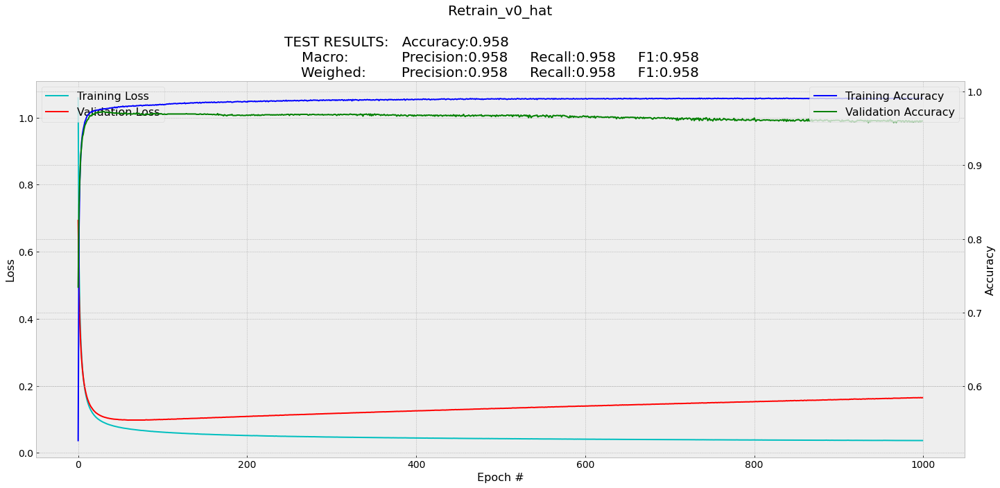

In [ ]:
# Gráficas
N_epochs=len(Data['H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.94025
True: 0.95925
False: 0.92125

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

80150528/80134624 [==============================] - 1s 0us/step
Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
____________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 110s 1s/step - loss: 0.9646 - accuracy: 0.7707 - val_loss: 0.2405 - val_accuracy: 0.9005
Epoch 2/10
47/47 [==============================] - 49s 1s/step - loss: 0.2154 - accuracy: 0.9215 - val_loss: 0.2028 - val_accuracy: 0.9250
Epoch 3/10
47/47 [==============================] - 49s 1s/step - loss: 0.1557 - accuracy: 0.9448 - val_loss: 0.1800 - val_accuracy: 0.9255
Epoch 4/10
47/47 [==============================] - 49s 1s/step - loss: 0.1068 - accuracy: 0.9598 - val_loss: 0.1895 - val_accuracy: 0.9310
Epoch 5/10
47/47 [==============================] - 49s 1s/step - loss: 0.0785 - accuracy: 0.9720 - val_loss: 0.1917 - val_accuracy: 0.9370
Epoch 6/10
47/47 [==============================] - 49s 1s/step - loss: 0.0369 - accuracy: 0.9883 - val_loss: 0.1911 - val_accuracy: 0.9390
Epoch 7/10
47/47 [==============================] - 49s 1s/step - loss: 0.0488 - accuracy: 0.9827 - val_loss: 0.2121 - val_accuracy: 0.9210
Epoch 8/10
47/47 [=

1621

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.94025
True: 0.95925
False: 0.92125
              precision    recall  f1-score   support

           0       0.92      0.96      0.94      4000
           1       0.96      0.92      0.94      4000

    accuracy                           0.94      8000
   macro avg       0.94      0.94      0.94      8000
weighted avg       0.94      0.94      0.94      8000



#### Gráfico de entrenamiento

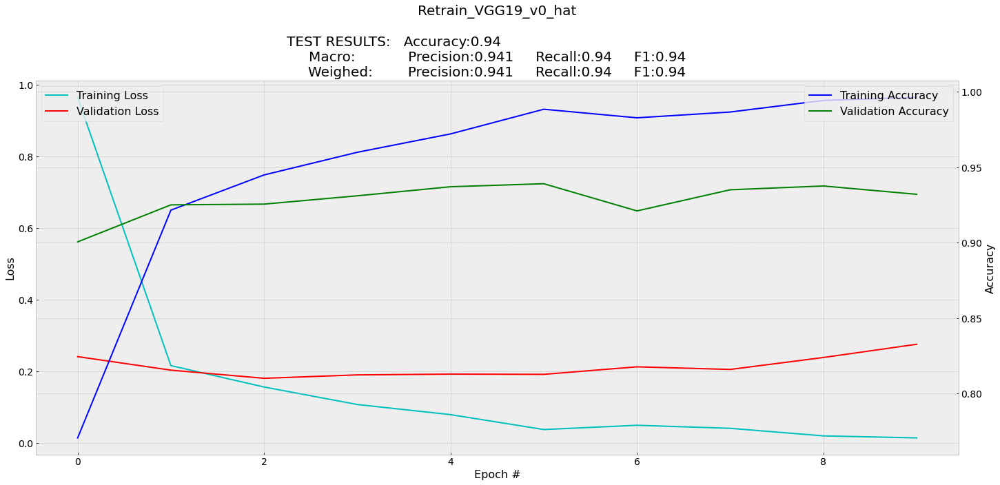

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.94375
True: 0.94475
False: 0.94275

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

80150528/80134624 [==============================] - 1s 0us/step
Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
____________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 116s 2s/step - loss: 0.8081 - accuracy: 0.8083 - val_loss: 0.2046 - val_accuracy: 0.9175
Epoch 2/20
47/47 [==============================] - 52s 1s/step - loss: 0.1798 - accuracy: 0.9332 - val_loss: 0.1845 - val_accuracy: 0.9240
Epoch 3/20
47/47 [==============================] - 52s 1s/step - loss: 0.1254 - accuracy: 0.9543 - val_loss: 0.1852 - val_accuracy: 0.9285
Epoch 4/20
47/47 [==============================] - 52s 1s/step - loss: 0.0676 - accuracy: 0.9782 - val_loss: 0.1922 - val_accuracy: 0.9285
Epoch 5/20
47/47 [==============================] - 52s 1s/step - loss: 0.0370 - accuracy: 0.9892 - val_loss: 0.2012 - val_accuracy: 0.9380
Epoch 6/20
47/47 [==============================] - 52s 1s/step - loss: 0.0184 - accuracy: 0.9962 - val_loss: 0.2358 - val_accuracy: 0.9380
Epoch 7/20
47/47 [==============================] - 52s 1s/step - loss: 0.0059 - accuracy: 0.9995 - val_loss: 0.2737 - val_accuracy: 0.9415
Epoch 8/20
47/47 [=

6

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.94375
True: 0.94475
False: 0.94275
              precision    recall  f1-score   support

           0       0.94      0.94      0.94      4000
           1       0.94      0.94      0.94      4000

    accuracy                           0.94      8000
   macro avg       0.94      0.94      0.94      8000
weighted avg       0.94      0.94      0.94      8000



#### Gráfico de entrenamiento

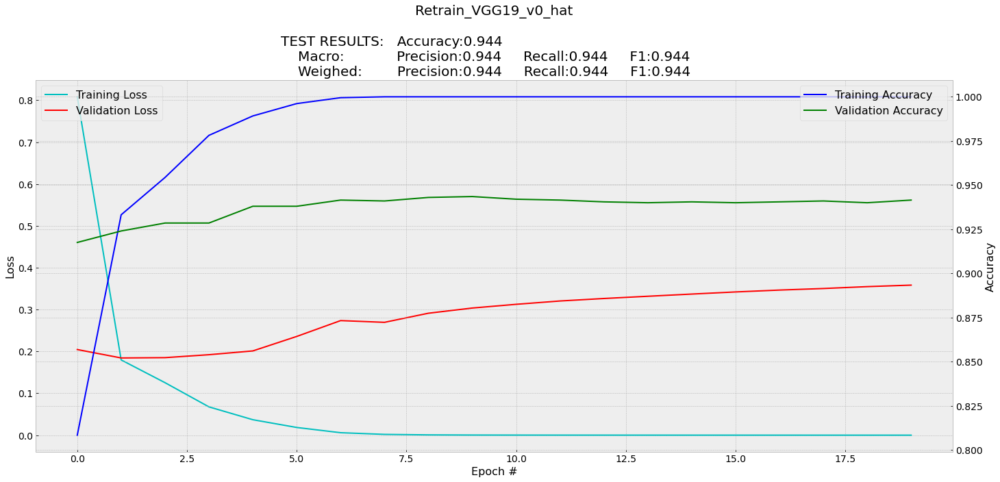

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.922625
True: 0.9255
False: 0.91975

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 51s 1s/step - loss: 1.3598 - accuracy: 0.7633 - val_loss: 0.3544 - val_accuracy: 0.8690
Epoch 2/10
47/47 [==============================] - 49s 1s/step - loss: 0.2804 - accuracy: 0.8972 - val_loss: 0.2580 - val_accuracy: 0.9045
Epoch 3/10
47/47 [==============================] - 49s 1s/step - loss: 0.1817 - accuracy: 0.9342 - val_loss: 0.2339 - val_accuracy: 0.9160
Epoch 4/10
47/47 [==============================] - 49s 1s/step - loss: 0.1275 - accuracy: 0.9575 - val_loss: 0.2300 - val_accuracy: 0.9205
Epoch 5/10
47/47 [==============================] - 49s 1s/step - loss: 0.0898 - accuracy: 0.9728 - val_loss: 0.2298 - val_accuracy: 0.9225
Epoch 6/10
47/47 [==============================] - 49s 1s/step - loss: 0.0608 - accuracy: 0.9838 - val_loss: 0.2338 - val_accuracy: 0.9215
Epoch 7/10
47/47 [==============================] - 49s 1s/step - loss: 0.0409 - accuracy: 0.9917 - val_loss: 0.2437 - val_accuracy: 0.9245
Epoch 8/10
47/47 [==

5571

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.922625
True: 0.9255
False: 0.91975
              precision    recall  f1-score   support

           0       0.92      0.93      0.92      4000
           1       0.93      0.92      0.92      4000
           2       0.00      0.00      0.00         0

    accuracy                           0.92      8000
   macro avg       0.62      0.62      0.62      8000
weighted avg       0.92      0.92      0.92      8000



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


#### Gráfico de entrenamiento

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


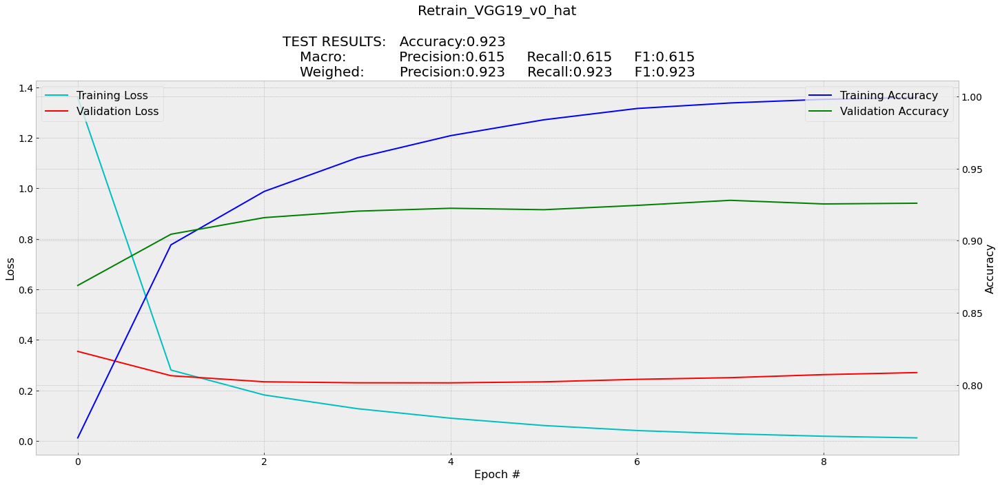

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.9325
True: 0.9145
False: 0.9505:


#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 51s 1s/step - loss: 1.0879 - accuracy: 0.6288 - val_loss: 0.3886 - val_accuracy: 0.8315
Epoch 2/10
47/47 [==============================] - 49s 1s/step - loss: 0.3535 - accuracy: 0.8517 - val_loss: 0.2816 - val_accuracy: 0.8930
Epoch 3/10
47/47 [==============================] - 49s 1s/step - loss: 0.2599 - accuracy: 0.8970 - val_loss: 0.2070 - val_accuracy: 0.9240
Epoch 4/10
47/47 [==============================] - 49s 1s/step - loss: 0.2158 - accuracy: 0.9190 - val_loss: 0.2026 - val_accuracy: 0.9205
Epoch 5/10
47/47 [==============================] - 49s 1s/step - loss: 0.2007 - accuracy: 0.9237 - val_loss: 0.1673 - val_accuracy: 0.9345
Epoch 6/10
47/47 [==============================] - 49s 1s/step - loss: 0.1563 - accuracy: 0.9418 - val_loss: 0.1997 - val_accuracy: 0.9120
Epoch 7/10
47/47 [==============================] - 49s 1s/step - loss: 0.1360 - accuracy: 0.9517 - val_loss: 0.1619 - val_accuracy: 0.9400
Epoch 8/10
47/47 [==

5571

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.9325
True: 0.9145
False: 0.9505
              precision    recall  f1-score   support

           0       0.95      0.91      0.93      4000
           1       0.92      0.95      0.93      4000

    accuracy                           0.93      8000
   macro avg       0.93      0.93      0.93      8000
weighted avg       0.93      0.93      0.93      8000



#### Gráfico de entrenamiento

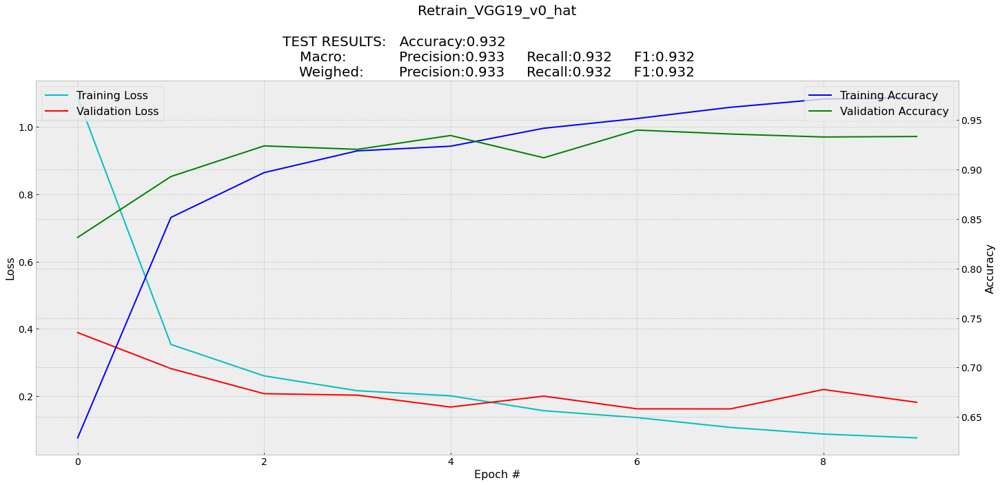

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### VGG19 
All: 0.948625
True: 0.943
False: 0.95425

#### Crear modelo

In [ ]:
Data['Model Name VGG19'] = 'Retrain_VGG19_v0'+Name_feature
Description=Data['Model Name VGG19']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['VGG19 Model'] = VGG19( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['VGG19 Model'].summary()
# for layer in Data['VGG19 Model'].layers: 
#   if layer.name == 'block5_conv1':  # block5_conv1 
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['VGG19 Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['VGG19 Model'] = Model(Data['VGG19 Model'].input, x) 

Data['VGG19 Model'].summary()

Model: "model_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         [(None, 112, 112, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 112, 112, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 112, 112, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 56, 56, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 56, 56, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 56, 56, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 28, 28, 128)       0   

#### Entrenar modelo

In [ ]:
gc.collect()

Data['VGG19 Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['VGG19 Model H']  = Data['VGG19 Model'].fit(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=20, 
                                                         validation_data=(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/20
47/47 [==============================] - 54s 1s/step - loss: 0.9766 - accuracy: 0.7625 - val_loss: 0.2489 - val_accuracy: 0.9045
Epoch 2/20
47/47 [==============================] - 52s 1s/step - loss: 0.2476 - accuracy: 0.9047 - val_loss: 0.2405 - val_accuracy: 0.9110
Epoch 3/20
47/47 [==============================] - 52s 1s/step - loss: 0.1765 - accuracy: 0.9330 - val_loss: 0.1637 - val_accuracy: 0.9380
Epoch 4/20
47/47 [==============================] - 52s 1s/step - loss: 0.1282 - accuracy: 0.9540 - val_loss: 0.2318 - val_accuracy: 0.9180
Epoch 5/20
47/47 [==============================] - 52s 1s/step - loss: 0.1047 - accuracy: 0.9623 - val_loss: 0.1643 - val_accuracy: 0.9425
Epoch 6/20
47/47 [==============================] - 52s 1s/step - loss: 0.0720 - accuracy: 0.9727 - val_loss: 0.1697 - val_accuracy: 0.9370
Epoch 7/20
47/47 [==============================] - 52s 1s/step - loss: 0.0572 - accuracy: 0.9815 - val_loss: 0.1694 - val_accuracy: 0.9415
Epoch 8/20
47/47 [==

13193

#### Evaluar modelo

In [ ]:
Data['VGG19 Model Predictions'] = Data['VGG19 Model'].predict(tf.keras.applications.vgg19.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['VGG19 Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['VGG19 Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))

print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['VGG19 Model Predictions'].argmax(axis=1)))

All: 0.948625
True: 0.943
False: 0.95425
              precision    recall  f1-score   support

           0       0.95      0.94      0.95      4000
           1       0.94      0.95      0.95      4000

    accuracy                           0.95      8000
   macro avg       0.95      0.95      0.95      8000
weighted avg       0.95      0.95      0.95      8000



#### Gráfico de entrenamiento

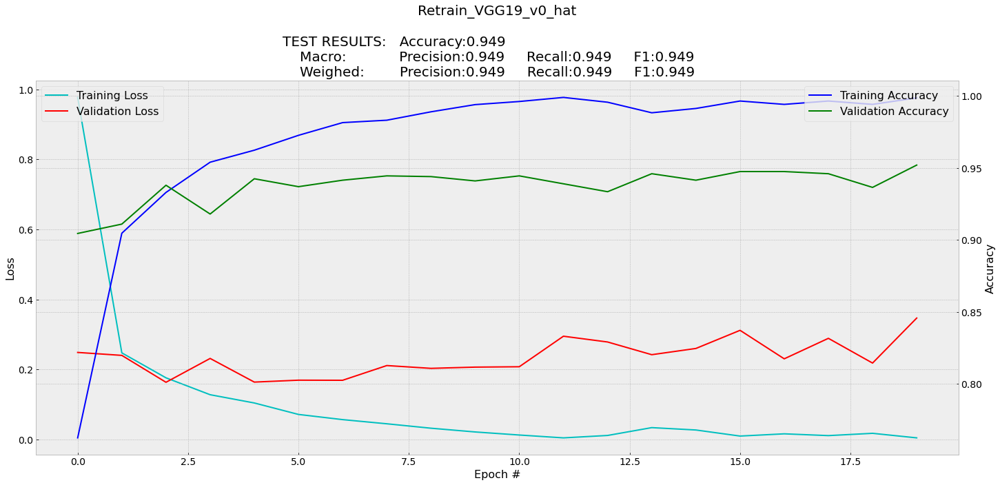

In [ ]:
# Gráficas
N_epochs=len(Data['VGG19 Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['VGG19 Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['VGG19 Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.919875
True: 0.91875
False: 0.921

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

83697664/83683744 [==============================] - 2s 0us/step
Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_8[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
___________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 74s 1s/step - loss: 0.4176 - accuracy: 0.8155 - val_loss: 0.4858 - val_accuracy: 0.8875
Epoch 2/10
47/47 [==============================] - 60s 1s/step - loss: 0.0871 - accuracy: 0.9717 - val_loss: 0.2627 - val_accuracy: 0.9060
Epoch 3/10
47/47 [==============================] - 60s 1s/step - loss: 0.0172 - accuracy: 0.9977 - val_loss: 0.2693 - val_accuracy: 0.9110
Epoch 4/10
47/47 [==============================] - 60s 1s/step - loss: 0.0049 - accuracy: 0.9995 - val_loss: 0.2651 - val_accuracy: 0.9150
Epoch 5/10
47/47 [==============================] - 60s 1s/step - loss: 0.0023 - accuracy: 0.9998 - val_loss: 0.2838 - val_accuracy: 0.9135
Epoch 6/10
47/47 [==============================] - 60s 1s/step - loss: 0.0012 - accuracy: 0.9998 - val_loss: 0.2935 - val_accuracy: 0.9170
Epoch 7/10
47/47 [==============================] - 61s 1s/step - loss: 7.7155e-04 - accuracy: 1.0000 - val_loss: 0.3101 - val_accuracy: 0.9160
Epoch 8/10
47/47

1624

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.919875
True: 0.91875
False: 0.921
              precision    recall  f1-score   support

           0       0.92      0.92      0.92      4000
           1       0.92      0.92      0.92      4000

    accuracy                           0.92      8000
   macro avg       0.92      0.92      0.92      8000
weighted avg       0.92      0.92      0.92      8000



#### Gráfico de entrenamiento

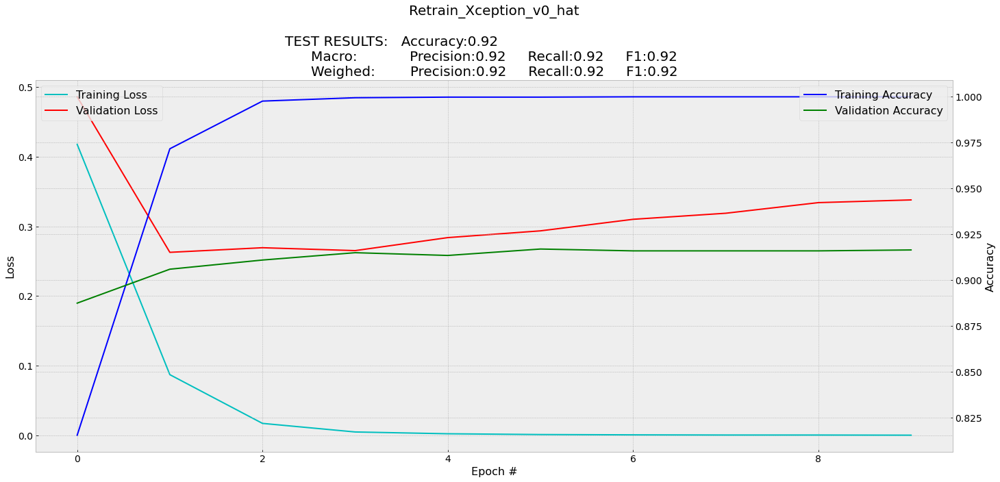

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.91775
True: 0.9115
False: 0.924

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

83697664/83683744 [==============================] - 1s 0us/step
Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_8[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
___________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=15, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/15
47/47 [==============================] - 77s 1s/step - loss: 0.4122 - accuracy: 0.8135 - val_loss: 0.4424 - val_accuracy: 0.8835
Epoch 2/15
47/47 [==============================] - 63s 1s/step - loss: 0.0739 - accuracy: 0.9782 - val_loss: 0.3148 - val_accuracy: 0.9015
Epoch 3/15
47/47 [==============================] - 64s 1s/step - loss: 0.0154 - accuracy: 0.9987 - val_loss: 0.3188 - val_accuracy: 0.9080
Epoch 4/15
47/47 [==============================] - 63s 1s/step - loss: 0.0038 - accuracy: 0.9995 - val_loss: 0.2842 - val_accuracy: 0.9150
Epoch 5/15
47/47 [==============================] - 63s 1s/step - loss: 0.0021 - accuracy: 0.9997 - val_loss: 0.3042 - val_accuracy: 0.9165
Epoch 6/15
47/47 [==============================] - 63s 1s/step - loss: 0.0014 - accuracy: 0.9998 - val_loss: 0.2988 - val_accuracy: 0.9175
Epoch 7/15
47/47 [==============================] - 63s 1s/step - loss: 0.0011 - accuracy: 0.9998 - val_loss: 0.3049 - val_accuracy: 0.9200
Epoch 8/15
47/47 [==

1625

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.91775
True: 0.9115
False: 0.924
              precision    recall  f1-score   support

           0       0.92      0.91      0.92      4000
           1       0.91      0.92      0.92      4000

    accuracy                           0.92      8000
   macro avg       0.92      0.92      0.92      8000
weighted avg       0.92      0.92      0.92      8000



#### Gráfico de entrenamiento

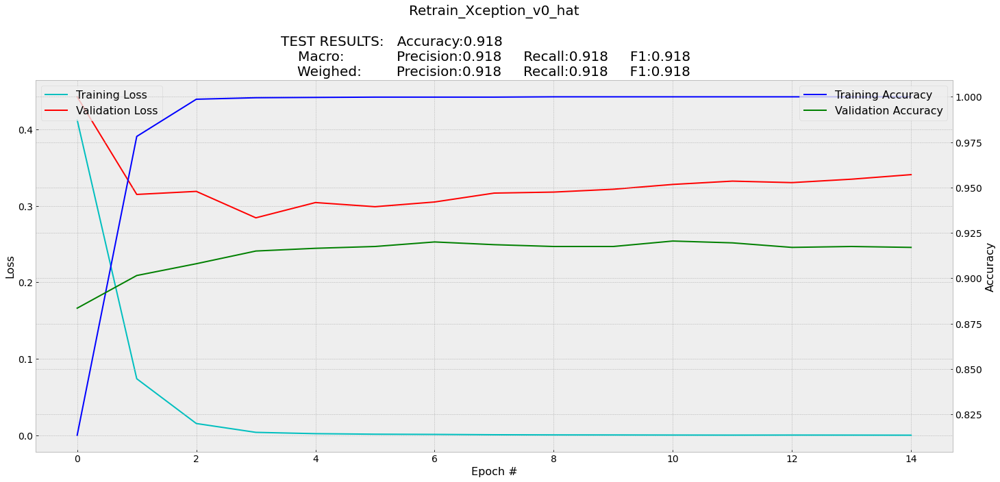

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.92225
True: 0.9345
False: 0.91

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_9[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.0001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=4, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/4
47/47 [==============================] - 70s 1s/step - loss: 0.4456 - accuracy: 0.8015 - val_loss: 0.3862 - val_accuracy: 0.8865
Epoch 2/4
47/47 [==============================] - 64s 1s/step - loss: 0.0907 - accuracy: 0.9693 - val_loss: 0.2473 - val_accuracy: 0.9115
Epoch 3/4
47/47 [==============================] - 64s 1s/step - loss: 0.0162 - accuracy: 0.9985 - val_loss: 0.2338 - val_accuracy: 0.9190
Epoch 4/4
47/47 [==============================] - 64s 1s/step - loss: 0.0047 - accuracy: 0.9995 - val_loss: 0.2488 - val_accuracy: 0.9175


20185

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.92225
True: 0.9345
False: 0.91
              precision    recall  f1-score   support

           0       0.91      0.93      0.92      4000
           1       0.93      0.91      0.92      4000

    accuracy                           0.92      8000
   macro avg       0.92      0.92      0.92      8000
weighted avg       0.92      0.92      0.92      8000



#### Gráfico de entrenamiento

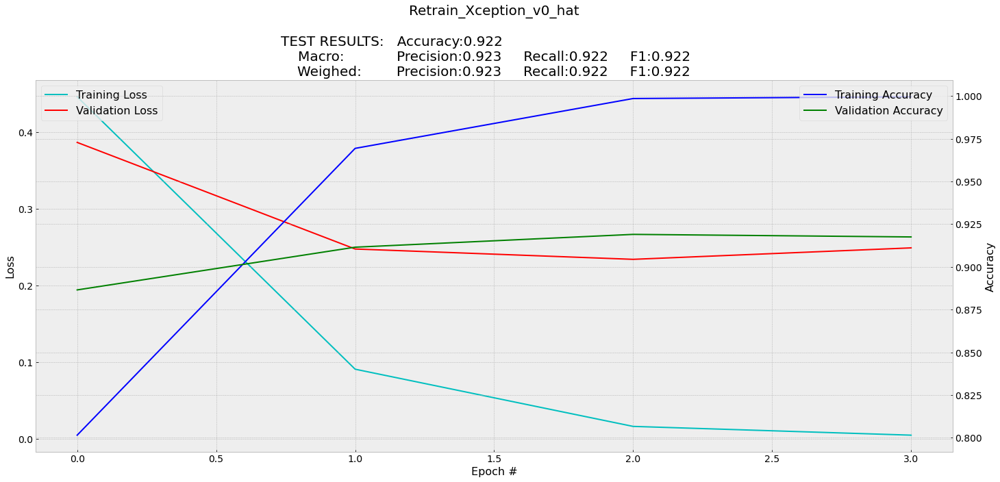

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.88775
True: 0.896
False: 0.8795

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_9[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00001,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 67s 1s/step - loss: 0.9385 - accuracy: 0.6002 - val_loss: 0.5278 - val_accuracy: 0.7595
Epoch 2/10
47/47 [==============================] - 61s 1s/step - loss: 0.5409 - accuracy: 0.7997 - val_loss: 0.4346 - val_accuracy: 0.8270
Epoch 3/10
47/47 [==============================] - 61s 1s/step - loss: 0.3786 - accuracy: 0.8652 - val_loss: 0.3749 - val_accuracy: 0.8520
Epoch 4/10
47/47 [==============================] - 61s 1s/step - loss: 0.2816 - accuracy: 0.9037 - val_loss: 0.3305 - val_accuracy: 0.8645
Epoch 5/10
47/47 [==============================] - 61s 1s/step - loss: 0.2161 - accuracy: 0.9308 - val_loss: 0.3013 - val_accuracy: 0.8715
Epoch 6/10
47/47 [==============================] - 61s 1s/step - loss: 0.1653 - accuracy: 0.9543 - val_loss: 0.2845 - val_accuracy: 0.8735
Epoch 7/10
47/47 [==============================] - 61s 1s/step - loss: 0.1246 - accuracy: 0.9708 - val_loss: 0.2827 - val_accuracy: 0.8745
Epoch 8/10
47/47 [==

20185

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.88775
True: 0.896
False: 0.8795
              precision    recall  f1-score   support

           0       0.88      0.90      0.89      4000
           1       0.89      0.88      0.89      4000

    accuracy                           0.89      8000
   macro avg       0.89      0.89      0.89      8000
weighted avg       0.89      0.89      0.89      8000



#### Gráfico de entrenamiento

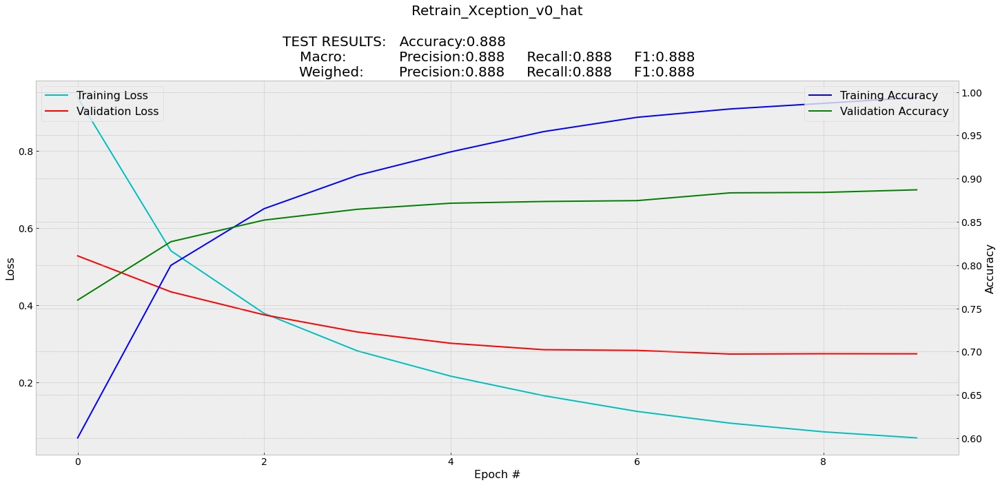

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.906375
True: 0.90075
False: 0.912

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_10 (InputLayer)           [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_10[0][0]                   
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=10, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/10
47/47 [==============================] - 67s 1s/step - loss: 0.5774 - accuracy: 0.7320 - val_loss: 0.3850 - val_accuracy: 0.8730
Epoch 2/10
47/47 [==============================] - 61s 1s/step - loss: 0.1719 - accuracy: 0.9388 - val_loss: 0.2724 - val_accuracy: 0.8965
Epoch 3/10
47/47 [==============================] - 61s 1s/step - loss: 0.0609 - accuracy: 0.9870 - val_loss: 0.2543 - val_accuracy: 0.9025
Epoch 4/10
47/47 [==============================] - 60s 1s/step - loss: 0.0209 - accuracy: 0.9978 - val_loss: 0.2519 - val_accuracy: 0.9090
Epoch 5/10
47/47 [==============================] - 61s 1s/step - loss: 0.0088 - accuracy: 0.9997 - val_loss: 0.2750 - val_accuracy: 0.9070
Epoch 6/10
47/47 [==============================] - 60s 1s/step - loss: 0.0048 - accuracy: 0.9998 - val_loss: 0.2820 - val_accuracy: 0.9095
Epoch 7/10
47/47 [==============================] - 60s 1s/step - loss: 0.0034 - accuracy: 0.9998 - val_loss: 0.2938 - val_accuracy: 0.9035
Epoch 8/10
47/47 [==

20185

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.906375
True: 0.90075
False: 0.912
              precision    recall  f1-score   support

           0       0.91      0.90      0.91      4000
           1       0.90      0.91      0.91      4000

    accuracy                           0.91      8000
   macro avg       0.91      0.91      0.91      8000
weighted avg       0.91      0.91      0.91      8000



#### Gráfico de entrenamiento

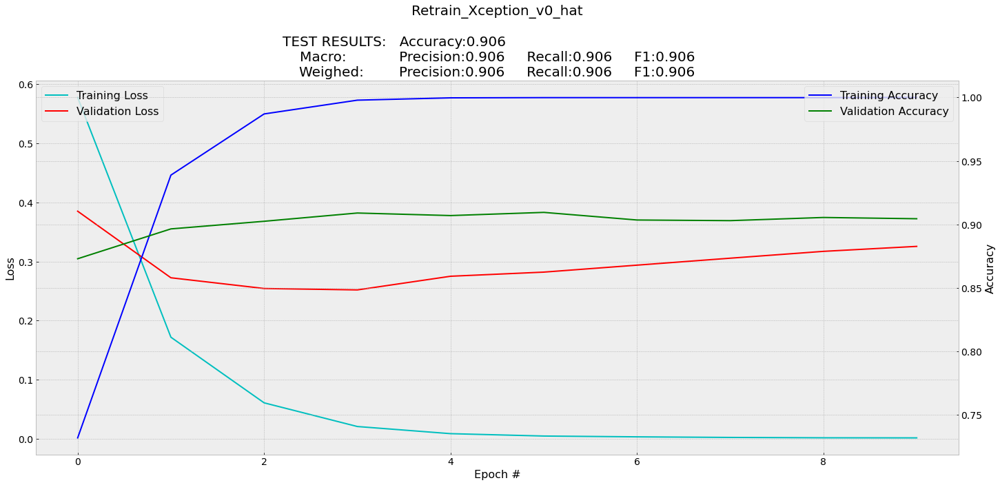

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

### Xception 
All: 0.91125
True: 0.952
False: 0.8705

#### Crear modelo

In [ ]:
Data['Model Name Xception'] = 'Retrain_Xception_v0'+Name_feature
Description=Data['Model Name Xception']
img_features_shape= np.shape(np.array(Img_List_reshape([Data['Training']['Images array']['Train'][0]])[0]))

Data['Xception Model'] = Xception( include_top=False,
    weights="imagenet",
    input_tensor=None,
    input_shape=img_features_shape,
    pooling=None)
    
# # Data['Xception Model'].summary()
# for layer in Data['Xception Model'].layers: 
#   if layer.name == 'block11_sepconv1 ':   # block14_sepconv1  
#     break 
#   layer.trainable = False 
#   print('Capa ' + layer.name + ' congelada...') 

last_layer = Data['Xception Model'].layers[-1].output 
x = Flatten()(last_layer) 
x = Dense(4, activation='softmax', name='Dense1')(x) 
Data['Xception Model'] = Model(Data['Xception Model'].input, x) 

Data['Xception Model'].summary()

Model: "model_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_10 (InputLayer)           [(None, 112, 112, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 55, 55, 32)   864         input_10[0][0]                   
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 55, 55, 32)   128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 55, 55, 32)   0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

#### Entrenar modelo

In [ ]:
gc.collect()

Data['Xception Model'].compile(loss="sparse_categorical_crossentropy", optimizer=Adam(learning_rate=0.00005,decay=0, beta_1=0.9, beta_2=0.999, epsilon=1e-08), metrics=["accuracy"])

Data['Xception Model H']  = Data['Xception Model'].fit(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Train'])))),
                                                         np.array(Data['Training']['Classes array']['Train']),
                                                         batch_size=128, epochs=4, 
                                                         validation_data=(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Validate'])))),
                                                                          np.array(Data['Training']['Classes array']['Validate'])))

gc.collect()

Epoch 1/4
47/47 [==============================] - 71s 1s/step - loss: 0.5923 - accuracy: 0.7382 - val_loss: 0.3362 - val_accuracy: 0.8855
Epoch 2/4
47/47 [==============================] - 64s 1s/step - loss: 0.1638 - accuracy: 0.9413 - val_loss: 0.2846 - val_accuracy: 0.9055
Epoch 3/4
47/47 [==============================] - 64s 1s/step - loss: 0.0538 - accuracy: 0.9890 - val_loss: 0.2742 - val_accuracy: 0.9025
Epoch 4/4
47/47 [==============================] - 64s 1s/step - loss: 0.0200 - accuracy: 0.9985 - val_loss: 0.2618 - val_accuracy: 0.9065


20186

#### Evaluar modelo

In [ ]:
Data['Xception Model Predictions'] = Data['Xception Model'].predict(tf.keras.applications.xception.preprocess_input(np.copy(np.array(Img_List_reshape(Data['Training']['Images array']['Test'])))), batch_size=128)

print('All:',np.sum(Data['Xception Model Predictions'].argmax(axis=1)==np.array(Data['Training']['Classes']['Test']))/len(Data['Training']['Classes']['Test']))
acc_0=0
acc_1=0
i=0
for pred in Data['Xception Model Predictions'].argmax(axis=1):
    if i % 2 == 0:
        if pred==0:
            acc_0+=1
    else:
        if pred==1:
            acc_1+=1
    i+=1

print('True:',acc_0/(len(Data['Training']['Classes']['Test'])/2))
print('False:',acc_1/(len(Data['Training']['Classes']['Test'])/2))
print(classification_report(np.array(Data['Training']['Classes']['Test']), Data['Xception Model Predictions'].argmax(axis=1)))

All: 0.91125
True: 0.952
False: 0.8705
              precision    recall  f1-score   support

           0       0.88      0.95      0.91      4000
           1       0.95      0.87      0.91      4000

    accuracy                           0.91      8000
   macro avg       0.91      0.91      0.91      8000
weighted avg       0.91      0.91      0.91      8000



#### Gráfico de entrenamiento

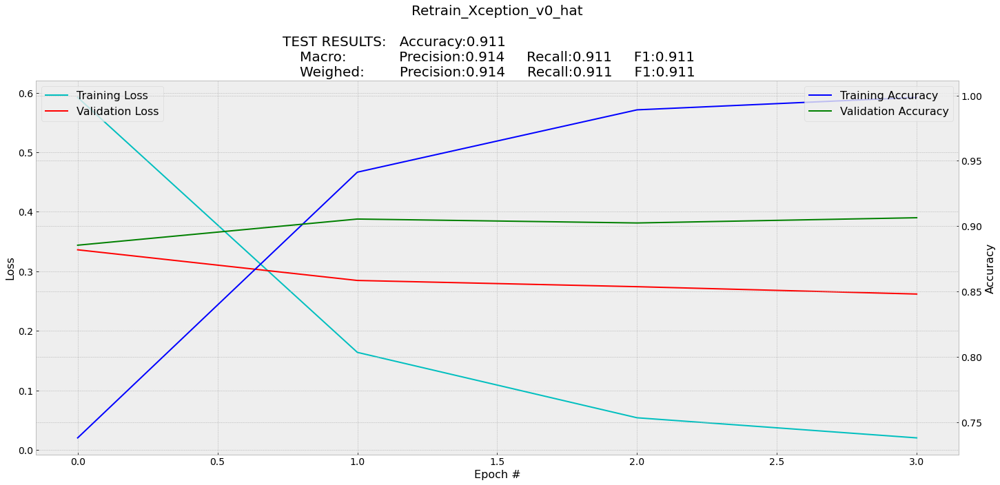

In [ ]:
# Gráficas
N_epochs=len(Data['Xception Model H'].history["loss"])
Title_Description=Description
Title_Description+='\n\nTEST RESULTS:   '
Title_Description+='Accuracy:'+str(np.round(accuracy_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1)),3))
Title_Description+='                                               \nMacro:       '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='macro'),3))
Title_Description+='\nWeighed:   '
Title_Description+='     Precision:'+str(np.round(precision_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     Recall:'+str(np.round(recall_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
Title_Description+='     F1:'+str(np.round(f1_score(Data['Training']['Classes']['Test'],Data['Xception Model Predictions'].argmax(axis=1),average='weighted'),3))
fig,ax = plt.subplots(figsize=(24,10))
ax.set_title(Title_Description, fontsize=20)
plt.style.use("bmh")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["loss"],'c', label="Training Loss")
ax.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_loss"], 'r', label="Validation Loss")
ax.set_xlabel("Epoch #",fontsize=16)
# ax.set_xlim(0,N_epochs)
ax.set_ylabel("Loss",fontsize=16)
ax.tick_params(labelsize=14)
ax.legend(loc='upper left',fontsize=16)

ax2=ax.twinx()
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["accuracy"],'b', label="Training Accuracy")
ax2.plot(np.arange(0, N_epochs), Data['Xception Model H'].history["val_accuracy"], 'g', label="Validation Accuracy")
ax2.set_ylabel("Accuracy",fontsize=16)
ax2.tick_params(labelsize=14)
ax2.legend(loc= 'upper right',fontsize=16)
plt.show()

# Etiqueta Celeba: "hat" - Pruebas con "hatted"

## Proceso

### CLIP crear "prompt" y preparar parámetros

In [ ]:
import torch
import clip
from PIL import Image
import glob

Name_feature='_hat2'
id_feature=35
Save_Data_Path=BASE_FOLDER_2+'Retrain_v0'+Name_feature+'.pkl'

Index_To_Test=[]
Label_To_Test=[]
Data_To_Train=[]
Label_To_Train=[]
Data = {'Training':{}, 'Model Name':{}, 'H':{}, 'Classes':{}}
Data['Training']={'Images':{},'Images array':{}, 'Classes':{}, 'Classes array':{}, 'Index':{}, 'H':{}}
Data['Training']['Images']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Images array']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes']={'Test':{}, 'Not Test':{}, 'Train':{}, 'Validate':{}}
Data['Training']['Classes array']={'Train':{}, 'Validate':{}}

clip_tokens=[ 'A picture of a person', 'A picture of a hatted person', 
             'A picture of a haired person','A picture of a bald person','A picture of a haired or bald person']

N_Tokens=len(clip_tokens)
print(N_Tokens)
print(clip_tokens)
for current_token in clip_tokens:
    print(current_token)

# [ 'A picture of a person',"A picture of a person with 5 o'clock shadow",'A picture of a person with arched eyebrows',
# 'A picture of an attractive person','A picture of a person with bags under eyes',
# 'A picture of a bald person','A picture of a person with bangs','A picture of a person with big lips',
# 'A picture of a person with big nose','A picture of a person with black hair',
# 'A picture of a person with blond hair','A blurry picture of a person',
# 'A picture of a person with brown hair','A picture of a person with bushy eyebrows',
# 'A picture of a chubby person','A picture of a person with double chin','A picture of a person with eyeglasses',
# 'A picture of a person with goatee','A picture of a person with gray hair','A picture of a person with heavy makeup',
# 'A picture of a person with high cheekbones','A picture of a male person',
# 'A picture of a person with mouth slightly open','A picture of a person with mustache',
# 'A picture of a person with narrow eyes','A picture of a person with no beard',
# 'A picture of a person with oval face','A picture of a person with pale skin','A picture of a person with pointy nose',
# 'A picture of a person with receding hairline','A picture of a person with rosy cheeks','A picture of a person with sideburns',
# 'A picture of a person who is smiling','A picture of a person with straight hair','A picture of a person with wavy hair',
# 'A picture of a person with earrings','A picture of a person with hat','A picture of a person with lipstick',
# 'A picture of a person with necklace','A picture of a person with necktie','A picture of a young person']

5
['A picture of a person', 'A picture of a hatted person', 'A picture of a haired person', 'A picture of a bald person', 'A picture of a haired or bald person']
A picture of a person
A picture of a hatted person
A picture of a haired person
A picture of a bald person
A picture of a haired or bald person


### Cargar CLIP

In [ ]:
clip_device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, clip_transform = clip.load("ViT-B/32", device=clip_device)
clip_text = clip.tokenize(clip_tokens).to(clip_device)

# CLIP features
text_features = clip_model.encode_text(clip_text)

test_index=1
test_image_path=Path_images+str(test_index).zfill(6)+'.jpg'
img_proeprocessed = clip_transform(Image.open(test_image_path)).unsqueeze(0).to(clip_device)
img_features = clip_model.encode_image(img_proeprocessed)
img_features_shape= img_features.shape

print('\n- Image Features:')
print('     Type:',type(img_features))
print('     Shape:',img_features_shape)
print('\n- Text Features:')
print('     Type:',type(text_features))
print('     Shape:',text_features.shape)
print('\n- Image Features Tensor:')
print(img_features)
print('\n- Text Features Tesor:')
print(text_features)


- Image Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([1, 512])

- Text Features:
     Type: <class 'torch.Tensor'>
     Shape: torch.Size([5, 512])

- Image Features Tensor:
tensor([[-6.0150e-02,  1.7044e-02, -9.9854e-02,  2.3523e-01, -6.8359e-02,
         -8.4814e-01, -3.7036e-01, -4.8169e-01, -3.1921e-02, -3.8666e-02,
         -5.1666e-02, -1.9775e-01,  6.2061e-01, -5.4565e-02,  7.4365e-01,
          4.4678e-02,  1.5791e+00, -4.6045e-01,  1.3513e-01, -1.4685e-01,
         -3.7012e-01, -3.7183e-01, -4.6509e-01, -2.8833e-01, -1.7578e-01,
         -1.3904e-01,  2.9028e-01, -9.5642e-02,  3.9746e-01,  1.3770e-01,
          5.1855e-01,  1.5613e-01,  8.7524e-02, -1.0674e-02, -9.4531e-01,
          2.2595e-01, -3.6133e-02,  4.6924e-01,  9.4604e-02,  1.5908e+00,
          2.1533e-01,  1.9360e-01, -5.3284e-02, -7.5500e-02, -6.1111e-03,
          1.4443e+00,  1.2891e-01,  5.3613e-01,  4.5630e-01,  3.9478e-01,
          1.7310e-01,  1.6138e-01, -2.8870e-02, -2.5464e-01, -1

### Seleccionar indices a usar del Dataset Celeba

In [ ]:
# encontrar indices man_woman true/false
Index_Features_0=[]
Index_Features_1=[]

i=0
for descripton in Description_data:
    i=i+1
    if descripton[id_feature]: 
        Index_Features_0.append(i)
    else:
        Index_Features_1.append(i)

## Mostrar Results       
min_value=9999999
print('Examples of celeba:')
print(Description_labels[id_feature]+':',len(Index_Features_0))
print('Not '+Description_labels[id_feature]+':',len(Index_Features_1))  

# Smiling -  True: 97669
# Smiling - False: 104930

Examples of celeba:
Wearing_Hat: 9818
Not Wearing_Hat: 192781


### Cargar Datos (ejectuar si se dispone del archivo de datos creado)

In [ ]:
## LOAD DATA
file_to_load = open(Save_Data_Path, "rb")
df_loaded = pickle.load(file_to_load)
file_to_load.close()

Data=df_loaded['Data']
Index_To_Test=df_loaded['Index_To_Test']
Label_To_Test=df_loaded['Label_To_Test']
Data_To_Train=df_loaded['Data_To_Train']
Label_To_Train=df_loaded['Label_To_Train']

### Preparar datos (ejectuar solo si no se dispone del archivo de datos creado)

In [ ]:
## Funcion si gpu
def CLIP_get_probs_only(img_path,img_txt, img_model, img_transf, img_device):
    img_proeprocessed = img_transf(Image.open(img_path)).unsqueeze(0).to(img_device)

    img_features = img_model.encode_image(img_proeprocessed)
    txt_features = img_model.encode_text(img_txt)
    
    img_logits, img_logits_txt = img_model(img_proeprocessed, img_txt)
    # image_p=softmax(img_logits.detach().numpy()[0])
    image_p=img_logits.detach().cpu().numpy()[0]

    return image_p

def Preprocess_img(images_id,clip_device,clip_model,clip_preprocess,clip_text):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    probs=CLIP_get_probs_only(test_image_path, clip_text, clip_model, clip_preprocess, clip_device)
    return clip_model.encode_image(clip_img).detach().cpu().numpy(), np.array(img_current), probs

def Preprocess_img2(images_id,clip_device,clip_model,clip_preprocess):
    test_image_path=Path_images+str(images_id).zfill(6)+'.jpg'
    img_current=Image.open(test_image_path)
    clip_img=clip_preprocess(img_current).unsqueeze(0).to(clip_device)
    return clip_model.encode_image(clip_img).detach().cpu().numpy(), np.array(img_current)

# Data['Training']['Images']['Test']=[]
# Data['Training']['Images']['Not Test']=[]
# Data['Training']['Classes']['Test']=[]
# Data['Training']['Classes']['Not Test']=[]
# Data['Training']['Images array']['Test']=[]
# Data['Training']['Images array']['Not Test']=[]

# Data['Prediccion_Probs']=np.zeros((16000,N_Tokens))
# n=0
# for i in range(4000):
#     Index_To_Test.append(Index_Features_0[i])
#     Label_To_Test.append(clip_tokens[1])
#     img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_0[i],clip_device,clip_model,clip_transform,clip_text)
#     Data['Training']['Images']['Test'].append(img)
#     Data['Training']['Images array']['Test'].append(img_arr)
#     Data['Training']['Classes']['Test'].append(0)
#     n+=1
#     Index_To_Test.append(Index_Features_1[i])
#     Label_To_Test.append(clip_tokens[2])
#     img, img_arr, Data['Prediccion_Probs'][n,:]=Preprocess_img(Index_Features_1[i],clip_device,clip_model,clip_transform,clip_text)
#     Data['Training']['Images']['Test'].append(img)
#     Data['Training']['Images array']['Test'].append(img_arr)
#     Data['Training']['Classes']['Test'].append(1)
#     n+=1

#     if i % 400 == 0 and i>0:
#         print('Test images load (%):',i/40)
        
#         df_to_save= {'Data': Data,
#                       'Index_To_Test':Index_To_Test,
#                       'Label_To_Test':Label_To_Test,
#                       'Data_To_Train':Data_To_Train,
#                       'Label_To_Train':Label_To_Train
#         }
#         save_df_to_file(df_to_save,Save_Data_Path)

#     gc.collect() 
    
# for i in range(4000,8000):
#     Data_To_Train.append(Index_Features_0[i])
#     Label_To_Train.append(clip_tokens[1])
#     img, img_arr=Preprocess_img2(Index_Features_0[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Not Test'].append(img)
#     Data['Training']['Images array']['Not Test'].append(img_arr)
#     Data['Training']['Classes']['Not Test'].append(0)

#     Data_To_Train.append(Index_Features_1[i])
#     Label_To_Train.append(clip_tokens[2])
#     img, img_arr=Preprocess_img2(Index_Features_1[i],clip_device,clip_model,clip_transform)
#     Data['Training']['Images']['Not Test'].append(img)
#     Data['Training']['Images array']['Not Test'].append(img_arr)
#     Data['Training']['Classes']['Not Test'].append(1)

#     if i % 400 == 0 and i>2000:
#         print('Train images load (%):',(i-4000)/40)
#         df_to_save= {'Data': Data,
#                       'Index_To_Test':Index_To_Test,
#                       'Label_To_Test':Label_To_Test,
#                       'Data_To_Train':Data_To_Train,
#                       'Label_To_Train':Label_To_Train
#         }
#         save_df_to_file(df_to_save,Save_Data_Path)
#     # gc.collect()

# Data['Classes']=[]
# for element in np.unique(Data['Training']['Classes']['Test']):
#     Data['Classes'].append(np.int(element))

# Data['Training']['Images']['Train'], Data['Training']['Images']['Validate'], Data['Training']['Classes']['Train'], Data['Training']['Classes']['Validate'] = train_test_split(Data['Training']['Images']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)
# Data['Training']['Images array']['Train'], Data['Training']['Images array']['Validate'], Data['Training']['Classes array']['Train'], Data['Training']['Classes array']['Validate'] = train_test_split(Data['Training']['Images array']['Not Test'],Data['Training']['Classes']['Not Test'], random_state=used_seed)

# df_to_save= {'Data': Data,
#               'Index_To_Test':Index_To_Test,
#               'Label_To_Test':Label_To_Test,
#               'Data_To_Train':Data_To_Train,
#               'Label_To_Train':Label_To_Train
# }
# save_df_to_file(df_to_save,Save_Data_Path)

# ## Visualizar número de entrenamiento
# print('NÚMERO DE DATOS PARA ENTRENAR/TEST')
# print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Not Test']),'con',len(np.unique(Data['Training']['Classes']['Test'])),'clases')
# print('Número de datos para Test:',  len(Data['Training']['Classes']['Test']),'con',len(np.unique(Data['Training']['Classes']['Not Test'])),'clases')

# ## Visualizar número de entrenamiento
# print('\nNÚMERO DE DATOS PARA ENTRENAMIENTO/VALIDACIÓN')
# print('Número de datos para Entrenamiento:', len(Data['Training']['Classes']['Train']),'con',len(np.unique(Data['Training']['Classes']['Train'])),'clases')
# print('Número de datos para Validación:',  len(Data['Training']['Classes']['Validate']),'con',len(np.unique(Data['Training']['Classes']['Validate'])),'clases')


## CLIP prompts

##### Calcular tokens celeba

In [ ]:
Prediccion_Probs=Data['Prediccion_Probs']

N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(len(clip_tokens)-1)
Precision_False=np.zeros(len(clip_tokens)-1)
Precision_All=np.zeros(len(clip_tokens)-1)

for i in range(len(clip_tokens)-1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [1,2,3]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    else:
        for k in [1,2,3]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,0]:
                Precision_True[k]+=1
                Precision_All[k]+=1

        for k in [0]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,0]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba

In [ ]:
## Resulrts
celeba_labels=[35,35,35,35]
dataframe_array=[]
for i in range(len(clip_tokens)-1):
    dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])

dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(len(clip_tokens)-1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref.csv",';')
print(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref.csv")

,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Wearing_Hat,A picture of a hatted person,78.1,81.22,79.66
1,Wearing_Hat,A picture of a haired person,59.2,71.3,65.25
2,Wearing_Hat,A picture of a bald person,3.78,97.35,50.56
3,Wearing_Hat,A picture of a haired or bald person,18.6,83.35,50.98


/content/drive/My Drive/Colab Notebooks/CLIP__hat2_vs_ref.csv


##### Calcular tokens celeba - cambio de referencia 1

In [ ]:
New_reference=2
N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(1)
Precision_False=np.zeros(1)
Precision_All=np.zeros(1)

for i in range(len(clip_tokens)-1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,New_reference]:
                Precision_True[k]+=1
                Precision_All[k]+=1

    else:

        for k in [0]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,New_reference]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba - cambio de referencia 1

In [ ]:
## Resulrts
celeba_labels=[35]
dataframe_array=[]
for i in range(1):
    if i<10: 
        dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])

    else: 
        dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+2],
                          Precision_percent_True[i],
                          Precision_percent_False[i],
                          Precision_percent_All[i]
                          ])
dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
print('Referencia:',clip_tokens[New_reference])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref_b.csv",';')

Referencia: A picture of a haired person


,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Wearing_Hat,A picture of a hatted person,82.38,82.18,82.28


##### Calcular tokens celeba - cambio de referencia 2

In [ ]:
New_reference=3
N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(1)
Precision_False=np.zeros(1)
Precision_All=np.zeros(1)

for i in range(1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,New_reference]:
                Precision_True[k]+=1
                Precision_All[k]+=1
    else:
        for k in [0]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,New_reference]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba - cambio de referencia 2

In [ ]:
## Resulrts
celeba_labels=[35]
dataframe_array=[]
for i in range(1):
    dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                      Precision_percent_True[i],
                      Precision_percent_False[i],
                      Precision_percent_All[i]
                      ])


dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
print('Referencia:',clip_tokens[New_reference])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref_c.csv",';')

Referencia: A picture of a bald person


,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Wearing_Hat,A picture of a hatted person,97.38,11.42,54.4


##### Calcular tokens celeba - cambio de referencia 3

In [ ]:
New_reference=4
N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(1)
Precision_False=np.zeros(1)
Precision_All=np.zeros(1)

for i in range(1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,New_reference]:
                Precision_True[k]+=1
                Precision_All[k]+=1
    else:
        for k in [0]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,New_reference]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba - cambio de referencia 3

In [ ]:
## Resulrts
celeba_labels=[35]
dataframe_array=[]
for i in range(1):
    dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                      Precision_percent_True[i],
                      Precision_percent_False[i],
                      Precision_percent_All[i]
                      ])


dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
print('Referencia:',clip_tokens[New_reference])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref_d.csv",';')

Referencia: A picture of a haired or bald person


,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Wearing_Hat,A picture of a hatted person,88.3,49.52,68.91


##### Calcular tokens celeba - cambio de referencia 4

In [ ]:
N_images=8000
Index_Features_True=[]
Index_Features_False=[]

Precision_True=np.zeros(1)
Precision_False=np.zeros(1)
Precision_All=np.zeros(1)

for i in range(1):
    Index_Features_True.append([])
    Index_Features_False.append([])
i=0
for j in Index_To_Test:
    if i % 2 == 0:
        for k in [0]:
            Index_Features_True[k].append(j)
            if Prediccion_Probs[i,k+1]>Prediccion_Probs[i,2] and Prediccion_Probs[i,k+1]>Prediccion_Probs[i,3]:
                Precision_True[k]+=1
                Precision_All[k]+=1
    else:
        for k in [0]:
            Index_Features_False[k].append(j)
            if Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,2] or Prediccion_Probs[i,k+1]<=Prediccion_Probs[i,3]:
                Precision_False[k]+=1
                Precision_All[k]+=1
    i+=1

Precision_percent_True=np.round(100*Precision_True/4000,2)
Precision_percent_False=np.round(100*Precision_False/4000,2)
Precision_percent_All=np.round(100*Precision_All/8000,2)          

##### Mostrar resultados celeba - cambio de referencia 4

In [ ]:
## Resulrts
celeba_labels=[35]
dataframe_array=[]
for i in range(1):
    dataframe_array.append([Description_labels[celeba_labels[i]], clip_tokens[i+1],
                      Precision_percent_True[i],
                      Precision_percent_False[i],
                      Precision_percent_All[i]
                      ])


dataframe_array=np.array(dataframe_array)

Show_Results = pd.DataFrame(dataframe_array,
                            index=list(range(1)), 
                            columns=['Celeba dataset feature', 'CLIP textual input', 'Precision-True', 'Precision-False', 'Precision'])
print('Referencia:',clip_tokens[New_reference])
display(Show_Results)

Show_Results.to_csv(BASE_FOLDER+"CLIP_"+Name_feature+"_vs_ref_e.csv",';')

Referencia: A picture of a haired or bald person


,Celeba dataset feature,CLIP textual input,Precision-True,Precision-False,Precision
0,Wearing_Hat,A picture of a hatted person,81.38,82.88,82.12


# Etiqueta Celeba: "x"

## Proceso

## Modelos